# Base case of graph classification

* default hp setting same as utils.py
* epoch = 500
* 1000genome: train accuracy: 0.945, val acc: 0.907, test acc: 0.923 


In [1]:
# imports
import os.path as osp
import random
from datetime import datetime

import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn.functional as F
from sklearn.metrics import (accuracy_score, confusion_matrix, f1_score,
                             precision_score, recall_score)
from sklearn.model_selection import train_test_split
from torch.distributions import LogNormal
from torch.nn import (CrossEntropyLoss, Linear, ModuleList, ReLU, Sequential,
                      Tanh)
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.tensorboard import SummaryWriter
from torch_geometric.loader import (DataLoader, ImbalancedSampler, NeighborLoader)
from torch_geometric.nn import GCNConv, SAGEConv
from torch_geometric.nn import global_mean_pool as gap
from tqdm import tqdm
import sklearn
from psd_gnn.dataset import Merge_PSD_Dataset, PSD_Dataset
from psd_gnn.utils import process_args, eval_metrics, create_dir

random.seed(0)
torch.manual_seed(0)
np.random.seed(0)

In [2]:
# Global settings

if torch.backends.mps.is_available():
    DEVICE = torch.device("cpu")
elif torch.cuda.is_available():
    DEVICE = torch.device("cuda:0")
else:
    DEVICE = torch.device("cpu")
print(DEVICE)

cpu


In [3]:
def sample_gumbel(shape, eps=1e-20):
    unif = torch.rand(*shape).to(DEVICE)
    g = -torch.log(-torch.log(unif + eps))
    return g 

def sample_gumbel_softmax(logits, temperature):
    """
        Input:
        logits: Tensor of log probs, shape = BS x k
        temperature = scalar
        
        Output: Tensor of values sampled from Gumbel softmax.
                These will tend towards a one-hot representation in the limit of temp -> 0
                shape = BS x k
    """
    g = sample_gumbel(logits.shape)
    h = (g + logits)/temperature
    h_max = h.max(dim=-1, keepdim=True)[0]
    h = h - h_max
    cache = torch.exp(h)
    y = cache / cache.sum(dim=-1, keepdim=True)
    return y

In [4]:

class GNN(torch.nn.Module):
    def __init__(self,
                 n_node_features: int,
                 n_hidden: int,
                 n_output: int,
                 n_conv_blocks: int = 1) -> None:
        
        """ Init the GNN model (new version)
        Args:
            n_node_features (int): Number of features at node level.
            n_edge_features (int): Number of features at edge level.
            n_hidden (int): Number of hidden dimension.
            n_output (int): number of output dimension
            n_conv_blocks (int): Number of
        """
        # super class the class structure
        super().__init__()
        self.temperature = 1.
        self.K = 32
        self.N = 2
        
        # add the ability to add one or more conv layers
        encoder = []

        # ability to  add one or more conv blocks
        for _ in range(n_conv_blocks):
            encoder += [
                SAGEConv(n_node_features, n_hidden),
                ReLU(),
                SAGEConv(n_hidden, n_hidden),
                ReLU(),
            ]
        # group all the conv layers
        self.encoded_layers = ModuleList(encoder)

        # add the linear layers for flattening the output from MPNN
        self.flatten= Sequential(
            Linear(n_hidden, n_hidden),
            ReLU(),
            Linear(n_hidden, self.K*self.N))
        self.decode= Sequential(
            Linear(self.K*self.N, n_hidden),
            ReLU(),
            Linear(n_hidden, 1),
            torch.nn.LogSigmoid()
            )

    def encoder(self,
                x: torch.Tensor,
                edge_index: torch.Tensor,
                batch: torch.Tensor):
        """ Processing the GNN model.

        Args:
            x (torch.Tensor): Input features at node level.
            edge_index (torch.Tensor): Index pairs of vertices

        Returns:
            torch.Tensor: output tensor.
        """
        # process the layers
        for layer in self.encoded_layers:
            if isinstance(layer, GCNConv) or isinstance(layer, SAGEConv):
                x = layer(x, edge_index)
            else:
                x = layer(x)

        # NOTE: add the readout layer
        x = gap(x, batch)
        return x, self.flatten(x)

    def sample(self,
                x: torch.Tensor,
                edge_index: torch.Tensor,
                batch: torch.Tensor):
        with torch.no_grad():
            x, logits_nz = self.encoder(x, edge_index, batch)
            logits_z = F.log_softmax(logits_nz.view(-1, self.N, self.K), dim=-1)
            latent_vars = sample_gumbel_softmax(logits_z, self.temperature).view(-1, self.N*self.K)
            logits = self.decode(latent_vars)
            dist_x = torch.distributions.ContinuousBernoulli(logits=logits)
            scores = torch.mean(-1*dist_x.log_prob(dist_x.sample()), dim =-1)
            return scores
   
    def forward(self,
                x: torch.Tensor,
                edge_index: torch.Tensor,
                batch: torch.Tensor):
        # Encoding
        x, logits_nz = self.encoder(x, edge_index, batch)
        logits_z = F.log_softmax(logits_nz.view(-1, self.N, self.K), dim=-1)
        
        # distribution estimates on the hidden layer
        posterior_dist = torch.distributions.Categorical(logits=logits_z)
        prior_dist = torch.distributions.Categorical(probs=torch.ones_like(logits_z)/self.K)
        # Sampling
        latent_vars = sample_gumbel_softmax(logits_z, self.temperature).view(-1, self.N*self.K)
        # print(latent_vars.shape)
        
        # Decoding
        logits = self.decode(latent_vars)
        dist_x = torch.distributions.ContinuousBernoulli(logits)
        y = dist_x.sample()
        ll = torch.mean(dist_x.log_prob(y))
        kl = torch.distributions.kl_divergence(posterior_dist, prior_dist).sum(-1)
        elbo = ll - kl
        loss = - elbo.mean()
        return loss

In [5]:
# Model definitions
wf = "1000genome"
# ROOT = osp.join(osp.expanduser("~"), "tmp", "data", wf)
dataset = PSD_Dataset("./", wf, binary_labels=True, node_level=False)
n_graphs = len(dataset)
train_idx, test_idx = train_test_split(np.arange(n_graphs), test_size=0.6, random_state=0, shuffle=True)
val_idx, test_idx = train_test_split(test_idx, test_size=0.5, random_state=0, shuffle=True)

train_loader = DataLoader(dataset[train_idx], batch_size=32)
val_loader = DataLoader(dataset[val_idx], batch_size=32)
test_loader = DataLoader(dataset[test_idx], batch_size=32)

NUM_NODE_FEATURES = dataset.num_node_features
NUM_OUT_FEATURES = dataset.num_classes

model = GNN(NUM_NODE_FEATURES, 32, NUM_OUT_FEATURES).to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
# NOTE: ignore the weighted loss for now
loss_func = CrossEntropyLoss()

In [1]:
def train(model, loader):
    """ Train function

    Args:
        model (object): GNN model instance.
        loader (pyg.loader.DataLoader): Data loader object.

    Returns:
        float: Training accuracy.
    """
    model.train()
    total_loss = 0
    for data in loader:
        data = data.to(DEVICE)
        optimizer.zero_grad()
        loss = model(data.x, data.edge_index, data.batch)
        loss.backward()
        optimizer.step()
        total_loss += float(loss) * data.num_graphs
    return total_loss / len(loader.dataset)


@torch.no_grad()
def test(model, loader):
    """ Evaluation function.

    Args:
        model (object): GNN model instance.
        loader (pyg.loader.DataLoader): Data loader object.

    Returns:
        tuple (float, list): Testing accuracy, predicted labels.
    """
    model.eval()

    total_correct = 0
    y_pred = []
    y_true = []
    outs = []
    for data in loader:
        data = data.to(DEVICE)
        pred = model.sample(data.x, data.edge_index, data.batch)
        # print(pred.shape, data.y.shape)
        # aggregate the y_pred from batches
        outs   += pred.detach().cpu().numpy().tolist()
        y_pred += np.int32((pred > 0.7).detach().cpu().numpy()).tolist()
        y_true += data.y.detach().cpu().numpy().tolist()
        # print(y_pred, y_true)
    

    return sklearn.metrics.accuracy_score(y_pred, y_true), y_pred, y_true, outs

NameError: name 'torch' is not defined

In [6]:
temp_min = 0.001
ANNEAL_RATE = 0.0002

all:   0%|          | 0/30000 [00:01<?, ?it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 1.0
4919 4919 4919
(array([0]), array([4919]))


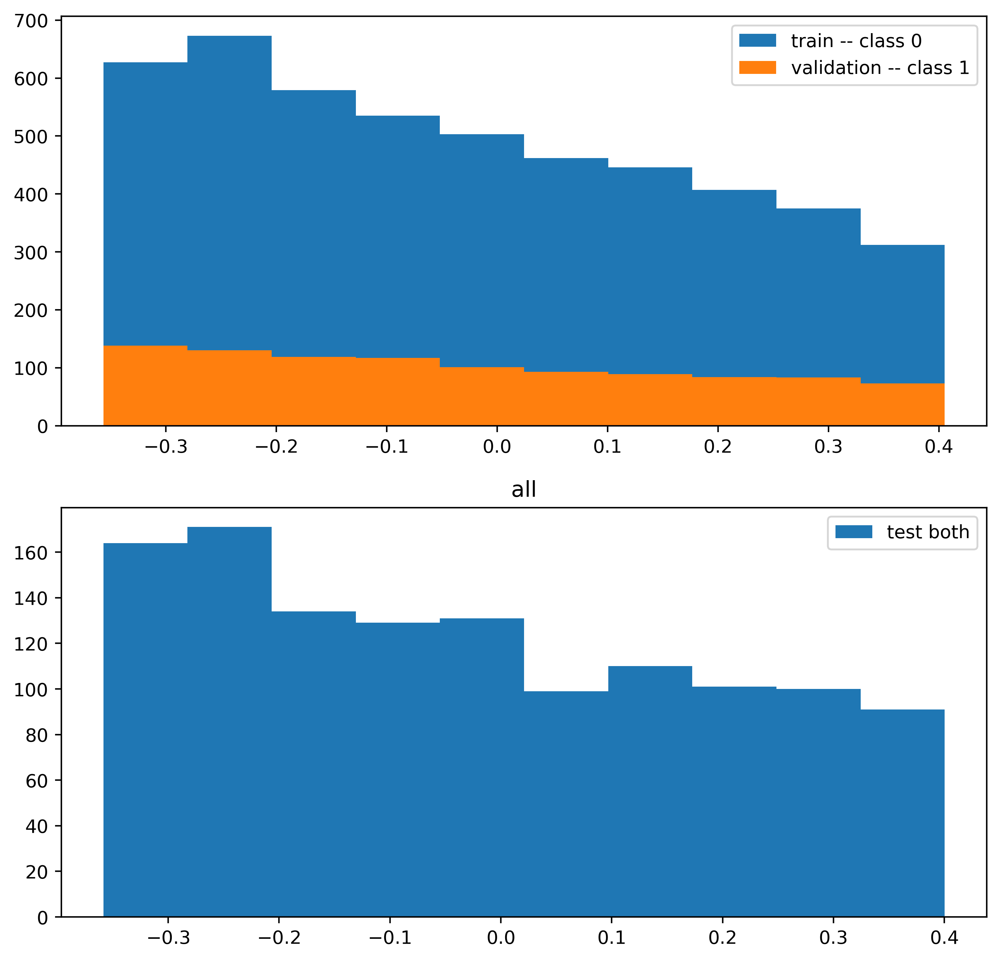

all:   0%|          | 1/30000 [00:02<20:52:59,  2.51s/it, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:   0%|          | 101/30000 [01:32<7:24:52,  1.12it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.9801986733067553


all:   1%|          | 201/30000 [03:02<7:23:20,  1.12it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.9417645335842486


all:   1%|          | 301/30000 [04:32<7:24:05,  1.11it/s, train_loss=-1.74, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.8869204367171575


all:   1%|▏         | 401/30000 [06:02<7:31:47,  1.09it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.8187307530779818


all:   2%|▏         | 501/30000 [07:32<7:18:33,  1.12it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.7408182206817178


all:   2%|▏         | 601/30000 [09:01<7:19:10,  1.12it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.6570468198150566


all:   2%|▏         | 701/30000 [10:31<7:18:44,  1.11it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.5712090638488148


all:   3%|▎         | 801/30000 [12:00<7:17:11,  1.11it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.48675225595997157


all:   3%|▎         | 901/30000 [13:30<7:15:43,  1.11it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.40656965974059905


all:   3%|▎         | 1000/30000 [14:59<7:11:28,  1.12it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.3328710836980795
4919 4919 4919
(array([0]), array([4919]))


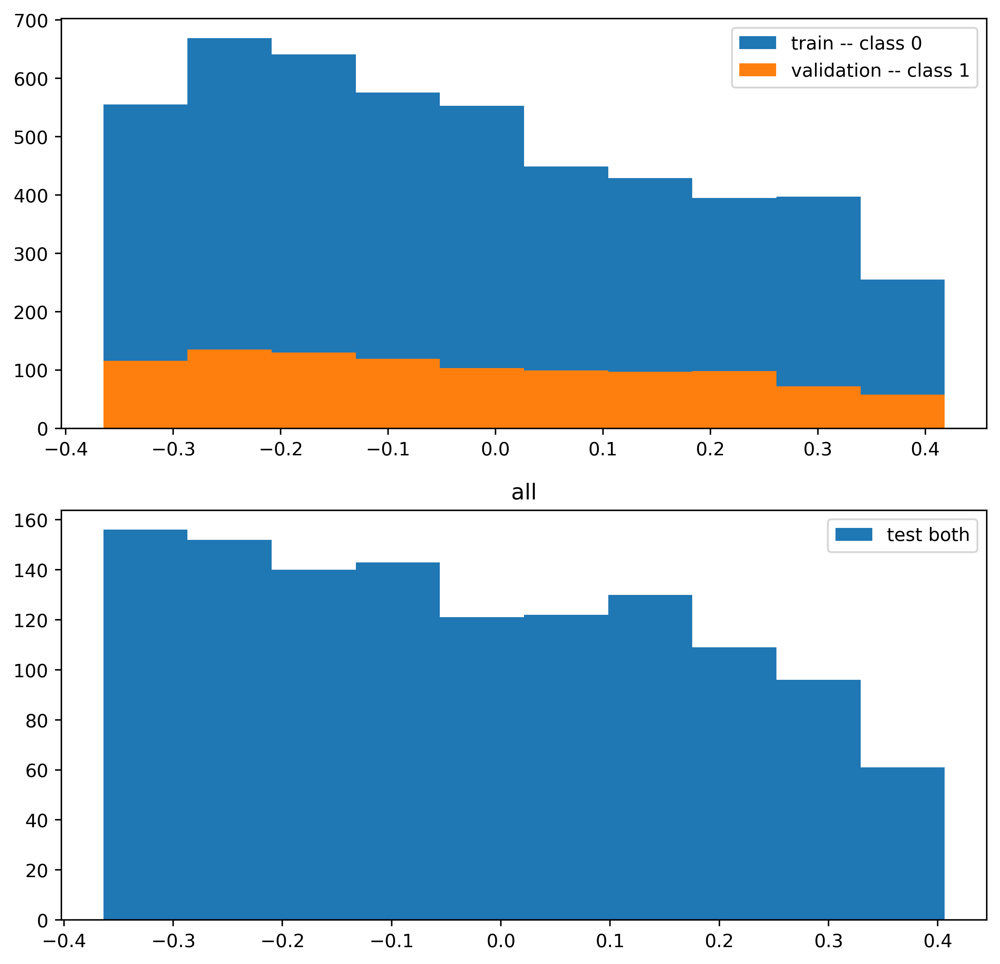

all:   3%|▎         | 1001/30000 [15:01<10:23:05,  1.29s/it, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:   4%|▎         | 1101/30000 [16:31<7:12:27,  1.11it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.26713530196585034


all:   4%|▍         | 1201/30000 [18:00<7:08:58,  1.12it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.2101360712007647


all:   4%|▍         | 1301/30000 [19:29<7:10:17,  1.11it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.16202575093388072


all:   5%|▍         | 1401/30000 [20:59<7:07:55,  1.11it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.12245642825298188


all:   5%|▌         | 1501/30000 [22:28<7:06:14,  1.11it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.09071795328941248


all:   5%|▌         | 1601/30000 [23:56<6:55:24,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.06587475442640295


all:   6%|▌         | 1701/30000 [25:24<6:54:23,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.04688769521998848


all:   6%|▌         | 1801/30000 [26:54<7:00:41,  1.12it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.032712434939019805


all:   6%|▋         | 1901/30000 [28:23<7:00:17,  1.11it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.022370771856165587


all:   7%|▋         | 2000/30000 [29:53<6:58:13,  1.12it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.014995576820477701
4919 4919 4919
(array([0]), array([4919]))


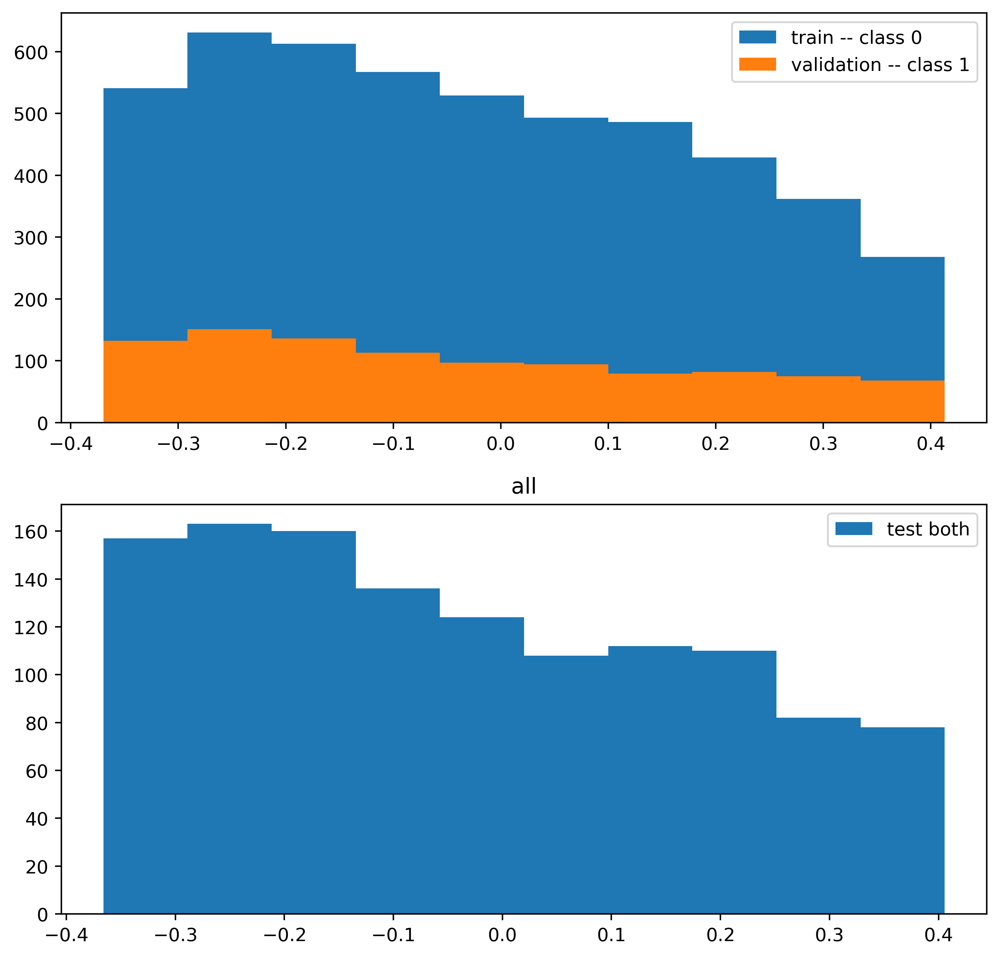

all:   7%|▋         | 2001/30000 [29:54<9:59:57,  1.29s/it, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:   7%|▋         | 2101/30000 [31:24<6:55:51,  1.12it/s, train_loss=-1.73, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.009852796061187254


all:   7%|▋         | 2201/30000 [32:53<6:53:37,  1.12it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.006345559512909111


all:   8%|▊         | 2301/30000 [34:23<6:52:11,  1.12it/s, train_loss=-1.74, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.004005847942090417


all:   8%|▊         | 2401/30000 [35:52<6:49:48,  1.12it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.002478752176666357


all:   8%|▊         | 2501/30000 [37:22<6:48:49,  1.12it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.0015034391929775717


all:   9%|▊         | 2601/30000 [38:50<6:40:22,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:   9%|▉         | 2701/30000 [40:17<6:39:31,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:   9%|▉         | 2801/30000 [41:45<6:37:50,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  10%|▉         | 2901/30000 [43:13<6:35:09,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  10%|█         | 3000/30000 [44:41<6:34:53,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


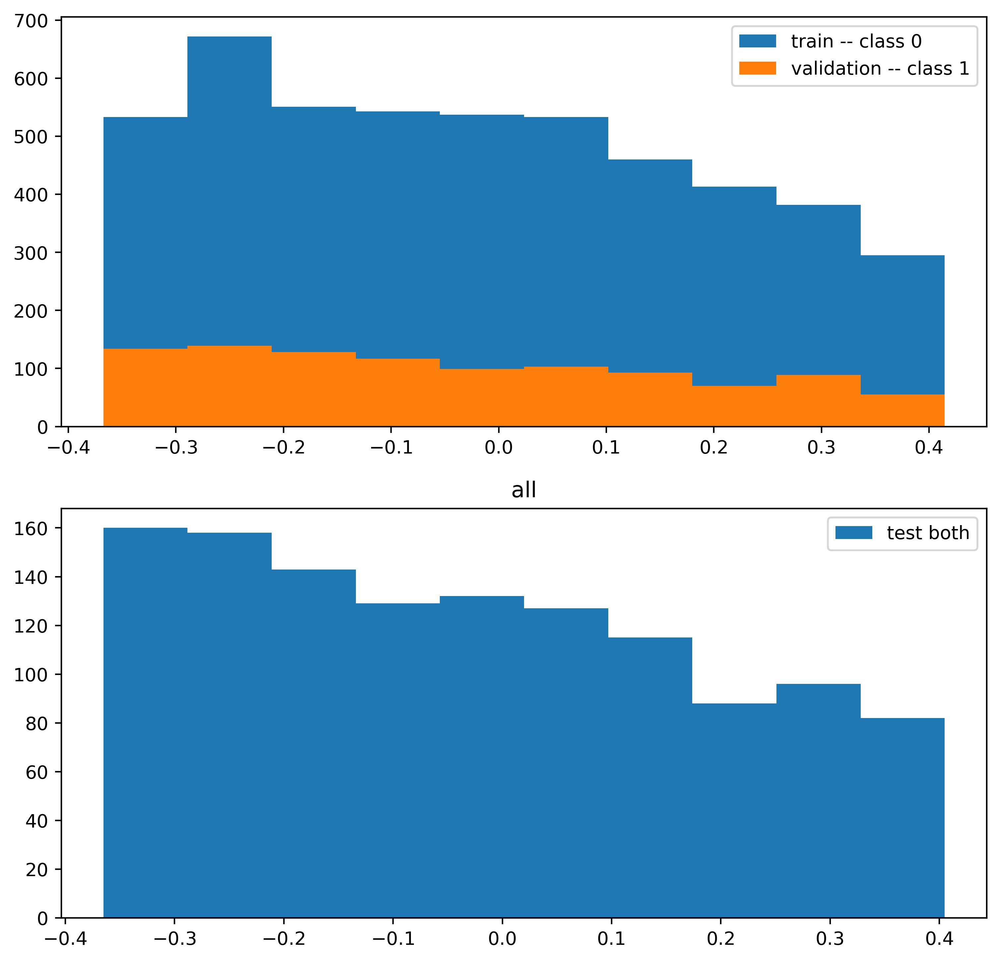

all:  10%|█         | 3001/30000 [44:42<9:29:28,  1.27s/it, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  10%|█         | 3101/30000 [46:10<6:34:04,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  11%|█         | 3201/30000 [47:38<6:32:16,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  11%|█         | 3301/30000 [49:06<6:30:38,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  11%|█▏        | 3401/30000 [50:34<6:30:04,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  12%|█▏        | 3501/30000 [52:01<6:26:56,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  12%|█▏        | 3601/30000 [53:29<6:26:45,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  12%|█▏        | 3701/30000 [54:57<6:26:41,  1.13it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  13%|█▎        | 3801/30000 [56:25<6:22:51,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  13%|█▎        | 3901/30000 [57:53<6:21:57,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  13%|█▎        | 4000/30000 [59:20<6:20:24,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


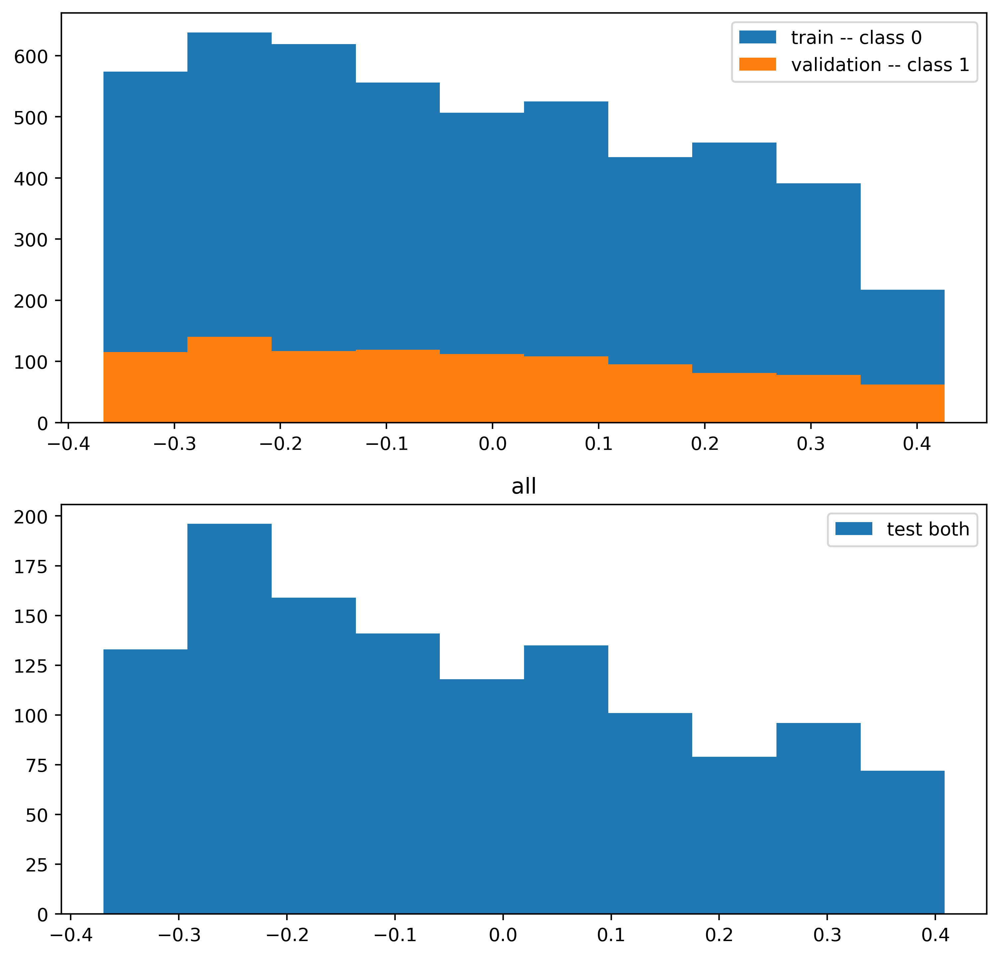

all:  13%|█▎        | 4001/30000 [59:22<9:07:43,  1.26s/it, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  14%|█▎        | 4101/30000 [1:00:50<6:17:47,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  14%|█▍        | 4201/30000 [1:02:17<6:16:04,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  14%|█▍        | 4301/30000 [1:03:45<6:14:10,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  15%|█▍        | 4401/30000 [1:05:12<6:14:02,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  15%|█▌        | 4501/30000 [1:06:40<6:13:00,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  15%|█▌        | 4601/30000 [1:08:08<6:11:09,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  16%|█▌        | 4701/30000 [1:09:35<6:08:58,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  16%|█▌        | 4801/30000 [1:11:04<6:09:43,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  16%|█▋        | 4901/30000 [1:12:32<6:07:01,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  17%|█▋        | 5000/30000 [1:13:59<6:05:24,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


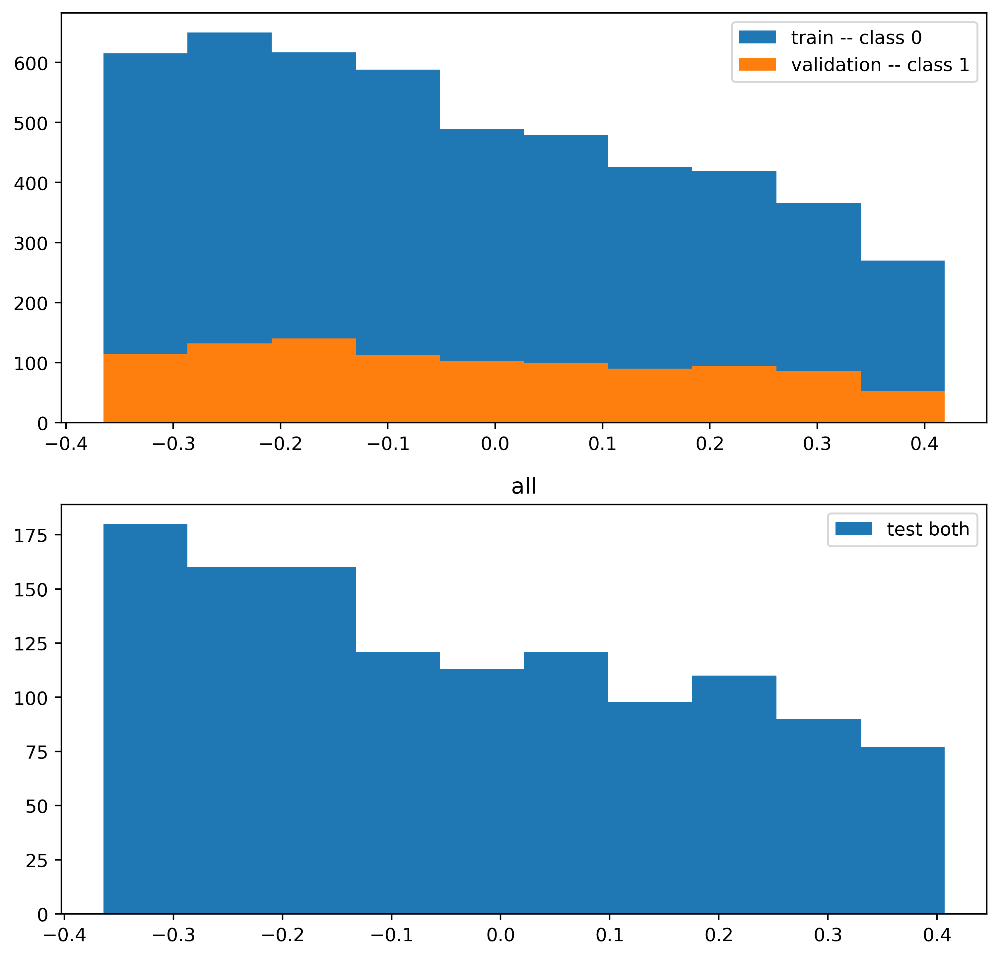

all:  17%|█▋        | 5001/30000 [1:14:01<8:45:39,  1.26s/it, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  17%|█▋        | 5101/30000 [1:15:28<6:05:01,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  17%|█▋        | 5201/30000 [1:16:56<6:01:31,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  18%|█▊        | 5301/30000 [1:18:23<5:58:16,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  18%|█▊        | 5401/30000 [1:19:51<5:58:20,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  18%|█▊        | 5501/30000 [1:21:19<5:58:34,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  19%|█▊        | 5601/30000 [1:22:47<5:58:09,  1.14it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  19%|█▉        | 5701/30000 [1:24:15<5:55:49,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  19%|█▉        | 5801/30000 [1:25:43<5:53:54,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  20%|█▉        | 5901/30000 [1:27:11<5:53:05,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  20%|██        | 6000/30000 [1:28:39<5:51:20,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


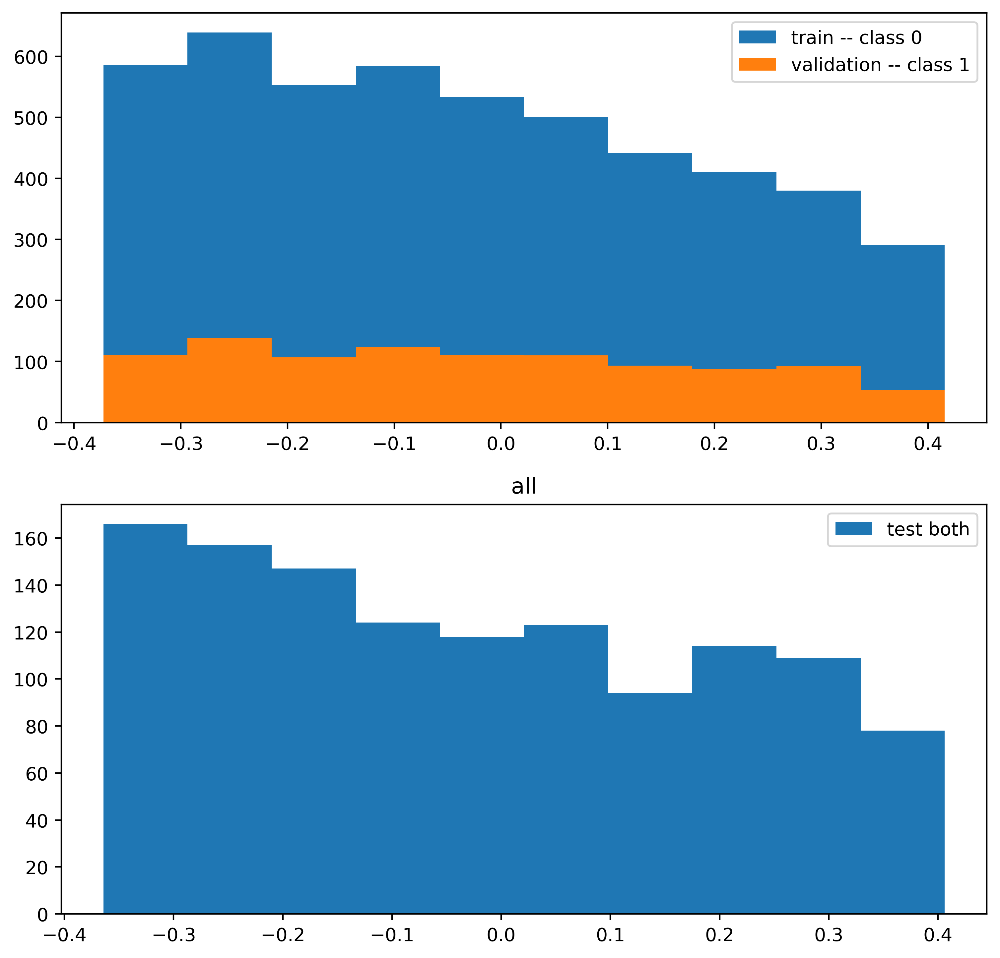

all:  20%|██        | 6001/30000 [1:28:40<8:27:37,  1.27s/it, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  20%|██        | 6101/30000 [1:30:08<5:49:28,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  21%|██        | 6201/30000 [1:31:35<5:47:18,  1.14it/s, train_loss=-1.74, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  21%|██        | 6301/30000 [1:33:03<5:45:20,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  21%|██▏       | 6401/30000 [1:34:30<5:44:18,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  22%|██▏       | 6501/30000 [1:35:58<5:42:58,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  22%|██▏       | 6601/30000 [1:37:26<5:43:56,  1.13it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  22%|██▏       | 6701/30000 [1:38:54<5:43:29,  1.13it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  23%|██▎       | 6801/30000 [1:40:23<5:40:35,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  23%|██▎       | 6901/30000 [1:41:51<5:39:38,  1.13it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  23%|██▎       | 7000/30000 [1:43:19<5:37:48,  1.13it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


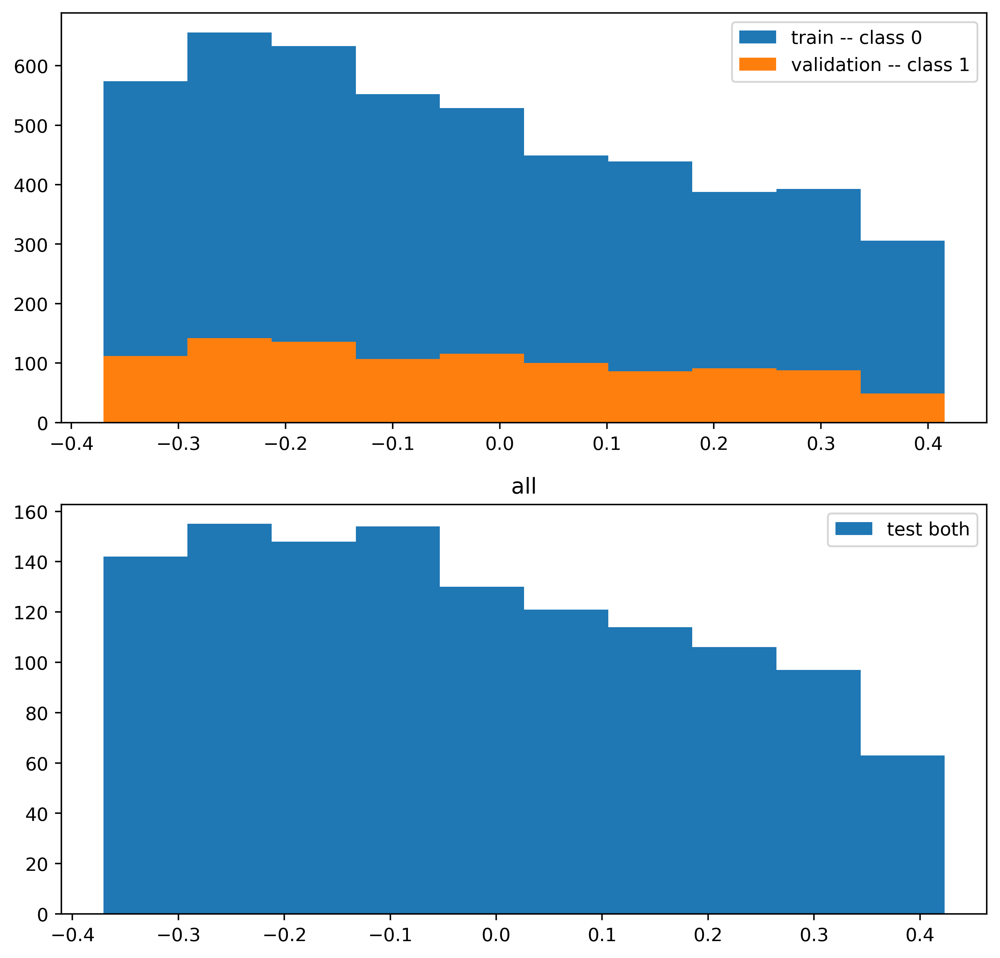

all:  23%|██▎       | 7001/30000 [1:43:21<8:07:36,  1.27s/it, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  24%|██▎       | 7101/30000 [1:44:49<5:38:14,  1.13it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  24%|██▍       | 7201/30000 [1:46:17<5:33:42,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  24%|██▍       | 7301/30000 [1:47:45<5:34:28,  1.13it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  25%|██▍       | 7401/30000 [1:49:13<5:31:13,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  25%|██▌       | 7501/30000 [1:50:41<5:31:12,  1.13it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  25%|██▌       | 7601/30000 [1:52:09<5:27:52,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  26%|██▌       | 7701/30000 [1:53:37<5:26:18,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  26%|██▌       | 7801/30000 [1:55:05<5:24:47,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  26%|██▋       | 7901/30000 [1:56:33<5:23:30,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  27%|██▋       | 8000/30000 [1:58:00<5:21:44,  1.14it/s, train_loss=-1.74, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


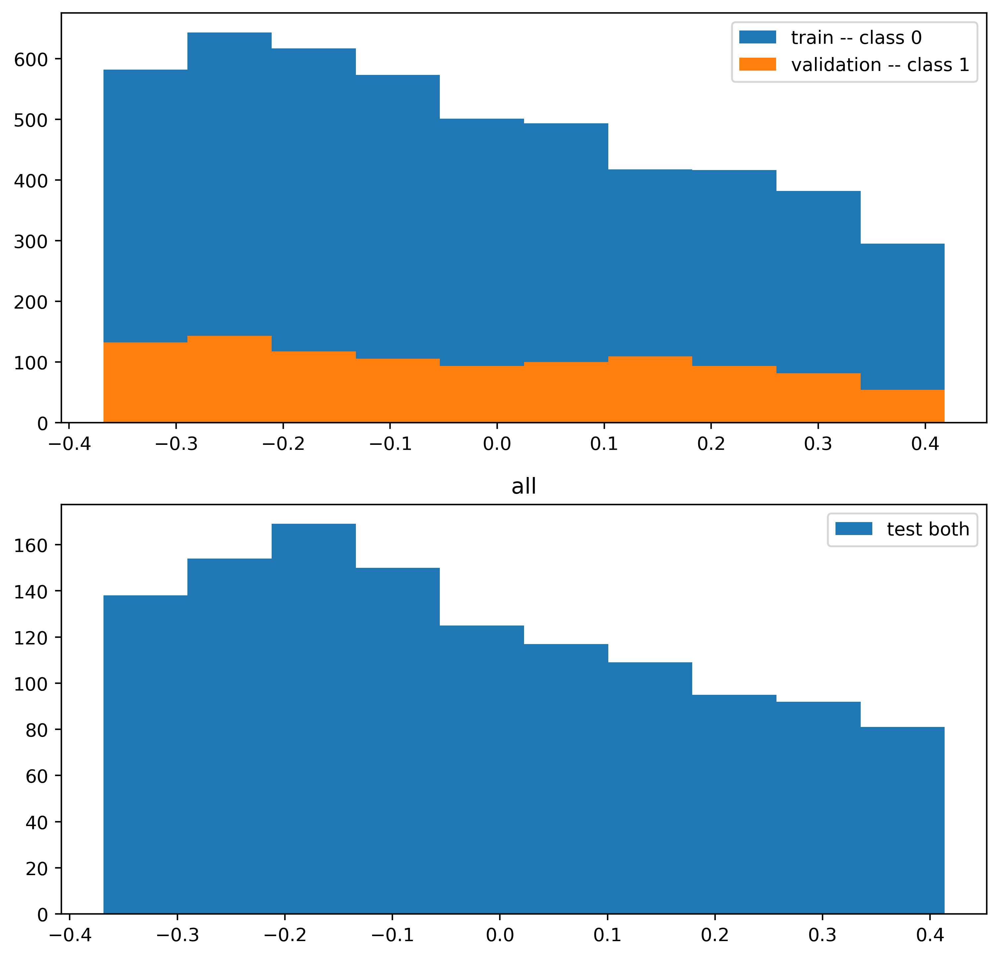

all:  27%|██▋       | 8001/30000 [1:58:02<7:43:43,  1.26s/it, train_loss=-1.74, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  27%|██▋       | 8101/30000 [1:59:29<5:18:48,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  27%|██▋       | 8201/30000 [2:00:56<5:17:17,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  28%|██▊       | 8301/30000 [2:02:24<5:15:08,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  28%|██▊       | 8401/30000 [2:03:51<5:13:45,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  28%|██▊       | 8501/30000 [2:05:18<5:13:09,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  29%|██▊       | 8601/30000 [2:06:45<5:09:59,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  29%|██▉       | 8701/30000 [2:08:12<5:07:42,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  29%|██▉       | 8801/30000 [2:09:39<5:23:06,  1.09it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  30%|██▉       | 8901/30000 [2:11:06<5:03:57,  1.16it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  30%|███       | 9000/30000 [2:12:32<5:03:15,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


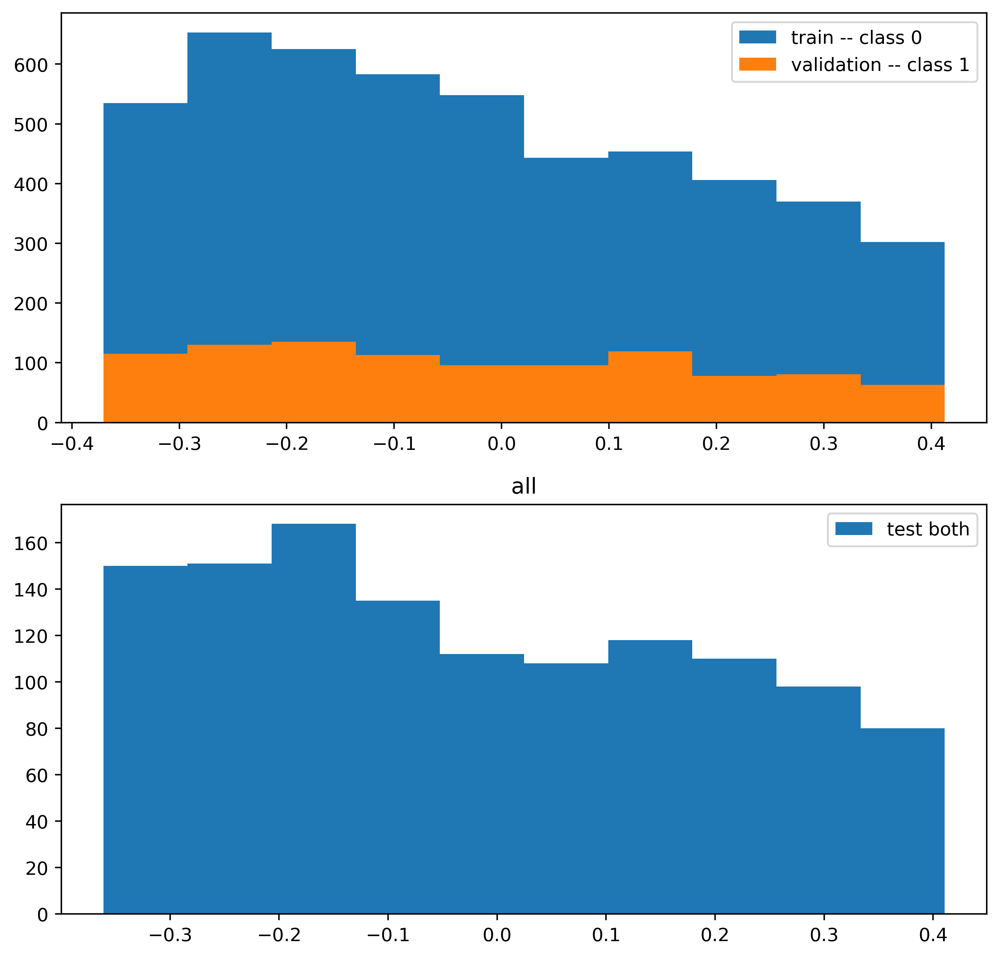

all:  30%|███       | 9001/30000 [2:12:34<7:17:52,  1.25s/it, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  30%|███       | 9101/30000 [2:14:00<5:01:40,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  31%|███       | 9201/30000 [2:15:27<5:01:33,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  31%|███       | 9301/30000 [2:16:54<4:58:08,  1.16it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  31%|███▏      | 9401/30000 [2:18:20<4:56:48,  1.16it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  32%|███▏      | 9501/30000 [2:19:47<4:55:32,  1.16it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  32%|███▏      | 9601/30000 [2:21:13<4:54:13,  1.16it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  32%|███▏      | 9701/30000 [2:22:40<4:52:13,  1.16it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  33%|███▎      | 9801/30000 [2:24:07<4:52:57,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  33%|███▎      | 9901/30000 [2:25:34<4:51:18,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  33%|███▎      | 10000/30000 [2:27:01<4:49:10,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


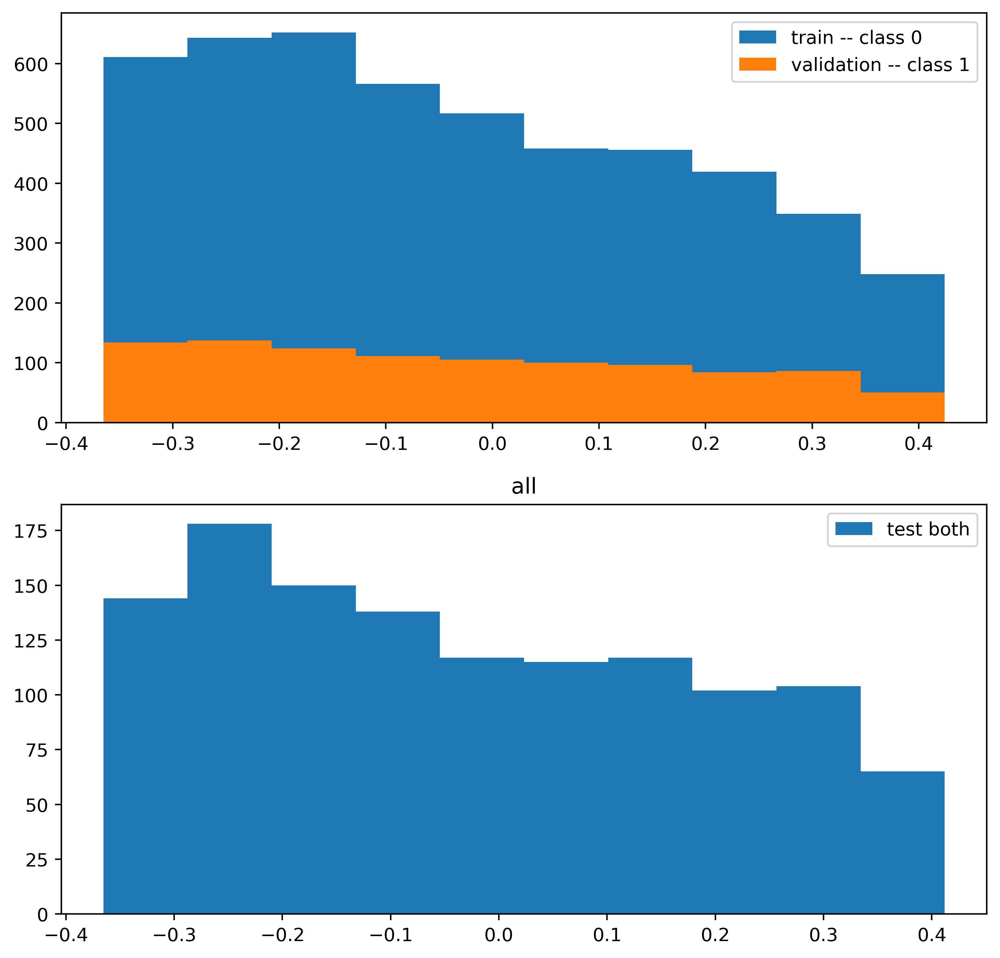

all:  33%|███▎      | 10001/30000 [2:27:02<6:55:42,  1.25s/it, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  34%|███▎      | 10101/30000 [2:28:28<4:46:41,  1.16it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  34%|███▍      | 10201/30000 [2:29:55<4:45:37,  1.16it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  34%|███▍      | 10301/30000 [2:31:22<4:43:59,  1.16it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  35%|███▍      | 10401/30000 [2:32:48<4:41:57,  1.16it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  35%|███▌      | 10501/30000 [2:34:15<4:40:54,  1.16it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  35%|███▌      | 10601/30000 [2:35:42<4:39:40,  1.16it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  36%|███▌      | 10701/30000 [2:37:08<4:39:02,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  36%|███▌      | 10801/30000 [2:38:35<4:38:35,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  36%|███▋      | 10901/30000 [2:40:02<4:36:39,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  37%|███▋      | 11000/30000 [2:41:29<4:35:10,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


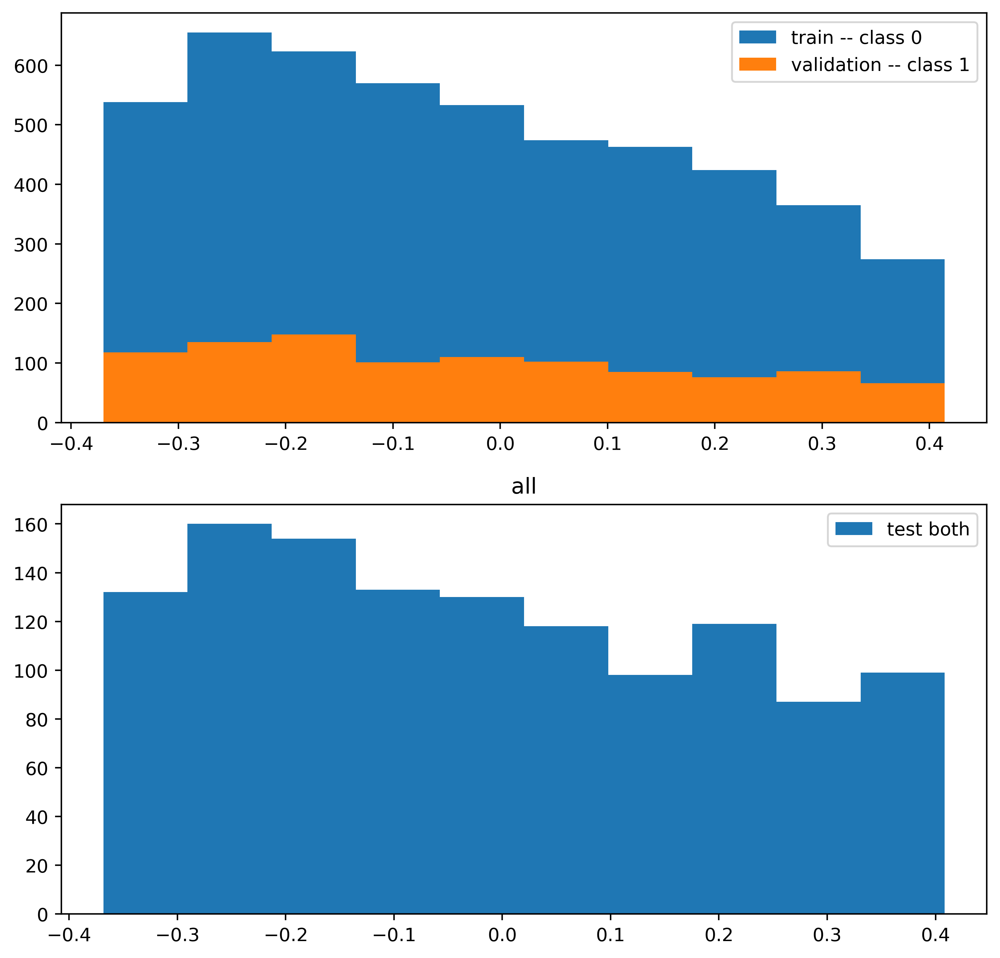

all:  37%|███▋      | 11001/30000 [2:41:31<6:38:39,  1.26s/it, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  37%|███▋      | 11101/30000 [2:42:58<4:36:16,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  37%|███▋      | 11201/30000 [2:44:25<4:32:44,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  38%|███▊      | 11301/30000 [2:45:52<4:31:18,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  38%|███▊      | 11401/30000 [2:47:20<4:30:18,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  38%|███▊      | 11501/30000 [2:48:47<4:29:15,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  39%|███▊      | 11601/30000 [2:50:14<4:27:37,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  39%|███▉      | 11701/30000 [2:51:41<4:25:43,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  39%|███▉      | 11801/30000 [2:53:08<4:24:52,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  40%|███▉      | 11901/30000 [2:54:35<4:22:02,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  40%|████      | 12000/30000 [2:56:02<4:20:04,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


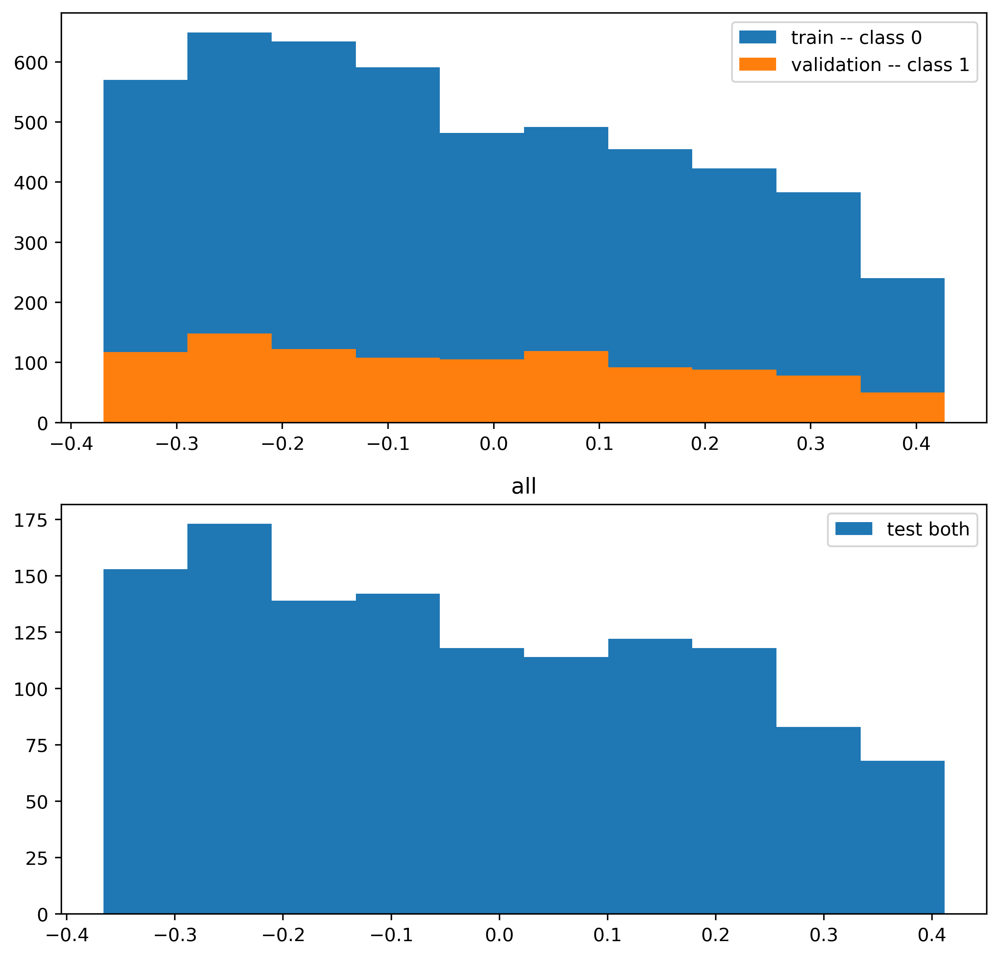

all:  40%|████      | 12001/30000 [2:56:04<6:15:45,  1.25s/it, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  40%|████      | 12101/30000 [2:57:31<4:21:58,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  41%|████      | 12201/30000 [2:58:59<4:20:05,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  41%|████      | 12301/30000 [3:00:27<4:17:55,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  41%|████▏     | 12401/30000 [3:01:55<4:17:19,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  42%|████▏     | 12501/30000 [3:03:23<4:15:31,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  42%|████▏     | 12601/30000 [3:04:50<4:13:49,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  42%|████▏     | 12701/30000 [3:06:18<4:13:17,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  43%|████▎     | 12801/30000 [3:07:46<4:10:58,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  43%|████▎     | 12901/30000 [3:09:14<4:12:16,  1.13it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  43%|████▎     | 13000/30000 [3:10:41<4:08:03,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


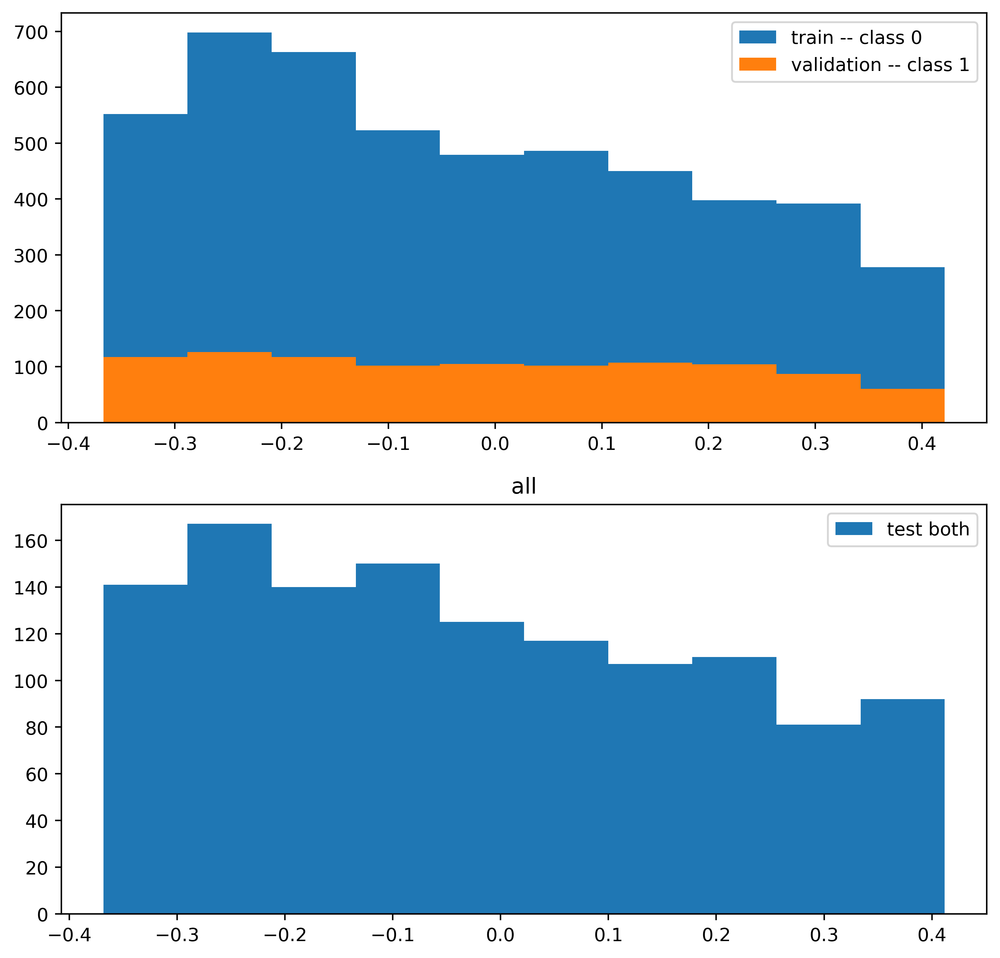

all:  43%|████▎     | 13001/30000 [3:10:43<5:58:03,  1.26s/it, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  44%|████▎     | 13101/30000 [3:12:11<4:06:17,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  44%|████▍     | 13201/30000 [3:13:38<4:05:26,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  44%|████▍     | 13301/30000 [3:15:06<4:04:26,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  45%|████▍     | 13401/30000 [3:16:33<4:02:53,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  45%|████▌     | 13501/30000 [3:18:01<4:01:00,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  45%|████▌     | 13601/30000 [3:19:29<3:59:02,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  46%|████▌     | 13701/30000 [3:20:56<3:59:02,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  46%|████▌     | 13801/30000 [3:22:24<3:56:05,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  46%|████▋     | 13901/30000 [3:23:52<3:54:58,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  47%|████▋     | 14000/30000 [3:25:19<3:51:46,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


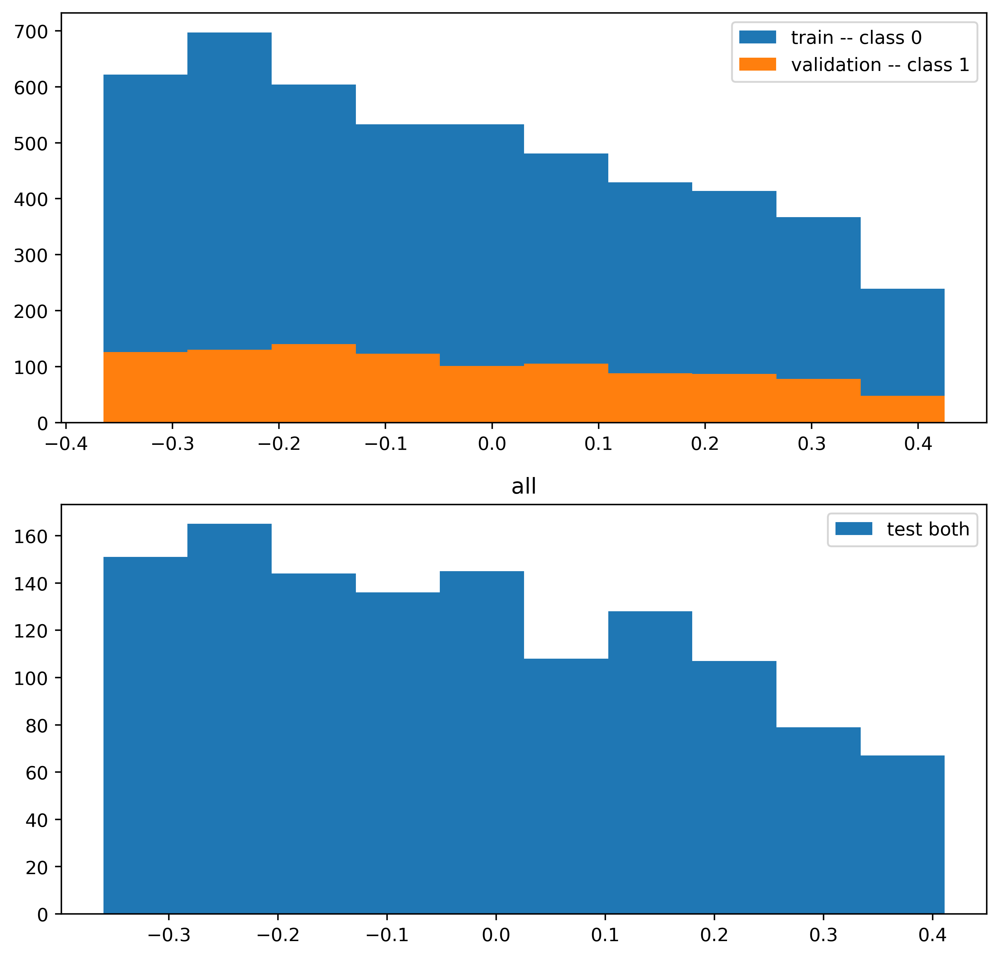

all:  47%|████▋     | 14001/30000 [3:25:20<5:34:44,  1.26s/it, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  47%|████▋     | 14101/30000 [3:26:47<3:50:13,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  47%|████▋     | 14201/30000 [3:28:14<3:48:14,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  48%|████▊     | 14301/30000 [3:29:41<3:47:22,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  48%|████▊     | 14401/30000 [3:31:08<3:46:17,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  48%|████▊     | 14501/30000 [3:32:35<3:44:35,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  49%|████▊     | 14601/30000 [3:34:02<3:43:20,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  49%|████▉     | 14701/30000 [3:35:29<3:41:13,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  49%|████▉     | 14801/30000 [3:36:56<3:40:13,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  50%|████▉     | 14901/30000 [3:38:23<3:37:31,  1.16it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  50%|█████     | 15000/30000 [3:39:49<3:36:45,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


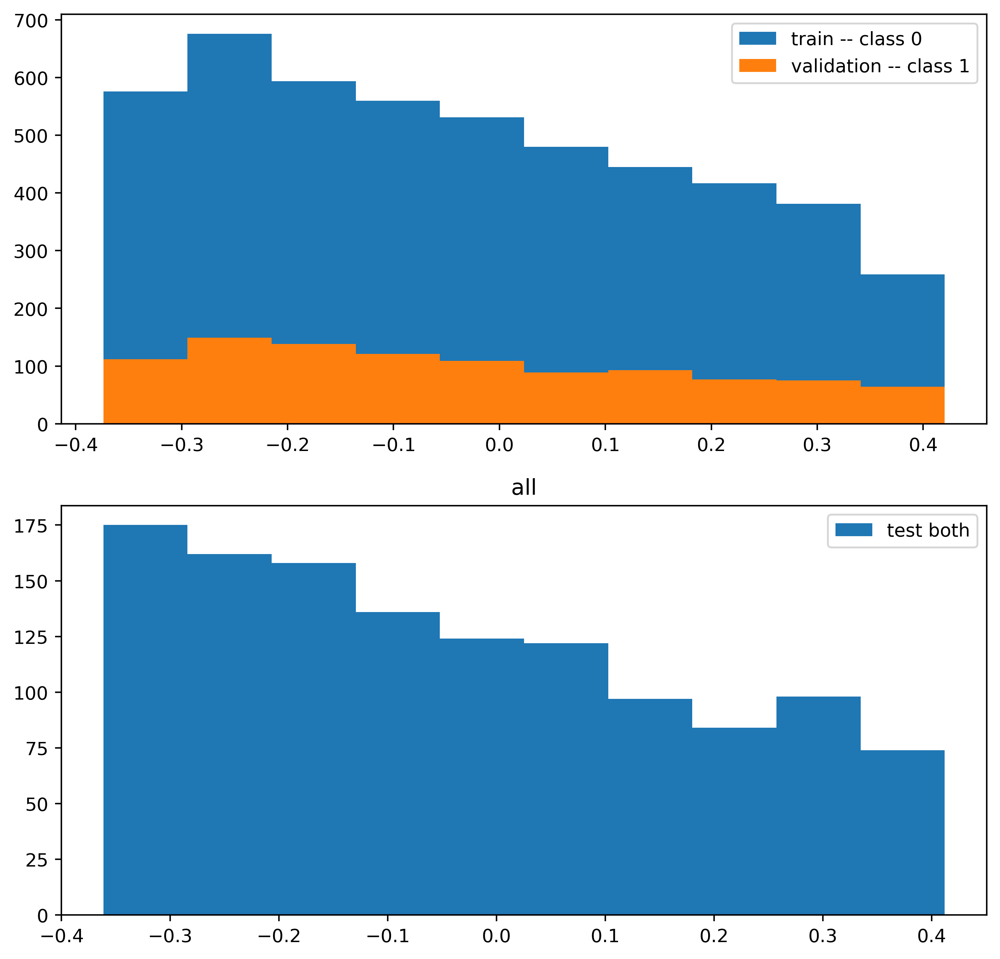

all:  50%|█████     | 15001/30000 [3:39:51<5:19:28,  1.28s/it, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  50%|█████     | 15101/30000 [3:41:19<3:39:13,  1.13it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  51%|█████     | 15201/30000 [3:42:48<3:38:39,  1.13it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  51%|█████     | 15301/30000 [3:44:16<3:36:55,  1.13it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  51%|█████▏    | 15401/30000 [3:45:45<3:35:14,  1.13it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  52%|█████▏    | 15501/30000 [3:47:13<3:33:05,  1.13it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  52%|█████▏    | 15601/30000 [3:48:41<3:32:06,  1.13it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  52%|█████▏    | 15701/30000 [3:50:10<3:30:05,  1.13it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  53%|█████▎    | 15801/30000 [3:51:38<3:29:19,  1.13it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  53%|█████▎    | 15901/30000 [3:53:07<3:27:59,  1.13it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  53%|█████▎    | 16000/30000 [3:54:35<3:25:48,  1.13it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


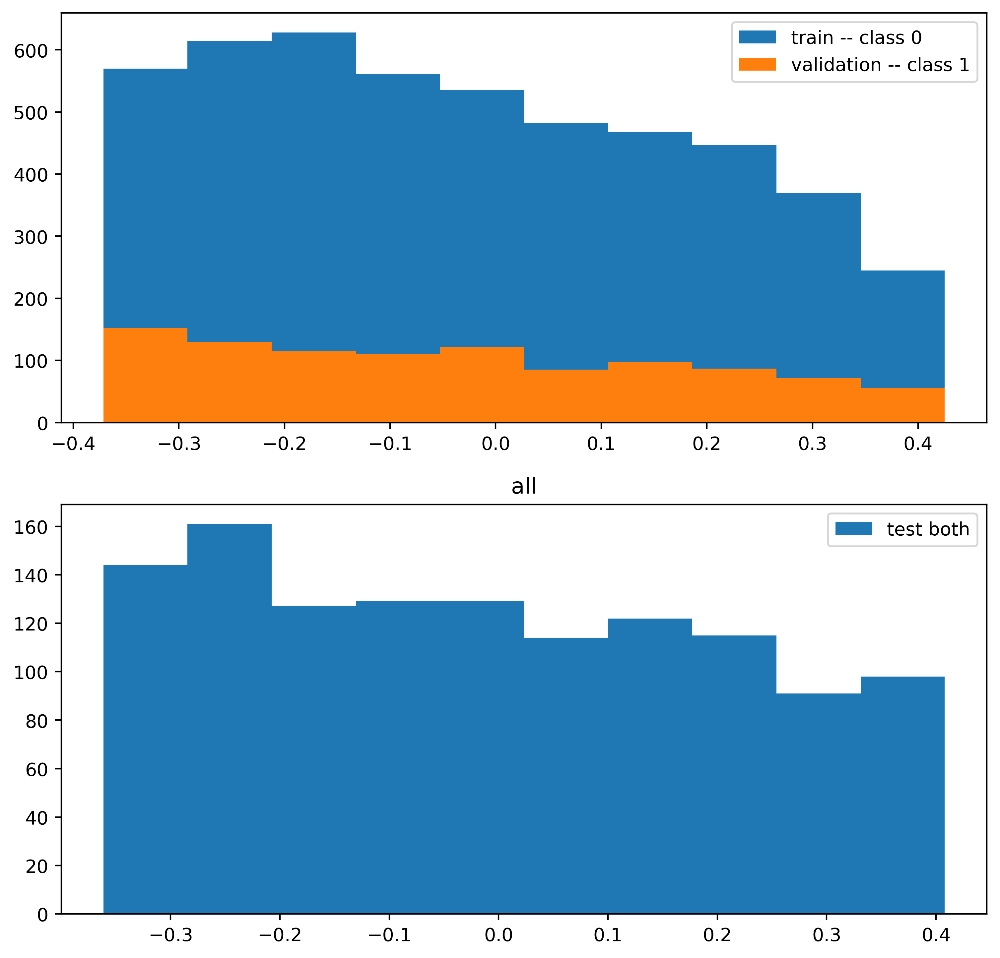

all:  53%|█████▎    | 16001/30000 [3:54:36<4:59:43,  1.28s/it, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  54%|█████▎    | 16101/30000 [3:56:05<3:25:18,  1.13it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  54%|█████▍    | 16201/30000 [3:57:33<3:22:30,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  54%|█████▍    | 16301/30000 [3:59:01<3:21:02,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  55%|█████▍    | 16401/30000 [4:00:29<3:19:24,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  55%|█████▌    | 16501/30000 [4:01:57<3:17:50,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  55%|█████▌    | 16601/30000 [4:03:25<3:16:47,  1.13it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  56%|█████▌    | 16701/30000 [4:04:53<3:14:28,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  56%|█████▌    | 16801/30000 [4:06:21<3:13:17,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  56%|█████▋    | 16901/30000 [4:07:50<3:11:37,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  57%|█████▋    | 17000/30000 [4:09:18<3:10:44,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


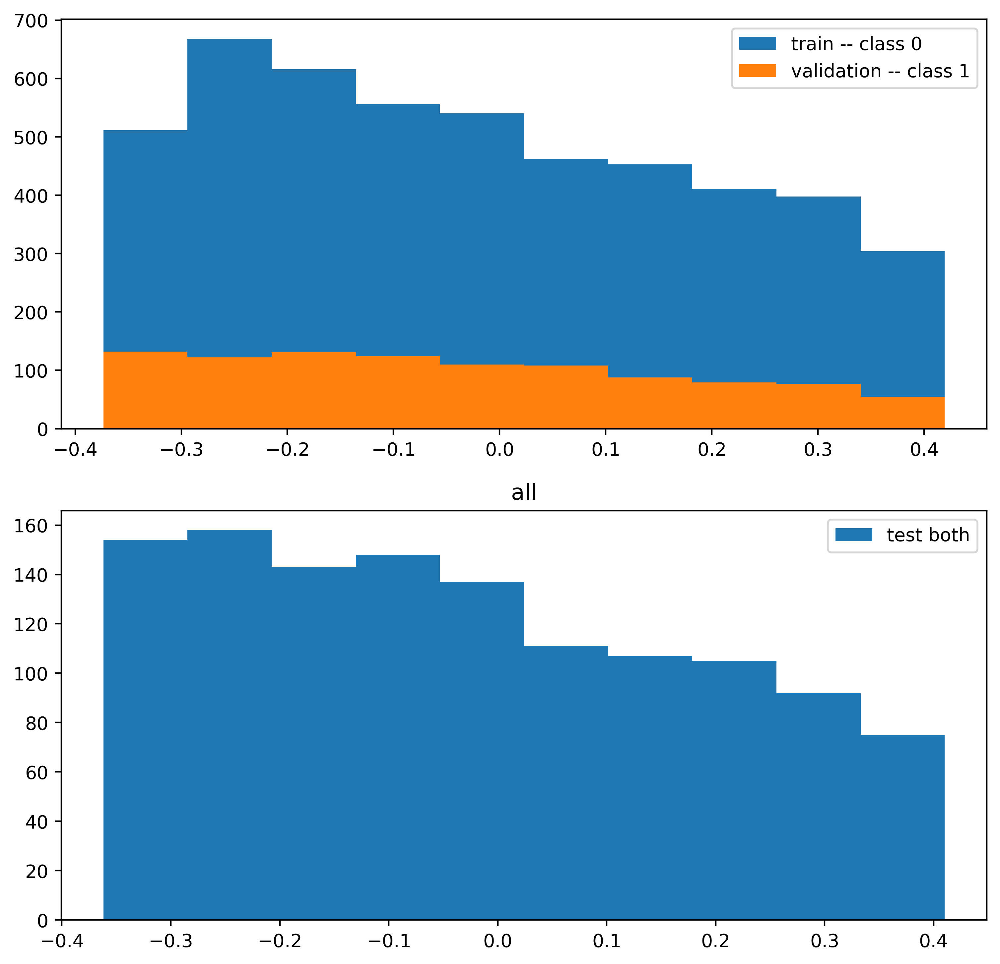

all:  57%|█████▋    | 17001/30000 [4:09:19<4:34:22,  1.27s/it, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  57%|█████▋    | 17101/30000 [4:10:47<3:08:45,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  57%|█████▋    | 17201/30000 [4:12:15<3:06:40,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  58%|█████▊    | 17301/30000 [4:13:42<3:04:48,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  58%|█████▊    | 17401/30000 [4:15:10<3:03:27,  1.14it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  58%|█████▊    | 17501/30000 [4:16:37<3:01:33,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  59%|█████▊    | 17601/30000 [4:18:05<3:00:35,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  59%|█████▉    | 17701/30000 [4:19:32<2:58:51,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  59%|█████▉    | 17801/30000 [4:21:00<2:57:56,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  60%|█████▉    | 17901/30000 [4:22:27<2:56:11,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  60%|██████    | 18000/30000 [4:23:55<2:54:42,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


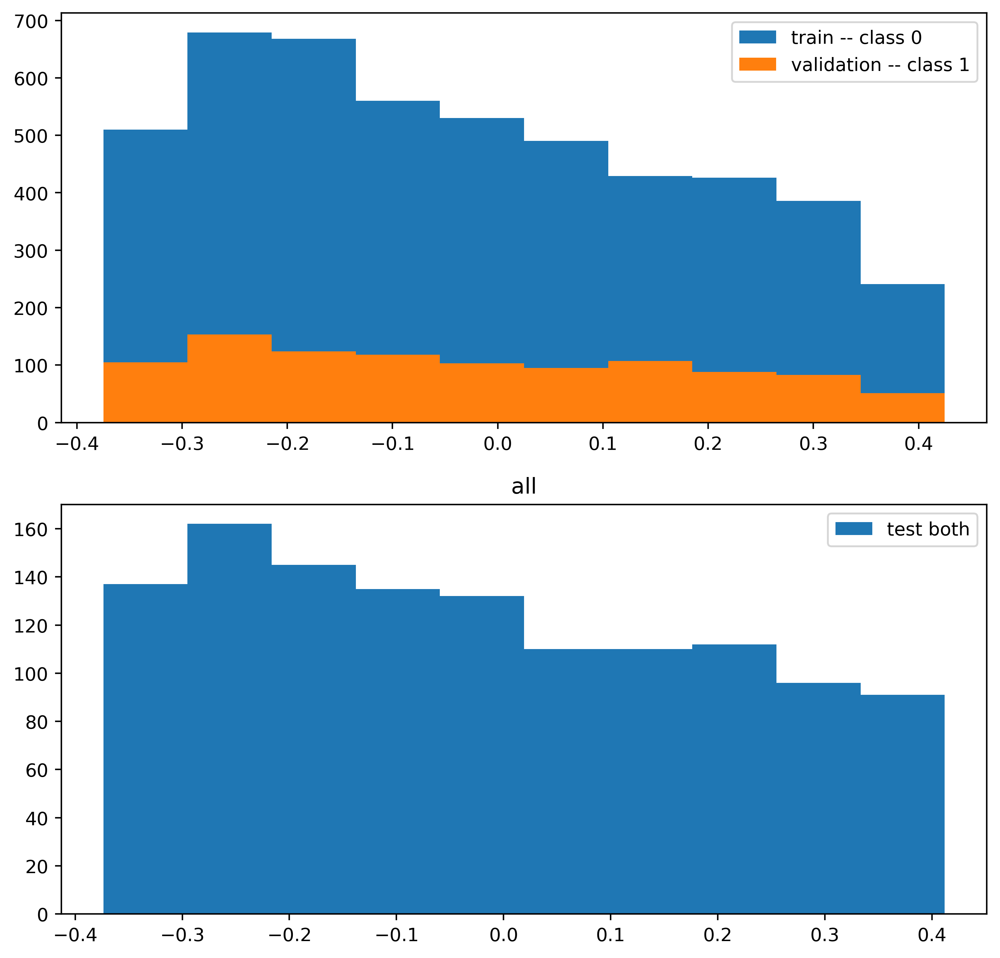

all:  60%|██████    | 18001/30000 [4:23:56<4:13:19,  1.27s/it, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  60%|██████    | 18101/30000 [4:25:24<2:54:21,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  61%|██████    | 18201/30000 [4:26:52<2:53:39,  1.13it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  61%|██████    | 18301/30000 [4:28:20<2:51:46,  1.14it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  61%|██████▏   | 18401/30000 [4:29:48<2:50:34,  1.13it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  62%|██████▏   | 18501/30000 [4:31:16<2:48:44,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  62%|██████▏   | 18601/30000 [4:32:44<2:46:58,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  62%|██████▏   | 18701/30000 [4:34:13<2:45:50,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  63%|██████▎   | 18801/30000 [4:35:41<2:44:11,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  63%|██████▎   | 18901/30000 [4:37:09<2:42:58,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  63%|██████▎   | 19000/30000 [4:38:37<2:41:08,  1.14it/s, train_loss=-1.73, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


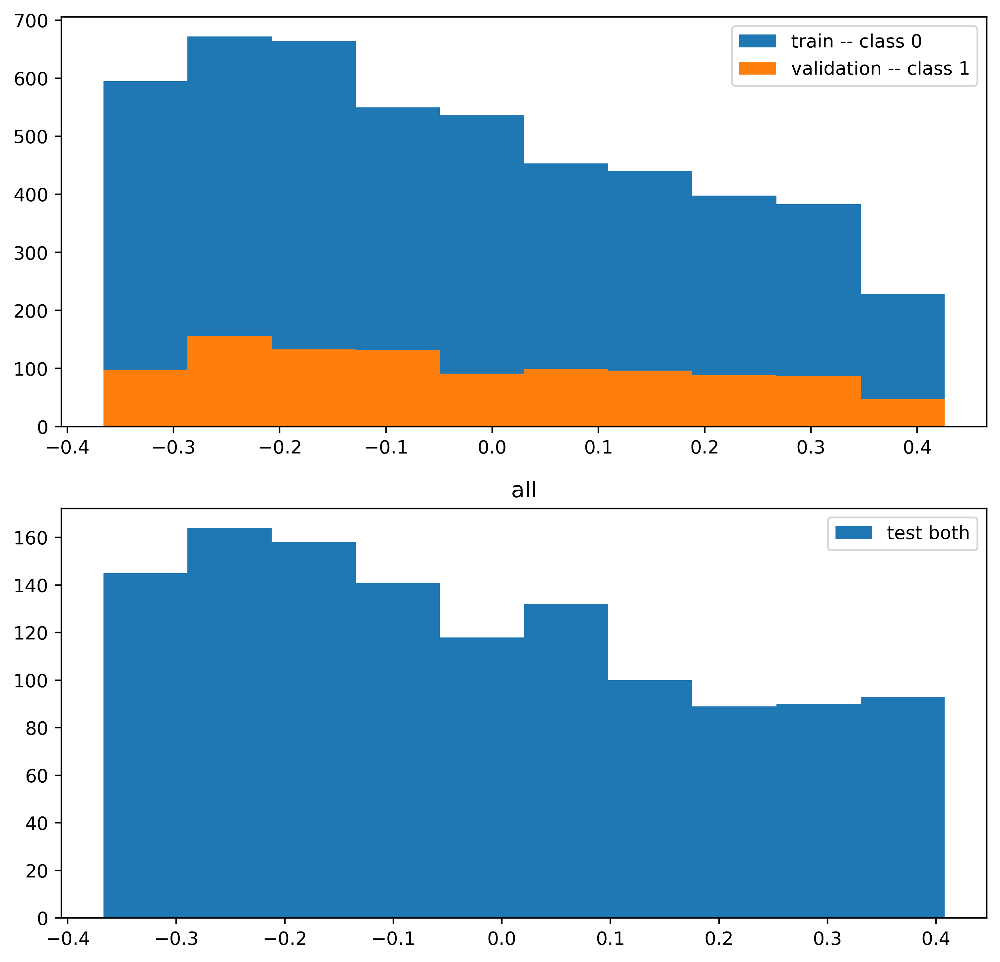

all:  63%|██████▎   | 19001/30000 [4:38:38<3:53:23,  1.27s/it, train_loss=-1.73, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  64%|██████▎   | 19101/30000 [4:40:06<2:39:11,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  64%|██████▍   | 19201/30000 [4:41:33<2:37:55,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  64%|██████▍   | 19301/30000 [4:43:01<2:35:10,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  65%|██████▍   | 19401/30000 [4:44:28<2:33:45,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  65%|██████▌   | 19501/30000 [4:45:55<2:32:13,  1.15it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  65%|██████▌   | 19601/30000 [4:47:22<2:30:55,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  66%|██████▌   | 19701/30000 [4:48:49<2:29:13,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  66%|██████▌   | 19801/30000 [4:50:16<2:27:59,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  66%|██████▋   | 19901/30000 [4:51:43<2:26:04,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  67%|██████▋   | 20000/30000 [4:53:10<2:25:14,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


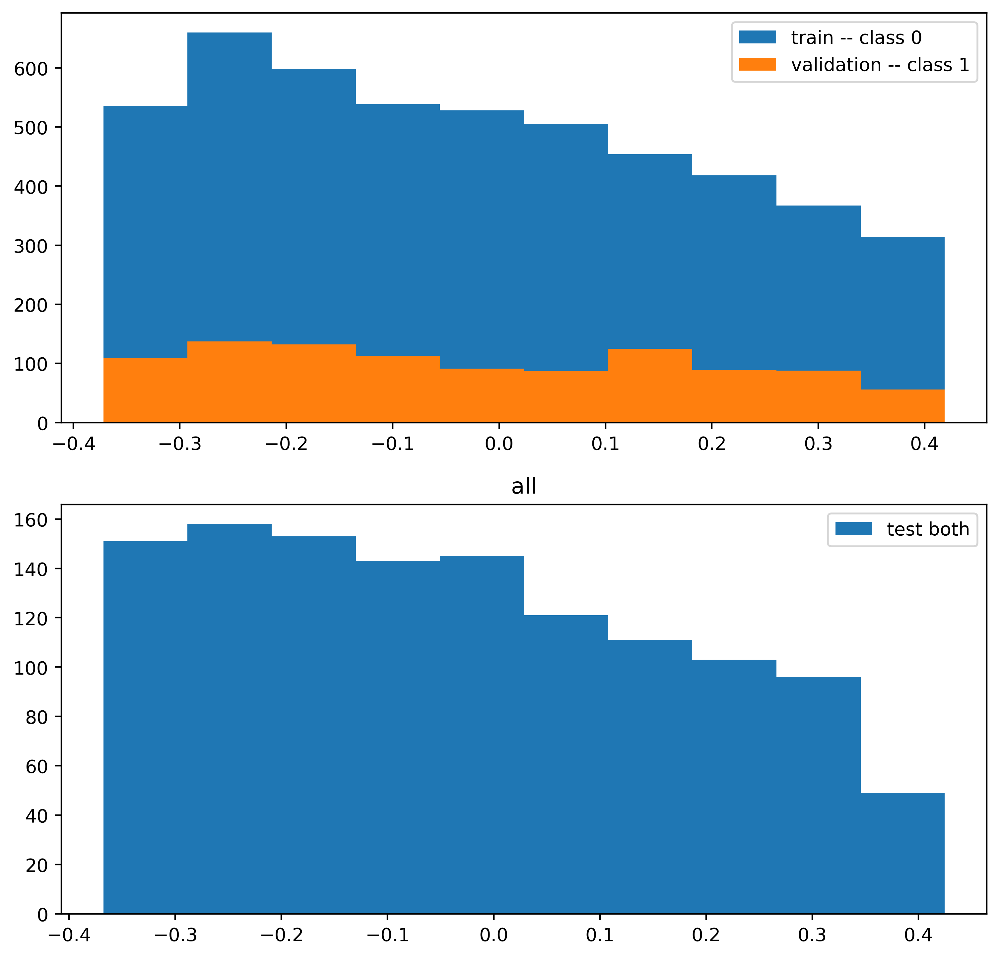

all:  67%|██████▋   | 20001/30000 [4:53:12<3:31:08,  1.27s/it, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  67%|██████▋   | 20101/30000 [4:54:39<2:23:45,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  67%|██████▋   | 20201/30000 [4:56:06<2:22:46,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  68%|██████▊   | 20301/30000 [4:57:33<2:21:00,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  68%|██████▊   | 20401/30000 [4:59:01<2:19:49,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  68%|██████▊   | 20501/30000 [5:00:28<2:18:35,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  69%|██████▊   | 20601/30000 [5:01:56<2:17:20,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  69%|██████▉   | 20701/30000 [5:03:23<2:15:37,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  69%|██████▉   | 20801/30000 [5:04:51<2:14:01,  1.14it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  70%|██████▉   | 20901/30000 [5:06:18<2:12:37,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  70%|███████   | 21000/30000 [5:07:46<2:10:57,  1.15it/s, train_loss=-1.74, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


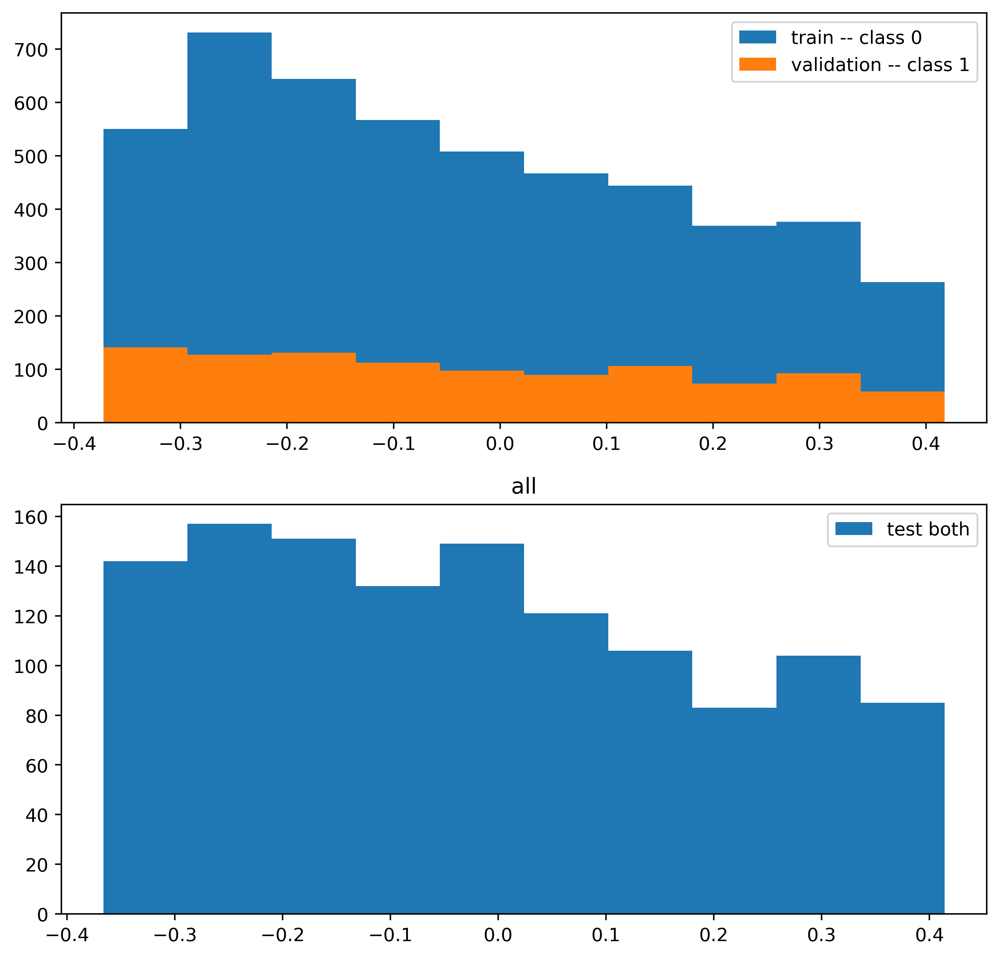

all:  70%|███████   | 21001/30000 [5:07:47<3:09:53,  1.27s/it, train_loss=-1.74, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  70%|███████   | 21101/30000 [5:09:13<2:08:08,  1.16it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  71%|███████   | 21201/30000 [5:10:40<2:06:53,  1.16it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  71%|███████   | 21301/30000 [5:12:06<2:05:24,  1.16it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  71%|███████▏  | 21401/30000 [5:13:32<2:03:38,  1.16it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  72%|███████▏  | 21501/30000 [5:14:59<2:02:30,  1.16it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  72%|███████▏  | 21601/30000 [5:16:26<2:01:18,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  72%|███████▏  | 21701/30000 [5:17:52<1:59:37,  1.16it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  73%|███████▎  | 21801/30000 [5:19:19<1:58:22,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  73%|███████▎  | 21901/30000 [5:20:45<1:56:36,  1.16it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  73%|███████▎  | 22000/30000 [5:22:12<1:55:19,  1.16it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


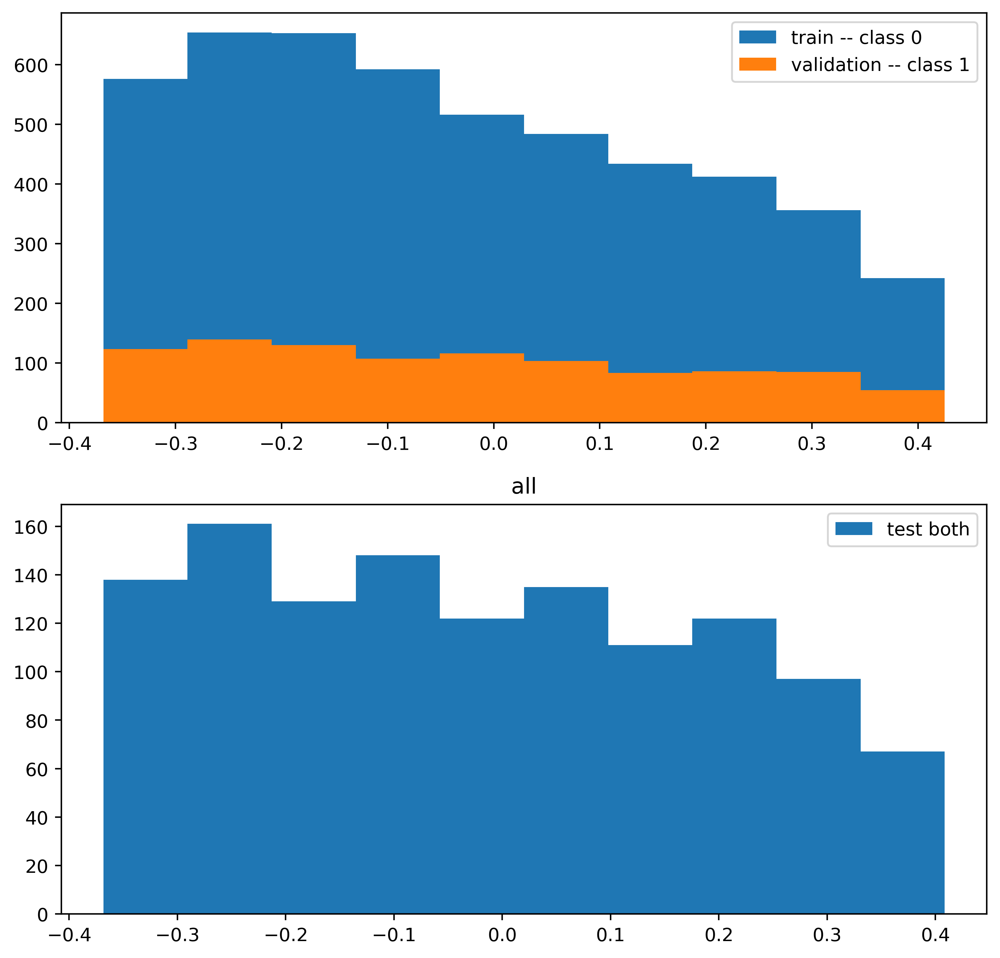

all:  73%|███████▎  | 22001/30000 [5:22:13<2:46:36,  1.25s/it, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  74%|███████▎  | 22101/30000 [5:23:40<1:54:30,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  74%|███████▍  | 22201/30000 [5:25:07<1:53:06,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  74%|███████▍  | 22301/30000 [5:26:35<1:51:37,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  75%|███████▍  | 22401/30000 [5:28:02<1:49:56,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  75%|███████▌  | 22501/30000 [5:29:29<1:49:16,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  75%|███████▌  | 22601/30000 [5:30:56<1:47:39,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  76%|███████▌  | 22701/30000 [5:32:23<1:46:30,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  76%|███████▌  | 22801/30000 [5:33:50<1:44:42,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  76%|███████▋  | 22901/30000 [5:35:18<1:43:32,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  77%|███████▋  | 23000/30000 [5:36:45<1:41:49,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


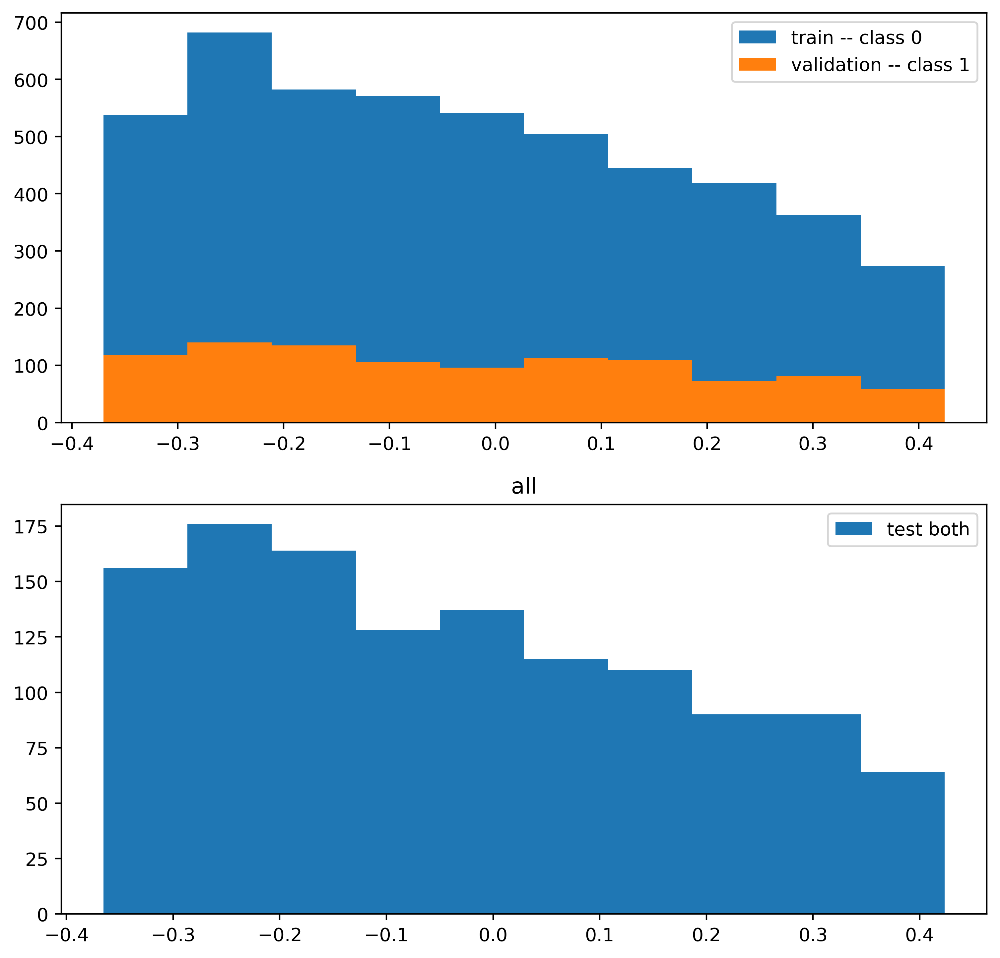

all:  77%|███████▋  | 23001/30000 [5:36:46<2:26:53,  1.26s/it, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  77%|███████▋  | 23101/30000 [5:38:14<1:40:59,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  77%|███████▋  | 23201/30000 [5:39:42<1:39:08,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  78%|███████▊  | 23301/30000 [5:41:09<1:38:12,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  78%|███████▊  | 23401/30000 [5:42:37<1:36:51,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  78%|███████▊  | 23501/30000 [5:44:04<1:34:39,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  79%|███████▊  | 23601/30000 [5:45:32<1:32:53,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  79%|███████▉  | 23701/30000 [5:46:59<1:31:31,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  79%|███████▉  | 23801/30000 [5:48:26<1:29:51,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  80%|███████▉  | 23901/30000 [5:49:54<1:28:37,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  80%|████████  | 24000/30000 [5:51:21<1:27:07,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


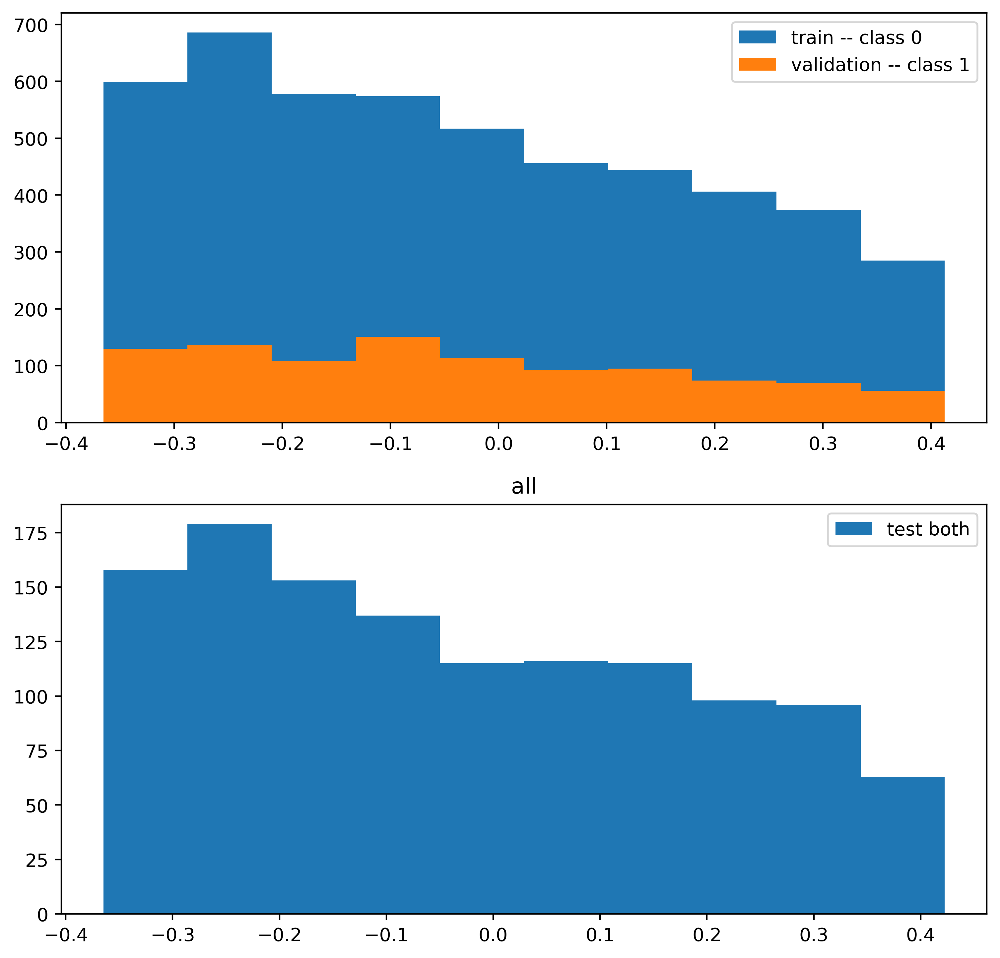

all:  80%|████████  | 24001/30000 [5:51:22<2:06:06,  1.26s/it, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  80%|████████  | 24101/30000 [5:52:49<1:25:25,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  81%|████████  | 24201/30000 [5:54:17<1:23:55,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  81%|████████  | 24301/30000 [5:55:44<1:22:29,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  81%|████████▏ | 24401/30000 [5:57:11<1:21:12,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  82%|████████▏ | 24501/30000 [5:58:37<1:19:28,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  82%|████████▏ | 24601/30000 [6:00:04<1:18:05,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  82%|████████▏ | 24701/30000 [6:01:32<1:17:47,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  83%|████████▎ | 24801/30000 [6:02:59<1:15:44,  1.14it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  83%|████████▎ | 24901/30000 [6:04:27<1:14:30,  1.14it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  83%|████████▎ | 25000/30000 [6:05:55<1:13:15,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


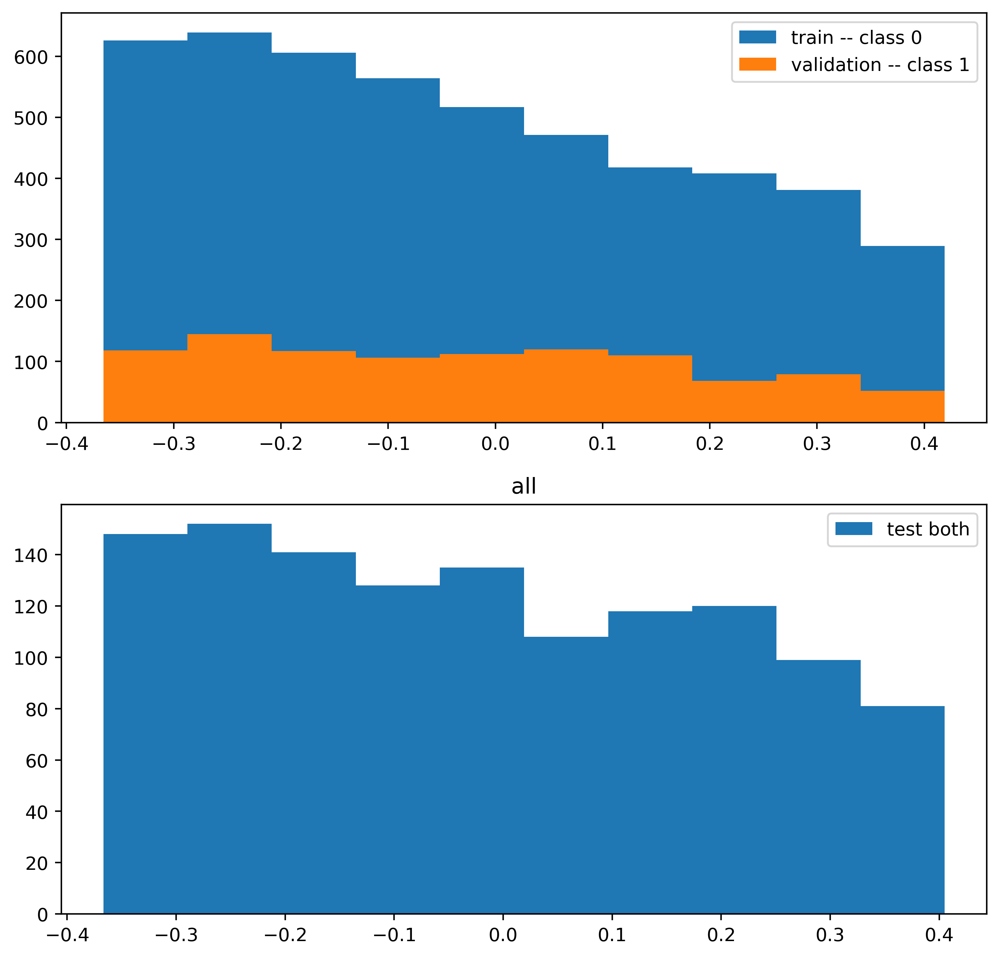

all:  83%|████████▎ | 25001/30000 [6:05:56<1:45:29,  1.27s/it, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  84%|████████▎ | 25101/30000 [6:07:24<1:11:52,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  84%|████████▍ | 25201/30000 [6:08:52<1:10:15,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  84%|████████▍ | 25301/30000 [6:10:20<1:08:25,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  85%|████████▍ | 25401/30000 [6:11:48<1:11:16,  1.08it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  85%|████████▌ | 25501/30000 [6:13:16<1:05:51,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  85%|████████▌ | 25601/30000 [6:14:44<1:04:20,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  86%|████████▌ | 25701/30000 [6:16:12<1:03:04,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  86%|████████▌ | 25801/30000 [6:17:40<1:01:10,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  86%|████████▋ | 25901/30000 [6:19:07<59:55,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]  

New Model Temperature: 0.001


all:  87%|████████▋ | 26000/30000 [6:20:35<58:12,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]  

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


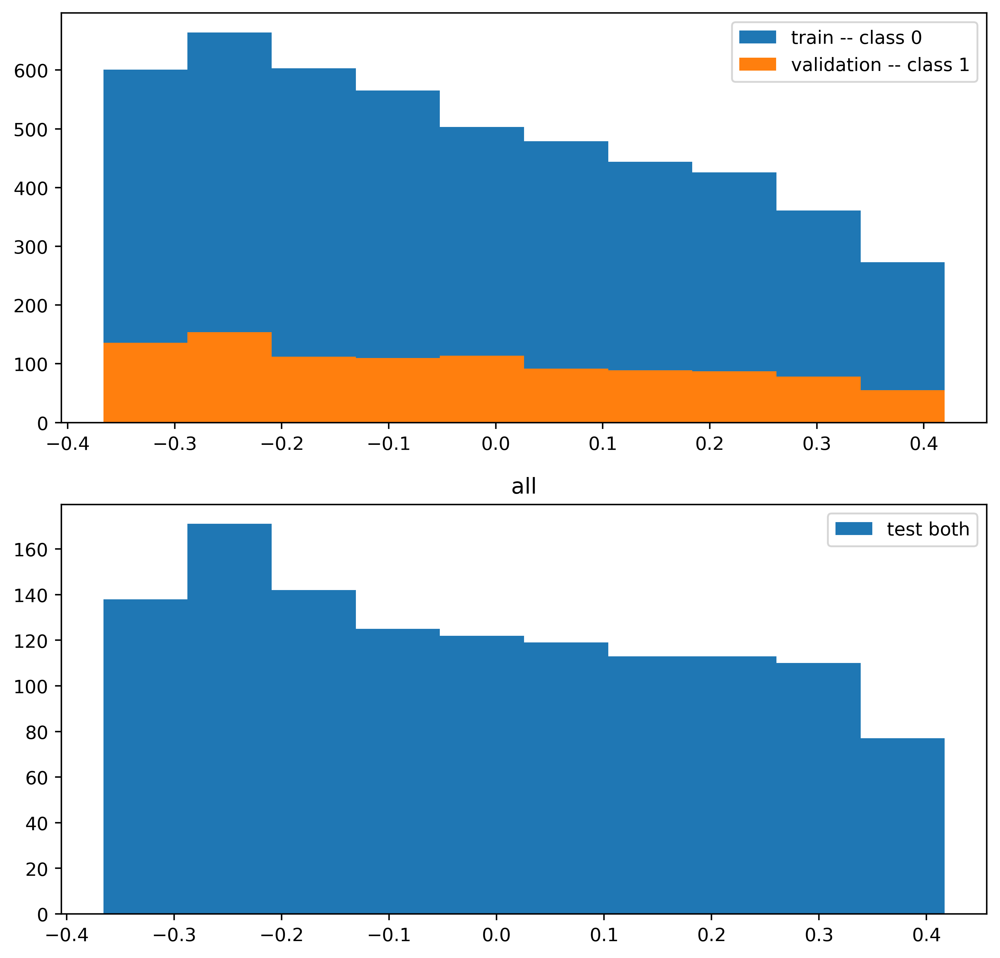

all:  87%|████████▋ | 26001/30000 [6:20:36<1:24:24,  1.27s/it, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  87%|████████▋ | 26101/30000 [6:22:03<56:25,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]  

New Model Temperature: 0.001


all:  87%|████████▋ | 26201/30000 [6:23:30<54:56,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  88%|████████▊ | 26301/30000 [6:24:57<53:24,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  88%|████████▊ | 26401/30000 [6:26:24<52:05,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  88%|████████▊ | 26501/30000 [6:27:50<50:31,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  89%|████████▊ | 26601/30000 [6:29:17<49:14,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  89%|████████▉ | 26701/30000 [6:30:44<47:46,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  89%|████████▉ | 26801/30000 [6:32:11<47:24,  1.12it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  90%|████████▉ | 26901/30000 [6:33:38<44:50,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  90%|█████████ | 27000/30000 [6:35:05<43:31,  1.15it/s, train_loss=-1.82, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


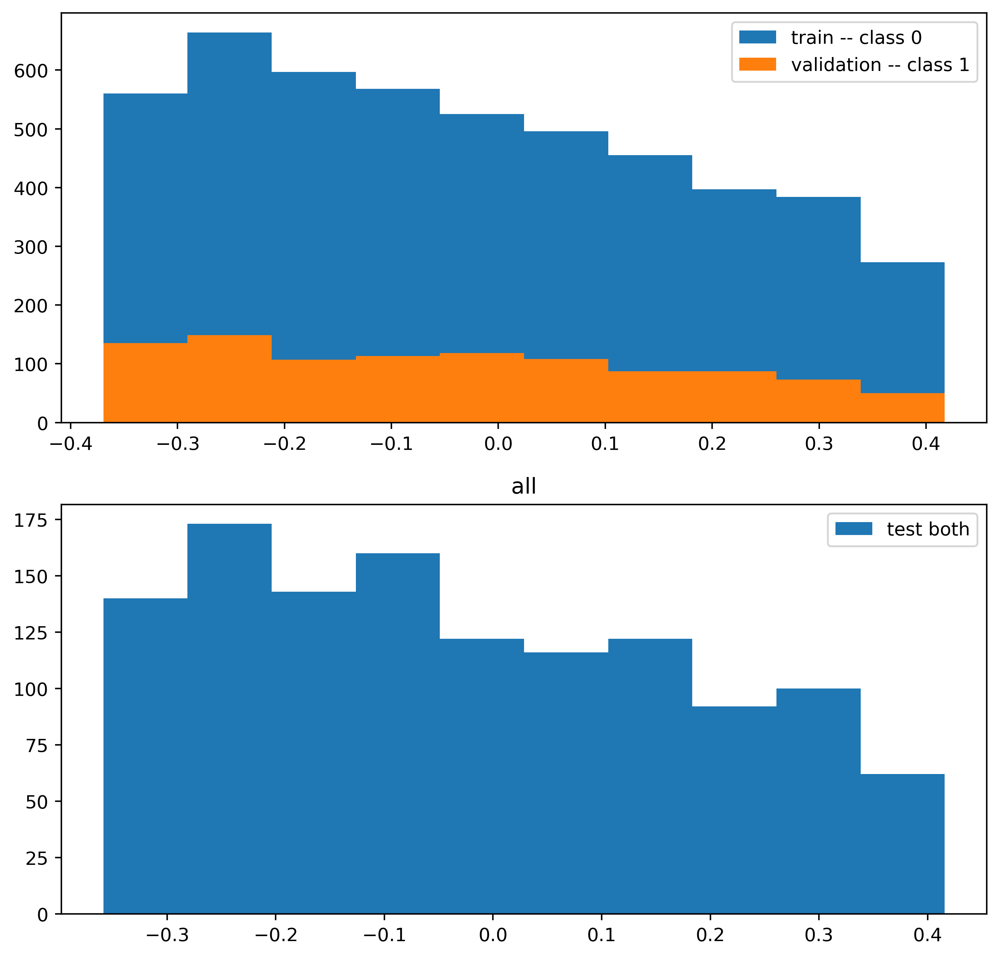

all:  90%|█████████ | 27001/30000 [6:35:06<1:02:49,  1.26s/it, train_loss=-1.82, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  90%|█████████ | 27101/30000 [6:36:33<42:03,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]  

New Model Temperature: 0.001


all:  91%|█████████ | 27201/30000 [6:38:00<40:35,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  91%|█████████ | 27301/30000 [6:39:27<38:59,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  91%|█████████▏| 27401/30000 [6:40:54<37:45,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  92%|█████████▏| 27501/30000 [6:42:21<36:11,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  92%|█████████▏| 27601/30000 [6:43:48<34:45,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  92%|█████████▏| 27701/30000 [6:45:15<33:23,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  93%|█████████▎| 27801/30000 [6:46:42<31:50,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  93%|█████████▎| 27901/30000 [6:48:09<30:50,  1.13it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  93%|█████████▎| 28000/30000 [6:49:36<29:03,  1.15it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


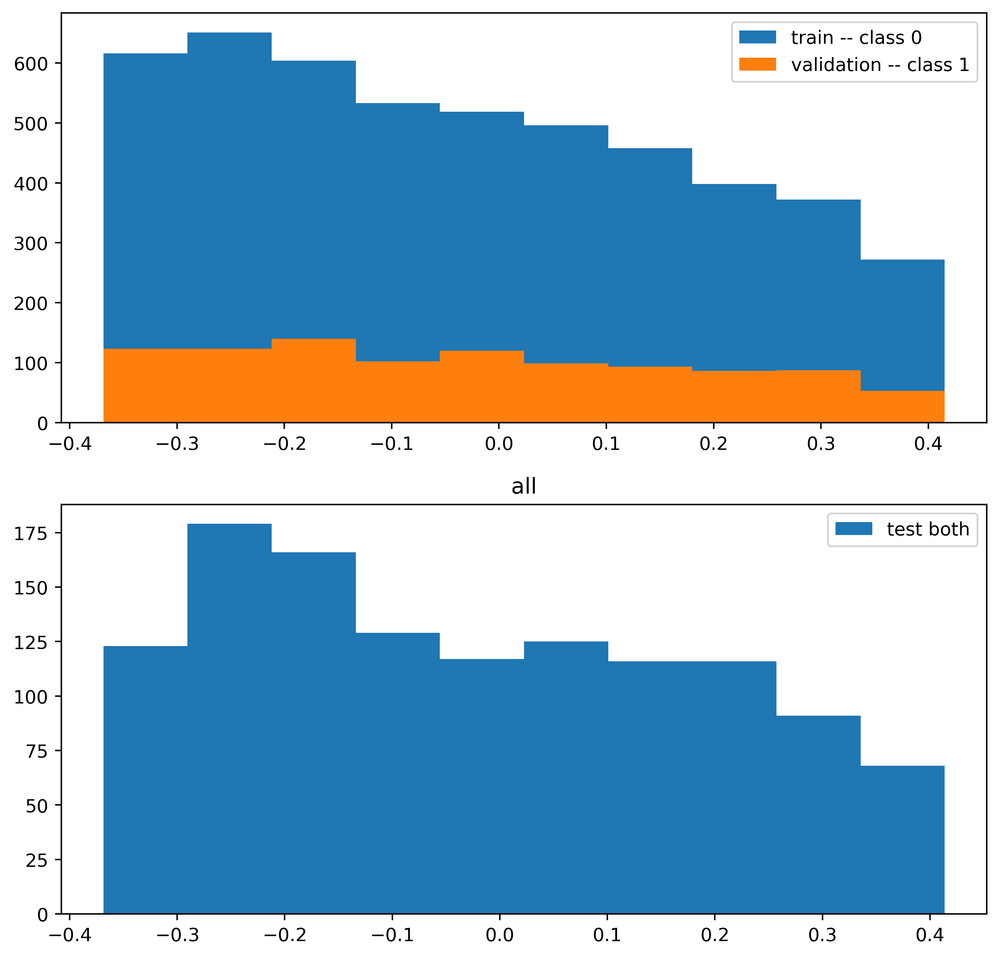

all:  93%|█████████▎| 28001/30000 [6:49:38<41:51,  1.26s/it, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  94%|█████████▎| 28101/30000 [6:51:06<28:05,  1.13it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  94%|█████████▍| 28201/30000 [6:52:35<26:30,  1.13it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  94%|█████████▍| 28301/30000 [6:54:03<25:00,  1.13it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  95%|█████████▍| 28401/30000 [6:55:32<23:36,  1.13it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  95%|█████████▌| 28501/30000 [6:57:00<22:09,  1.13it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  95%|█████████▌| 28601/30000 [6:58:28<20:32,  1.14it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  96%|█████████▌| 28701/30000 [6:59:57<19:09,  1.13it/s, train_loss=-1.75, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  96%|█████████▌| 28801/30000 [7:01:25<17:41,  1.13it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  96%|█████████▋| 28901/30000 [7:02:54<16:14,  1.13it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  97%|█████████▋| 29000/30000 [7:04:22<14:40,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


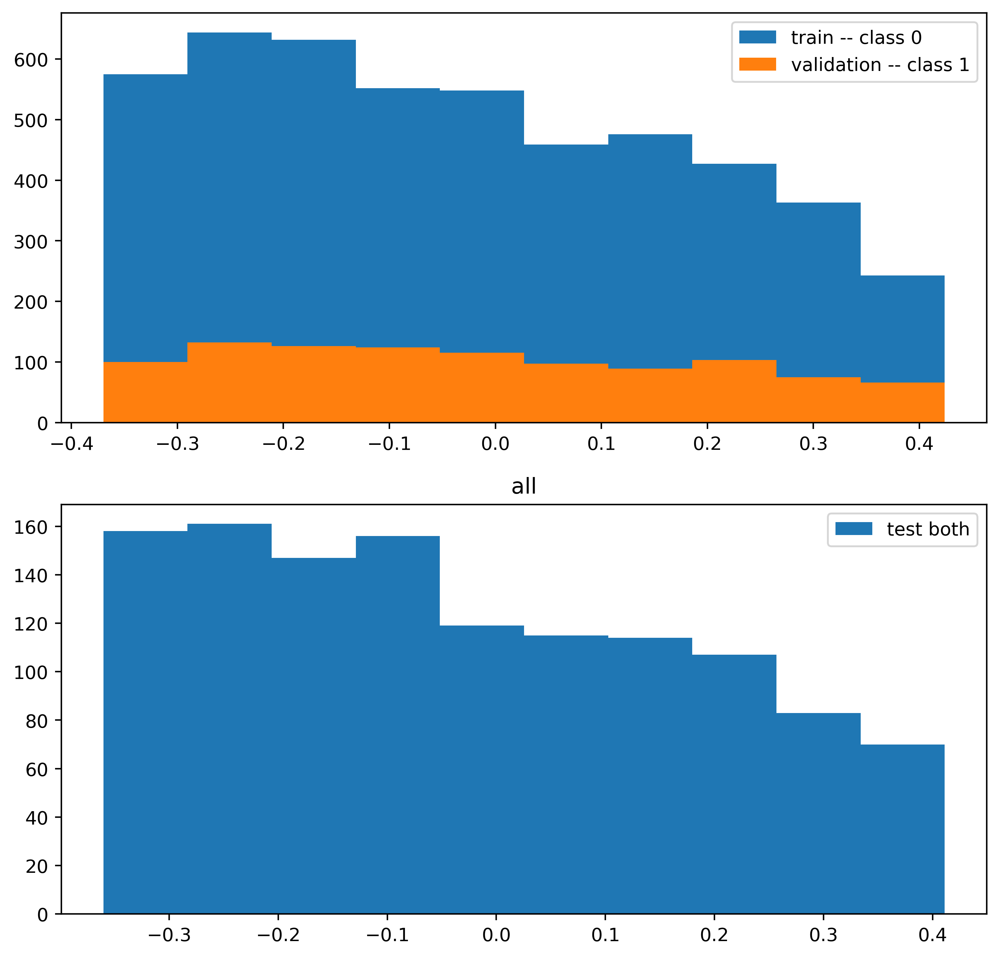

all:  97%|█████████▋| 29001/30000 [7:04:24<21:08,  1.27s/it, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.1976 f1 0.0000 recall 0.0000 prec 0.0000 [[243   0]
 [987   0]] 



all:  97%|█████████▋| 29101/30000 [7:05:51<13:05,  1.15it/s, train_loss=-1.79, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  97%|█████████▋| 29201/30000 [7:07:18<11:38,  1.14it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  98%|█████████▊| 29301/30000 [7:08:45<10:09,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  98%|█████████▊| 29401/30000 [7:10:13<08:41,  1.15it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  98%|█████████▊| 29501/30000 [7:11:40<07:14,  1.15it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  99%|█████████▊| 29601/30000 [7:13:07<05:48,  1.14it/s, train_loss=-1.76, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  99%|█████████▉| 29701/30000 [7:14:34<04:20,  1.15it/s, train_loss=-1.8, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  99%|█████████▉| 29801/30000 [7:16:02<02:54,  1.14it/s, train_loss=-1.77, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


all: 100%|█████████▉| 29901/30000 [7:17:29<01:26,  1.15it/s, train_loss=-1.78, train_acc=0.209, test_acc=0.198, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:   0%|          | 0/30000 [00:00<?, ?it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 1.0
1016 1016 1016
(array([0]), array([1016]))


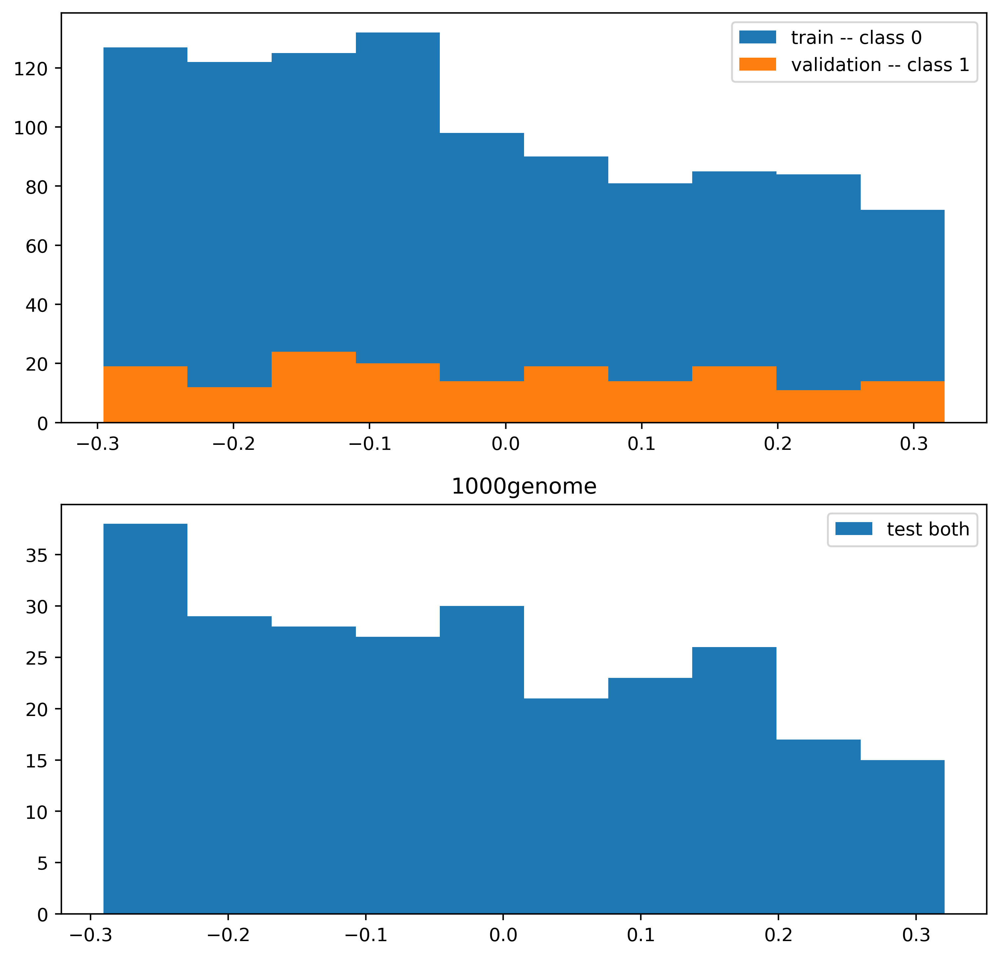

1000genome:   0%|          | 1/30000 [00:01<10:50:34,  1.30s/it, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:   0%|          | 101/30000 [00:26<2:05:20,  3.98it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.9801986733067553


1000genome:   1%|          | 201/30000 [00:51<2:04:21,  3.99it/s, train_loss=-1.69, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.9417645335842486


1000genome:   1%|          | 301/30000 [01:16<2:04:03,  3.99it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.8869204367171575


1000genome:   1%|▏         | 401/30000 [01:41<2:04:00,  3.98it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.8187307530779818


1000genome:   2%|▏         | 501/30000 [02:07<2:03:51,  3.97it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.7408182206817178


1000genome:   2%|▏         | 601/30000 [02:32<2:02:58,  3.98it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.6570468198150566


1000genome:   2%|▏         | 701/30000 [02:57<2:03:05,  3.97it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.5712090638488148


1000genome:   3%|▎         | 801/30000 [03:22<2:01:43,  4.00it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.48675225595997157


1000genome:   3%|▎         | 901/30000 [03:47<2:01:29,  3.99it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.40656965974059905


1000genome:   3%|▎         | 1000/30000 [04:12<2:01:29,  3.98it/s, train_loss=-1.7, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.3328710836980795
1016 1016 1016
(array([0]), array([1016]))


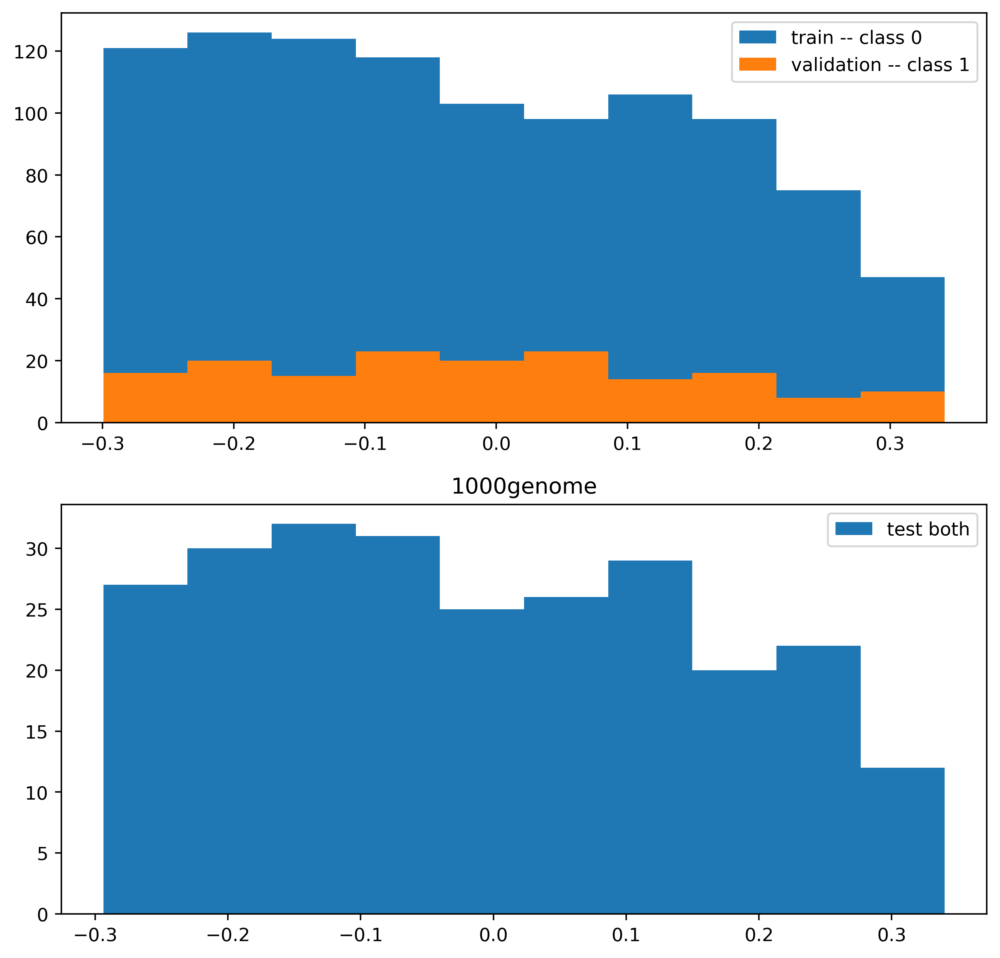

1000genome:   3%|▎         | 1001/30000 [04:13<4:26:42,  1.81it/s, train_loss=-1.7, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:   4%|▎         | 1101/30000 [04:37<1:55:44,  4.16it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.26713530196585034


1000genome:   4%|▍         | 1201/30000 [05:01<1:54:44,  4.18it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.2101360712007647


1000genome:   4%|▍         | 1301/30000 [05:25<1:56:24,  4.11it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.16202575093388072


1000genome:   5%|▍         | 1401/30000 [05:49<1:54:08,  4.18it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.12245642825298188


1000genome:   5%|▌         | 1501/30000 [06:13<1:53:43,  4.18it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.09071795328941248


1000genome:   5%|▌         | 1601/30000 [06:38<1:53:32,  4.17it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.06587475442640295


1000genome:   6%|▌         | 1701/30000 [07:02<1:52:31,  4.19it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.04688769521998848


1000genome:   6%|▌         | 1801/30000 [07:26<1:54:07,  4.12it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.032712434939019805


1000genome:   6%|▋         | 1901/30000 [07:50<1:56:11,  4.03it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.022370771856165587


1000genome:   7%|▋         | 2000/30000 [08:14<1:52:48,  4.14it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.014995576820477701
1016 1016 1016
(array([0]), array([1016]))


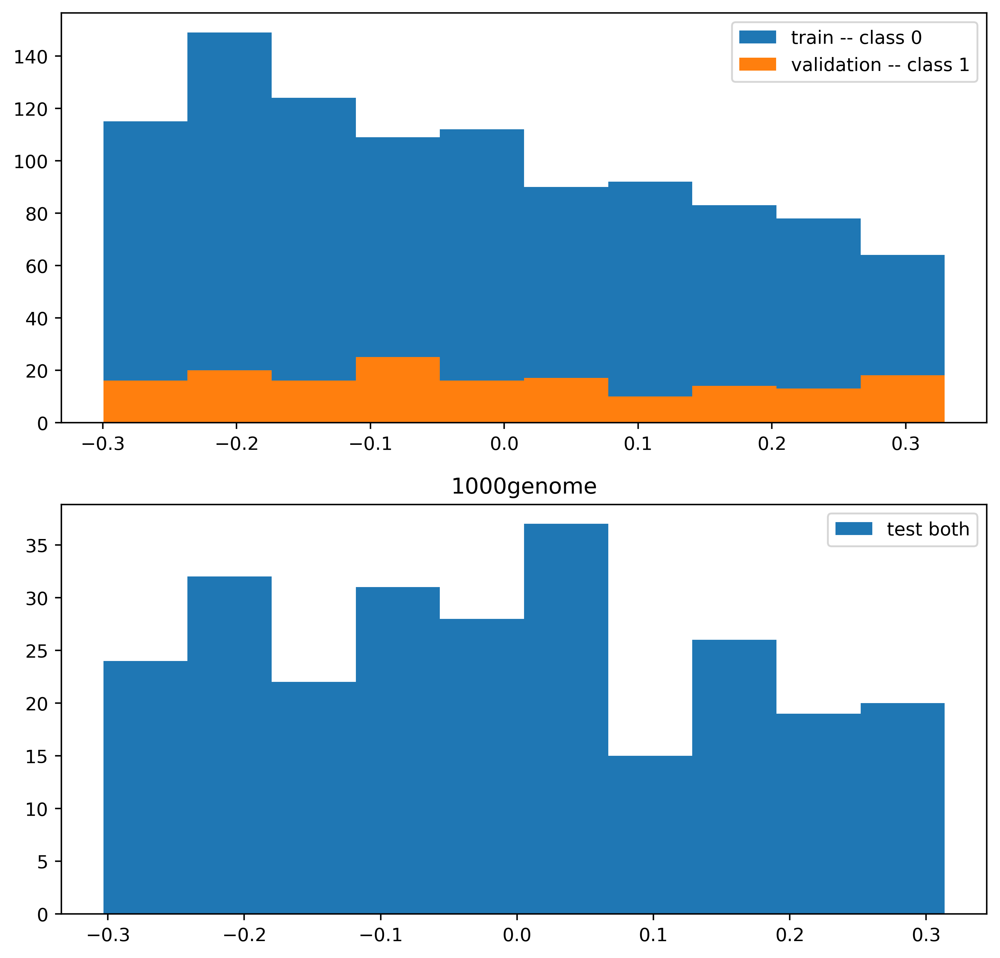

1000genome:   7%|▋         | 2001/30000 [08:15<4:13:57,  1.84it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:   7%|▋         | 2101/30000 [08:39<1:51:24,  4.17it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.009852796061187254


1000genome:   7%|▋         | 2201/30000 [09:03<1:50:09,  4.21it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.006345559512909111


1000genome:   8%|▊         | 2301/30000 [09:26<1:48:40,  4.25it/s, train_loss=-1.82, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.004005847942090417


1000genome:   8%|▊         | 2401/30000 [09:50<1:50:24,  4.17it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.002478752176666357


1000genome:   8%|▊         | 2501/30000 [10:14<1:48:43,  4.22it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.0015034391929775717


1000genome:   9%|▊         | 2601/30000 [10:38<1:48:41,  4.20it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:   9%|▉         | 2701/30000 [11:02<1:48:24,  4.20it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:   9%|▉         | 2801/30000 [11:25<1:47:50,  4.20it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  10%|▉         | 2901/30000 [11:50<1:49:53,  4.11it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  10%|█         | 3000/30000 [12:14<1:49:08,  4.12it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


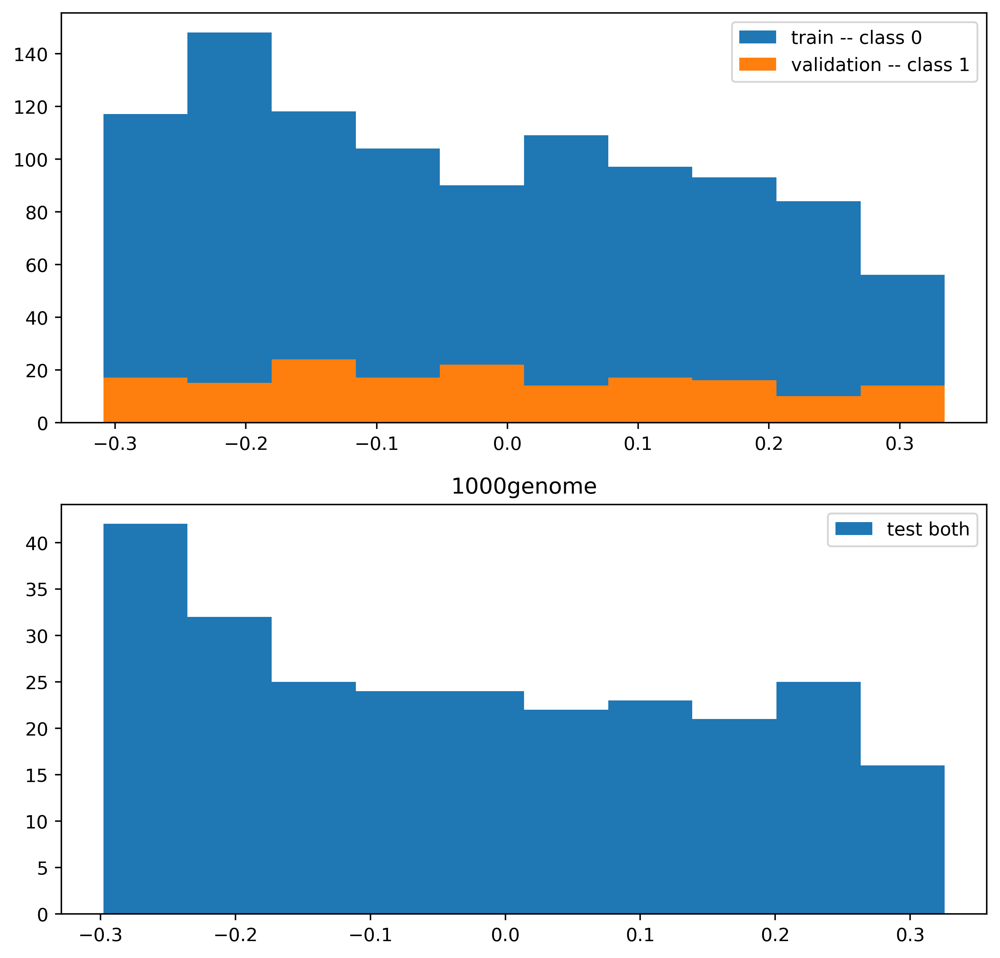

1000genome:  10%|█         | 3001/30000 [12:15<4:03:52,  1.85it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  10%|█         | 3101/30000 [12:39<1:49:39,  4.09it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  11%|█         | 3201/30000 [13:04<1:48:22,  4.12it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  11%|█         | 3301/30000 [13:28<1:48:29,  4.10it/s, train_loss=-1.83, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  11%|█▏        | 3401/30000 [13:52<1:47:28,  4.12it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  12%|█▏        | 3501/30000 [14:17<1:47:58,  4.09it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  12%|█▏        | 3601/30000 [14:41<1:46:50,  4.12it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  12%|█▏        | 3701/30000 [15:05<1:47:25,  4.08it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  13%|█▎        | 3801/30000 [15:30<1:46:40,  4.09it/s, train_loss=-1.82, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  13%|█▎        | 3901/30000 [15:54<1:45:52,  4.11it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  13%|█▎        | 4000/30000 [16:19<1:46:00,  4.09it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


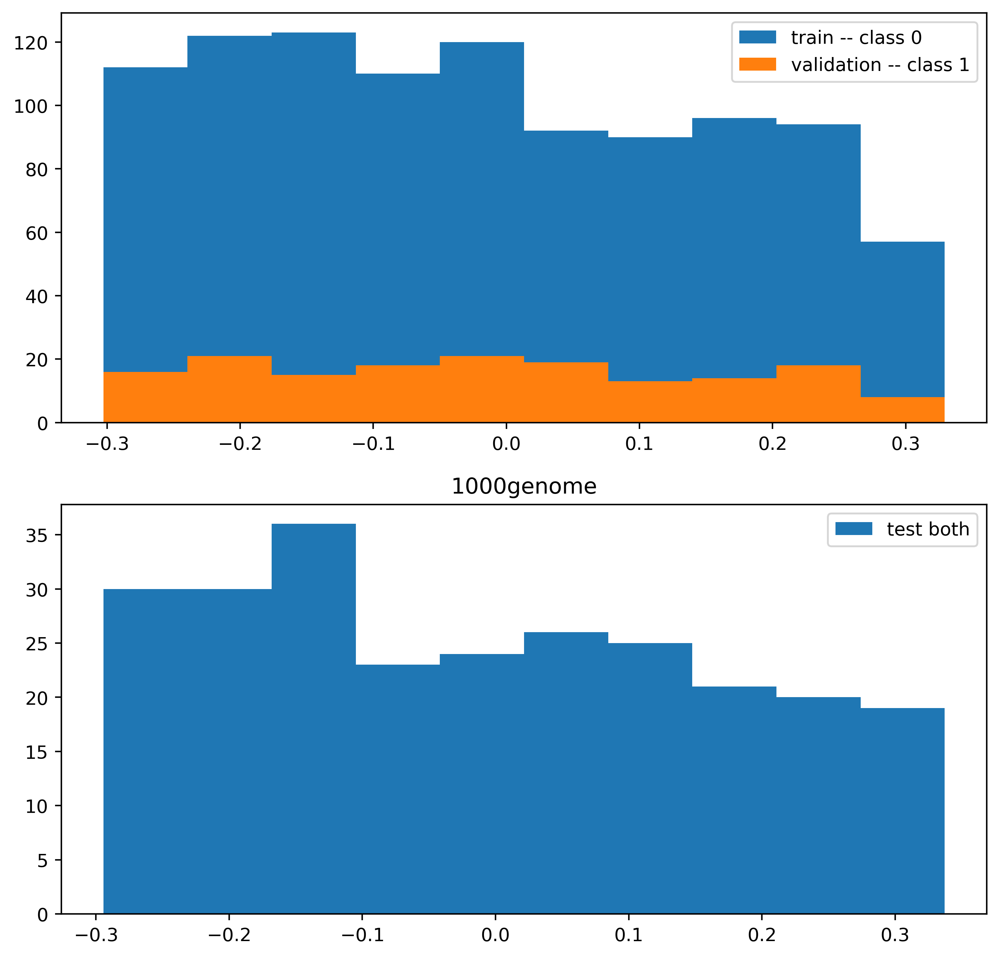

1000genome:  13%|█▎        | 4001/30000 [16:20<3:56:46,  1.83it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  14%|█▎        | 4101/30000 [16:44<1:44:29,  4.13it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  14%|█▍        | 4201/30000 [17:08<1:43:45,  4.14it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  14%|█▍        | 4301/30000 [17:32<1:43:03,  4.16it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  15%|█▍        | 4401/30000 [17:56<1:43:28,  4.12it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  15%|█▌        | 4501/30000 [18:21<1:42:33,  4.14it/s, train_loss=-1.68, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  15%|█▌        | 4601/30000 [18:45<1:42:08,  4.14it/s, train_loss=-1.71, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  16%|█▌        | 4701/30000 [19:09<1:42:01,  4.13it/s, train_loss=-1.84, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  16%|█▌        | 4801/30000 [19:33<1:42:10,  4.11it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  16%|█▋        | 4901/30000 [19:57<1:41:04,  4.14it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  17%|█▋        | 5000/30000 [20:22<1:40:28,  4.15it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


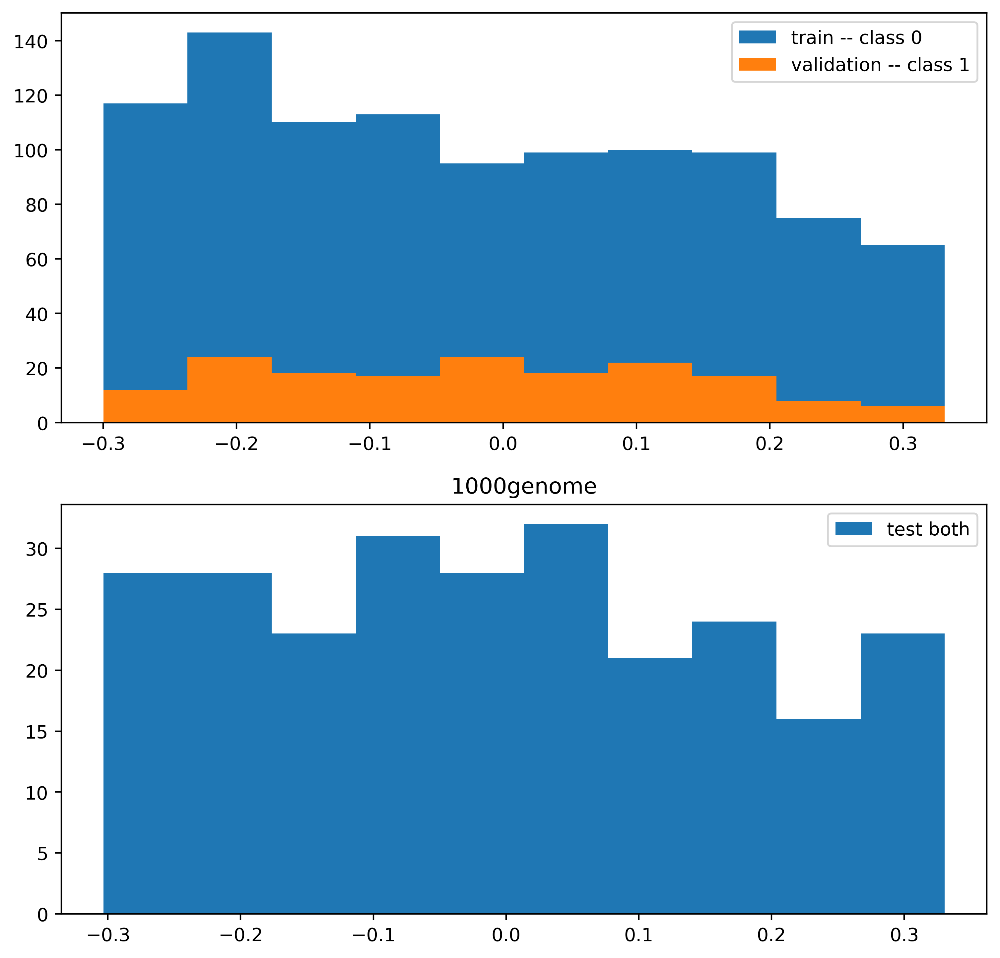

1000genome:  17%|█▋        | 5001/30000 [20:23<3:45:48,  1.85it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  17%|█▋        | 5101/30000 [20:47<1:38:56,  4.19it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  17%|█▋        | 5201/30000 [21:11<1:39:05,  4.17it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  18%|█▊        | 5301/30000 [21:34<1:38:48,  4.17it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  18%|█▊        | 5401/30000 [21:58<1:39:17,  4.13it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  18%|█▊        | 5501/30000 [22:22<1:37:31,  4.19it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  19%|█▊        | 5601/30000 [22:46<1:36:58,  4.19it/s, train_loss=-1.71, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  19%|█▉        | 5701/30000 [23:10<1:37:12,  4.17it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  19%|█▉        | 5801/30000 [23:34<1:36:22,  4.19it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  20%|█▉        | 5901/30000 [23:58<1:36:04,  4.18it/s, train_loss=-1.7, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  20%|██        | 6000/30000 [24:23<1:36:54,  4.13it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


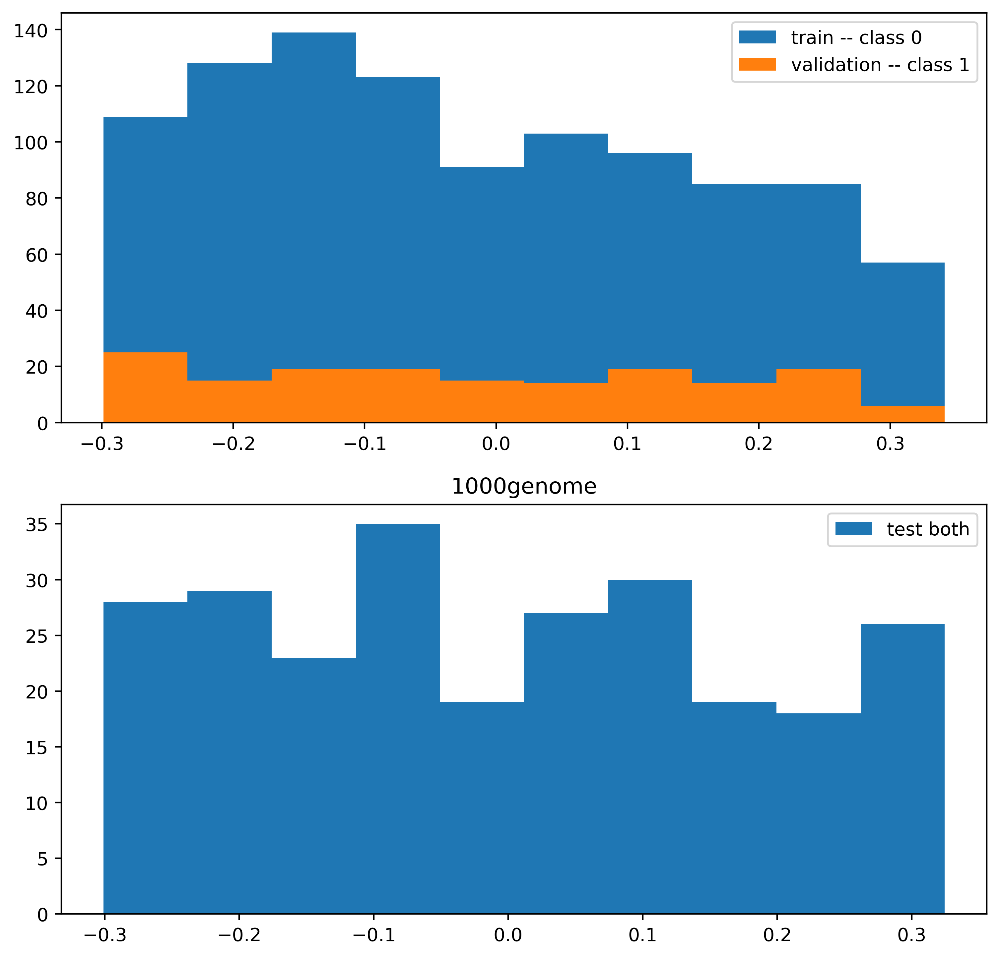

1000genome:  20%|██        | 6001/30000 [24:24<3:38:19,  1.83it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  20%|██        | 6101/30000 [24:48<1:36:11,  4.14it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  21%|██        | 6201/30000 [25:12<1:34:52,  4.18it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  21%|██        | 6301/30000 [25:36<1:34:59,  4.16it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  21%|██▏       | 6401/30000 [26:00<1:34:57,  4.14it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  22%|██▏       | 6501/30000 [26:24<1:34:01,  4.17it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  22%|██▏       | 6601/30000 [26:49<1:33:26,  4.17it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  22%|██▏       | 6701/30000 [27:13<1:33:51,  4.14it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  23%|██▎       | 6801/30000 [27:37<1:33:08,  4.15it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  23%|██▎       | 6901/30000 [28:01<1:32:57,  4.14it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  23%|██▎       | 7000/30000 [28:25<1:31:55,  4.17it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


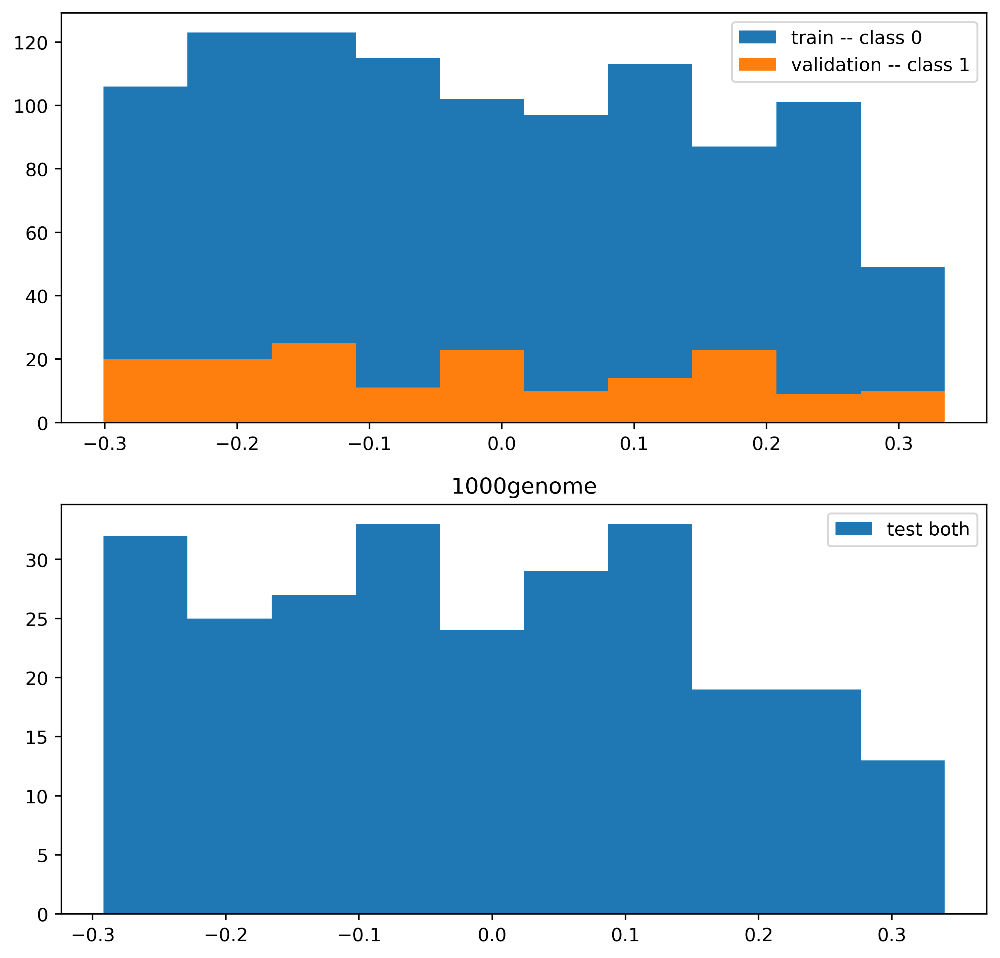

1000genome:  23%|██▎       | 7001/30000 [28:26<3:26:49,  1.85it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  24%|██▎       | 7101/30000 [28:50<1:32:04,  4.14it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  24%|██▍       | 7201/30000 [29:14<1:30:43,  4.19it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  24%|██▍       | 7301/30000 [29:38<1:30:02,  4.20it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  25%|██▍       | 7401/30000 [30:02<1:31:36,  4.11it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  25%|██▌       | 7501/30000 [30:26<1:29:42,  4.18it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  25%|██▌       | 7601/30000 [30:50<1:29:20,  4.18it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  26%|██▌       | 7701/30000 [31:14<1:29:02,  4.17it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  26%|██▌       | 7801/30000 [31:38<1:28:44,  4.17it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  26%|██▋       | 7901/30000 [32:02<1:28:09,  4.18it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  27%|██▋       | 8000/30000 [32:26<1:27:34,  4.19it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


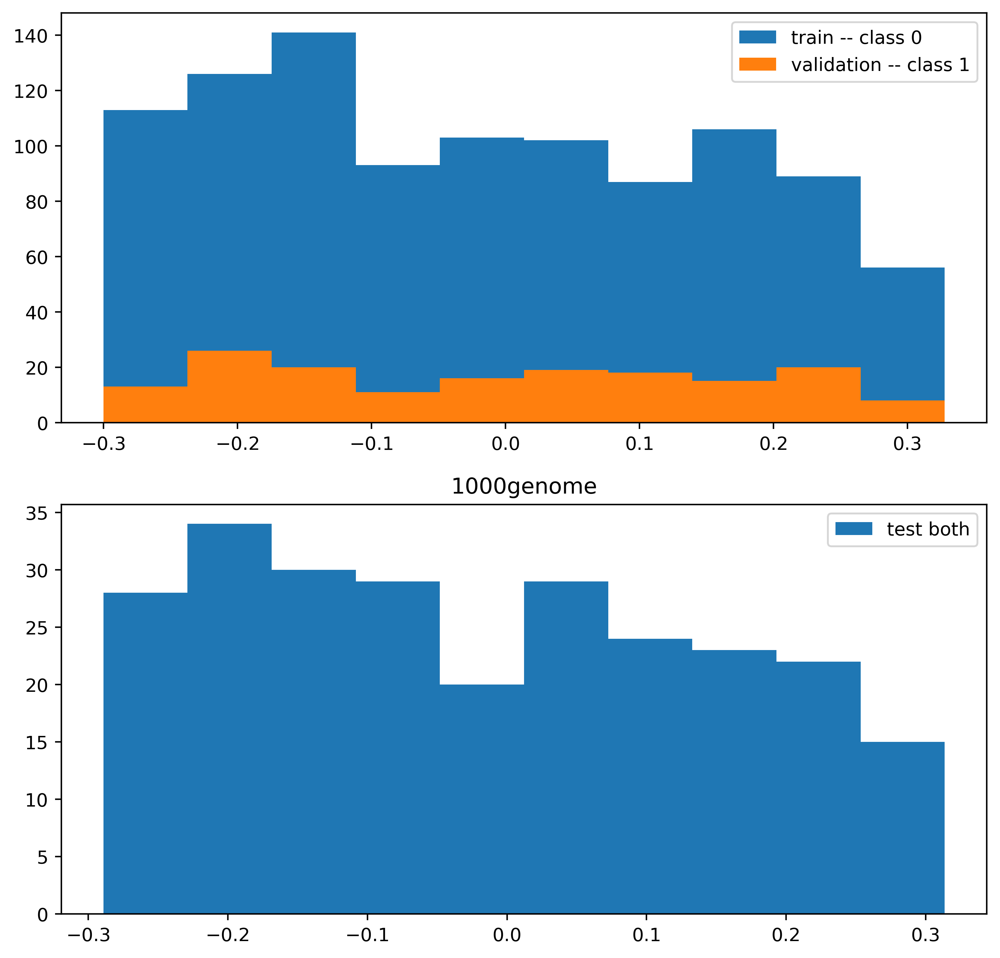

1000genome:  27%|██▋       | 8001/30000 [32:27<3:17:23,  1.86it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  27%|██▋       | 8101/30000 [32:51<1:28:03,  4.14it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  27%|██▋       | 8201/30000 [33:15<1:26:33,  4.20it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  28%|██▊       | 8301/30000 [33:39<1:26:58,  4.16it/s, train_loss=-1.69, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  28%|██▊       | 8401/30000 [34:03<1:26:36,  4.16it/s, train_loss=-1.7, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  28%|██▊       | 8501/30000 [34:27<1:26:10,  4.16it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  29%|██▊       | 8601/30000 [34:51<1:25:00,  4.20it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  29%|██▉       | 8701/30000 [35:15<1:25:22,  4.16it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  29%|██▉       | 8801/30000 [35:39<1:25:27,  4.13it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  30%|██▉       | 8901/30000 [36:03<1:24:03,  4.18it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  30%|███       | 9000/30000 [36:27<1:23:39,  4.18it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


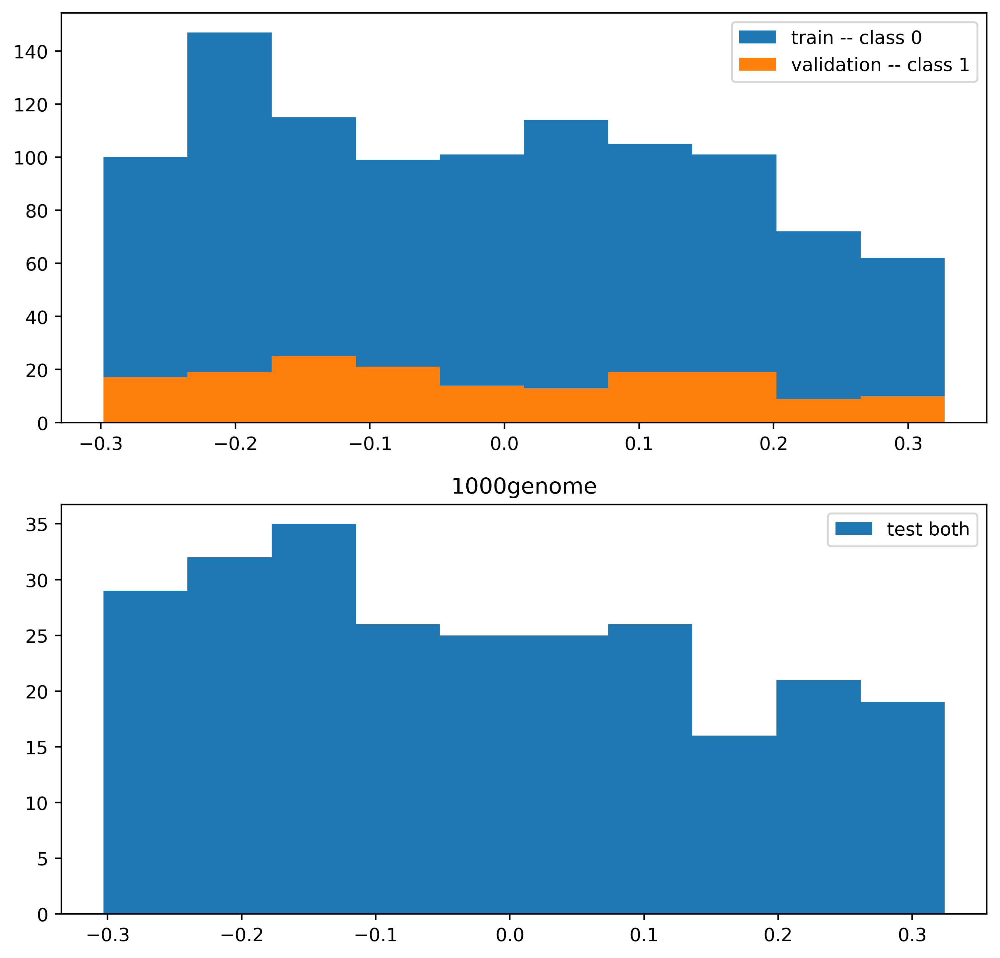

1000genome:  30%|███       | 9001/30000 [36:28<3:17:31,  1.77it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  30%|███       | 9101/30000 [36:52<1:23:47,  4.16it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  31%|███       | 9201/30000 [37:16<1:23:32,  4.15it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  31%|███       | 9301/30000 [37:40<1:24:18,  4.09it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  31%|███▏      | 9401/30000 [38:05<1:22:53,  4.14it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  32%|███▏      | 9501/30000 [38:29<1:22:17,  4.15it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  32%|███▏      | 9601/30000 [38:53<1:22:15,  4.13it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  32%|███▏      | 9701/30000 [39:17<1:21:29,  4.15it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  33%|███▎      | 9801/30000 [39:41<1:21:13,  4.14it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  33%|███▎      | 9901/30000 [40:06<1:21:08,  4.13it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  33%|███▎      | 10000/30000 [40:30<1:20:05,  4.16it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


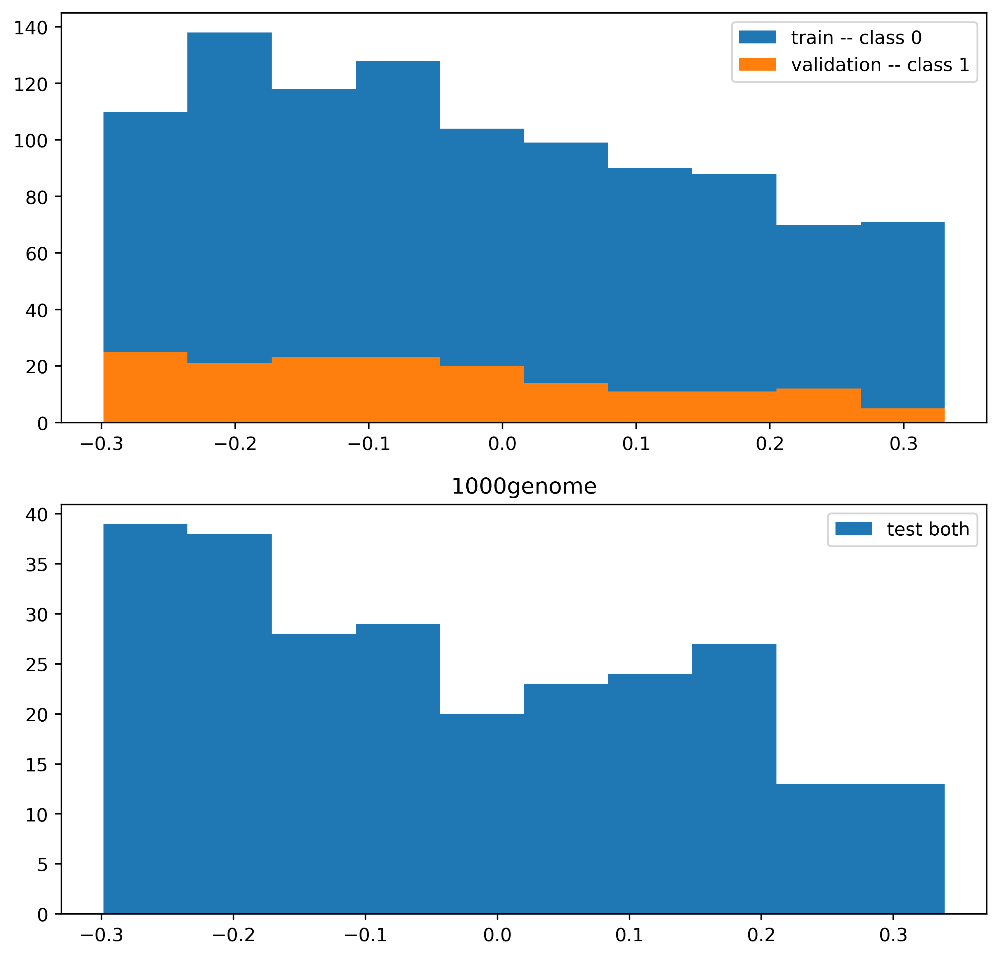

1000genome:  33%|███▎      | 10001/30000 [40:31<3:03:21,  1.82it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  34%|███▎      | 10101/30000 [40:55<1:20:01,  4.14it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  34%|███▍      | 10201/30000 [41:19<1:19:24,  4.16it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  34%|███▍      | 10301/30000 [41:43<1:18:56,  4.16it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  35%|███▍      | 10401/30000 [42:07<1:18:42,  4.15it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  35%|███▌      | 10501/30000 [42:31<1:17:41,  4.18it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  35%|███▌      | 10601/30000 [42:56<1:18:12,  4.13it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  36%|███▌      | 10701/30000 [43:20<1:17:25,  4.15it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  36%|███▌      | 10801/30000 [43:44<1:16:55,  4.16it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  36%|███▋      | 10901/30000 [44:08<1:16:33,  4.16it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  37%|███▋      | 11000/30000 [44:32<1:15:57,  4.17it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


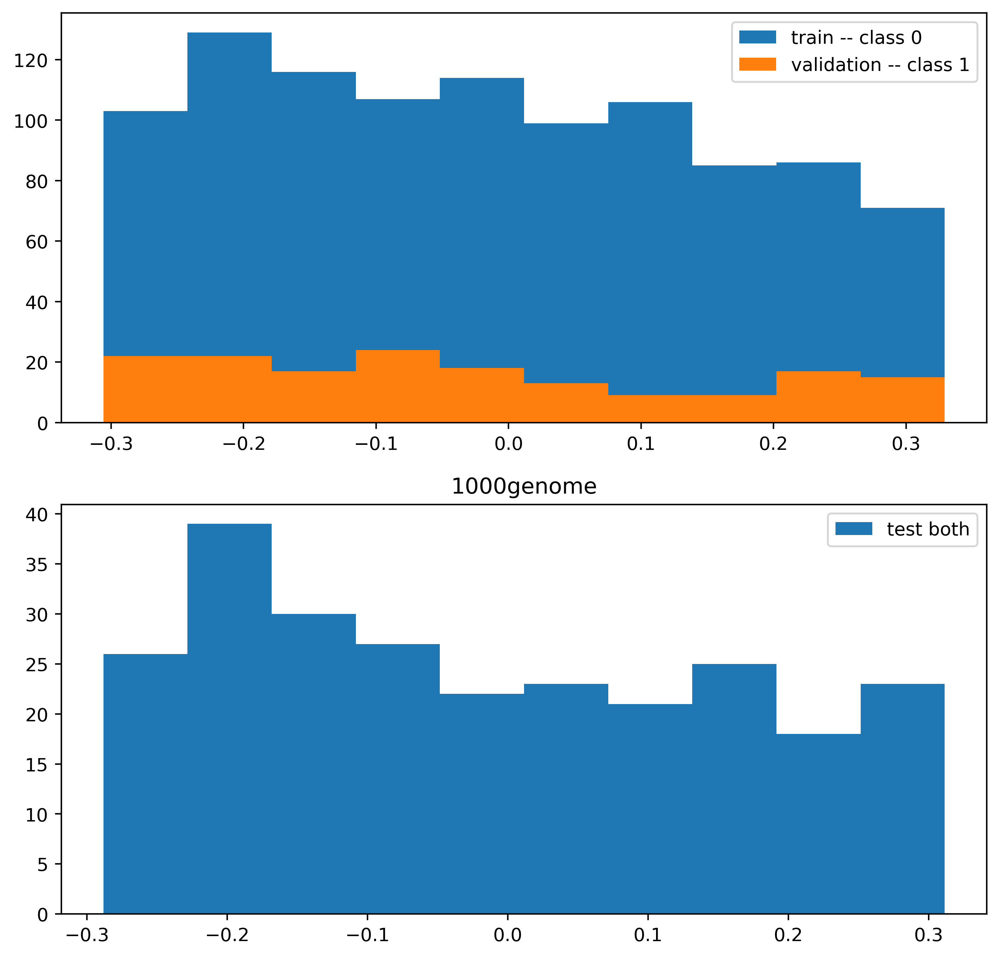

1000genome:  37%|███▋      | 11001/30000 [44:33<2:52:05,  1.84it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  37%|███▋      | 11101/30000 [44:57<1:15:11,  4.19it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  37%|███▋      | 11201/30000 [45:21<1:14:16,  4.22it/s, train_loss=-1.71, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  38%|███▊      | 11301/30000 [45:45<1:13:47,  4.22it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  38%|███▊      | 11401/30000 [46:09<1:13:39,  4.21it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  38%|███▊      | 11501/30000 [46:32<1:13:47,  4.18it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  39%|███▊      | 11601/30000 [46:56<1:13:15,  4.19it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  39%|███▉      | 11701/30000 [47:20<1:12:41,  4.20it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  39%|███▉      | 11801/30000 [47:44<1:12:17,  4.20it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  40%|███▉      | 11901/30000 [48:08<1:11:30,  4.22it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  40%|████      | 12000/30000 [48:32<1:10:58,  4.23it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


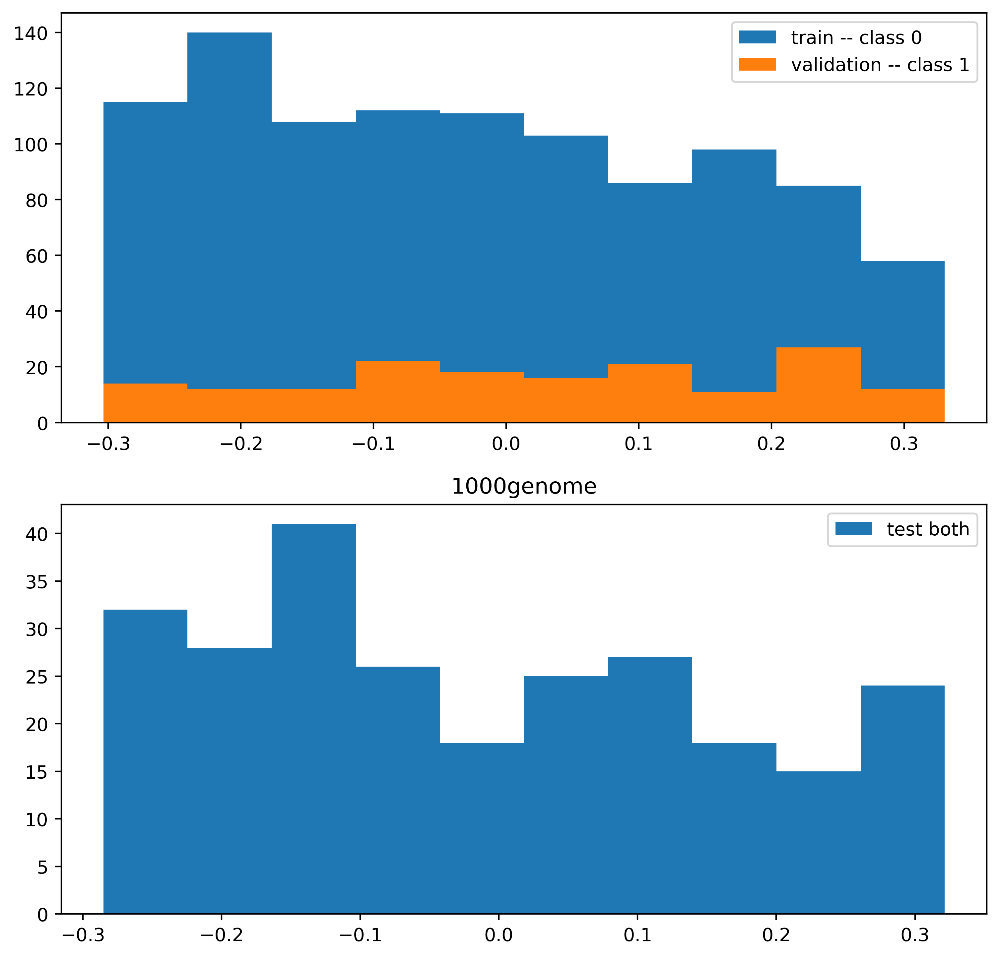

1000genome:  40%|████      | 12001/30000 [48:33<2:40:31,  1.87it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  40%|████      | 12101/30000 [48:57<1:12:08,  4.14it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  41%|████      | 12201/30000 [49:21<1:11:34,  4.14it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  41%|████      | 12301/30000 [49:45<1:11:34,  4.12it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  41%|████▏     | 12401/30000 [50:10<1:10:37,  4.15it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  42%|████▏     | 12501/30000 [50:34<1:10:23,  4.14it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  42%|████▏     | 12601/30000 [50:58<1:10:12,  4.13it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  42%|████▏     | 12701/30000 [51:22<1:09:43,  4.14it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  43%|████▎     | 12801/30000 [51:46<1:09:10,  4.14it/s, train_loss=-1.83, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  43%|████▎     | 12901/30000 [52:11<1:09:11,  4.12it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  43%|████▎     | 13000/30000 [52:35<1:08:59,  4.11it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


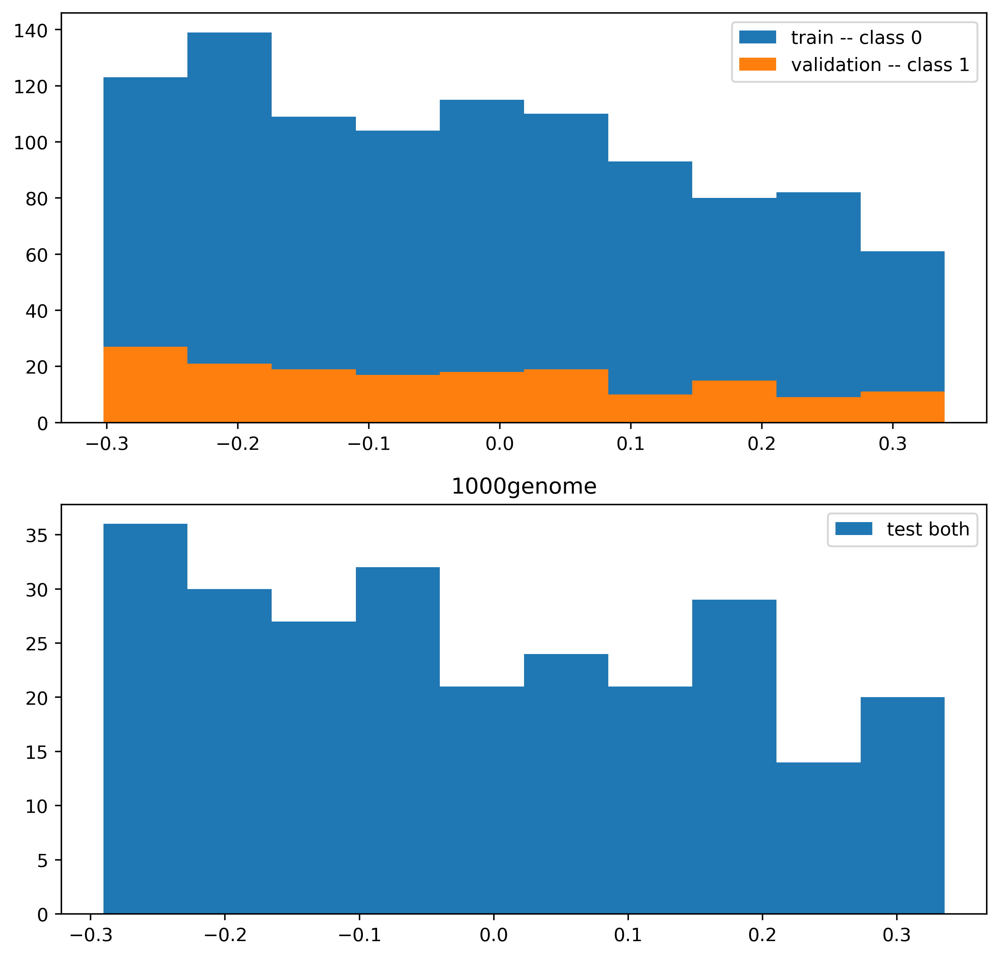

1000genome:  43%|████▎     | 13001/30000 [52:36<2:36:25,  1.81it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  44%|████▎     | 13101/30000 [53:00<1:08:42,  4.10it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  44%|████▍     | 13201/30000 [53:25<1:07:46,  4.13it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  44%|████▍     | 13301/30000 [53:49<1:07:11,  4.14it/s, train_loss=-1.84, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  45%|████▍     | 13401/30000 [54:13<1:07:24,  4.10it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  45%|████▌     | 13501/30000 [54:38<1:07:02,  4.10it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  45%|████▌     | 13601/30000 [55:02<1:06:07,  4.13it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  46%|████▌     | 13701/30000 [55:26<1:05:50,  4.13it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  46%|████▌     | 13801/30000 [55:51<1:05:46,  4.10it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  46%|████▋     | 13901/30000 [56:15<1:05:01,  4.13it/s, train_loss=-1.82, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  47%|████▋     | 14000/30000 [56:39<1:04:58,  4.10it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


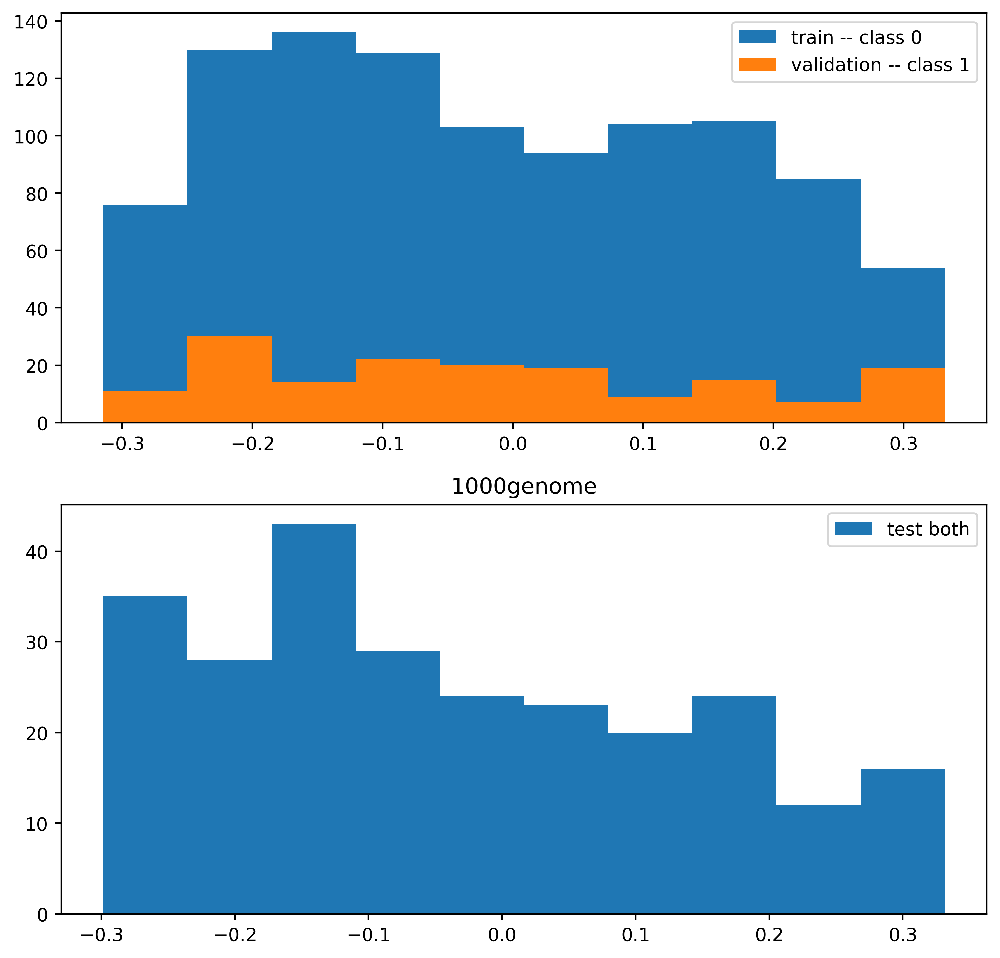

1000genome:  47%|████▋     | 14001/30000 [56:40<2:24:36,  1.84it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  47%|████▋     | 14101/30000 [57:05<1:03:44,  4.16it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  47%|████▋     | 14201/30000 [57:29<1:03:13,  4.16it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  48%|████▊     | 14301/30000 [57:53<1:03:36,  4.11it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  48%|████▊     | 14401/30000 [58:17<1:02:35,  4.15it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  48%|████▊     | 14501/30000 [58:41<1:02:37,  4.12it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  49%|████▊     | 14601/30000 [59:06<1:01:36,  4.17it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  49%|████▉     | 14701/30000 [59:30<1:01:20,  4.16it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  49%|████▉     | 14801/30000 [59:54<1:00:50,  4.16it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  50%|████▉     | 14901/30000 [1:00:18<1:00:25,  4.16it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  50%|█████     | 15000/30000 [1:00:42<1:00:08,  4.16it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


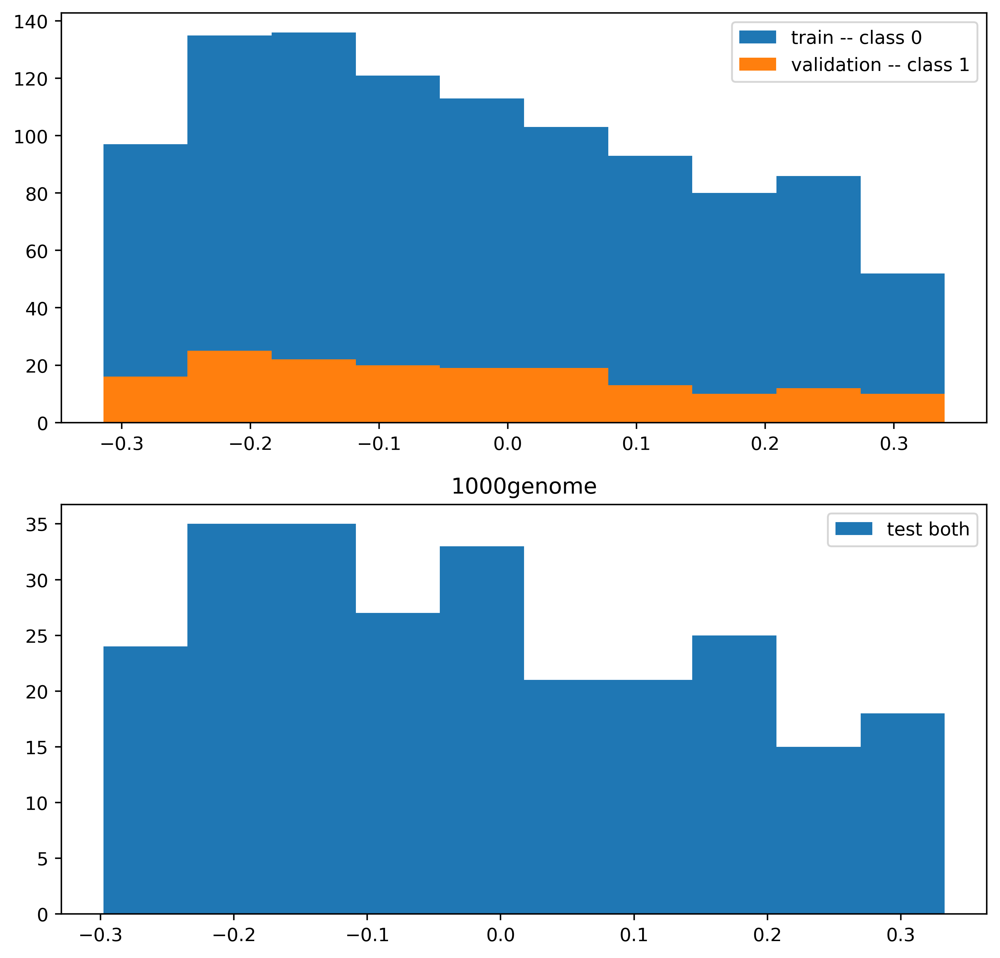

1000genome:  50%|█████     | 15001/30000 [1:00:43<2:15:54,  1.84it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  50%|█████     | 15101/30000 [1:01:07<59:11,  4.20it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  51%|█████     | 15201/30000 [1:01:31<59:20,  4.16it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  51%|█████     | 15301/30000 [1:01:56<59:10,  4.14it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  51%|█████▏    | 15401/30000 [1:02:20<58:40,  4.15it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  52%|█████▏    | 15501/30000 [1:02:44<58:05,  4.16it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  52%|█████▏    | 15601/30000 [1:03:08<57:29,  4.17it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  52%|█████▏    | 15701/30000 [1:03:32<57:21,  4.15it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  53%|█████▎    | 15801/30000 [1:03:56<56:48,  4.17it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  53%|█████▎    | 15901/30000 [1:04:20<57:05,  4.12it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  53%|█████▎    | 16000/30000 [1:04:44<56:12,  4.15it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


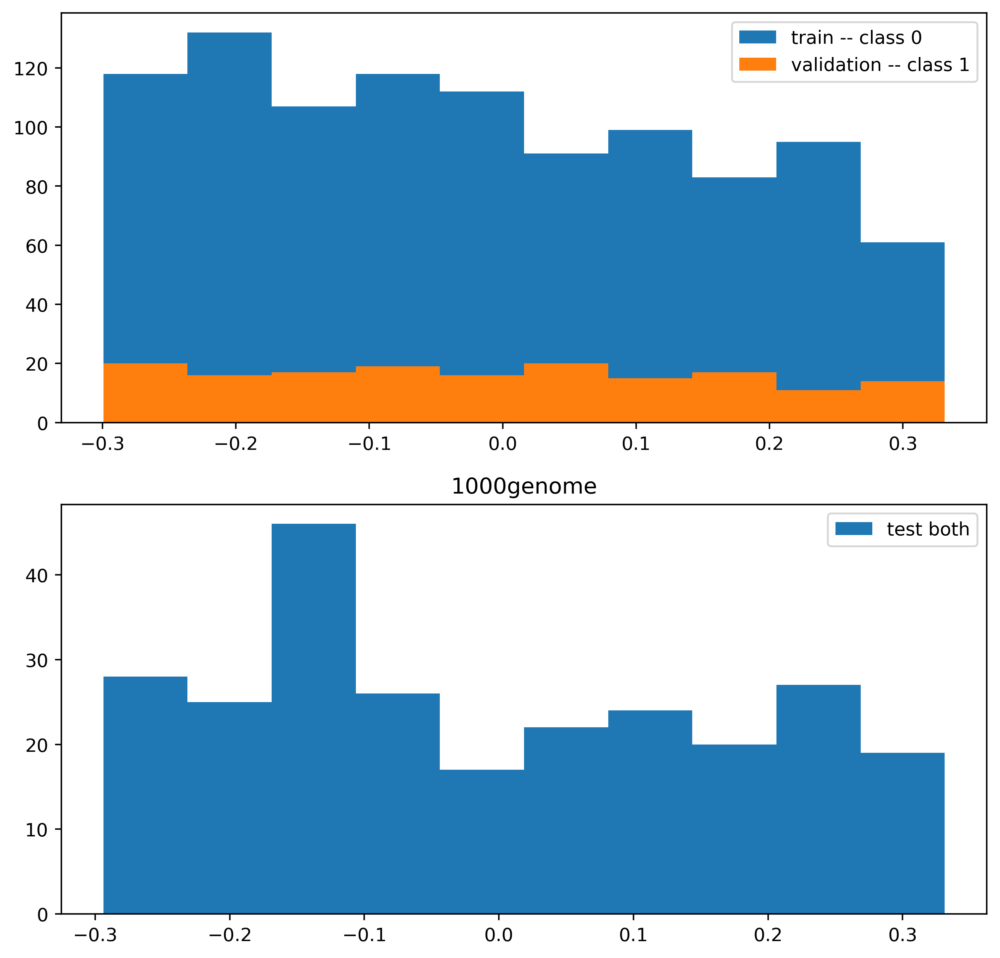

1000genome:  53%|█████▎    | 16001/30000 [1:04:45<2:05:52,  1.85it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  54%|█████▎    | 16101/30000 [1:05:09<55:33,  4.17it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  54%|█████▍    | 16201/30000 [1:05:34<55:12,  4.17it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  54%|█████▍    | 16301/30000 [1:05:58<54:48,  4.17it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  55%|█████▍    | 16401/30000 [1:06:22<54:14,  4.18it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  55%|█████▌    | 16501/30000 [1:06:46<54:25,  4.13it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  55%|█████▌    | 16601/30000 [1:07:10<53:46,  4.15it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  56%|█████▌    | 16701/30000 [1:07:34<53:02,  4.18it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  56%|█████▌    | 16801/30000 [1:07:58<55:03,  4.00it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  56%|█████▋    | 16901/30000 [1:08:22<52:08,  4.19it/s, train_loss=-1.82, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  57%|█████▋    | 17000/30000 [1:08:46<51:48,  4.18it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


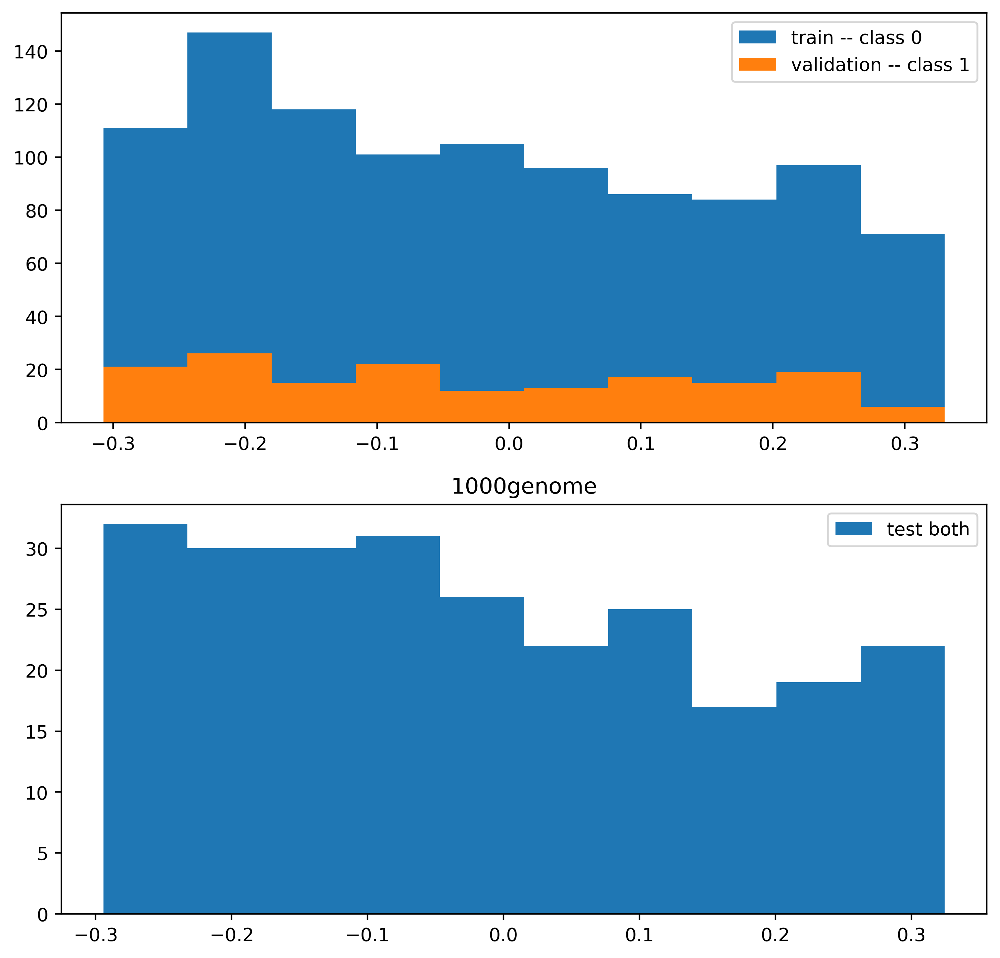

1000genome:  57%|█████▋    | 17001/30000 [1:08:47<1:56:55,  1.85it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  57%|█████▋    | 17101/30000 [1:09:11<51:13,  4.20it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  57%|█████▋    | 17201/30000 [1:09:35<50:51,  4.19it/s, train_loss=-1.71, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  58%|█████▊    | 17301/30000 [1:09:58<50:28,  4.19it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  58%|█████▊    | 17401/30000 [1:10:22<50:03,  4.20it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  58%|█████▊    | 17501/30000 [1:10:46<49:47,  4.18it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  59%|█████▊    | 17601/30000 [1:11:10<49:18,  4.19it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  59%|█████▉    | 17701/30000 [1:11:34<48:36,  4.22it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  59%|█████▉    | 17801/30000 [1:11:58<48:29,  4.19it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  60%|█████▉    | 17901/30000 [1:12:22<48:00,  4.20it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  60%|██████    | 18000/30000 [1:12:46<47:33,  4.20it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


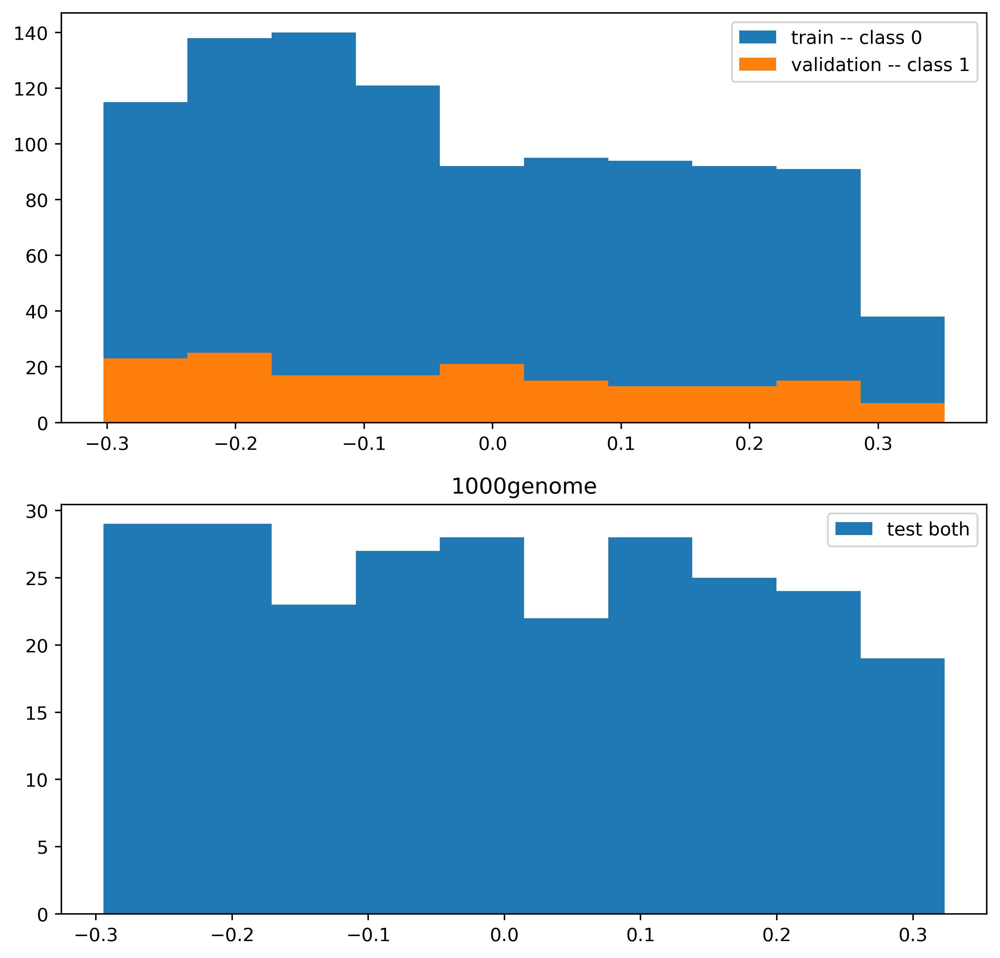

1000genome:  60%|██████    | 18001/30000 [1:12:47<1:47:32,  1.86it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  60%|██████    | 18101/30000 [1:13:10<46:49,  4.24it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  61%|██████    | 18201/30000 [1:13:34<46:10,  4.26it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  61%|██████    | 18301/30000 [1:13:58<46:25,  4.20it/s, train_loss=-1.82, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  61%|██████▏   | 18401/30000 [1:14:22<46:26,  4.16it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  62%|██████▏   | 18501/30000 [1:14:46<46:26,  4.13it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  62%|██████▏   | 18601/30000 [1:15:10<45:40,  4.16it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  62%|██████▏   | 18701/30000 [1:15:34<44:43,  4.21it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  63%|██████▎   | 18801/30000 [1:15:58<44:35,  4.19it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  63%|██████▎   | 18901/30000 [1:16:22<44:26,  4.16it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  63%|██████▎   | 19000/30000 [1:16:46<43:51,  4.18it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


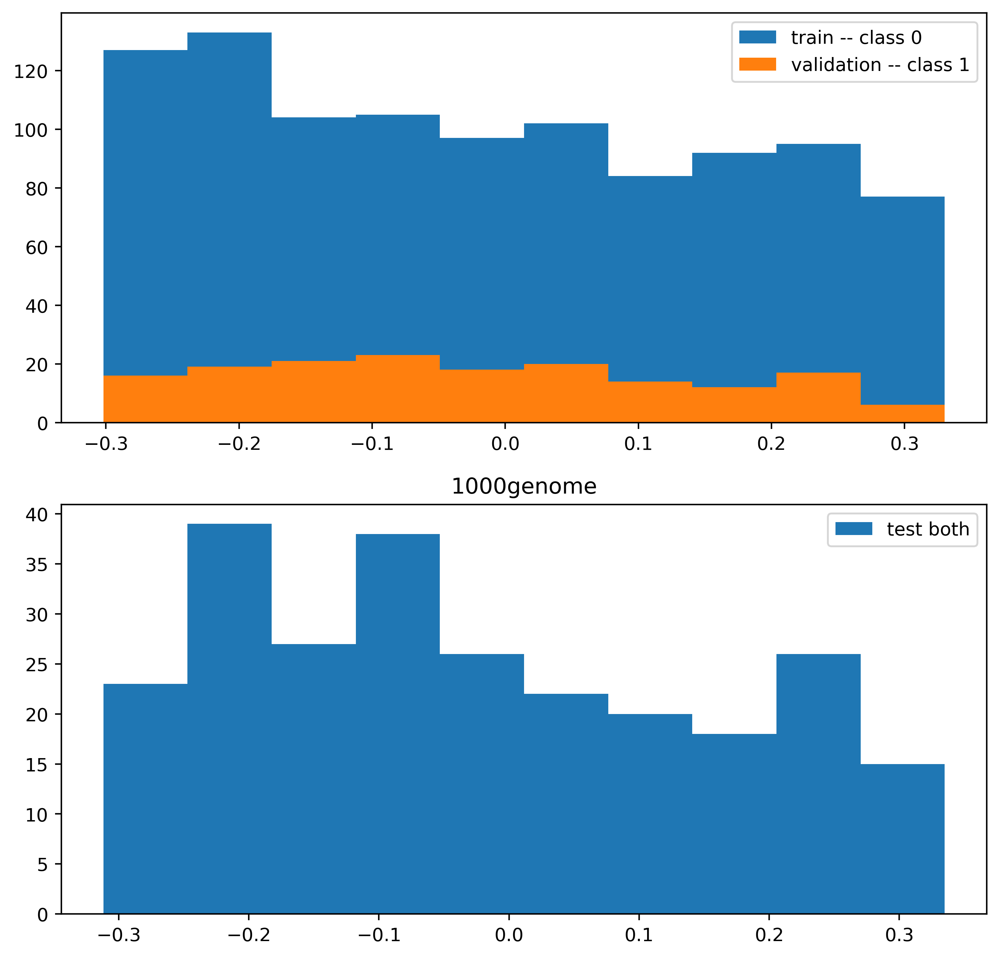

1000genome:  63%|██████▎   | 19001/30000 [1:16:47<1:40:03,  1.83it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  64%|██████▎   | 19101/30000 [1:17:11<43:27,  4.18it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  64%|██████▍   | 19201/30000 [1:17:35<43:08,  4.17it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  64%|██████▍   | 19301/30000 [1:17:59<43:02,  4.14it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  65%|██████▍   | 19401/30000 [1:18:23<42:27,  4.16it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  65%|██████▌   | 19501/30000 [1:18:47<41:58,  4.17it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  65%|██████▌   | 19601/30000 [1:19:11<41:48,  4.14it/s, train_loss=-1.84, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  66%|██████▌   | 19701/30000 [1:19:35<41:20,  4.15it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  66%|██████▌   | 19801/30000 [1:19:59<40:27,  4.20it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  66%|██████▋   | 19901/30000 [1:20:23<40:21,  4.17it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  67%|██████▋   | 20000/30000 [1:20:47<40:07,  4.15it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


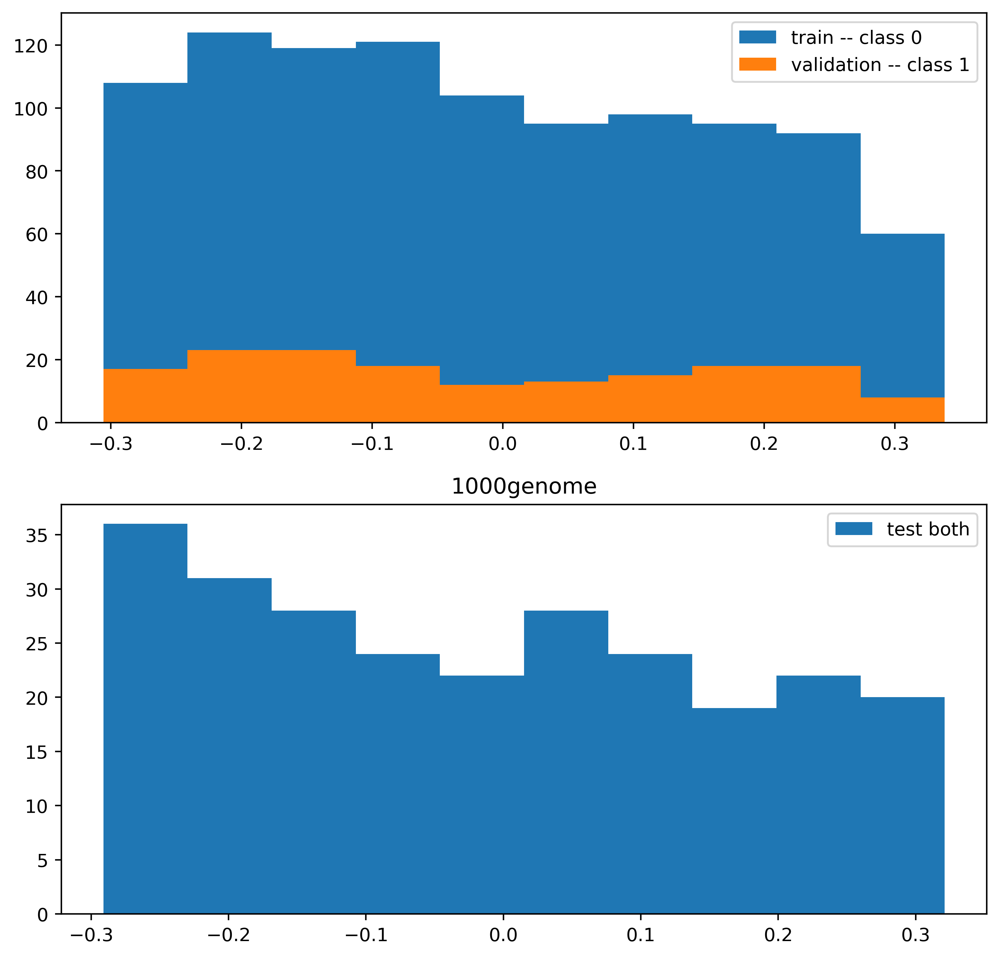

1000genome:  67%|██████▋   | 20001/30000 [1:20:48<1:29:35,  1.86it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  67%|██████▋   | 20101/30000 [1:21:12<39:52,  4.14it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  67%|██████▋   | 20201/30000 [1:21:36<38:56,  4.19it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  68%|██████▊   | 20301/30000 [1:22:00<38:40,  4.18it/s, train_loss=-1.82, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  68%|██████▊   | 20401/30000 [1:22:24<38:18,  4.18it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  68%|██████▊   | 20501/30000 [1:22:48<37:49,  4.18it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  69%|██████▊   | 20601/30000 [1:23:12<37:16,  4.20it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  69%|██████▉   | 20701/30000 [1:23:36<36:41,  4.22it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  69%|██████▉   | 20801/30000 [1:24:00<36:29,  4.20it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  70%|██████▉   | 20901/30000 [1:24:24<36:21,  4.17it/s, train_loss=-1.68, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  70%|███████   | 21000/30000 [1:24:48<35:55,  4.17it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


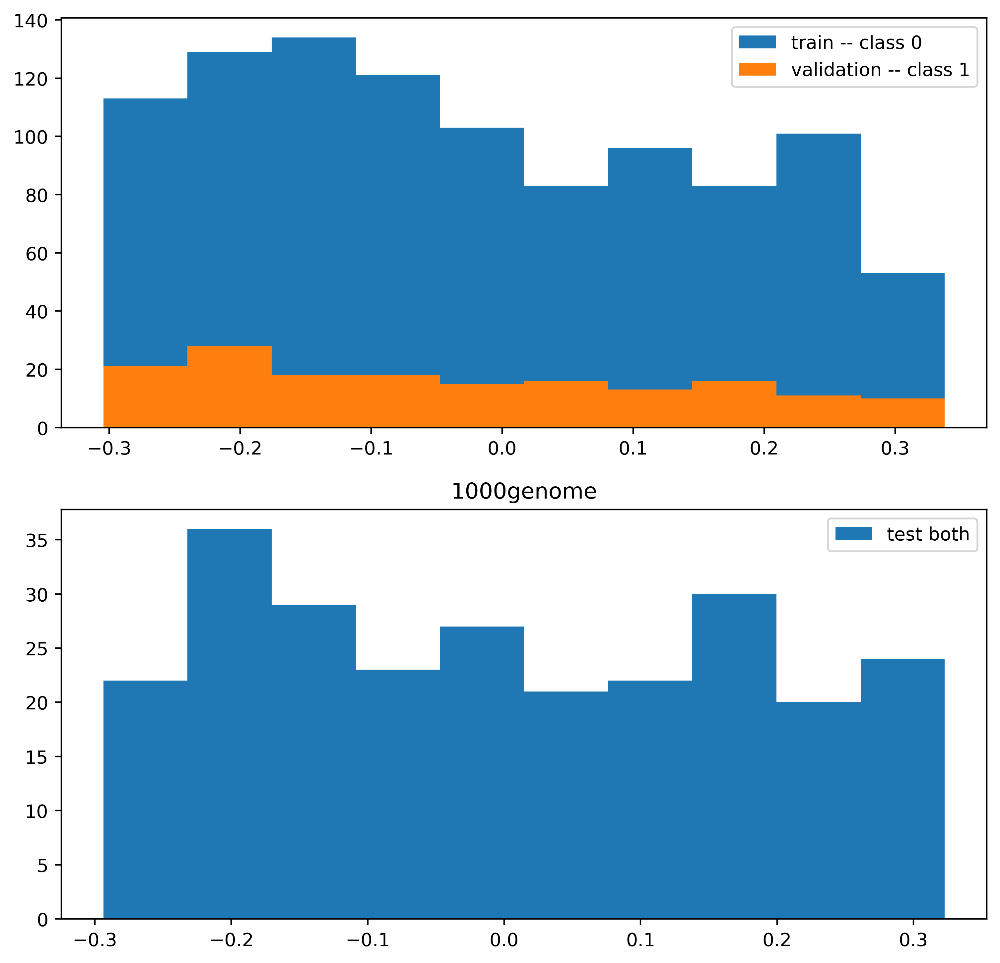

1000genome:  70%|███████   | 21001/30000 [1:24:49<1:20:26,  1.86it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  70%|███████   | 21101/30000 [1:25:13<35:16,  4.20it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  71%|███████   | 21201/30000 [1:25:37<35:01,  4.19it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  71%|███████   | 21301/30000 [1:26:01<34:34,  4.19it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  71%|███████▏  | 21401/30000 [1:26:25<34:17,  4.18it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  72%|███████▏  | 21501/30000 [1:26:48<33:39,  4.21it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  72%|███████▏  | 21601/30000 [1:27:13<34:11,  4.09it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  72%|███████▏  | 21701/30000 [1:27:37<33:31,  4.13it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  73%|███████▎  | 21801/30000 [1:28:01<33:39,  4.06it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  73%|███████▎  | 21901/30000 [1:28:26<32:51,  4.11it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  73%|███████▎  | 22000/30000 [1:28:50<32:15,  4.13it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


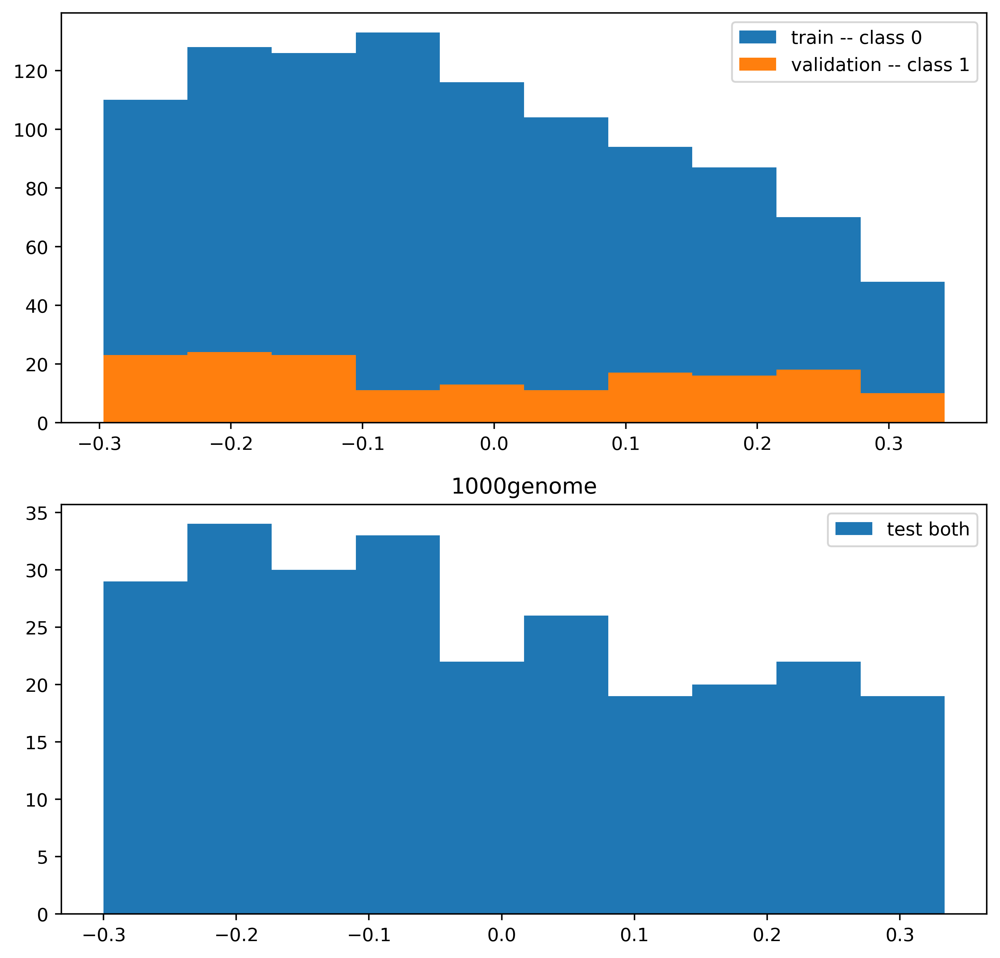

1000genome:  73%|███████▎  | 22001/30000 [1:28:51<1:12:43,  1.83it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  74%|███████▎  | 22101/30000 [1:29:15<31:57,  4.12it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  74%|███████▍  | 22201/30000 [1:29:40<31:37,  4.11it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  74%|███████▍  | 22301/30000 [1:30:04<30:50,  4.16it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  75%|███████▍  | 22401/30000 [1:30:28<30:32,  4.15it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  75%|███████▌  | 22501/30000 [1:30:52<30:15,  4.13it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  75%|███████▌  | 22601/30000 [1:31:17<29:57,  4.12it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  76%|███████▌  | 22701/30000 [1:31:41<29:15,  4.16it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  76%|███████▌  | 22801/30000 [1:32:05<29:07,  4.12it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  76%|███████▋  | 22901/30000 [1:32:29<28:41,  4.12it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  77%|███████▋  | 23000/30000 [1:32:54<28:18,  4.12it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


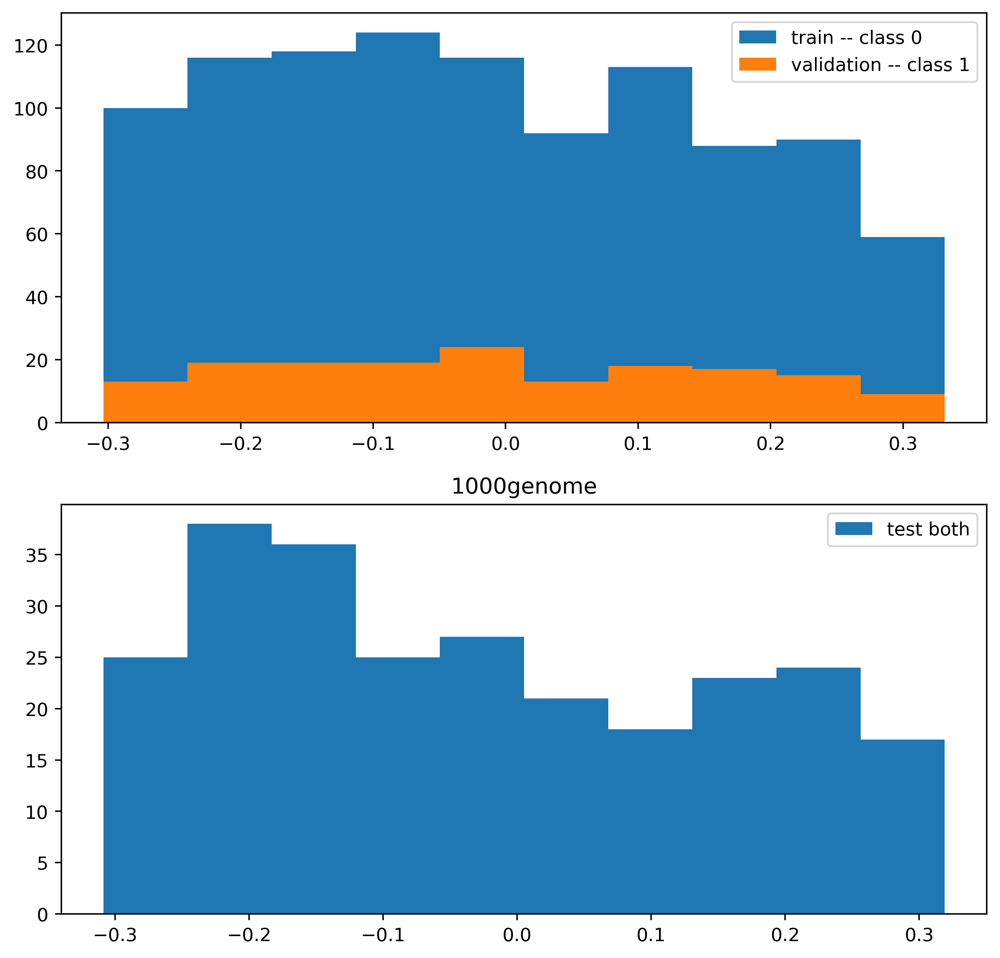

1000genome:  77%|███████▋  | 23001/30000 [1:32:55<1:03:50,  1.83it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  77%|███████▋  | 23101/30000 [1:33:19<27:46,  4.14it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]  

New Model Temperature: 0.001


1000genome:  77%|███████▋  | 23201/30000 [1:33:43<26:59,  4.20it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  78%|███████▊  | 23301/30000 [1:34:07<26:51,  4.16it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  78%|███████▊  | 23401/30000 [1:34:31<26:16,  4.19it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  78%|███████▊  | 23501/30000 [1:34:55<25:51,  4.19it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  79%|███████▊  | 23601/30000 [1:35:19<25:32,  4.18it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  79%|███████▉  | 23701/30000 [1:35:43<25:02,  4.19it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  79%|███████▉  | 23801/30000 [1:36:07<24:41,  4.18it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  80%|███████▉  | 23901/30000 [1:36:31<24:37,  4.13it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  80%|████████  | 24000/30000 [1:36:55<24:00,  4.17it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


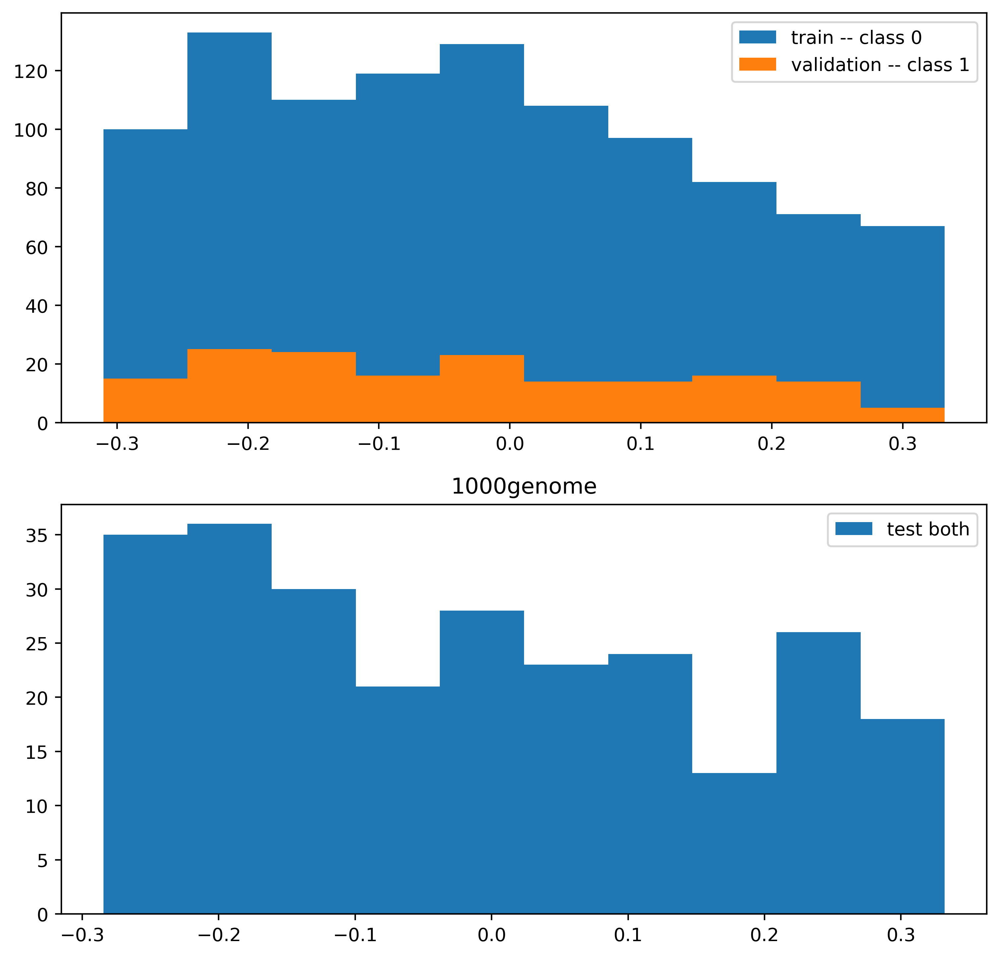

1000genome:  80%|████████  | 24001/30000 [1:36:56<54:10,  1.85it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  80%|████████  | 24101/30000 [1:37:20<23:28,  4.19it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  81%|████████  | 24201/30000 [1:37:44<23:44,  4.07it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  81%|████████  | 24301/30000 [1:38:08<22:37,  4.20it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  81%|████████▏ | 24401/30000 [1:38:32<22:06,  4.22it/s, train_loss=-1.71, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  82%|████████▏ | 24501/30000 [1:38:55<21:41,  4.23it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  82%|████████▏ | 24601/30000 [1:39:19<21:19,  4.22it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  82%|████████▏ | 24701/30000 [1:39:43<21:15,  4.16it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  83%|████████▎ | 24801/30000 [1:40:07<20:46,  4.17it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  83%|████████▎ | 24901/30000 [1:40:31<20:15,  4.19it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  83%|████████▎ | 25000/30000 [1:40:56<19:58,  4.17it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


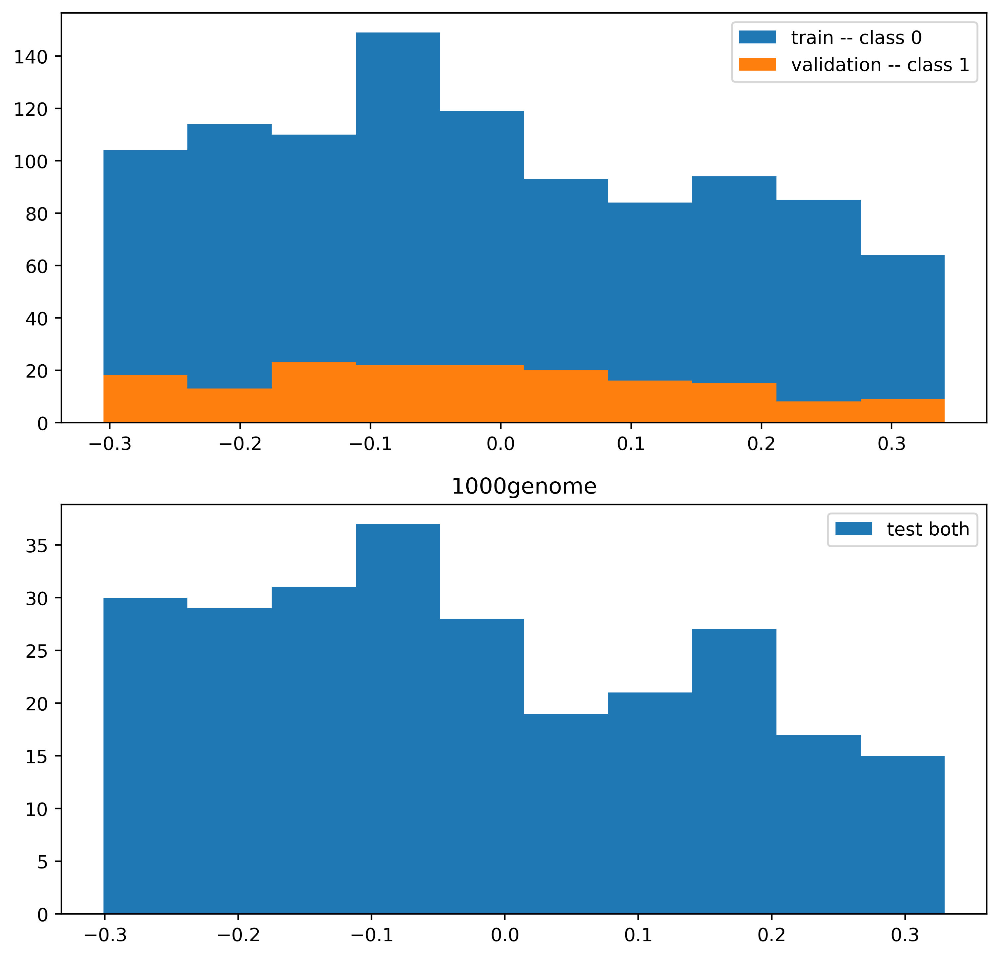

1000genome:  83%|████████▎ | 25001/30000 [1:40:57<45:35,  1.83it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  84%|████████▎ | 25101/30000 [1:41:21<19:38,  4.16it/s, train_loss=-1.83, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  84%|████████▍ | 25201/30000 [1:41:45<19:23,  4.13it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  84%|████████▍ | 25301/30000 [1:42:09<18:56,  4.14it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  85%|████████▍ | 25401/30000 [1:42:34<18:37,  4.11it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  85%|████████▌ | 25501/30000 [1:42:58<18:19,  4.09it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  85%|████████▌ | 25601/30000 [1:43:22<17:42,  4.14it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  86%|████████▌ | 25701/30000 [1:43:46<17:17,  4.14it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  86%|████████▌ | 25801/30000 [1:44:10<16:59,  4.12it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  86%|████████▋ | 25901/30000 [1:44:35<16:27,  4.15it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  87%|████████▋ | 26000/30000 [1:44:59<16:08,  4.13it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


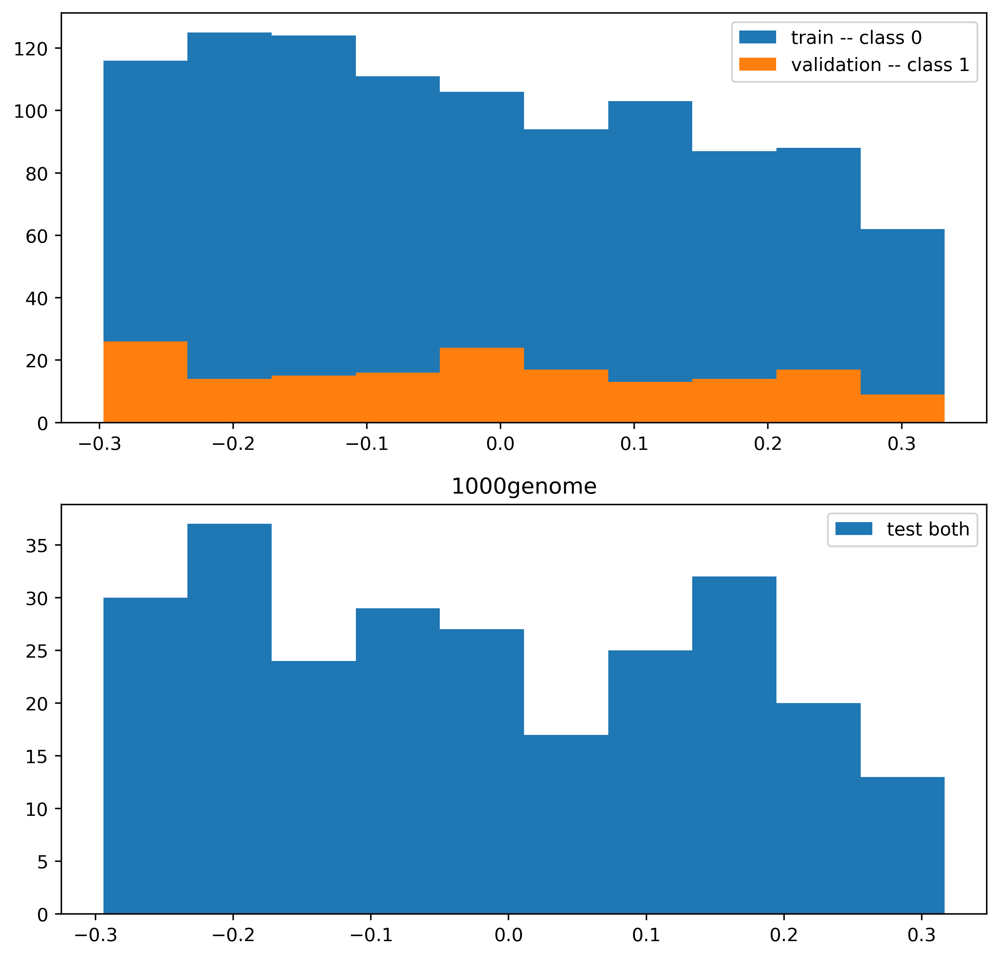

1000genome:  87%|████████▋ | 26001/30000 [1:45:00<36:01,  1.85it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  87%|████████▋ | 26101/30000 [1:45:24<15:38,  4.15it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  87%|████████▋ | 26201/30000 [1:45:48<15:13,  4.16it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  88%|████████▊ | 26301/30000 [1:46:13<14:46,  4.17it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  88%|████████▊ | 26401/30000 [1:46:37<14:28,  4.14it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  88%|████████▊ | 26501/30000 [1:47:01<14:12,  4.10it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  89%|████████▊ | 26601/30000 [1:47:25<13:34,  4.17it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  89%|████████▉ | 26701/30000 [1:47:49<13:15,  4.15it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  89%|████████▉ | 26801/30000 [1:48:13<12:51,  4.15it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  90%|████████▉ | 26901/30000 [1:48:38<12:29,  4.13it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  90%|█████████ | 27000/30000 [1:49:02<12:05,  4.14it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


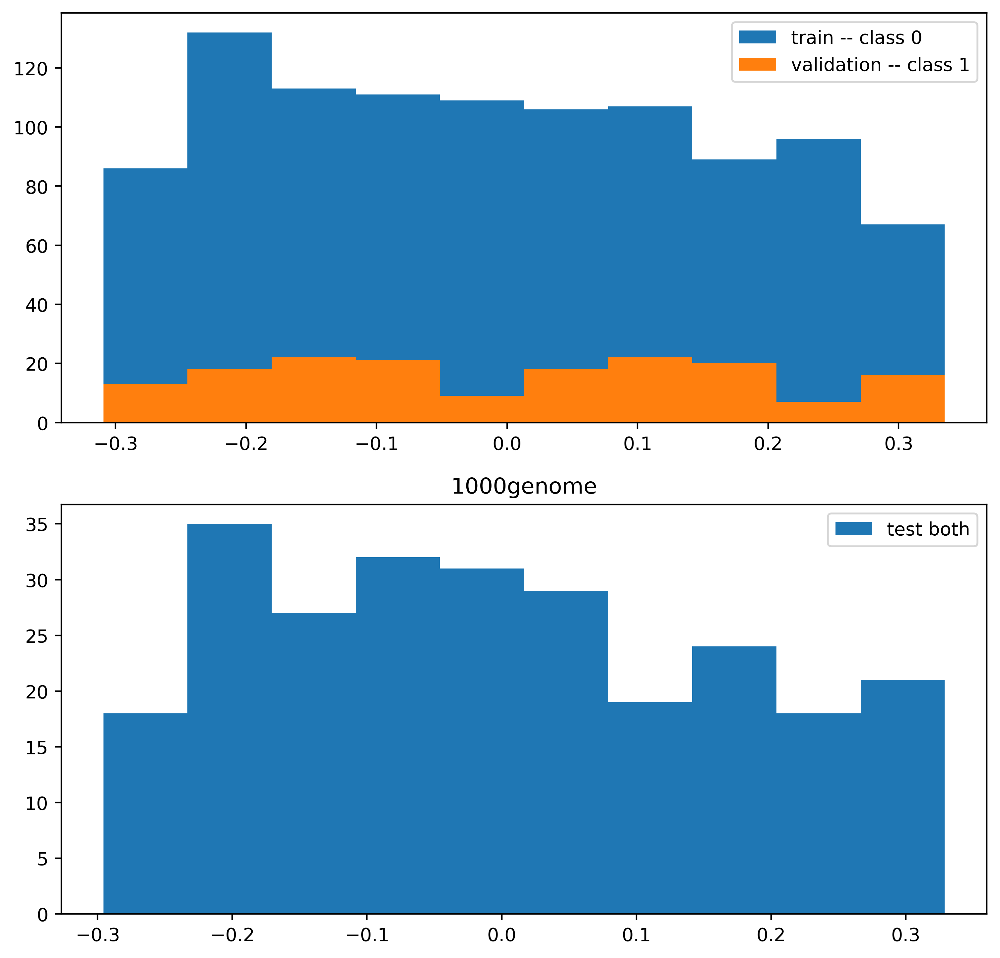

1000genome:  90%|█████████ | 27001/30000 [1:49:03<27:07,  1.84it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  90%|█████████ | 27101/30000 [1:49:27<11:29,  4.20it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  91%|█████████ | 27201/30000 [1:49:51<11:07,  4.19it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  91%|█████████ | 27301/30000 [1:50:15<10:43,  4.20it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  91%|█████████▏| 27401/30000 [1:50:39<10:16,  4.21it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  92%|█████████▏| 27501/30000 [1:51:02<09:57,  4.18it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  92%|█████████▏| 27601/30000 [1:51:26<09:30,  4.21it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  92%|█████████▏| 27701/30000 [1:51:50<09:08,  4.19it/s, train_loss=-1.82, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  93%|█████████▎| 27801/30000 [1:52:14<08:41,  4.22it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  93%|█████████▎| 27901/30000 [1:52:38<08:25,  4.15it/s, train_loss=-1.81, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  93%|█████████▎| 28000/30000 [1:53:03<08:00,  4.16it/s, train_loss=-1.71, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


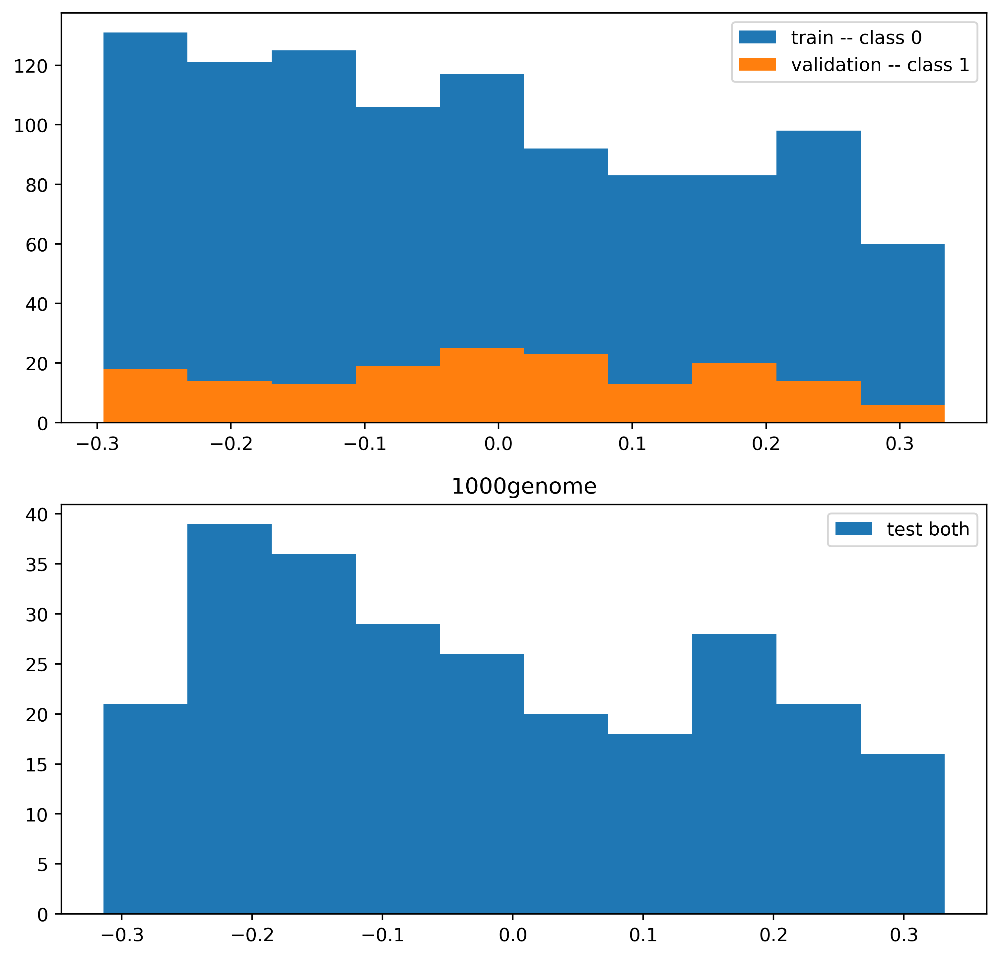

1000genome:  93%|█████████▎| 28001/30000 [1:53:04<17:55,  1.86it/s, train_loss=-1.71, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  94%|█████████▎| 28101/30000 [1:53:28<07:39,  4.13it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  94%|█████████▍| 28201/30000 [1:53:52<07:13,  4.15it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  94%|█████████▍| 28301/30000 [1:54:16<06:51,  4.13it/s, train_loss=-1.79, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  95%|█████████▍| 28401/30000 [1:54:40<06:23,  4.17it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  95%|█████████▌| 28501/30000 [1:55:05<06:02,  4.14it/s, train_loss=-1.73, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  95%|█████████▌| 28601/30000 [1:55:29<05:38,  4.14it/s, train_loss=-1.75, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  96%|█████████▌| 28701/30000 [1:55:53<05:14,  4.14it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  96%|█████████▌| 28801/30000 [1:56:17<04:48,  4.15it/s, train_loss=-1.82, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  96%|█████████▋| 28901/30000 [1:56:41<04:25,  4.15it/s, train_loss=-1.72, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  97%|█████████▋| 29000/30000 [1:57:06<04:01,  4.15it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001
1016 1016 1016
(array([0]), array([1016]))


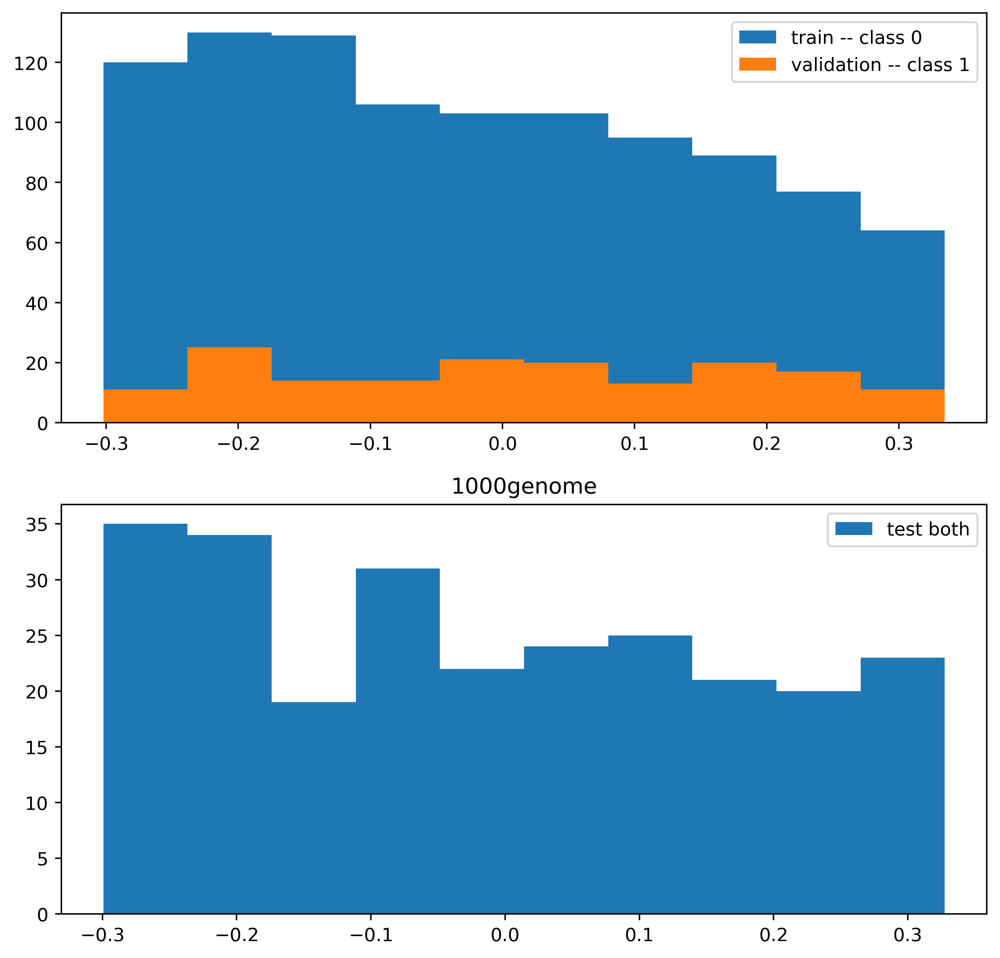

1000genome:  97%|█████████▋| 29001/30000 [1:57:07<08:58,  1.86it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

graph level clf: 1000genome binary True test acc 0.1299 f1 0.0000 recall 0.0000 prec 0.0000 [[ 33   0]
 [221   0]] 



1000genome:  97%|█████████▋| 29101/30000 [1:57:31<03:36,  4.16it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  97%|█████████▋| 29201/30000 [1:57:55<03:12,  4.15it/s, train_loss=-1.83, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  98%|█████████▊| 29301/30000 [1:58:19<02:49,  4.12it/s, train_loss=-1.8, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1] 

New Model Temperature: 0.001


1000genome:  98%|█████████▊| 29401/30000 [1:58:43<02:24,  4.16it/s, train_loss=-1.82, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  98%|█████████▊| 29501/30000 [1:59:07<01:59,  4.17it/s, train_loss=-1.77, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  99%|█████████▊| 29601/30000 [1:59:32<01:36,  4.15it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  99%|█████████▉| 29701/30000 [1:59:56<01:12,  4.14it/s, train_loss=-1.78, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome:  99%|█████████▉| 29801/30000 [2:00:20<00:48,  4.14it/s, train_loss=-1.76, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


1000genome: 100%|█████████▉| 29901/30000 [2:00:44<00:23,  4.17it/s, train_loss=-1.74, train_acc=0.163, test_acc=0.13, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:   0%|          | 0/30000 [00:00<?, ?it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 1.0
984 984 984
(array([0]), array([984]))


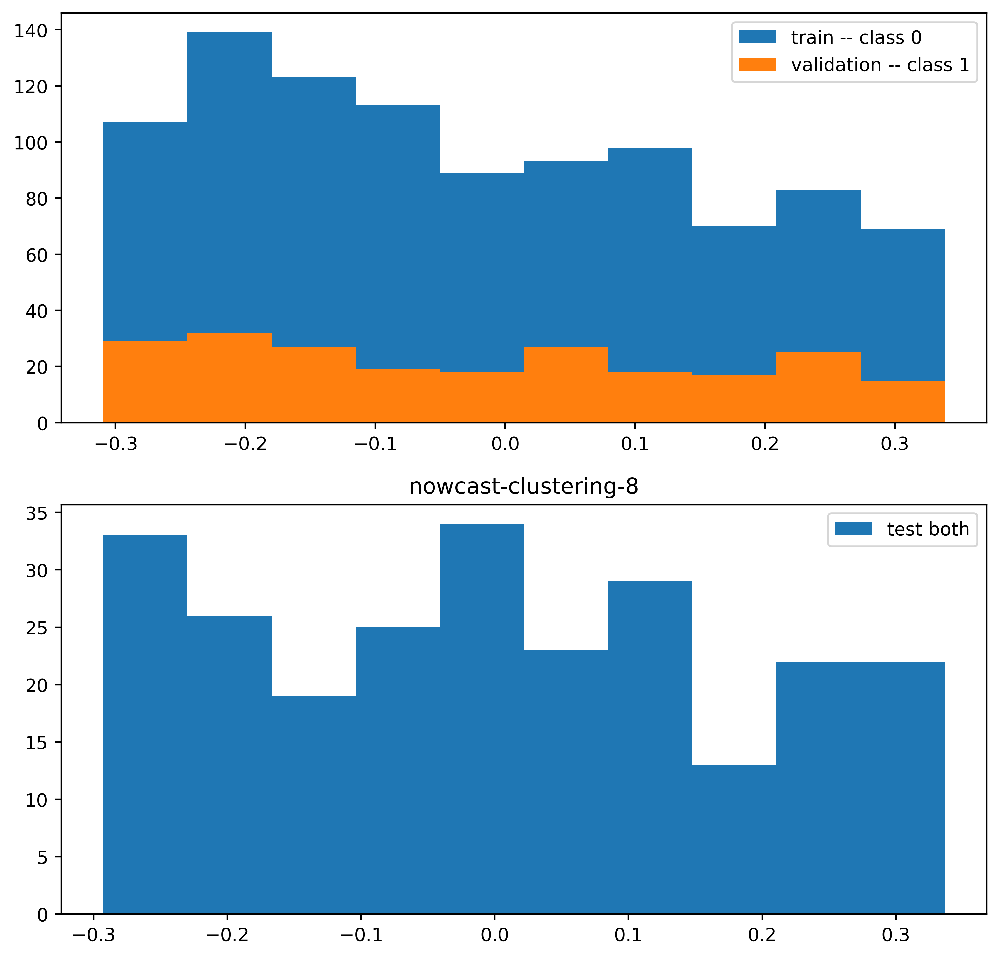

nowcast-clustering-8:   0%|          | 2/30000 [00:01<5:03:18,  1.65it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:   0%|          | 102/30000 [00:16<1:16:05,  6.55it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.9801986733067553


nowcast-clustering-8:   1%|          | 202/30000 [00:32<1:15:56,  6.54it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.9417645335842486


nowcast-clustering-8:   1%|          | 302/30000 [00:47<1:16:09,  6.50it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.8869204367171575


nowcast-clustering-8:   1%|▏         | 402/30000 [01:02<1:15:53,  6.50it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.8187307530779818


nowcast-clustering-8:   2%|▏         | 502/30000 [01:18<1:15:16,  6.53it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.7408182206817178


nowcast-clustering-8:   2%|▏         | 602/30000 [01:33<1:14:40,  6.56it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.6570468198150566


nowcast-clustering-8:   2%|▏         | 702/30000 [01:49<1:17:06,  6.33it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.5712090638488148


nowcast-clustering-8:   3%|▎         | 802/30000 [02:04<1:14:42,  6.51it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.48675225595997157


nowcast-clustering-8:   3%|▎         | 902/30000 [02:19<1:14:25,  6.52it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.40656965974059905


nowcast-clustering-8:   3%|▎         | 1000/30000 [02:34<1:13:50,  6.55it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.3328710836980795
984 984 984
(array([0]), array([984]))


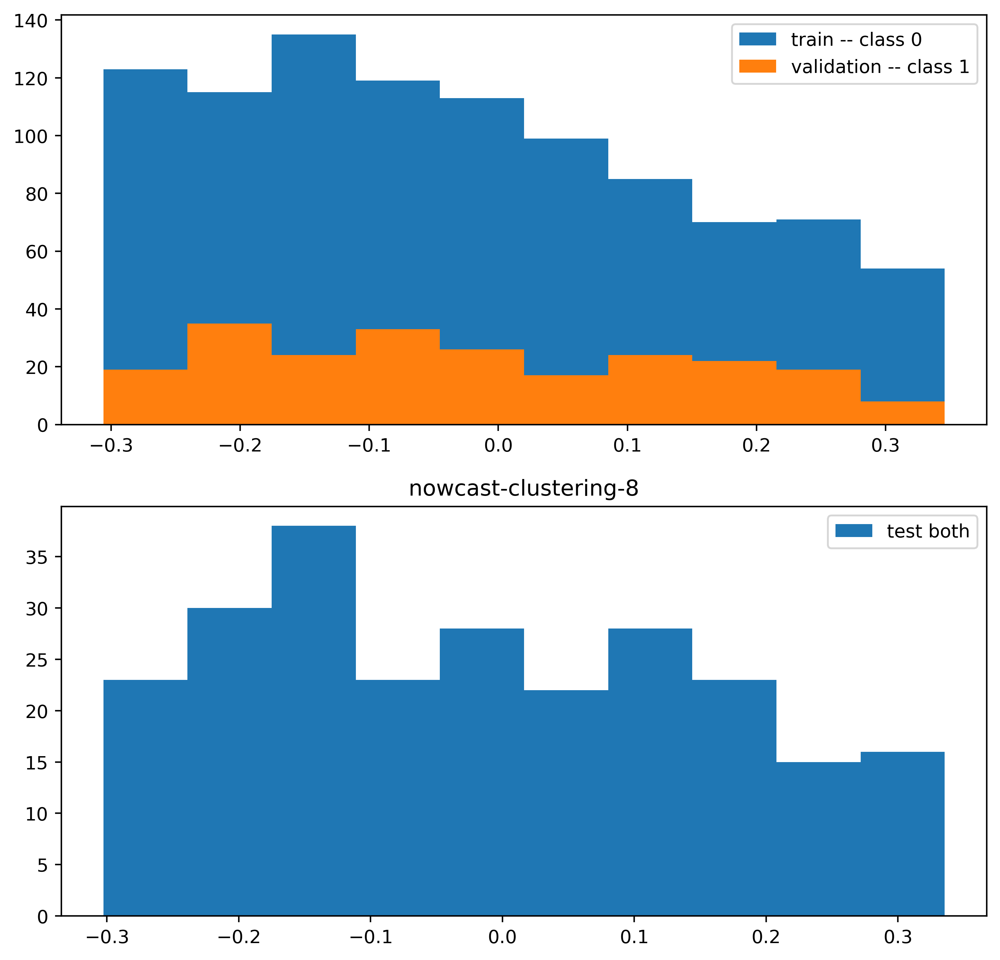

nowcast-clustering-8:   3%|▎         | 1002/30000 [02:36<2:57:05,  2.73it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:   4%|▎         | 1102/30000 [02:51<1:13:25,  6.56it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.26713530196585034


nowcast-clustering-8:   4%|▍         | 1202/30000 [03:06<1:12:50,  6.59it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.2101360712007647


nowcast-clustering-8:   4%|▍         | 1302/30000 [03:22<1:12:49,  6.57it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.16202575093388072


nowcast-clustering-8:   5%|▍         | 1402/30000 [03:37<1:12:50,  6.54it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.12245642825298188


nowcast-clustering-8:   5%|▌         | 1502/30000 [03:52<1:13:31,  6.46it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.09071795328941248


nowcast-clustering-8:   5%|▌         | 1602/30000 [04:08<1:12:20,  6.54it/s, train_loss=-1.85, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.06587475442640295


nowcast-clustering-8:   6%|▌         | 1702/30000 [04:23<1:12:09,  6.54it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.04688769521998848


nowcast-clustering-8:   6%|▌         | 1802/30000 [04:38<1:12:16,  6.50it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.032712434939019805


nowcast-clustering-8:   6%|▋         | 1902/30000 [04:54<1:12:11,  6.49it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.022370771856165587


nowcast-clustering-8:   7%|▋         | 2000/30000 [05:09<1:11:23,  6.54it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.014995576820477701
984 984 984
(array([0]), array([984]))


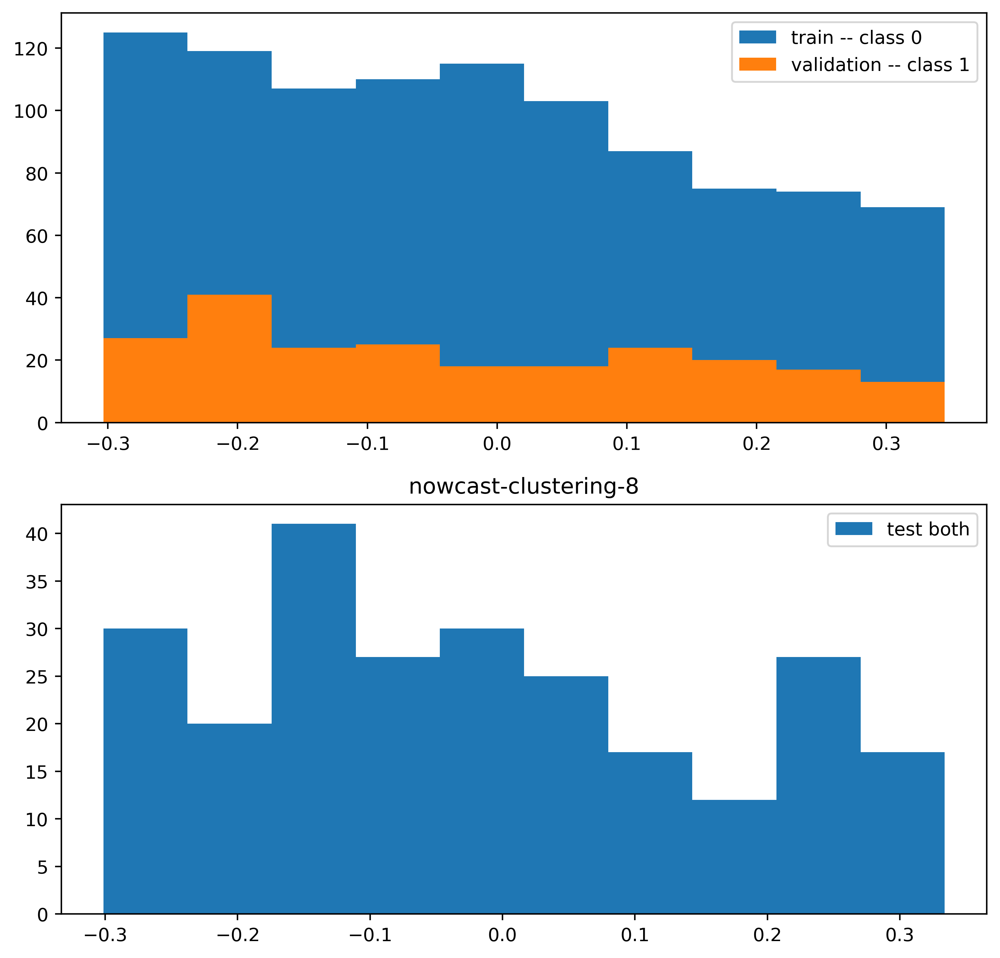

nowcast-clustering-8:   7%|▋         | 2002/30000 [05:10<2:50:19,  2.74it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:   7%|▋         | 2102/30000 [05:25<1:10:11,  6.62it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.009852796061187254


nowcast-clustering-8:   7%|▋         | 2202/30000 [05:40<1:09:41,  6.65it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.006345559512909111


nowcast-clustering-8:   8%|▊         | 2302/30000 [05:55<1:10:18,  6.57it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.004005847942090417


nowcast-clustering-8:   8%|▊         | 2402/30000 [06:11<1:09:26,  6.62it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.002478752176666357


nowcast-clustering-8:   8%|▊         | 2502/30000 [06:26<1:08:55,  6.65it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.0015034391929775717


nowcast-clustering-8:   9%|▊         | 2602/30000 [06:41<1:09:00,  6.62it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:   9%|▉         | 2702/30000 [06:56<1:08:38,  6.63it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:   9%|▉         | 2802/30000 [07:11<1:08:16,  6.64it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  10%|▉         | 2902/30000 [07:26<1:08:05,  6.63it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  10%|█         | 3000/30000 [07:41<1:07:53,  6.63it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


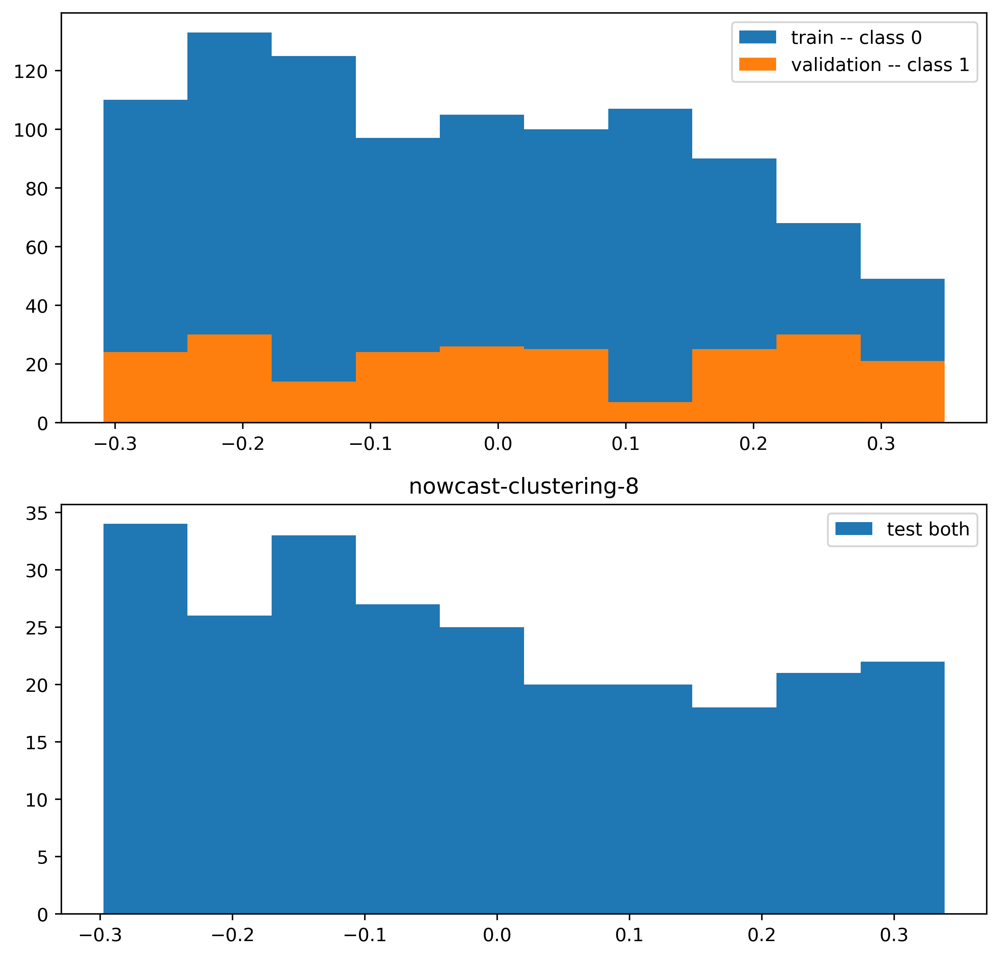

nowcast-clustering-8:  10%|█         | 3002/30000 [07:43<2:43:07,  2.76it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  10%|█         | 3102/30000 [07:58<1:07:25,  6.65it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  11%|█         | 3202/30000 [08:13<1:06:44,  6.69it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  11%|█         | 3302/30000 [08:28<1:06:33,  6.69it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  11%|█▏        | 3402/30000 [08:43<1:06:23,  6.68it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  12%|█▏        | 3502/30000 [08:58<1:06:14,  6.67it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  12%|█▏        | 3602/30000 [09:13<1:05:55,  6.67it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  12%|█▏        | 3702/30000 [09:28<1:05:57,  6.64it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  13%|█▎        | 3802/30000 [09:43<1:06:06,  6.60it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  13%|█▎        | 3902/30000 [09:59<1:05:28,  6.64it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  13%|█▎        | 4000/30000 [10:14<1:04:57,  6.67it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


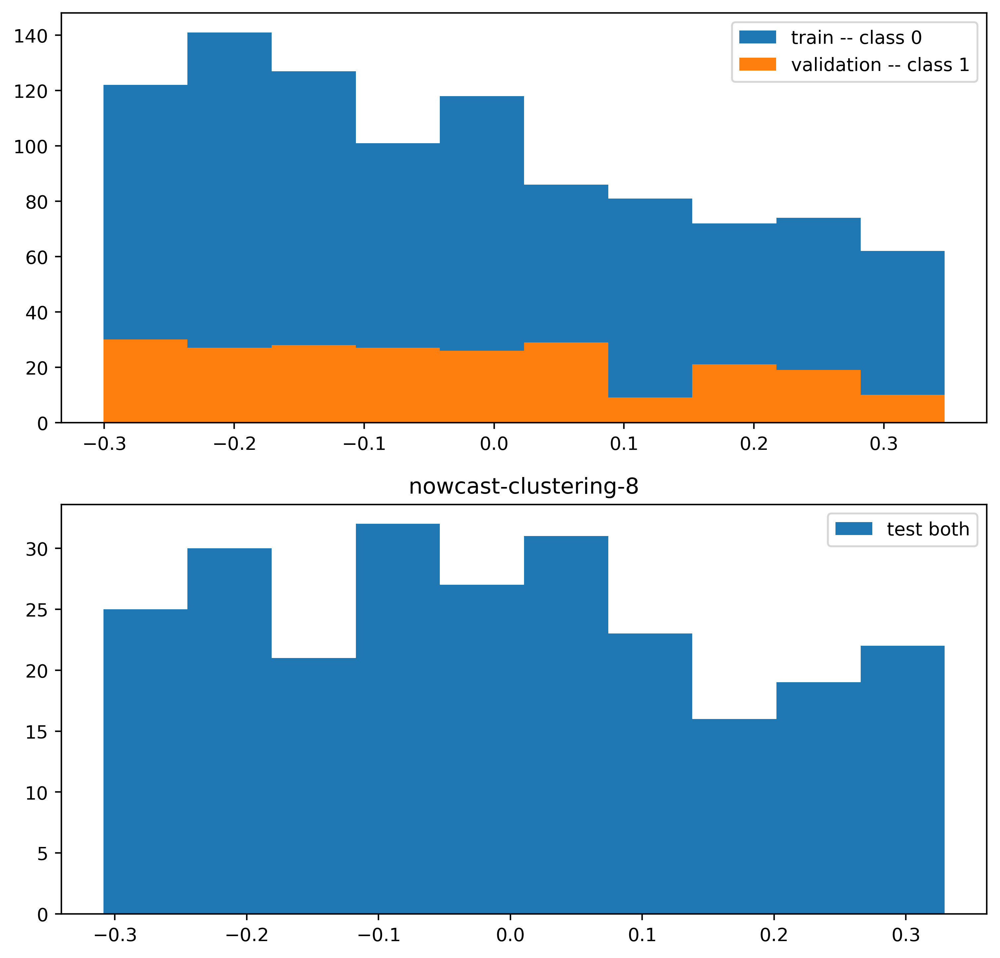

nowcast-clustering-8:  13%|█▎        | 4002/30000 [10:15<2:34:49,  2.80it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  14%|█▎        | 4102/30000 [10:30<1:05:05,  6.63it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  14%|█▍        | 4202/30000 [10:45<1:04:45,  6.64it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  14%|█▍        | 4302/30000 [11:00<1:04:51,  6.60it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  15%|█▍        | 4402/30000 [11:15<1:04:26,  6.62it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  15%|█▌        | 4502/30000 [11:31<1:04:23,  6.60it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  15%|█▌        | 4602/30000 [11:46<1:05:02,  6.51it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  16%|█▌        | 4702/30000 [12:01<1:04:02,  6.58it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  16%|█▌        | 4802/30000 [12:16<1:03:55,  6.57it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  16%|█▋        | 4902/30000 [12:31<1:03:19,  6.61it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  17%|█▋        | 5000/30000 [12:46<1:03:00,  6.61it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


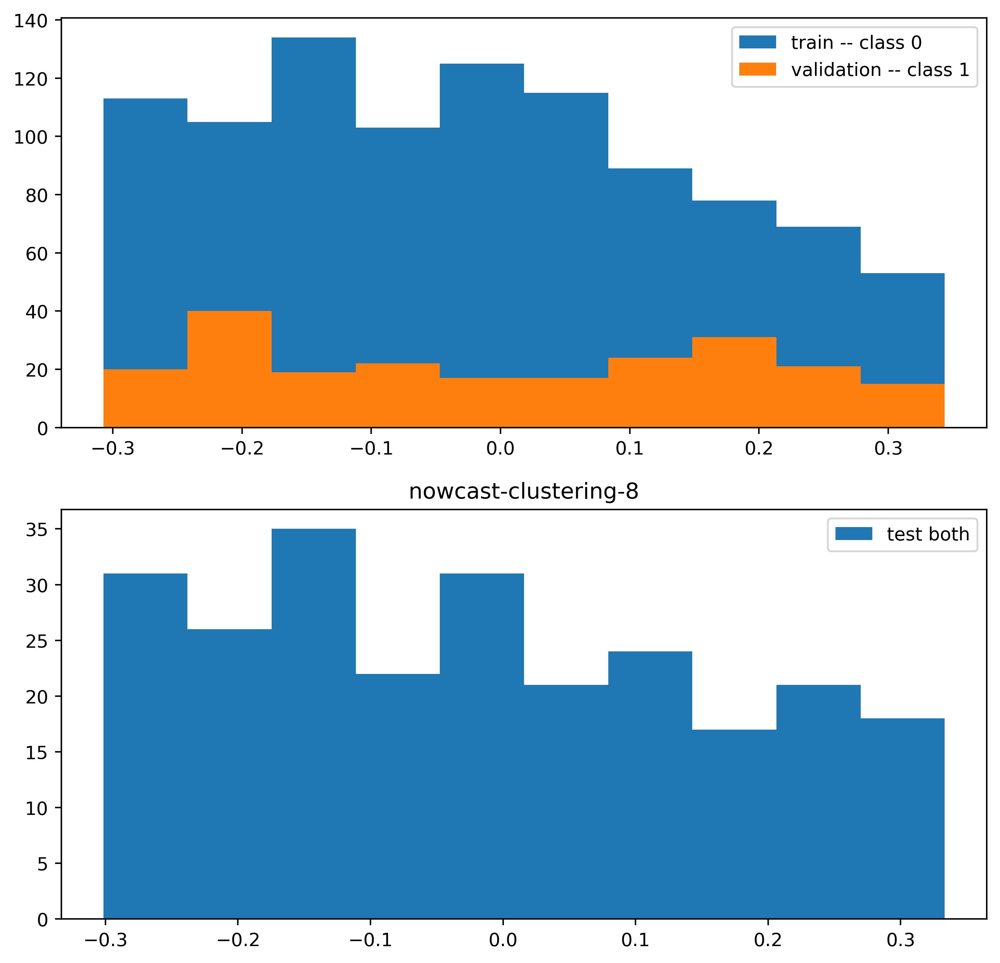

nowcast-clustering-8:  17%|█▋        | 5002/30000 [12:48<2:29:53,  2.78it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  17%|█▋        | 5102/30000 [13:03<1:03:02,  6.58it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  17%|█▋        | 5202/30000 [13:18<1:02:06,  6.65it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  18%|█▊        | 5302/30000 [13:33<1:02:10,  6.62it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  18%|█▊        | 5402/30000 [13:48<1:01:45,  6.64it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  18%|█▊        | 5502/30000 [14:03<1:01:37,  6.63it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  19%|█▊        | 5602/30000 [14:19<1:01:35,  6.60it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  19%|█▉        | 5702/30000 [14:34<1:00:43,  6.67it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  19%|█▉        | 5802/30000 [14:49<1:00:52,  6.62it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  20%|█▉        | 5902/30000 [15:04<1:01:02,  6.58it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  20%|██        | 6000/30000 [15:19<1:00:17,  6.63it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


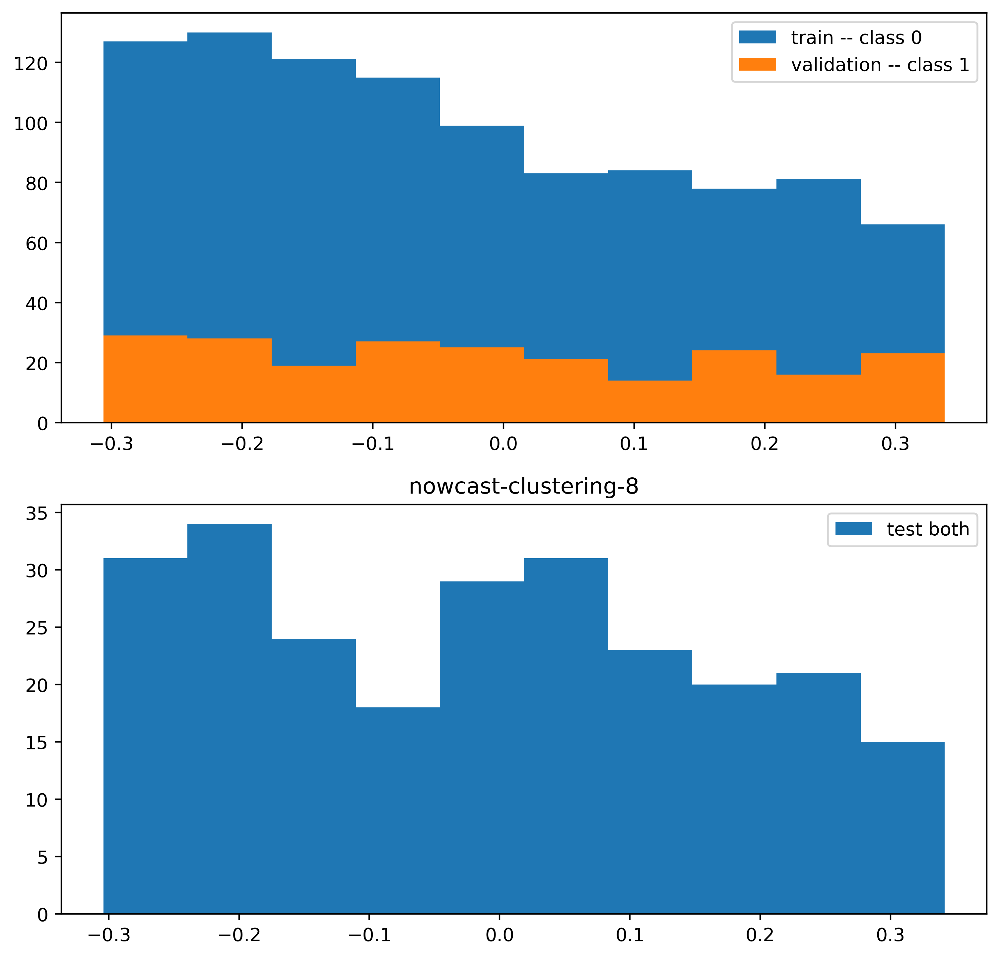

nowcast-clustering-8:  20%|██        | 6002/30000 [15:20<2:23:32,  2.79it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  20%|██        | 6102/30000 [15:35<1:00:04,  6.63it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  21%|██        | 6202/30000 [15:51<1:01:03,  6.50it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  21%|██        | 6302/30000 [16:06<59:47,  6.61it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  21%|██▏       | 6402/30000 [16:21<59:35,  6.60it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  22%|██▏       | 6502/30000 [16:36<59:42,  6.56it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  22%|██▏       | 6602/30000 [16:52<1:00:03,  6.49it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  22%|██▏       | 6702/30000 [17:07<58:57,  6.59it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  23%|██▎       | 6802/30000 [17:22<59:42,  6.48it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  23%|██▎       | 6902/30000 [17:37<58:24,  6.59it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  23%|██▎       | 7000/30000 [17:53<59:05,  6.49it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


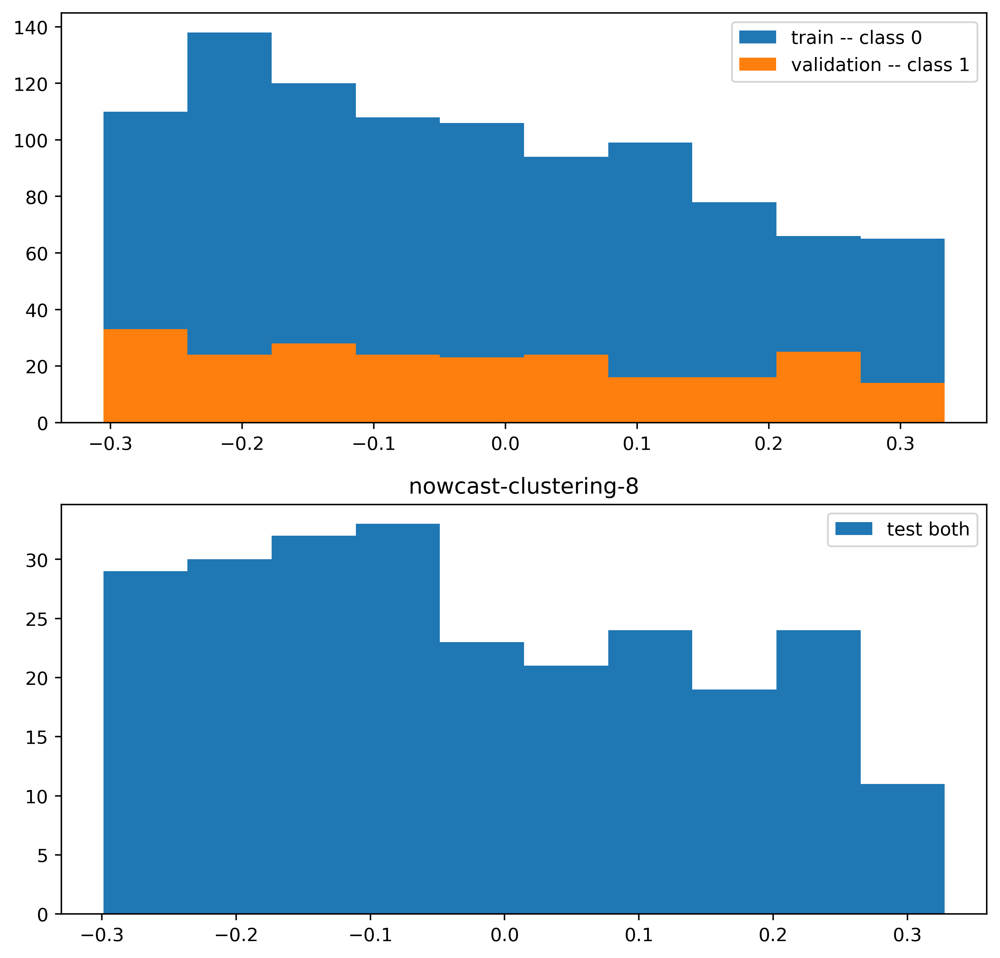

nowcast-clustering-8:  23%|██▎       | 7002/30000 [17:54<2:18:31,  2.77it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  24%|██▎       | 7102/30000 [18:09<58:05,  6.57it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  24%|██▍       | 7202/30000 [18:24<57:53,  6.56it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  24%|██▍       | 7302/30000 [18:40<57:40,  6.56it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  25%|██▍       | 7402/30000 [18:55<57:22,  6.56it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  25%|██▌       | 7502/30000 [19:10<56:57,  6.58it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  25%|██▌       | 7602/30000 [19:25<57:03,  6.54it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  26%|██▌       | 7702/30000 [19:41<56:38,  6.56it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  26%|██▌       | 7802/30000 [19:56<56:17,  6.57it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  26%|██▋       | 7902/30000 [20:11<56:09,  6.56it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  27%|██▋       | 8000/30000 [20:27<55:45,  6.58it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


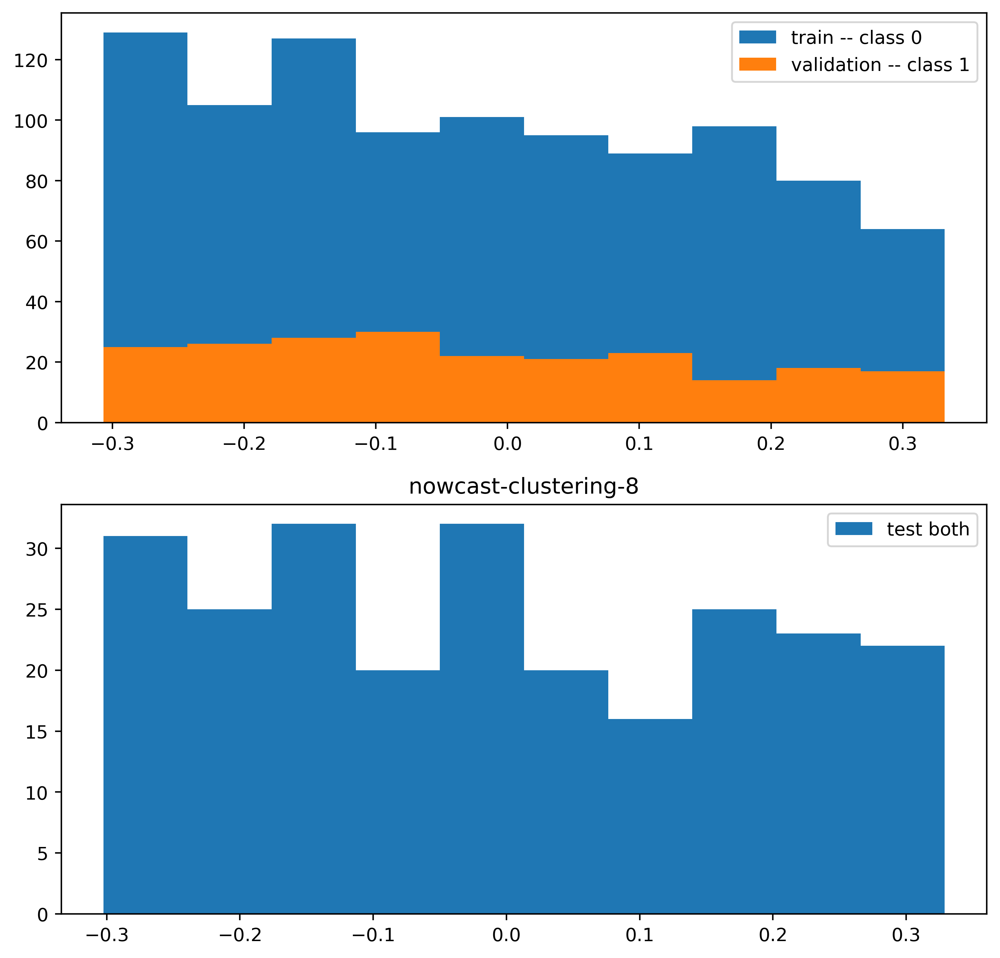

nowcast-clustering-8:  27%|██▋       | 8002/30000 [20:28<2:12:08,  2.77it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  27%|██▋       | 8102/30000 [20:43<54:47,  6.66it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  27%|██▋       | 8202/30000 [20:58<54:43,  6.64it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  28%|██▊       | 8302/30000 [21:13<54:08,  6.68it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  28%|██▊       | 8402/30000 [21:28<54:31,  6.60it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  28%|██▊       | 8502/30000 [21:43<53:44,  6.67it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  29%|██▊       | 8602/30000 [21:58<54:23,  6.56it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  29%|██▉       | 8702/30000 [22:13<53:30,  6.63it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  29%|██▉       | 8802/30000 [22:29<53:12,  6.64it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  30%|██▉       | 8902/30000 [22:44<52:36,  6.68it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  30%|███       | 9000/30000 [22:59<52:43,  6.64it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


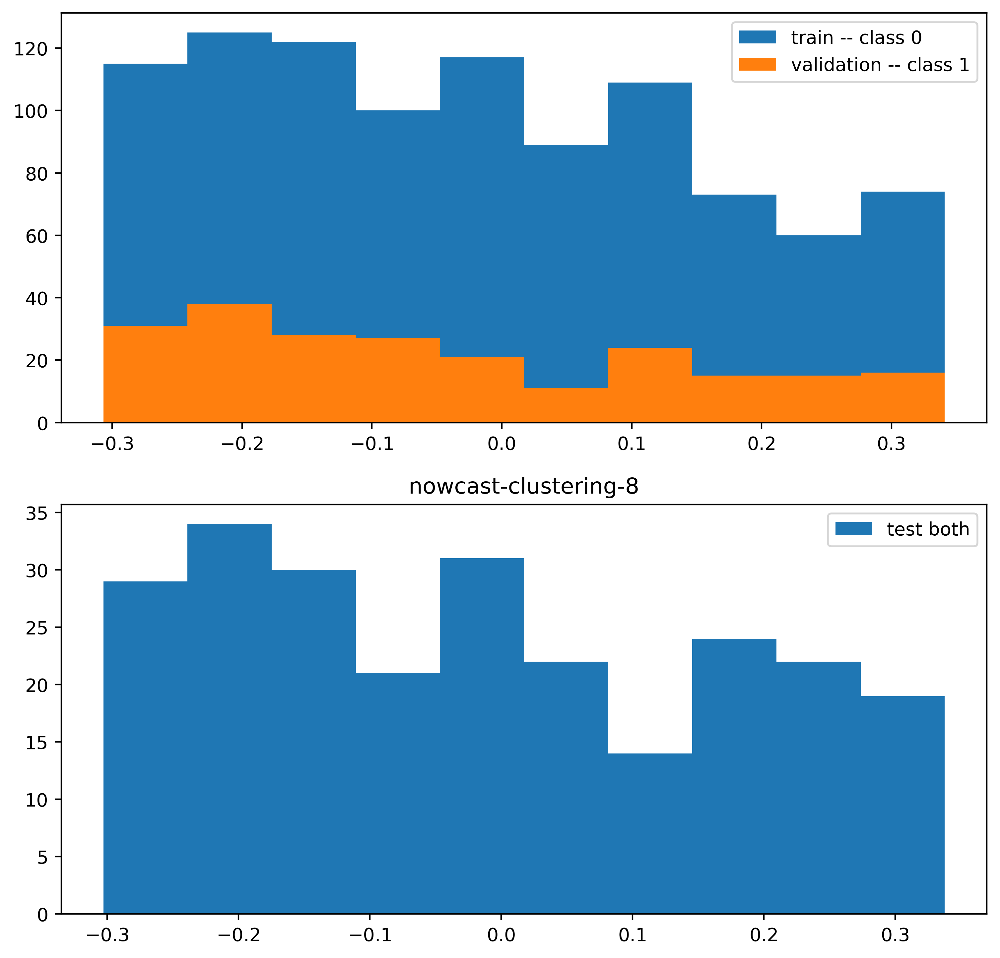

nowcast-clustering-8:  30%|███       | 9002/30000 [23:00<2:07:01,  2.76it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  30%|███       | 9102/30000 [23:15<52:22,  6.65it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  31%|███       | 9202/30000 [23:30<52:20,  6.62it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  31%|███       | 9302/30000 [23:45<54:44,  6.30it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  31%|███▏      | 9402/30000 [24:01<54:07,  6.34it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  32%|███▏      | 9502/30000 [24:17<53:06,  6.43it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  32%|███▏      | 9602/30000 [24:32<52:01,  6.53it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  32%|███▏      | 9702/30000 [24:47<51:01,  6.63it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  33%|███▎      | 9802/30000 [25:02<50:57,  6.61it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  33%|███▎      | 9902/30000 [25:18<50:41,  6.61it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  33%|███▎      | 10000/30000 [25:33<50:29,  6.60it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


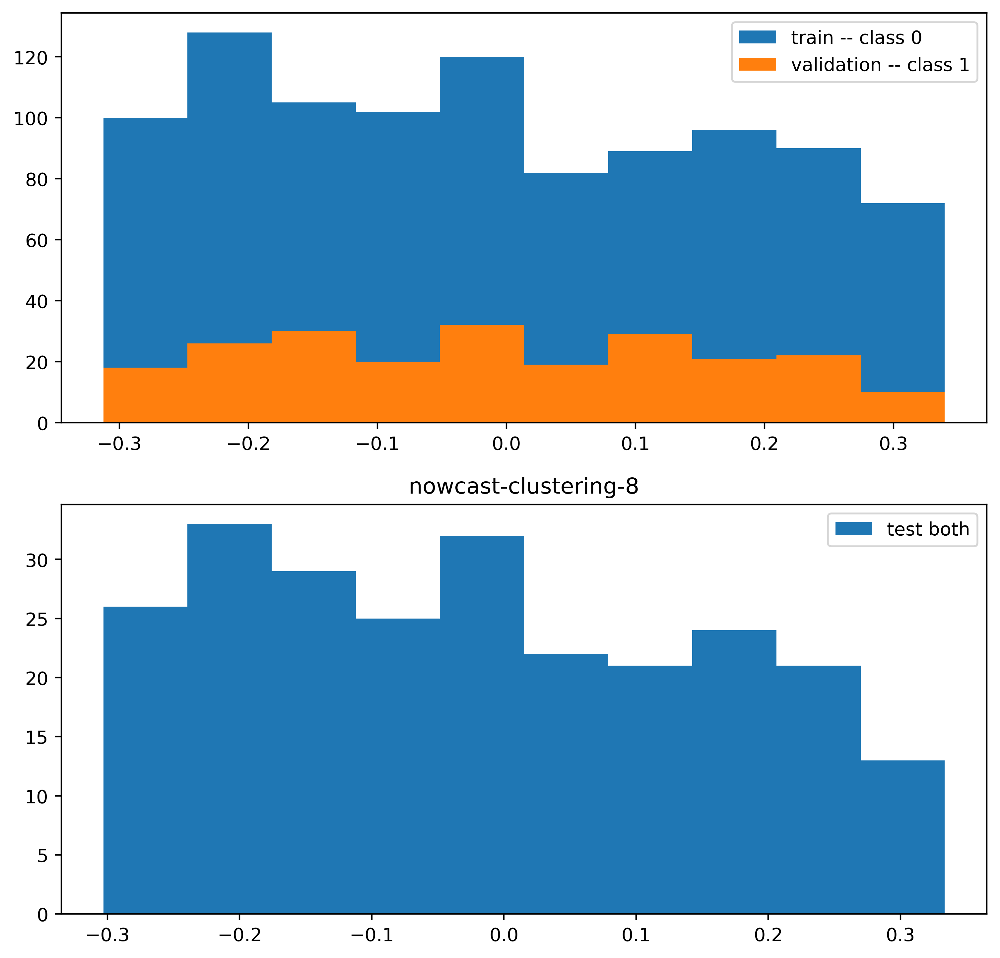

nowcast-clustering-8:  33%|███▎      | 10002/30000 [25:34<2:00:39,  2.76it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  34%|███▎      | 10102/30000 [25:49<50:14,  6.60it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  34%|███▍      | 10202/30000 [26:04<49:51,  6.62it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  34%|███▍      | 10302/30000 [26:19<49:27,  6.64it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  35%|███▍      | 10402/30000 [26:34<50:14,  6.50it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  35%|███▌      | 10502/30000 [26:50<48:59,  6.63it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  35%|███▌      | 10602/30000 [27:05<48:32,  6.66it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  36%|███▌      | 10702/30000 [27:20<48:33,  6.62it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  36%|███▌      | 10802/30000 [27:35<48:26,  6.61it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  36%|███▋      | 10902/30000 [27:50<47:57,  6.64it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  37%|███▋      | 11000/30000 [28:05<47:35,  6.65it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


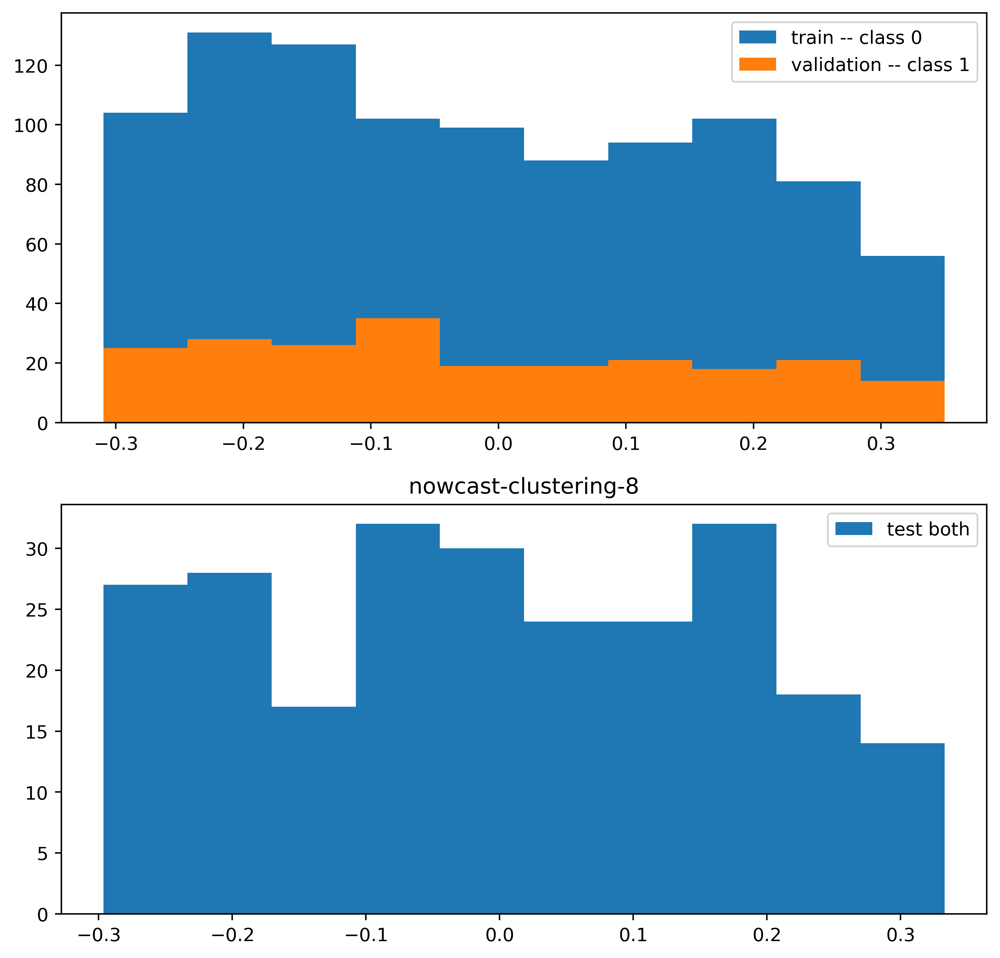

nowcast-clustering-8:  37%|███▋      | 11002/30000 [28:06<1:54:11,  2.77it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  37%|███▋      | 11102/30000 [28:21<47:34,  6.62it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  37%|███▋      | 11202/30000 [28:37<47:21,  6.61it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  38%|███▊      | 11302/30000 [28:52<46:37,  6.68it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  38%|███▊      | 11402/30000 [29:07<46:29,  6.67it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  38%|███▊      | 11502/30000 [29:22<46:29,  6.63it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  39%|███▊      | 11602/30000 [29:37<46:08,  6.65it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  39%|███▉      | 11702/30000 [29:52<46:06,  6.61it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  39%|███▉      | 11802/30000 [30:07<45:41,  6.64it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  40%|███▉      | 11902/30000 [30:22<45:26,  6.64it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  40%|████      | 12000/30000 [30:37<45:13,  6.63it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


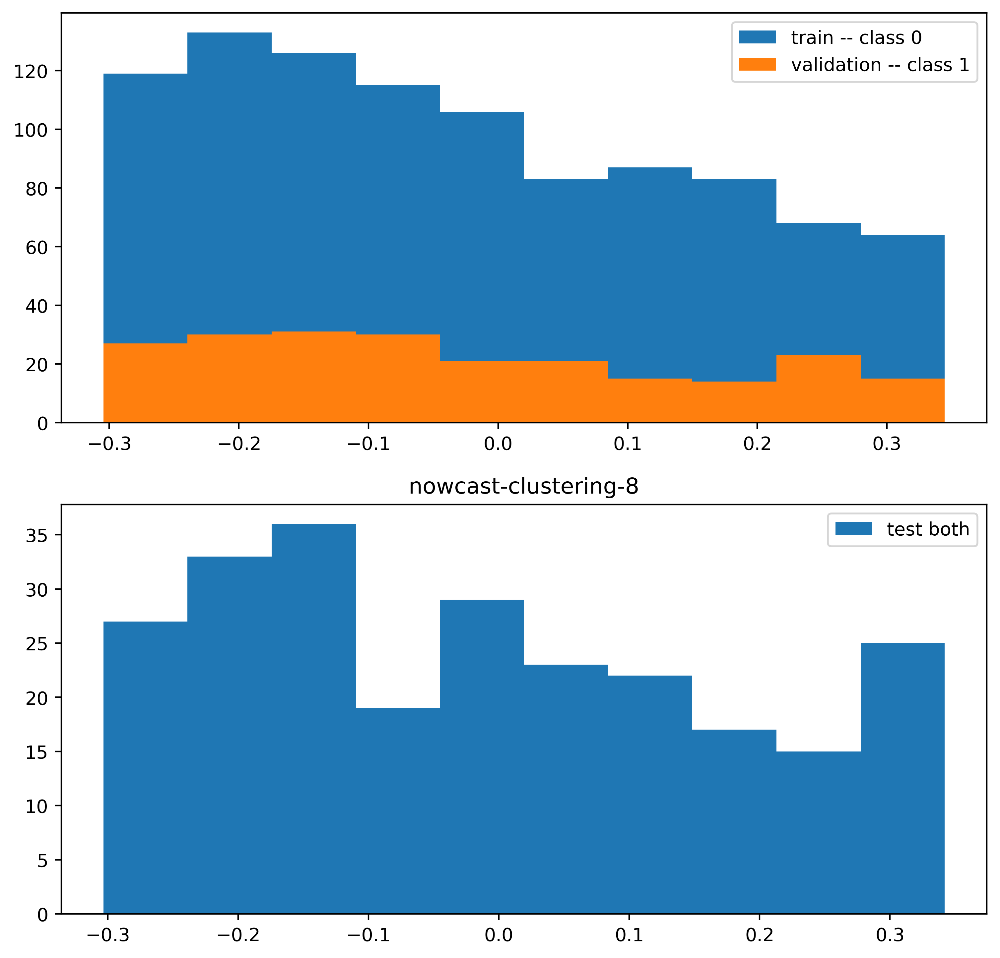

nowcast-clustering-8:  40%|████      | 12002/30000 [30:38<1:48:26,  2.77it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  40%|████      | 12102/30000 [30:53<44:32,  6.70it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  41%|████      | 12202/30000 [31:08<44:04,  6.73it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  41%|████      | 12301/30000 [31:23<43:54,  6.72it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  41%|████▏     | 12402/30000 [31:38<44:01,  6.66it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  42%|████▏     | 12502/30000 [31:53<44:16,  6.59it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  42%|████▏     | 12602/30000 [32:09<43:54,  6.60it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  42%|████▏     | 12702/30000 [32:24<43:38,  6.61it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  43%|████▎     | 12802/30000 [32:39<43:02,  6.66it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  43%|████▎     | 12902/30000 [32:54<42:54,  6.64it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  43%|████▎     | 13000/30000 [33:09<42:42,  6.63it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


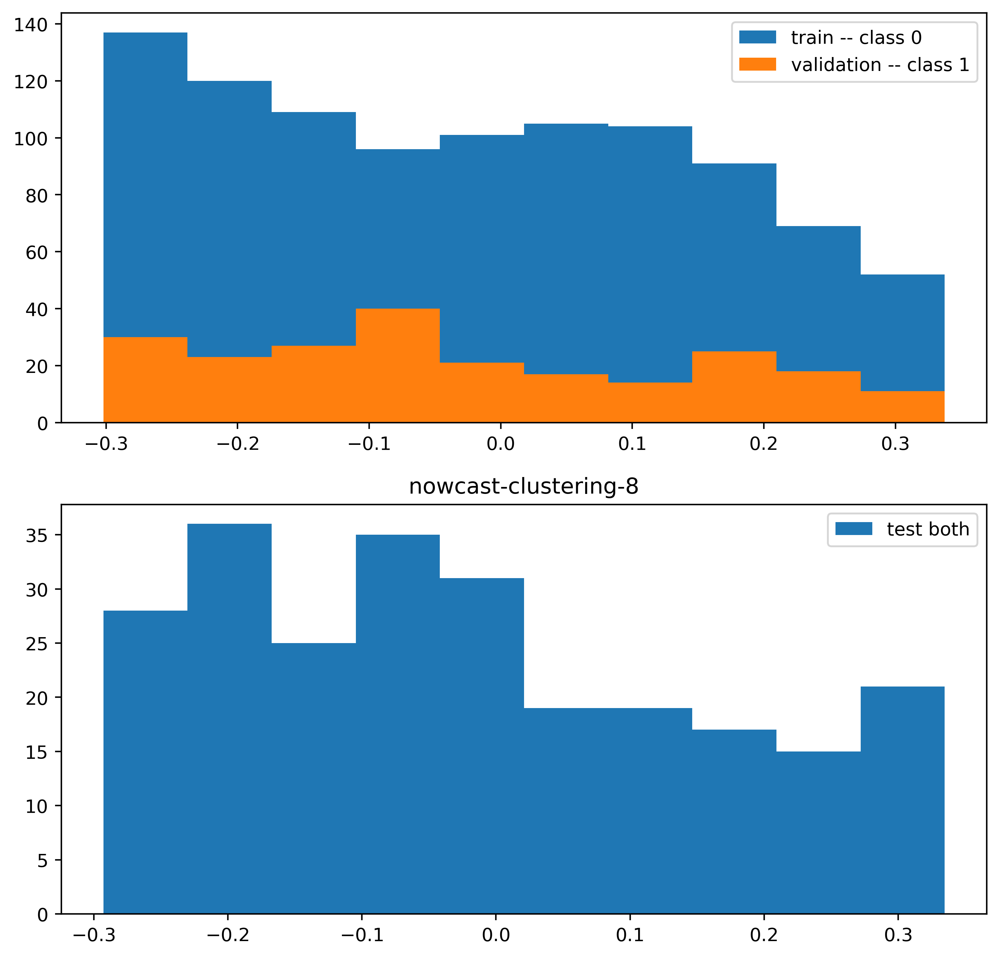

nowcast-clustering-8:  43%|████▎     | 13002/30000 [33:10<1:42:01,  2.78it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  44%|████▎     | 13102/30000 [33:25<42:36,  6.61it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  44%|████▍     | 13202/30000 [33:40<42:11,  6.64it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  44%|████▍     | 13302/30000 [33:56<42:05,  6.61it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  45%|████▍     | 13402/30000 [34:11<41:44,  6.63it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  45%|████▌     | 13502/30000 [34:26<41:30,  6.63it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  45%|████▌     | 13602/30000 [34:41<41:39,  6.56it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  46%|████▌     | 13702/30000 [34:56<40:49,  6.65it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  46%|████▌     | 13802/30000 [35:11<40:37,  6.64it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  46%|████▋     | 13902/30000 [35:26<40:34,  6.61it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  47%|████▋     | 14000/30000 [35:41<40:33,  6.57it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


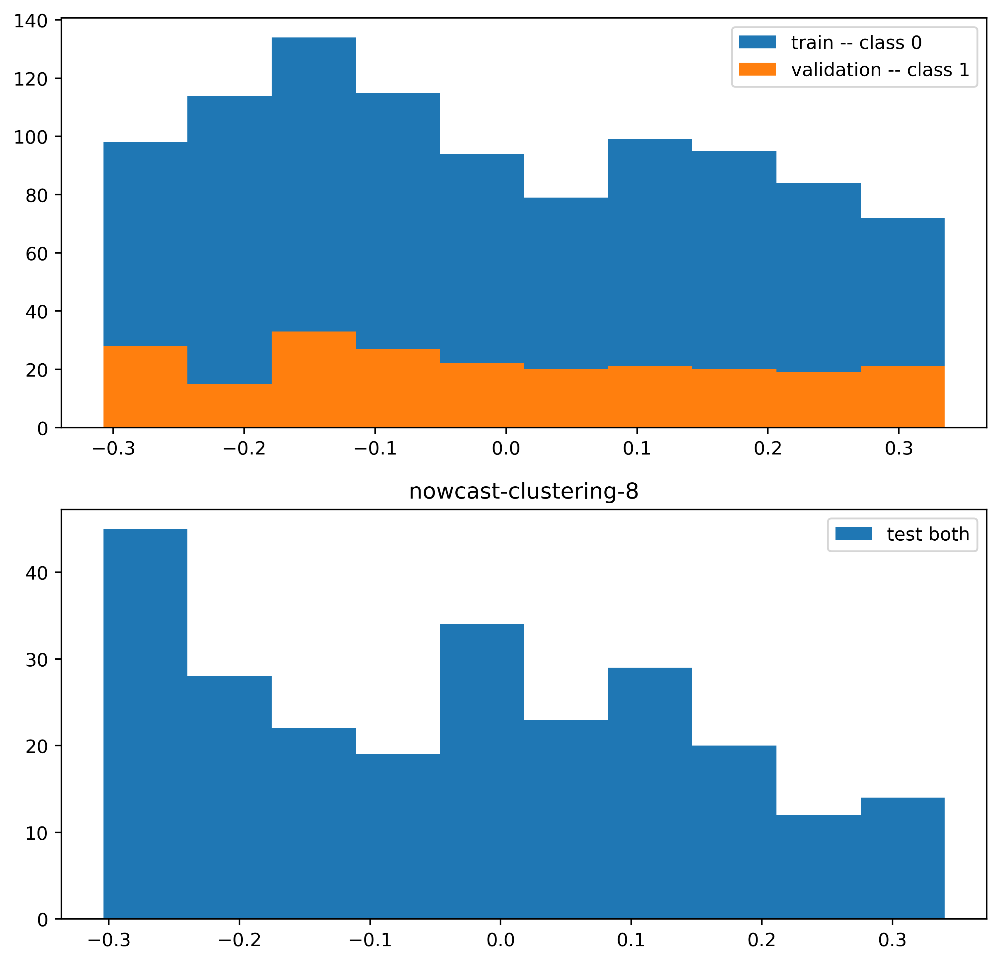

nowcast-clustering-8:  47%|████▋     | 14002/30000 [35:43<1:36:01,  2.78it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  47%|████▋     | 14102/30000 [35:58<39:35,  6.69it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  47%|████▋     | 14202/30000 [36:13<39:23,  6.69it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  48%|████▊     | 14302/30000 [36:28<39:08,  6.69it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  48%|████▊     | 14402/30000 [36:43<38:52,  6.69it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  48%|████▊     | 14502/30000 [36:58<38:33,  6.70it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  49%|████▊     | 14602/30000 [37:13<38:30,  6.66it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  49%|████▉     | 14702/30000 [37:28<38:04,  6.70it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  49%|████▉     | 14802/30000 [37:43<37:51,  6.69it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  50%|████▉     | 14902/30000 [37:58<37:46,  6.66it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  50%|█████     | 15000/30000 [38:13<37:16,  6.71it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


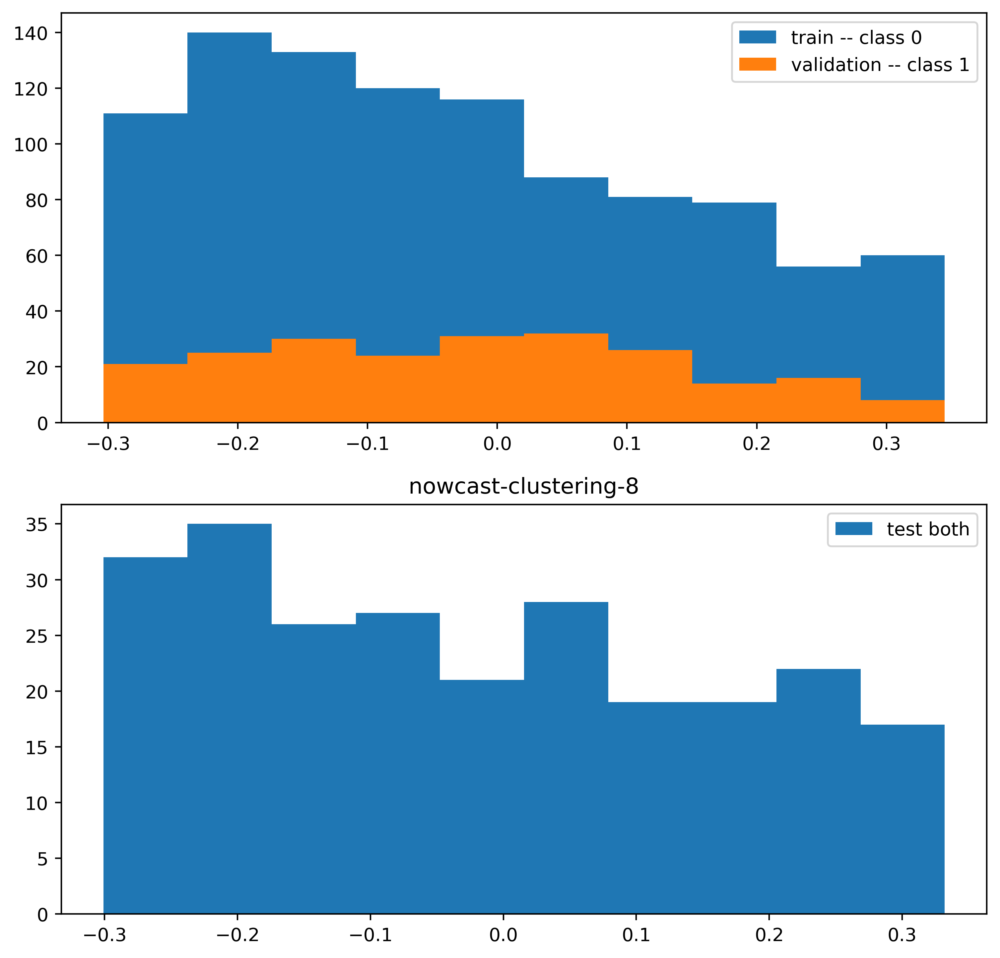

nowcast-clustering-8:  50%|█████     | 15002/30000 [38:14<1:29:16,  2.80it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  50%|█████     | 15102/30000 [38:29<36:54,  6.73it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  51%|█████     | 15202/30000 [38:44<37:05,  6.65it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  51%|█████     | 15302/30000 [38:59<36:43,  6.67it/s, train_loss=-1.86, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  51%|█████▏    | 15402/30000 [39:14<37:28,  6.49it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  52%|█████▏    | 15502/30000 [39:29<36:33,  6.61it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  52%|█████▏    | 15602/30000 [39:44<36:26,  6.58it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  52%|█████▏    | 15702/30000 [39:59<36:15,  6.57it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  53%|█████▎    | 15802/30000 [40:15<35:59,  6.58it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  53%|█████▎    | 15902/30000 [40:30<35:42,  6.58it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  53%|█████▎    | 16000/30000 [40:45<35:26,  6.58it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


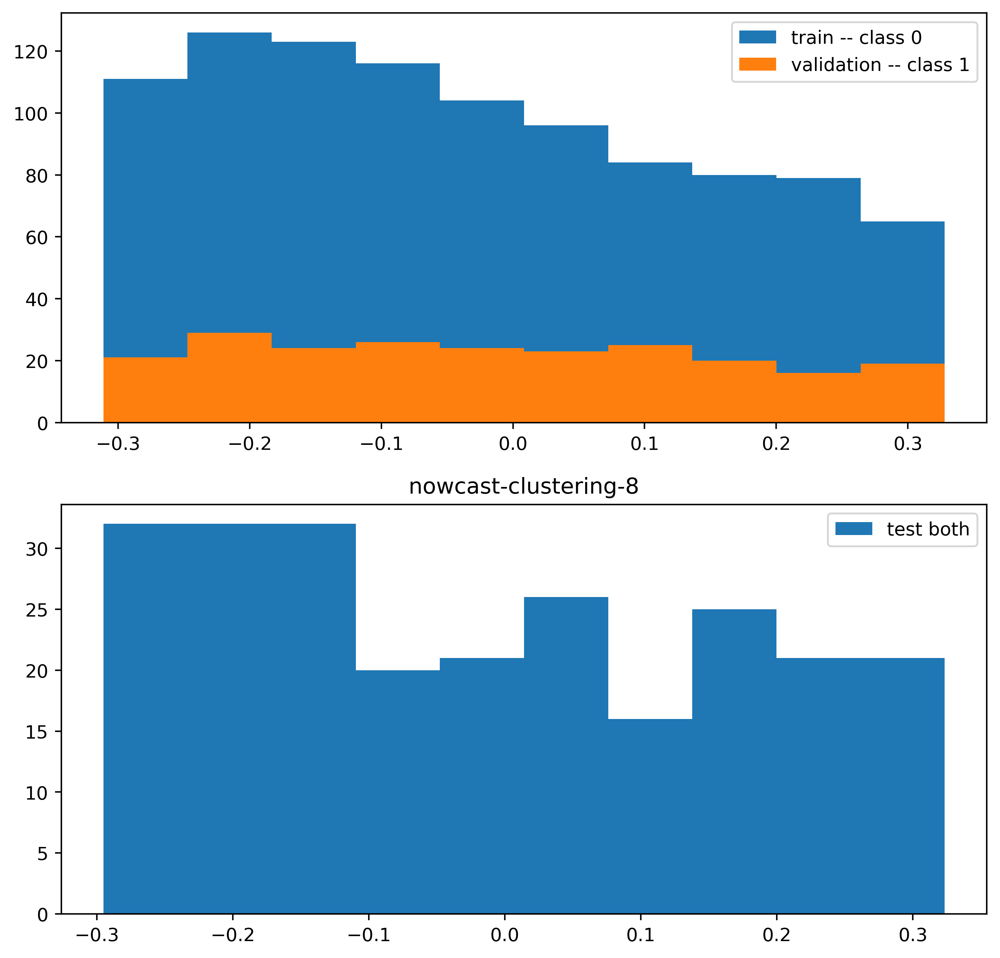

nowcast-clustering-8:  53%|█████▎    | 16002/30000 [40:46<1:24:30,  2.76it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  54%|█████▎    | 16102/30000 [41:01<34:55,  6.63it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  54%|█████▍    | 16202/30000 [41:16<34:42,  6.62it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  54%|█████▍    | 16302/30000 [41:32<34:37,  6.59it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  55%|█████▍    | 16402/30000 [41:47<34:23,  6.59it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  55%|█████▌    | 16502/30000 [42:02<33:55,  6.63it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  55%|█████▌    | 16602/30000 [42:17<33:47,  6.61it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  56%|█████▌    | 16702/30000 [42:32<33:21,  6.64it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  56%|█████▌    | 16802/30000 [42:47<33:13,  6.62it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  56%|█████▋    | 16902/30000 [43:03<33:05,  6.60it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  57%|█████▋    | 17000/30000 [43:18<32:47,  6.61it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


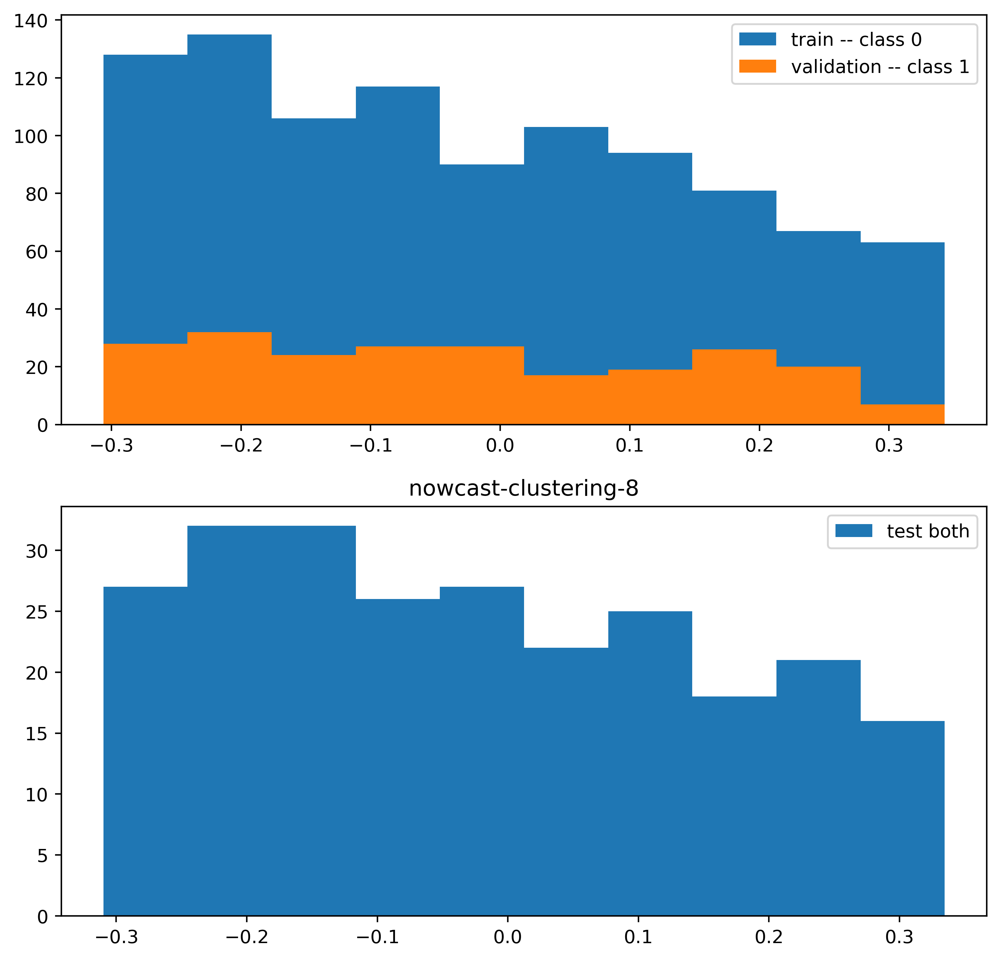

nowcast-clustering-8:  57%|█████▋    | 17002/30000 [43:19<1:17:51,  2.78it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  57%|█████▋    | 17102/30000 [43:34<32:15,  6.66it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  57%|█████▋    | 17202/30000 [43:49<32:07,  6.64it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  58%|█████▊    | 17302/30000 [44:04<31:49,  6.65it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  58%|█████▊    | 17402/30000 [44:19<31:42,  6.62it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  58%|█████▊    | 17502/30000 [44:35<31:31,  6.61it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  59%|█████▊    | 17602/30000 [44:50<31:12,  6.62it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  59%|█████▉    | 17702/30000 [45:05<30:52,  6.64it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  59%|█████▉    | 17802/30000 [45:20<30:39,  6.63it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  60%|█████▉    | 17902/30000 [45:35<30:19,  6.65it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  60%|██████    | 18000/30000 [45:50<30:10,  6.63it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


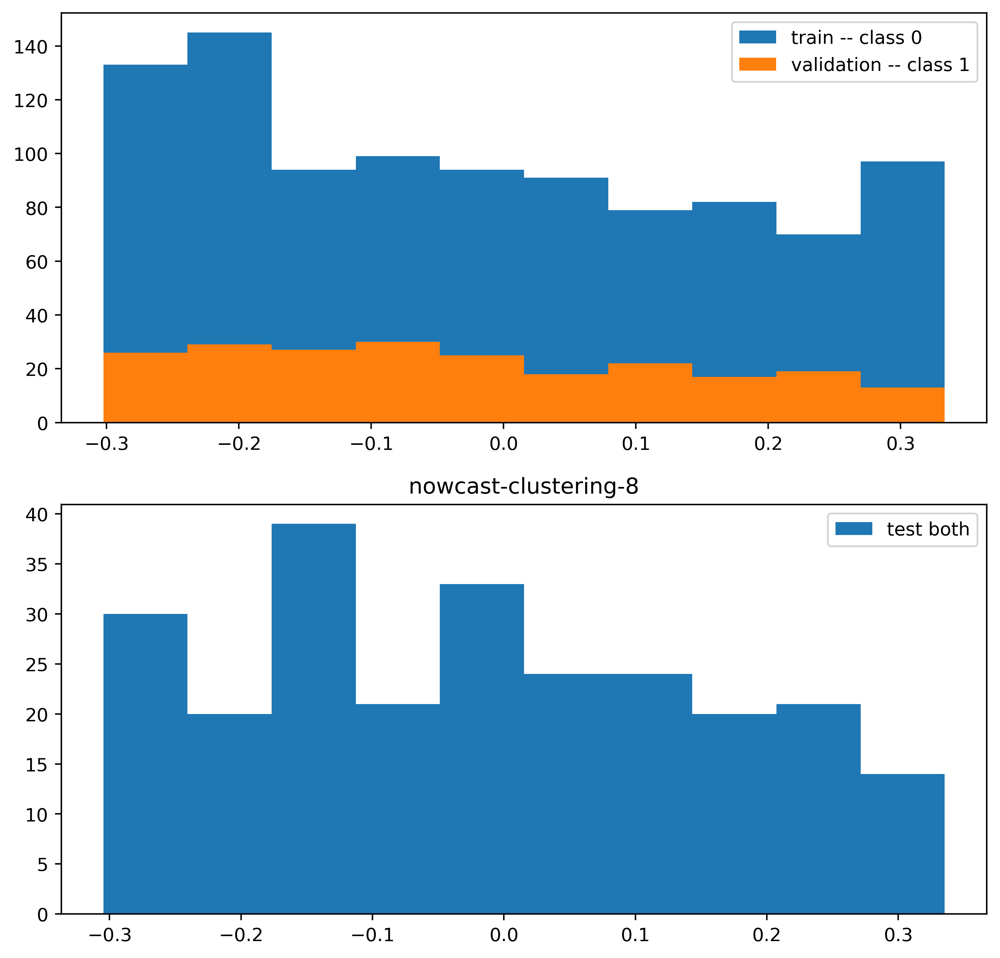

nowcast-clustering-8:  60%|██████    | 18002/30000 [45:51<1:11:54,  2.78it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  60%|██████    | 18102/30000 [46:06<29:46,  6.66it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  61%|██████    | 18202/30000 [46:21<29:29,  6.67it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  61%|██████    | 18302/30000 [46:36<29:12,  6.68it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  61%|██████▏   | 18402/30000 [46:52<29:15,  6.61it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  62%|██████▏   | 18502/30000 [47:07<29:15,  6.55it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  62%|██████▏   | 18602/30000 [47:22<28:47,  6.60it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  62%|██████▏   | 18702/30000 [47:37<28:32,  6.60it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  63%|██████▎   | 18802/30000 [47:52<28:32,  6.54it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  63%|██████▎   | 18902/30000 [48:08<28:01,  6.60it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  63%|██████▎   | 19000/30000 [48:23<27:48,  6.59it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


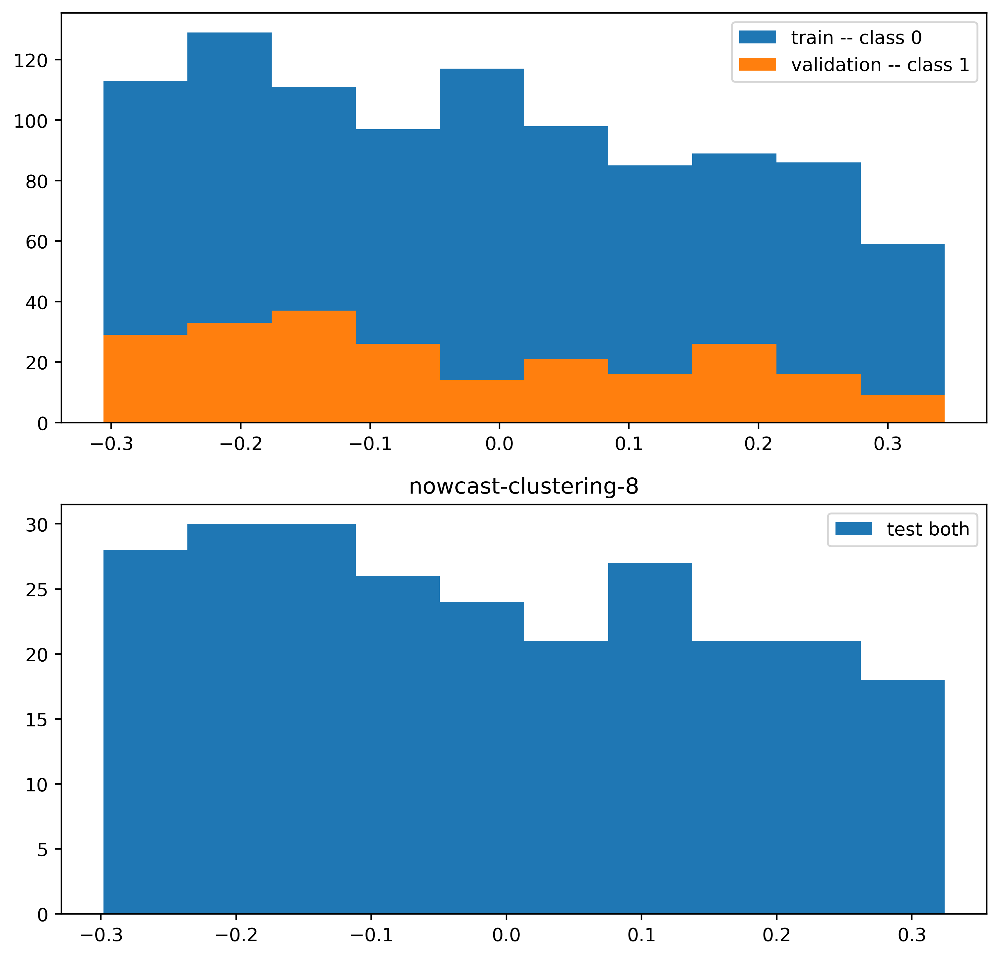

nowcast-clustering-8:  63%|██████▎   | 19002/30000 [48:24<1:05:25,  2.80it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  64%|██████▎   | 19102/30000 [48:39<27:26,  6.62it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-8:  64%|██████▍   | 19202/30000 [48:54<27:19,  6.58it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  64%|██████▍   | 19302/30000 [49:09<27:07,  6.58it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  65%|██████▍   | 19402/30000 [49:25<26:51,  6.58it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  65%|██████▌   | 19502/30000 [49:40<26:33,  6.59it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  65%|██████▌   | 19602/30000 [49:55<26:22,  6.57it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  66%|██████▌   | 19702/30000 [50:10<26:02,  6.59it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  66%|██████▌   | 19802/30000 [50:26<25:42,  6.61it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  66%|██████▋   | 19902/30000 [50:41<25:38,  6.56it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  67%|██████▋   | 20000/30000 [50:56<25:15,  6.60it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


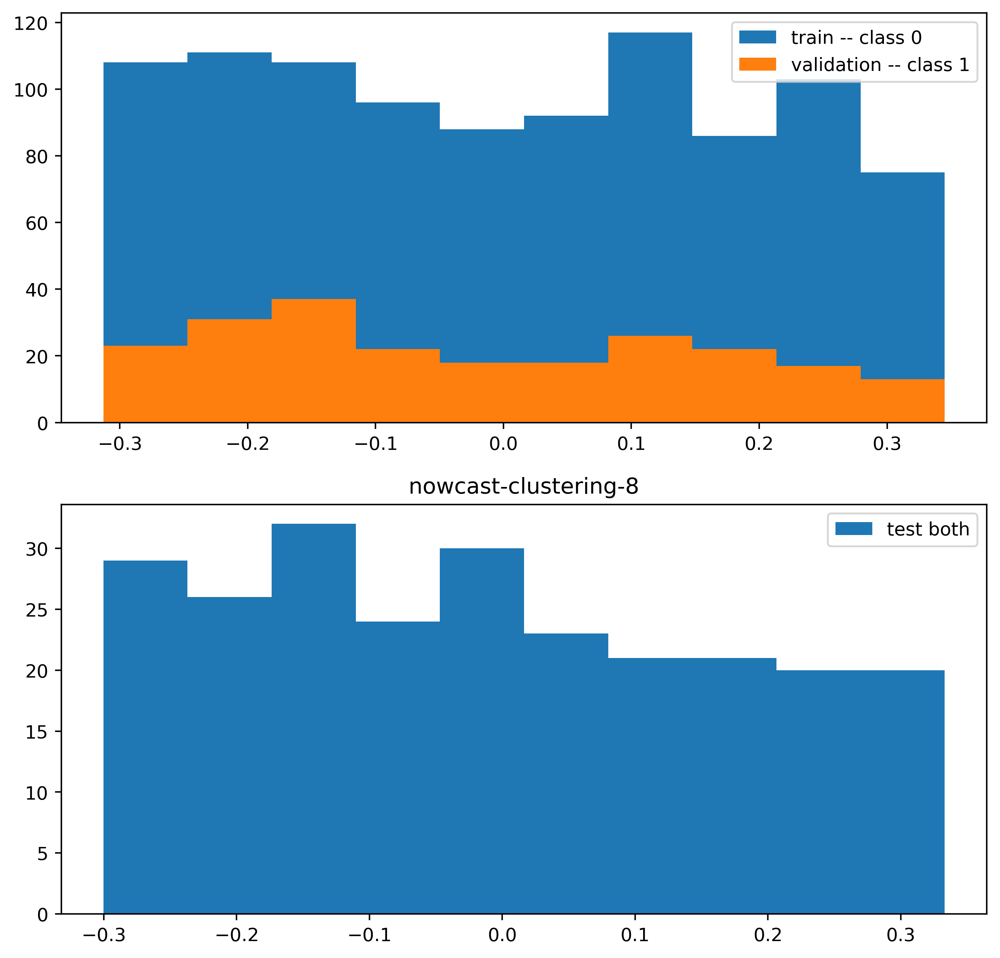

nowcast-clustering-8:  67%|██████▋   | 20002/30000 [50:57<59:39,  2.79it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  67%|██████▋   | 20102/30000 [51:12<25:12,  6.54it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  67%|██████▋   | 20202/30000 [51:28<24:48,  6.58it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  68%|██████▊   | 20302/30000 [51:43<24:38,  6.56it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  68%|██████▊   | 20402/30000 [51:58<24:45,  6.46it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  68%|██████▊   | 20502/30000 [52:13<24:11,  6.54it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  69%|██████▊   | 20602/30000 [52:29<23:47,  6.59it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  69%|██████▉   | 20702/30000 [52:44<23:24,  6.62it/s, train_loss=-1.66, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  69%|██████▉   | 20802/30000 [52:59<23:15,  6.59it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  70%|██████▉   | 20902/30000 [53:14<23:07,  6.56it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  70%|███████   | 21000/30000 [53:29<22:52,  6.56it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


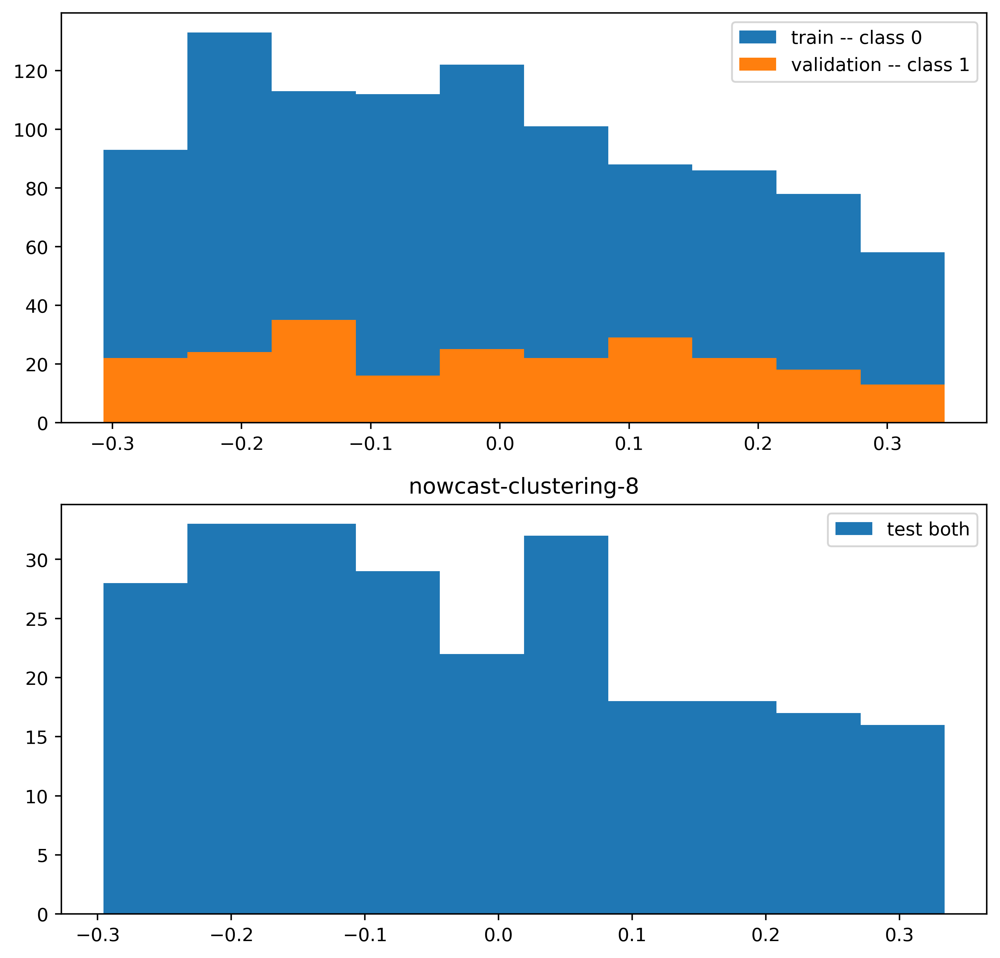

nowcast-clustering-8:  70%|███████   | 21002/30000 [53:30<53:41,  2.79it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  70%|███████   | 21102/30000 [53:46<22:36,  6.56it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  71%|███████   | 21202/30000 [54:01<22:25,  6.54it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  71%|███████   | 21302/30000 [54:16<22:06,  6.56it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  71%|███████▏  | 21402/30000 [54:32<21:47,  6.57it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  72%|███████▏  | 21502/30000 [54:47<21:30,  6.58it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  72%|███████▏  | 21602/30000 [55:02<21:20,  6.56it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  72%|███████▏  | 21702/30000 [55:17<21:00,  6.58it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  73%|███████▎  | 21802/30000 [55:33<20:41,  6.60it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  73%|███████▎  | 21902/30000 [55:48<20:19,  6.64it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  73%|███████▎  | 22000/30000 [56:03<20:15,  6.58it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


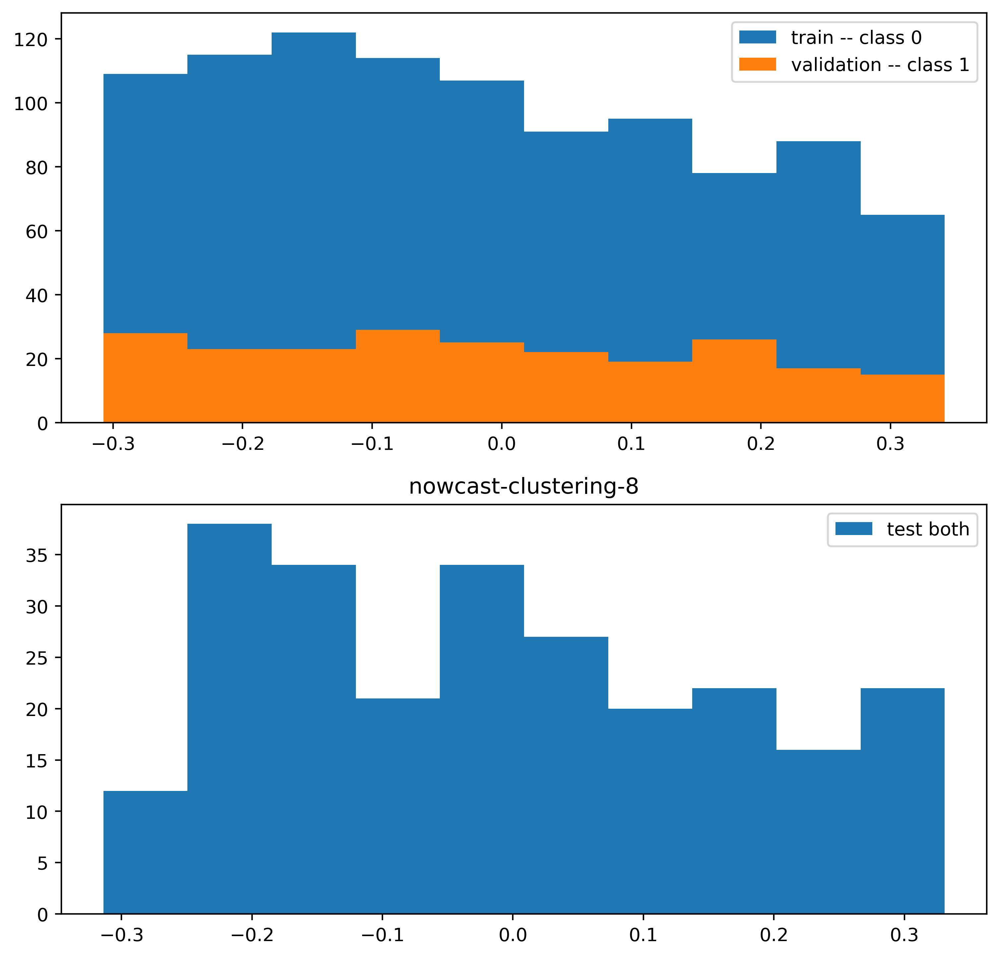

nowcast-clustering-8:  73%|███████▎  | 22002/30000 [56:05<47:58,  2.78it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  74%|███████▎  | 22102/30000 [56:20<20:03,  6.56it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  74%|███████▍  | 22202/30000 [56:35<19:50,  6.55it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  74%|███████▍  | 22302/30000 [56:50<19:35,  6.55it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  75%|███████▍  | 22402/30000 [57:06<19:18,  6.56it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  75%|███████▌  | 22502/30000 [57:21<19:05,  6.55it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  75%|███████▌  | 22602/30000 [57:36<18:48,  6.55it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  76%|███████▌  | 22702/30000 [57:52<18:29,  6.58it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  76%|███████▌  | 22802/30000 [58:07<18:13,  6.59it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  76%|███████▋  | 22902/30000 [58:22<18:03,  6.55it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  77%|███████▋  | 23000/30000 [58:37<17:56,  6.50it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


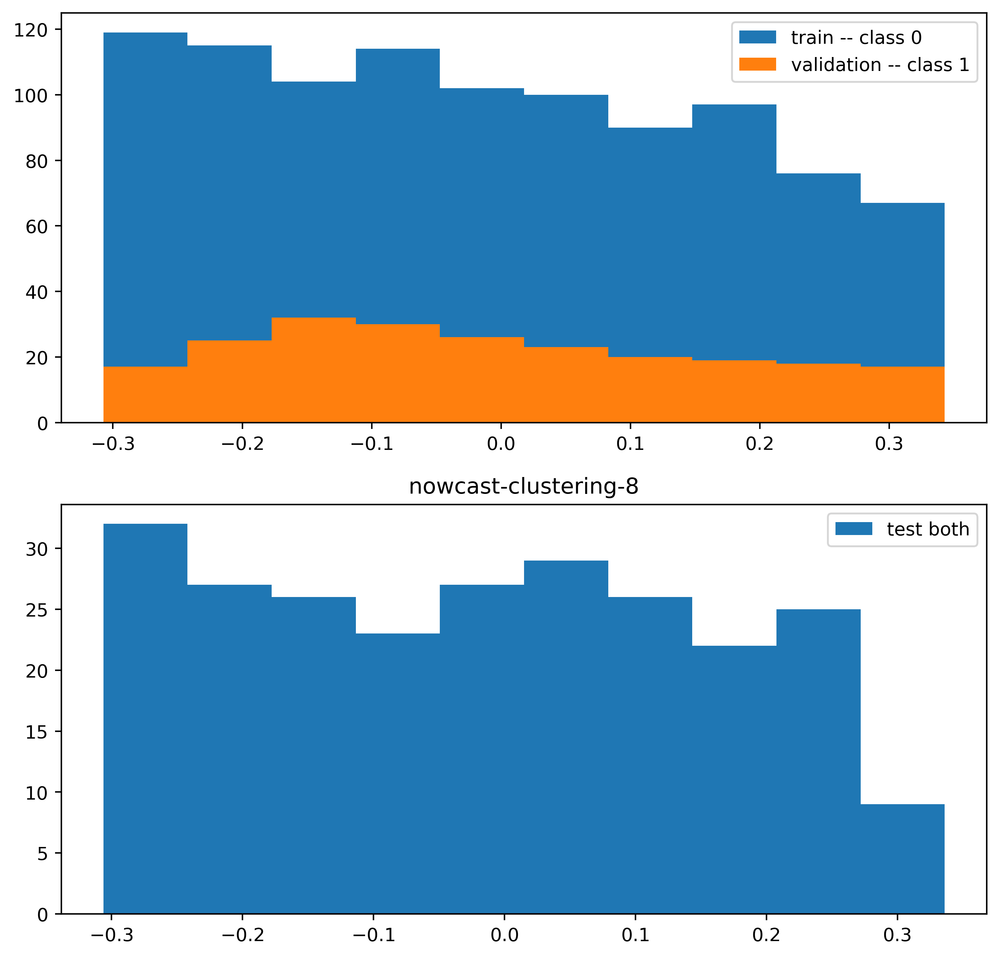

nowcast-clustering-8:  77%|███████▋  | 23002/30000 [58:38<42:17,  2.76it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  77%|███████▋  | 23102/30000 [58:54<17:29,  6.57it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  77%|███████▋  | 23202/30000 [59:09<17:12,  6.58it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  78%|███████▊  | 23302/30000 [59:24<16:53,  6.61it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  78%|███████▊  | 23402/30000 [59:40<16:43,  6.58it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  78%|███████▊  | 23502/30000 [59:55<16:31,  6.55it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  79%|███████▊  | 23602/30000 [1:00:10<16:11,  6.59it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  79%|███████▉  | 23702/30000 [1:00:25<16:06,  6.52it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  79%|███████▉  | 23802/30000 [1:00:41<15:42,  6.57it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  80%|███████▉  | 23902/30000 [1:00:56<15:43,  6.46it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  80%|████████  | 24000/30000 [1:01:11<15:16,  6.55it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


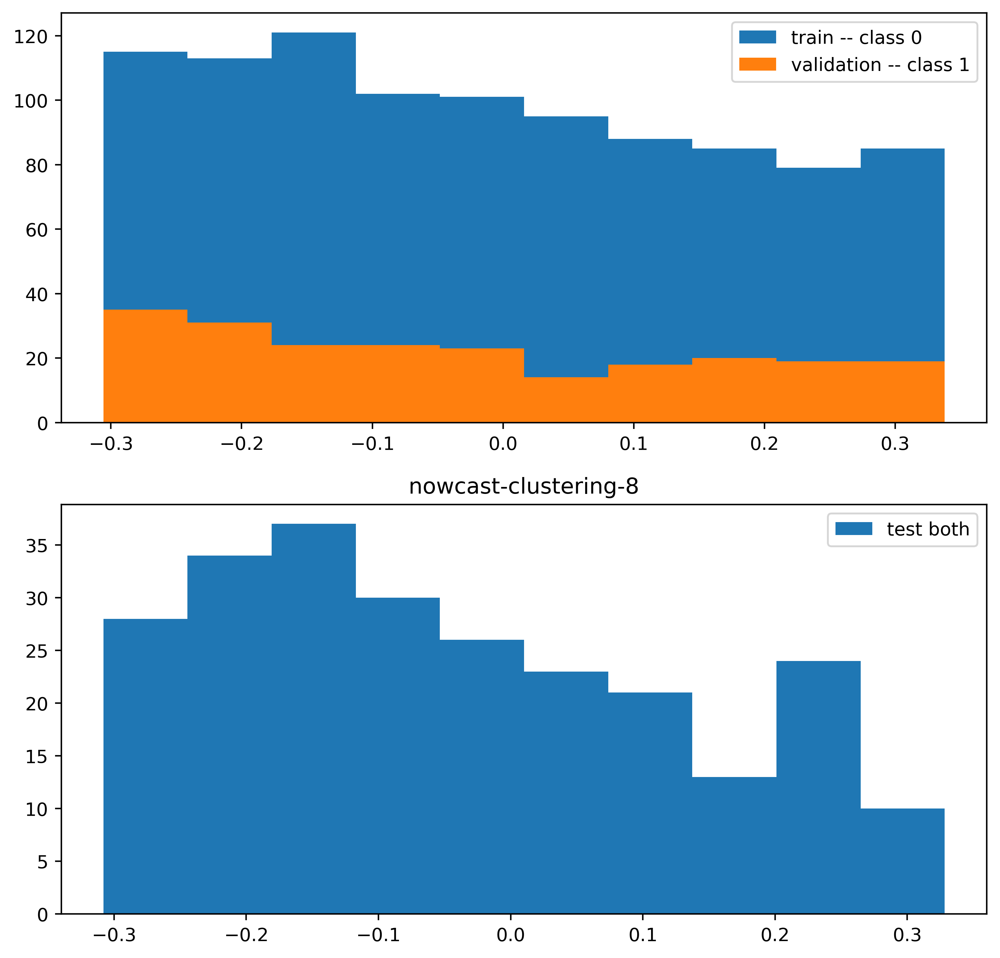

nowcast-clustering-8:  80%|████████  | 24002/30000 [1:01:12<35:55,  2.78it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  80%|████████  | 24102/30000 [1:01:28<15:04,  6.52it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  81%|████████  | 24202/30000 [1:01:43<14:39,  6.59it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  81%|████████  | 24302/30000 [1:01:58<14:31,  6.54it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  81%|████████▏ | 24402/30000 [1:02:13<14:14,  6.55it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  82%|████████▏ | 24502/30000 [1:02:29<13:55,  6.58it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  82%|████████▏ | 24602/30000 [1:02:44<13:46,  6.53it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  82%|████████▏ | 24702/30000 [1:02:59<13:23,  6.59it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  83%|████████▎ | 24802/30000 [1:03:14<13:04,  6.62it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  83%|████████▎ | 24902/30000 [1:03:30<12:53,  6.59it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  83%|████████▎ | 25000/30000 [1:03:45<12:38,  6.59it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


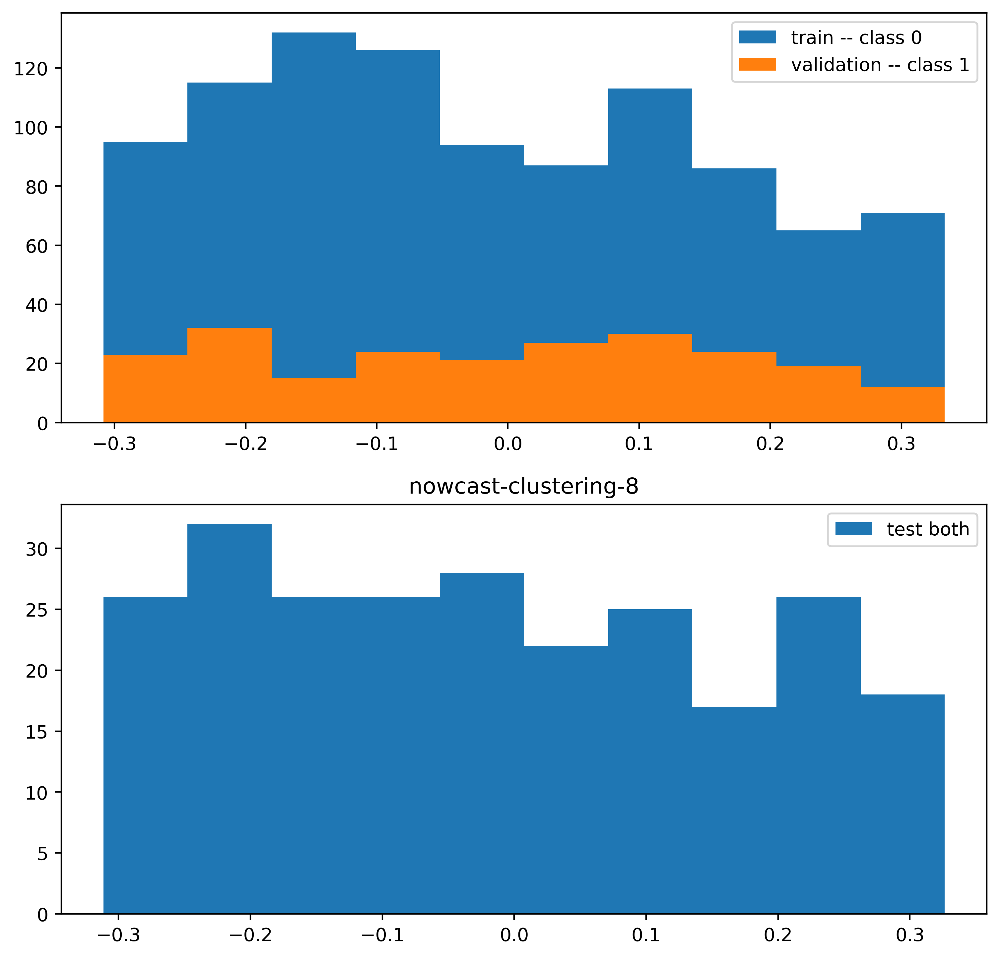

nowcast-clustering-8:  83%|████████▎ | 25002/30000 [1:03:46<29:45,  2.80it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  84%|████████▎ | 25102/30000 [1:04:01<12:22,  6.59it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  84%|████████▍ | 25202/30000 [1:04:17<12:12,  6.55it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  84%|████████▍ | 25302/30000 [1:04:32<11:54,  6.58it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  85%|████████▍ | 25402/30000 [1:04:47<11:39,  6.57it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  85%|████████▌ | 25502/30000 [1:05:03<11:29,  6.53it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  85%|████████▌ | 25602/30000 [1:05:18<11:10,  6.56it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  86%|████████▌ | 25702/30000 [1:05:33<10:55,  6.56it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  86%|████████▌ | 25802/30000 [1:05:49<10:46,  6.49it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  86%|████████▋ | 25902/30000 [1:06:04<10:23,  6.57it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  87%|████████▋ | 26000/30000 [1:06:19<10:07,  6.59it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


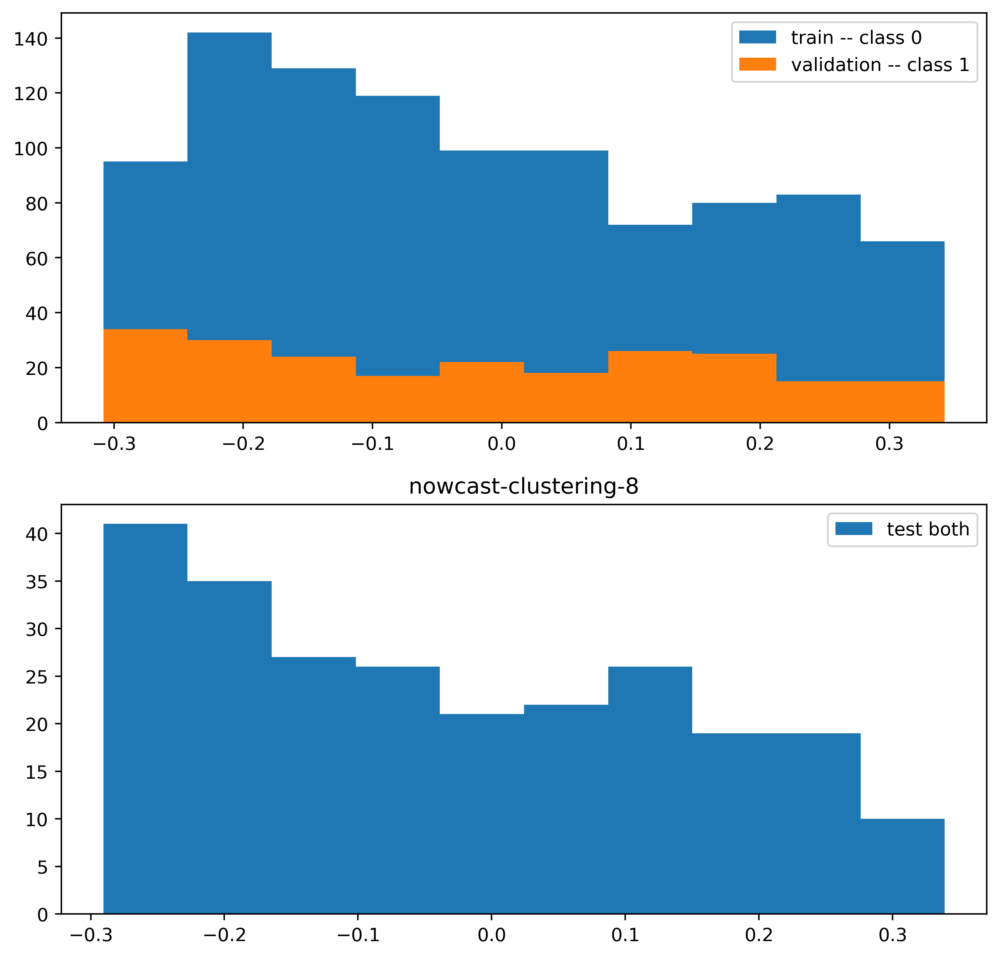

nowcast-clustering-8:  87%|████████▋ | 26002/30000 [1:06:20<24:03,  2.77it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  87%|████████▋ | 26102/30000 [1:06:35<09:50,  6.60it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  87%|████████▋ | 26202/30000 [1:06:51<09:40,  6.55it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  88%|████████▊ | 26302/30000 [1:07:06<09:20,  6.59it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  88%|████████▊ | 26402/30000 [1:07:21<09:05,  6.60it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  88%|████████▊ | 26502/30000 [1:07:36<08:51,  6.58it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  89%|████████▊ | 26602/30000 [1:07:52<08:36,  6.58it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  89%|████████▉ | 26702/30000 [1:08:07<08:20,  6.59it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  89%|████████▉ | 26802/30000 [1:08:22<08:05,  6.59it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  90%|████████▉ | 26902/30000 [1:08:37<07:50,  6.59it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  90%|█████████ | 27000/30000 [1:08:52<07:35,  6.59it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


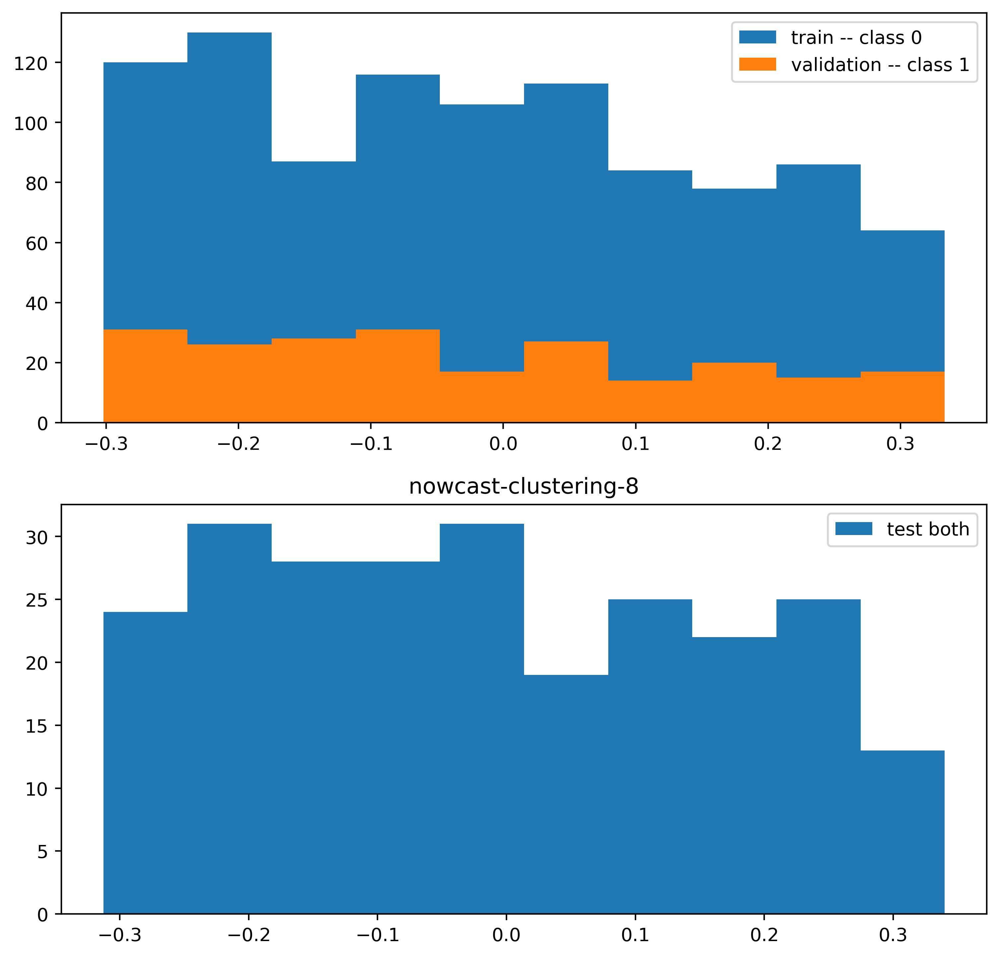

nowcast-clustering-8:  90%|█████████ | 27002/30000 [1:08:53<17:46,  2.81it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  90%|█████████ | 27102/30000 [1:09:09<07:18,  6.60it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  91%|█████████ | 27202/30000 [1:09:24<07:03,  6.61it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  91%|█████████ | 27302/30000 [1:09:39<06:51,  6.56it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  91%|█████████▏| 27402/30000 [1:09:54<06:37,  6.54it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  92%|█████████▏| 27502/30000 [1:10:10<06:20,  6.57it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  92%|█████████▏| 27602/30000 [1:10:25<06:04,  6.58it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  92%|█████████▏| 27702/30000 [1:10:40<05:48,  6.60it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  93%|█████████▎| 27802/30000 [1:10:55<05:36,  6.53it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  93%|█████████▎| 27902/30000 [1:11:10<05:17,  6.61it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  93%|█████████▎| 28000/30000 [1:11:26<05:02,  6.60it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


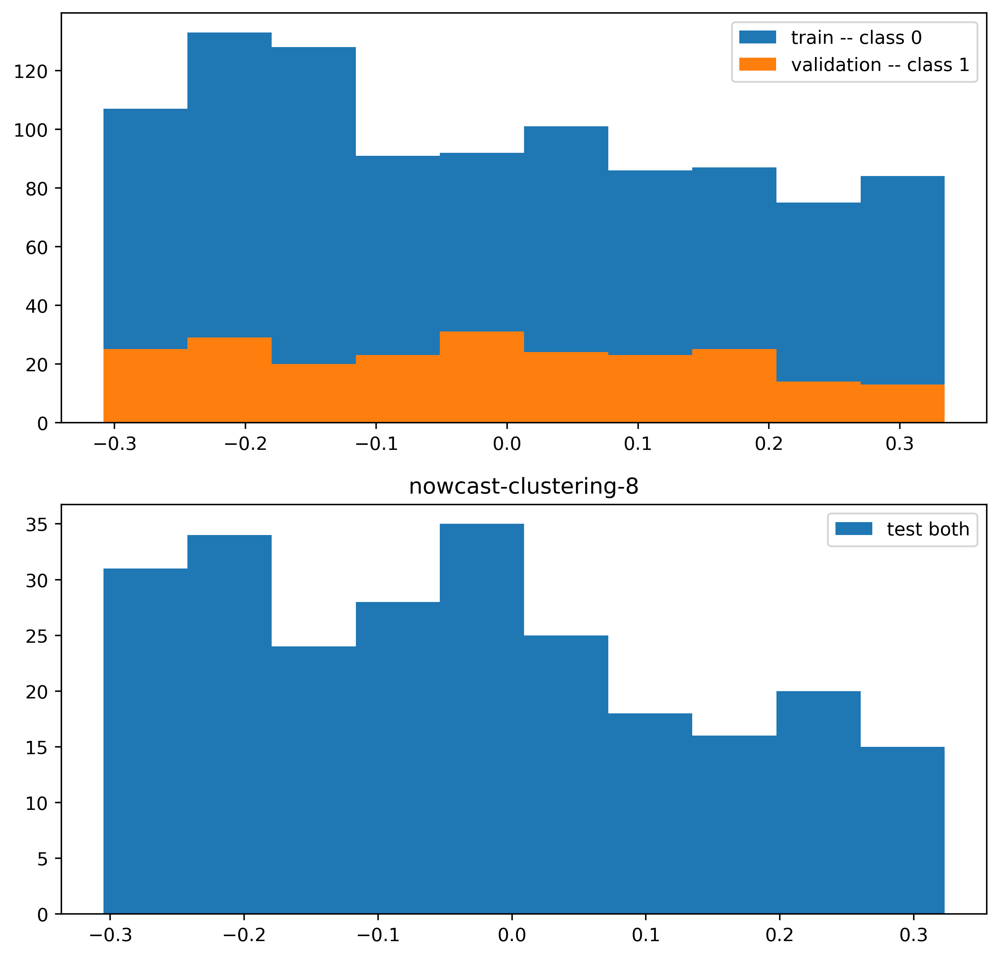

nowcast-clustering-8:  93%|█████████▎| 28002/30000 [1:11:27<11:53,  2.80it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  94%|█████████▎| 28102/30000 [1:11:42<04:48,  6.58it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  94%|█████████▍| 28202/30000 [1:11:57<04:35,  6.53it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  94%|█████████▍| 28302/30000 [1:12:13<04:19,  6.55it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  95%|█████████▍| 28402/30000 [1:12:28<04:05,  6.51it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  95%|█████████▌| 28502/30000 [1:12:43<03:47,  6.60it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  95%|█████████▌| 28602/30000 [1:12:59<03:33,  6.55it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  96%|█████████▌| 28702/30000 [1:13:14<03:18,  6.54it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  96%|█████████▌| 28802/30000 [1:13:29<03:03,  6.55it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  96%|█████████▋| 28902/30000 [1:13:45<02:48,  6.53it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  97%|█████████▋| 29000/30000 [1:14:00<02:33,  6.52it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


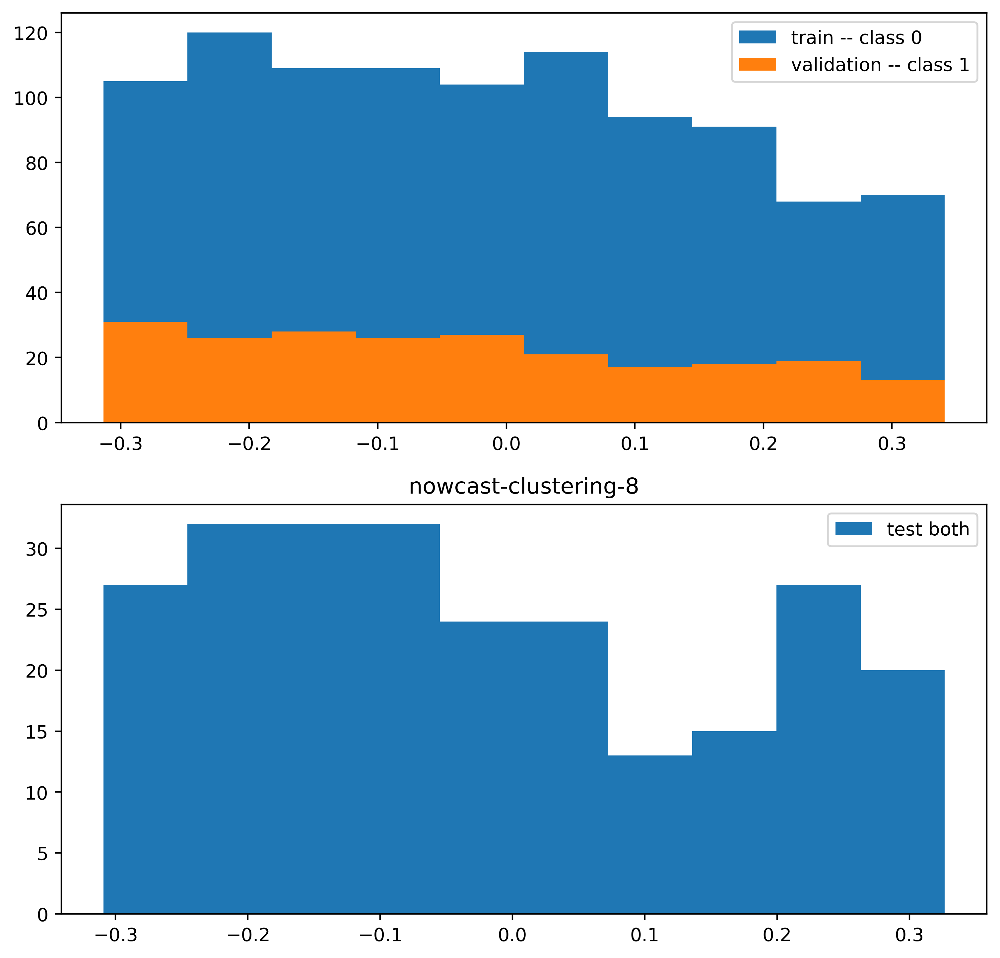

nowcast-clustering-8:  97%|█████████▋| 29002/30000 [1:14:01<05:57,  2.79it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-8 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-8:  97%|█████████▋| 29102/30000 [1:14:16<02:16,  6.57it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  97%|█████████▋| 29202/30000 [1:14:31<02:00,  6.63it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-8:  98%|█████████▊| 29302/30000 [1:14:47<01:49,  6.40it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  98%|█████████▊| 29402/30000 [1:15:02<01:31,  6.55it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  98%|█████████▊| 29502/30000 [1:15:17<01:15,  6.59it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  99%|█████████▊| 29602/30000 [1:15:32<00:59,  6.64it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  99%|█████████▉| 29702/30000 [1:15:47<00:44,  6.65it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8:  99%|█████████▉| 29802/30000 [1:16:02<00:29,  6.66it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-8: 100%|█████████▉| 29902/30000 [1:16:18<00:14,  6.63it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:   0%|          | 0/30000 [00:00<?, ?it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 1.0
984 984 984
(array([0]), array([984]))


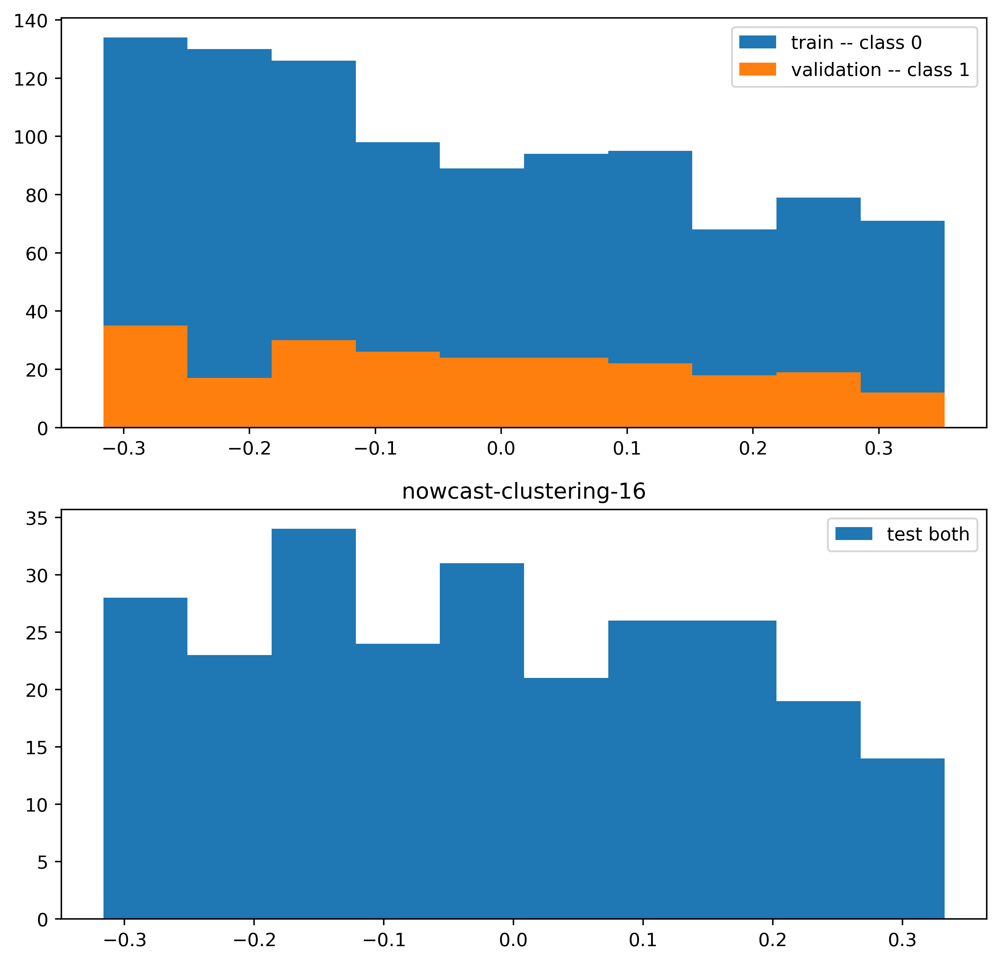

nowcast-clustering-16:   0%|          | 2/30000 [00:01<4:53:07,  1.71it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:   0%|          | 102/30000 [00:15<1:10:38,  7.05it/s, train_loss=-1.68, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.9801986733067553


nowcast-clustering-16:   1%|          | 202/30000 [00:29<1:10:28,  7.05it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.9417645335842486


nowcast-clustering-16:   1%|          | 302/30000 [00:43<1:10:17,  7.04it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.8869204367171575


nowcast-clustering-16:   1%|▏         | 402/30000 [00:58<1:09:39,  7.08it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.8187307530779818


nowcast-clustering-16:   2%|▏         | 502/30000 [01:12<1:09:22,  7.09it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.7408182206817178


nowcast-clustering-16:   2%|▏         | 602/30000 [01:26<1:09:04,  7.09it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.6570468198150566


nowcast-clustering-16:   2%|▏         | 702/30000 [01:40<1:08:31,  7.13it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.5712090638488148


nowcast-clustering-16:   3%|▎         | 802/30000 [01:54<1:08:33,  7.10it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.48675225595997157


nowcast-clustering-16:   3%|▎         | 902/30000 [02:08<1:08:18,  7.10it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.40656965974059905


nowcast-clustering-16:   3%|▎         | 1000/30000 [02:23<1:08:13,  7.08it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.3328710836980795
984 984 984
(array([0]), array([984]))


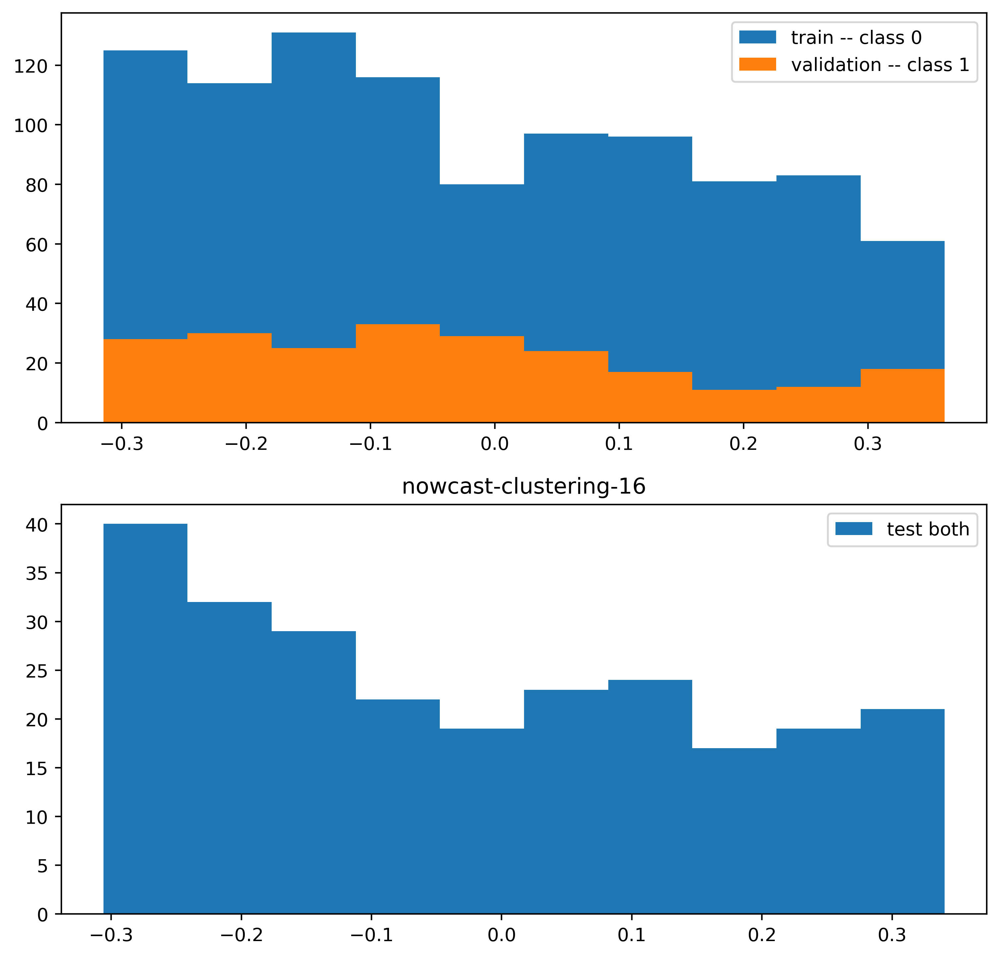

nowcast-clustering-16:   3%|▎         | 1002/30000 [02:24<2:47:09,  2.89it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:   4%|▎         | 1102/30000 [02:38<1:07:33,  7.13it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.26713530196585034


nowcast-clustering-16:   4%|▍         | 1202/30000 [02:52<1:07:28,  7.11it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.2101360712007647


nowcast-clustering-16:   4%|▍         | 1302/30000 [03:06<1:07:07,  7.13it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.16202575093388072


nowcast-clustering-16:   5%|▍         | 1402/30000 [03:20<1:07:29,  7.06it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.12245642825298188


nowcast-clustering-16:   5%|▌         | 1502/30000 [03:34<1:07:04,  7.08it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.09071795328941248


nowcast-clustering-16:   5%|▌         | 1602/30000 [03:49<1:07:14,  7.04it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.06587475442640295


nowcast-clustering-16:   6%|▌         | 1702/30000 [04:03<1:06:42,  7.07it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.04688769521998848


nowcast-clustering-16:   6%|▌         | 1802/30000 [04:17<1:06:31,  7.07it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.032712434939019805


nowcast-clustering-16:   6%|▋         | 1902/30000 [04:32<1:06:34,  7.03it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.022370771856165587


nowcast-clustering-16:   7%|▋         | 2000/30000 [04:46<1:11:21,  6.54it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.014995576820477701
984 984 984
(array([0]), array([984]))


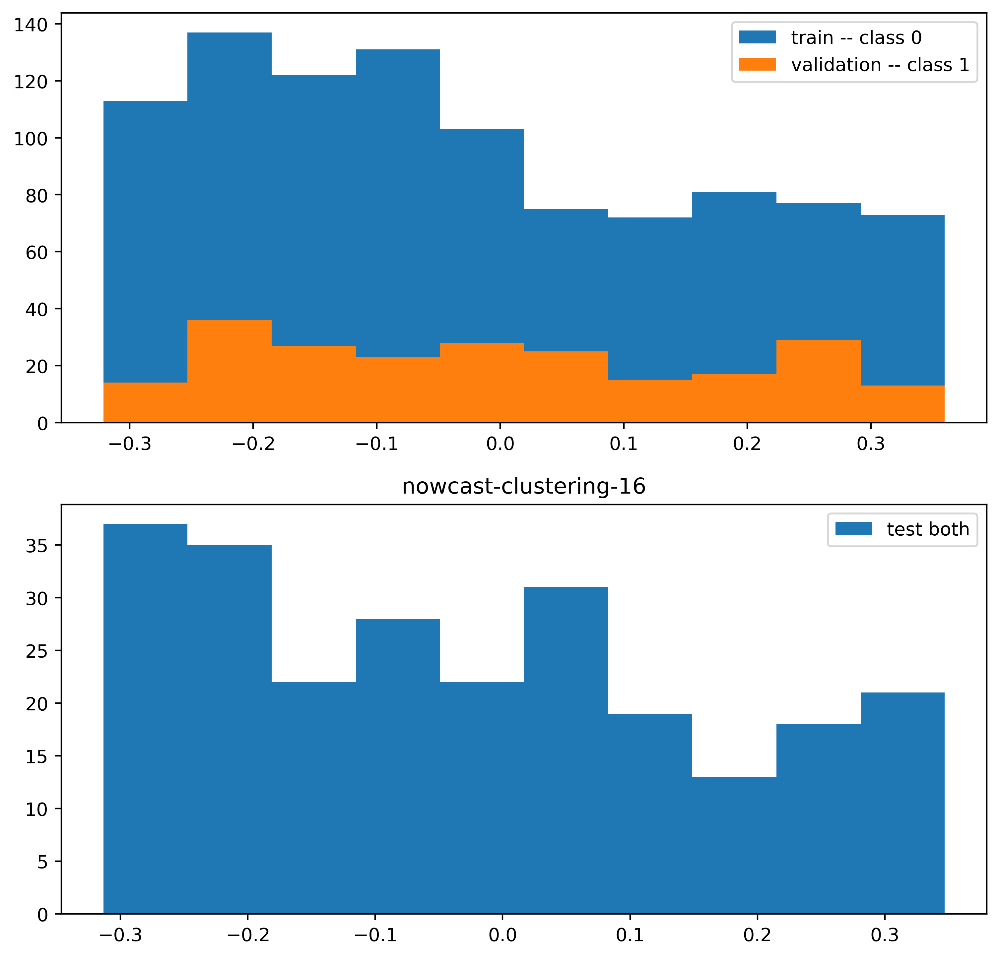

nowcast-clustering-16:   7%|▋         | 2002/30000 [04:47<2:45:00,  2.83it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:   7%|▋         | 2102/30000 [05:01<1:05:18,  7.12it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.009852796061187254


nowcast-clustering-16:   7%|▋         | 2202/30000 [05:15<1:05:13,  7.10it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.006345559512909111


nowcast-clustering-16:   8%|▊         | 2302/30000 [05:29<1:04:49,  7.12it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.004005847942090417


nowcast-clustering-16:   8%|▊         | 2402/30000 [05:43<1:04:35,  7.12it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.002478752176666357


nowcast-clustering-16:   8%|▊         | 2502/30000 [05:57<1:04:22,  7.12it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.0015034391929775717


nowcast-clustering-16:   9%|▊         | 2602/30000 [06:11<1:04:06,  7.12it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:   9%|▉         | 2702/30000 [06:25<1:03:51,  7.12it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:   9%|▉         | 2802/30000 [06:40<1:03:55,  7.09it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  10%|▉         | 2902/30000 [06:54<1:03:31,  7.11it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  10%|█         | 3000/30000 [07:08<1:03:00,  7.14it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


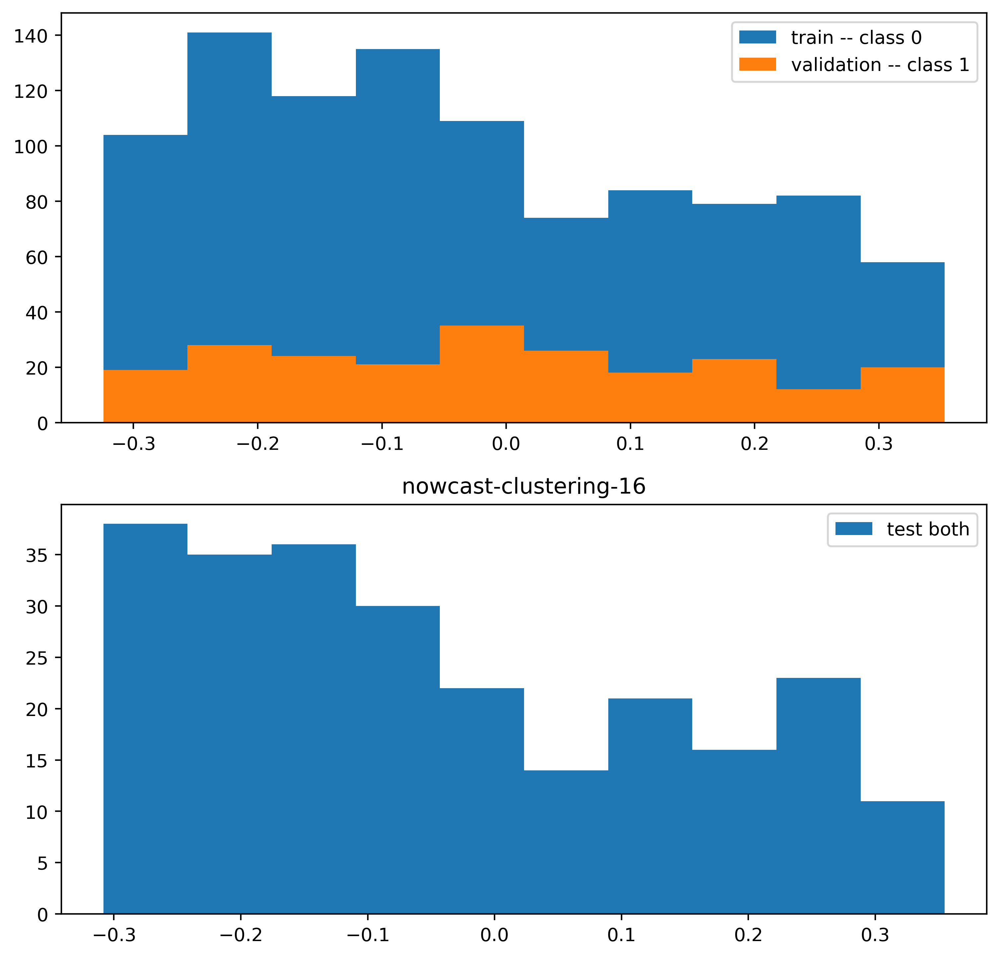

nowcast-clustering-16:  10%|█         | 3002/30000 [07:09<2:35:38,  2.89it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  10%|█         | 3102/30000 [07:23<1:04:01,  7.00it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  11%|█         | 3202/30000 [07:37<1:03:33,  7.03it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  11%|█         | 3302/30000 [07:52<1:03:15,  7.03it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  11%|█▏        | 3402/30000 [08:06<1:02:48,  7.06it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  12%|█▏        | 3502/30000 [08:20<1:02:52,  7.02it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  12%|█▏        | 3602/30000 [08:34<1:02:31,  7.04it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  12%|█▏        | 3702/30000 [08:49<1:02:11,  7.05it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  13%|█▎        | 3802/30000 [09:03<1:01:50,  7.06it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  13%|█▎        | 3902/30000 [09:17<1:01:46,  7.04it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  13%|█▎        | 4000/30000 [09:31<1:01:54,  7.00it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


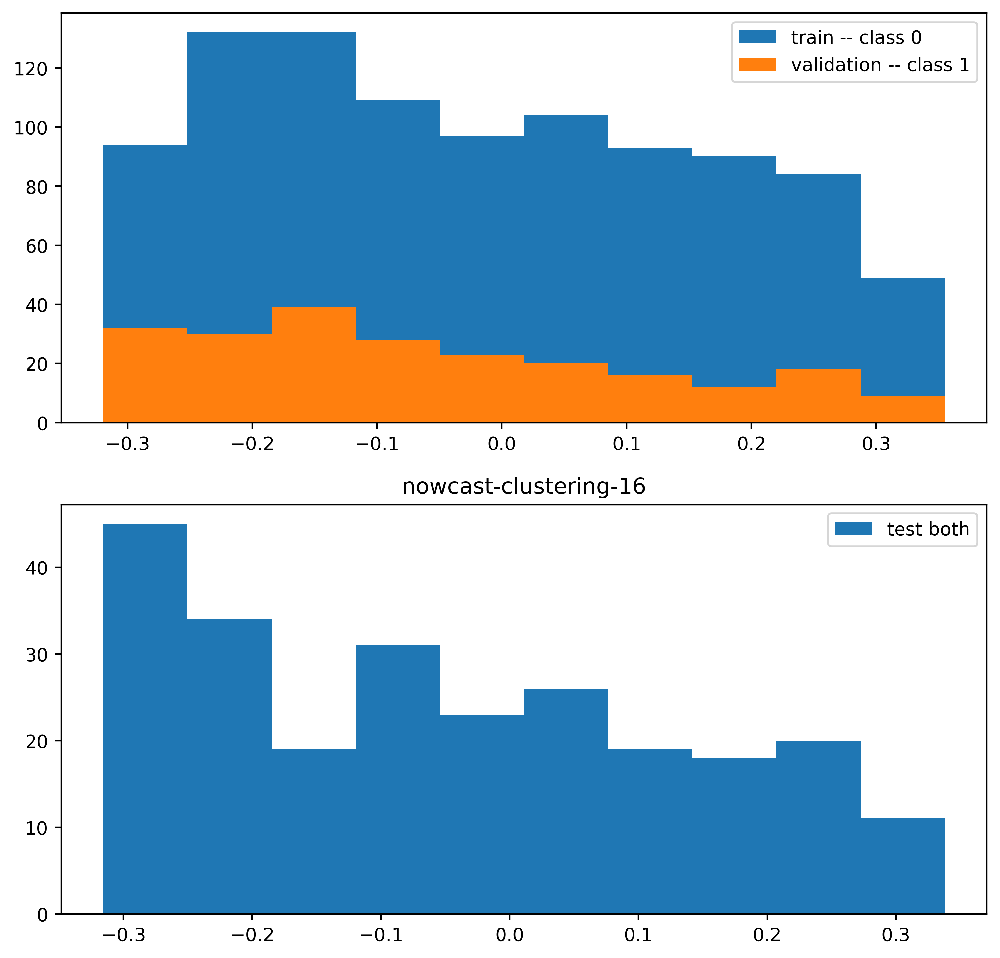

nowcast-clustering-16:  13%|█▎        | 4002/30000 [09:32<2:28:07,  2.93it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  14%|█▎        | 4102/30000 [09:47<1:01:27,  7.02it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  14%|█▍        | 4202/30000 [10:01<1:01:06,  7.04it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  14%|█▍        | 4302/30000 [10:15<1:00:46,  7.05it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  15%|█▍        | 4402/30000 [10:30<1:01:04,  6.99it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  15%|█▌        | 4502/30000 [10:44<1:00:52,  6.98it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  15%|█▌        | 4602/30000 [10:58<59:56,  7.06it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]   

New Model Temperature: 0.001


nowcast-clustering-16:  16%|█▌        | 4702/30000 [11:13<59:53,  7.04it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  16%|█▌        | 4802/30000 [11:27<1:02:09,  6.76it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  16%|█▋        | 4902/30000 [11:41<59:27,  7.03it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]   

New Model Temperature: 0.001


nowcast-clustering-16:  17%|█▋        | 5000/30000 [11:55<59:15,  7.03it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


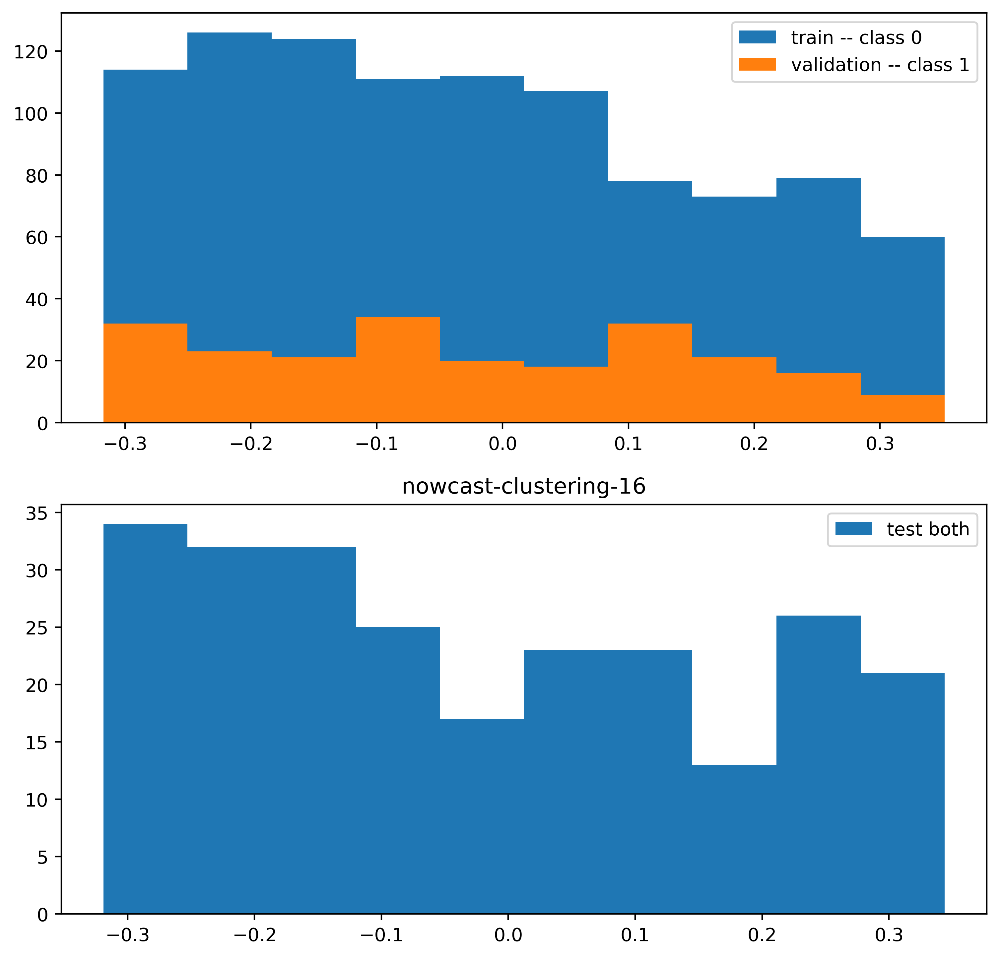

nowcast-clustering-16:  17%|█▋        | 5002/30000 [11:56<2:24:50,  2.88it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  17%|█▋        | 5102/30000 [12:11<59:28,  6.98it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]   

New Model Temperature: 0.001


nowcast-clustering-16:  17%|█▋        | 5202/30000 [12:25<58:51,  7.02it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  18%|█▊        | 5302/30000 [12:39<58:29,  7.04it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  18%|█▊        | 5402/30000 [12:54<58:04,  7.06it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  18%|█▊        | 5502/30000 [13:08<58:42,  6.96it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  19%|█▊        | 5602/30000 [13:22<57:42,  7.05it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  19%|█▉        | 5702/30000 [13:36<57:39,  7.02it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  19%|█▉        | 5802/30000 [13:51<57:37,  7.00it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  20%|█▉        | 5902/30000 [14:05<57:06,  7.03it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  20%|██        | 6000/30000 [14:19<56:37,  7.06it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


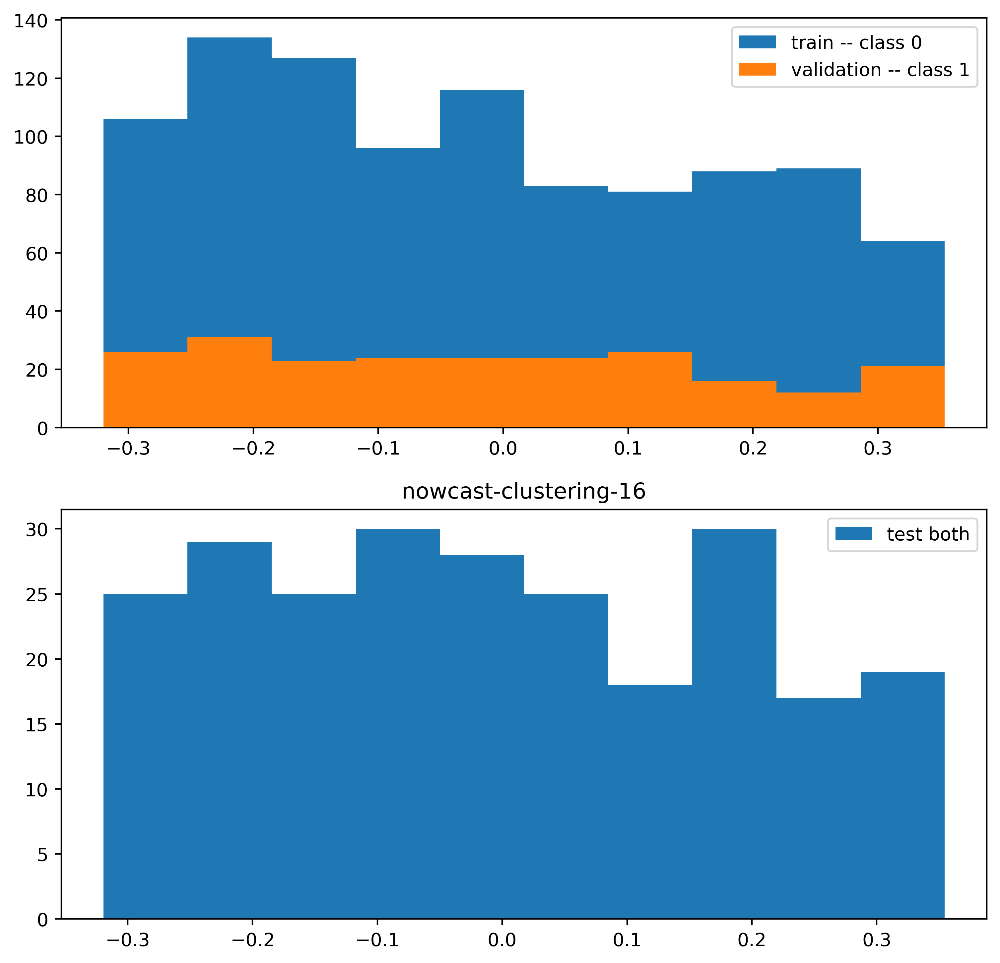

nowcast-clustering-16:  20%|██        | 6002/30000 [14:20<2:18:07,  2.90it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  20%|██        | 6102/30000 [14:35<57:08,  6.97it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]   

New Model Temperature: 0.001


nowcast-clustering-16:  21%|██        | 6202/30000 [14:49<56:09,  7.06it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  21%|██        | 6302/30000 [15:03<56:27,  7.00it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  21%|██▏       | 6402/30000 [15:18<56:03,  7.02it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  22%|██▏       | 6502/30000 [15:32<56:17,  6.96it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  22%|██▏       | 6602/30000 [15:46<55:15,  7.06it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  22%|██▏       | 6702/30000 [16:01<55:20,  7.02it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  23%|██▎       | 6802/30000 [16:15<55:20,  6.99it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  23%|██▎       | 6902/30000 [16:29<55:11,  6.98it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  23%|██▎       | 7000/30000 [16:43<54:45,  7.00it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


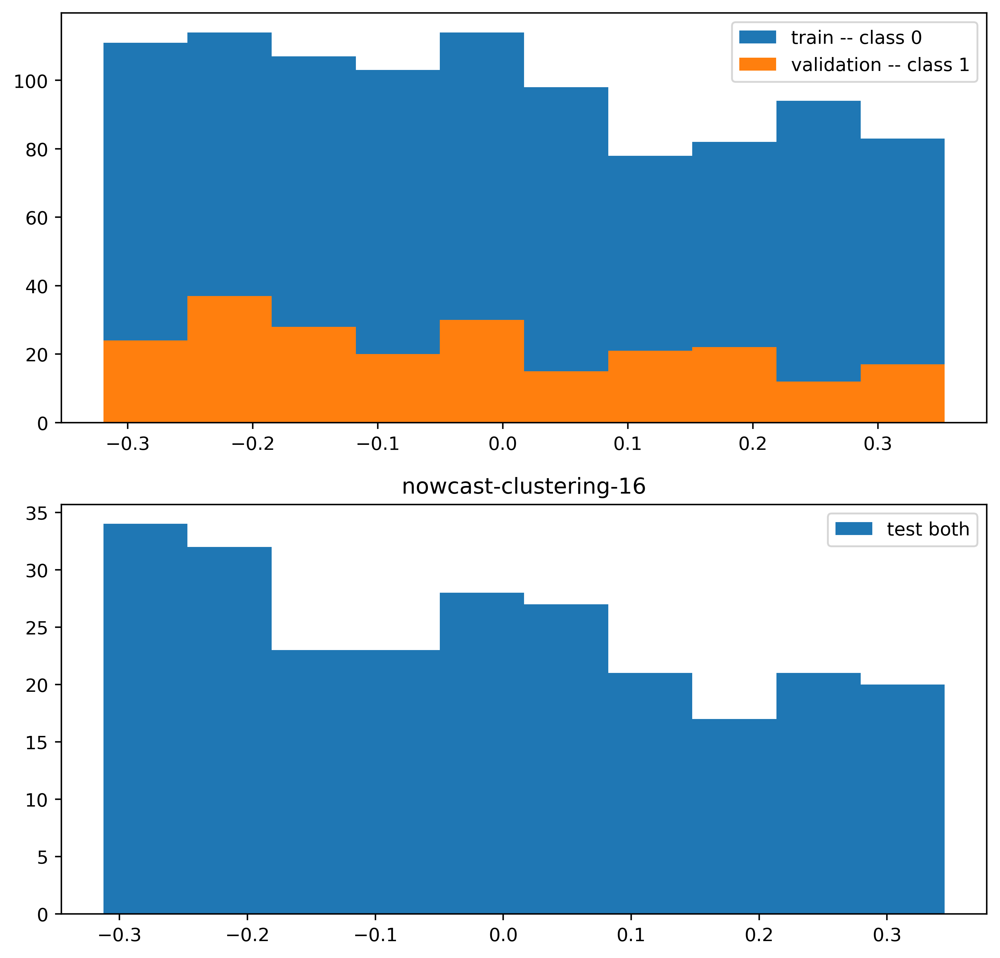

nowcast-clustering-16:  23%|██▎       | 7002/30000 [16:44<2:11:18,  2.92it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  24%|██▎       | 7102/30000 [16:59<54:31,  7.00it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  24%|██▍       | 7202/30000 [17:13<54:34,  6.96it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  24%|██▍       | 7302/30000 [17:27<53:47,  7.03it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  25%|██▍       | 7402/30000 [17:42<53:40,  7.02it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  25%|██▌       | 7502/30000 [17:56<53:25,  7.02it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  25%|██▌       | 7602/30000 [18:10<53:16,  7.01it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  26%|██▌       | 7702/30000 [18:25<53:15,  6.98it/s, train_loss=-1.69, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  26%|██▌       | 7802/30000 [18:39<53:10,  6.96it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  26%|██▋       | 7902/30000 [18:54<52:52,  6.96it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  27%|██▋       | 8000/30000 [19:08<53:14,  6.89it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


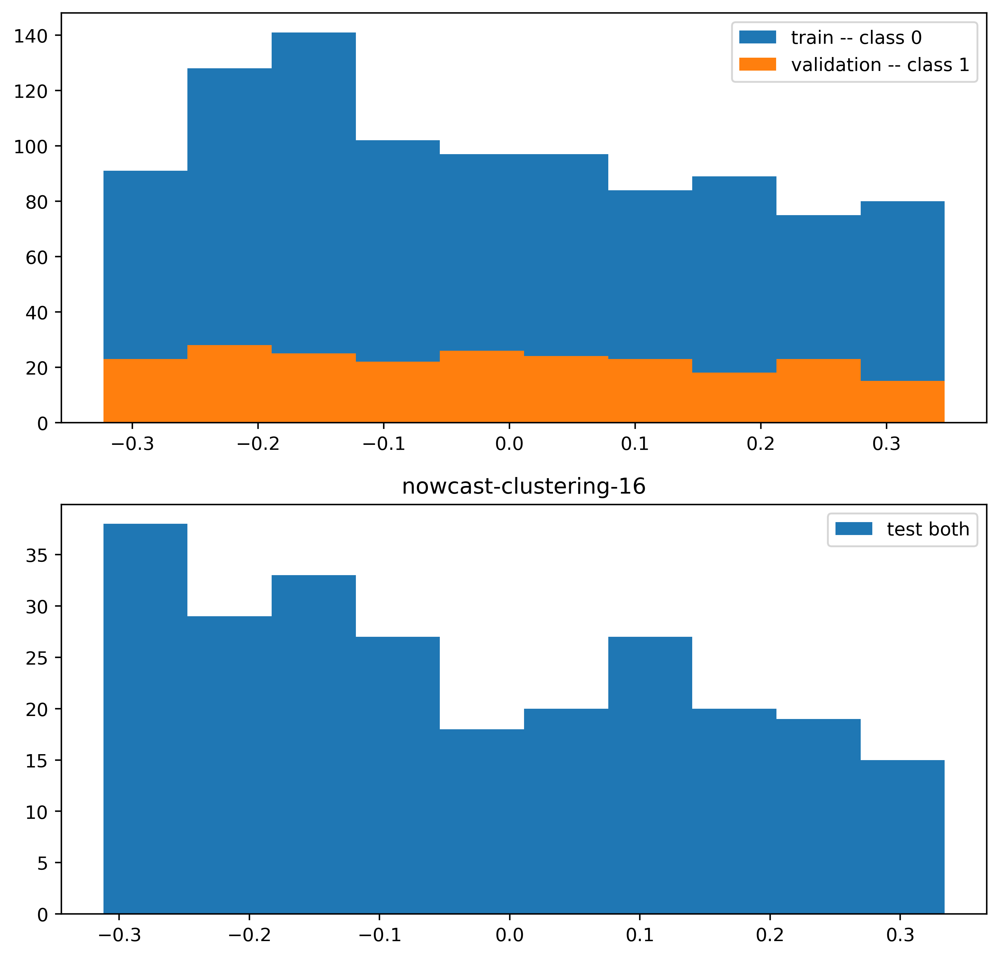

nowcast-clustering-16:  27%|██▋       | 8002/30000 [19:09<2:09:34,  2.83it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  27%|██▋       | 8102/30000 [19:23<52:08,  7.00it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  27%|██▋       | 8202/30000 [19:38<51:36,  7.04it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  28%|██▊       | 8302/30000 [19:52<51:31,  7.02it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  28%|██▊       | 8402/30000 [20:06<51:06,  7.04it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  28%|██▊       | 8502/30000 [20:20<50:59,  7.03it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  29%|██▊       | 8602/30000 [20:35<51:06,  6.98it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  29%|██▉       | 8702/30000 [20:49<50:39,  7.01it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  29%|██▉       | 8802/30000 [21:03<50:06,  7.05it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  30%|██▉       | 8902/30000 [21:17<49:57,  7.04it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  30%|███       | 9000/30000 [21:31<49:49,  7.03it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


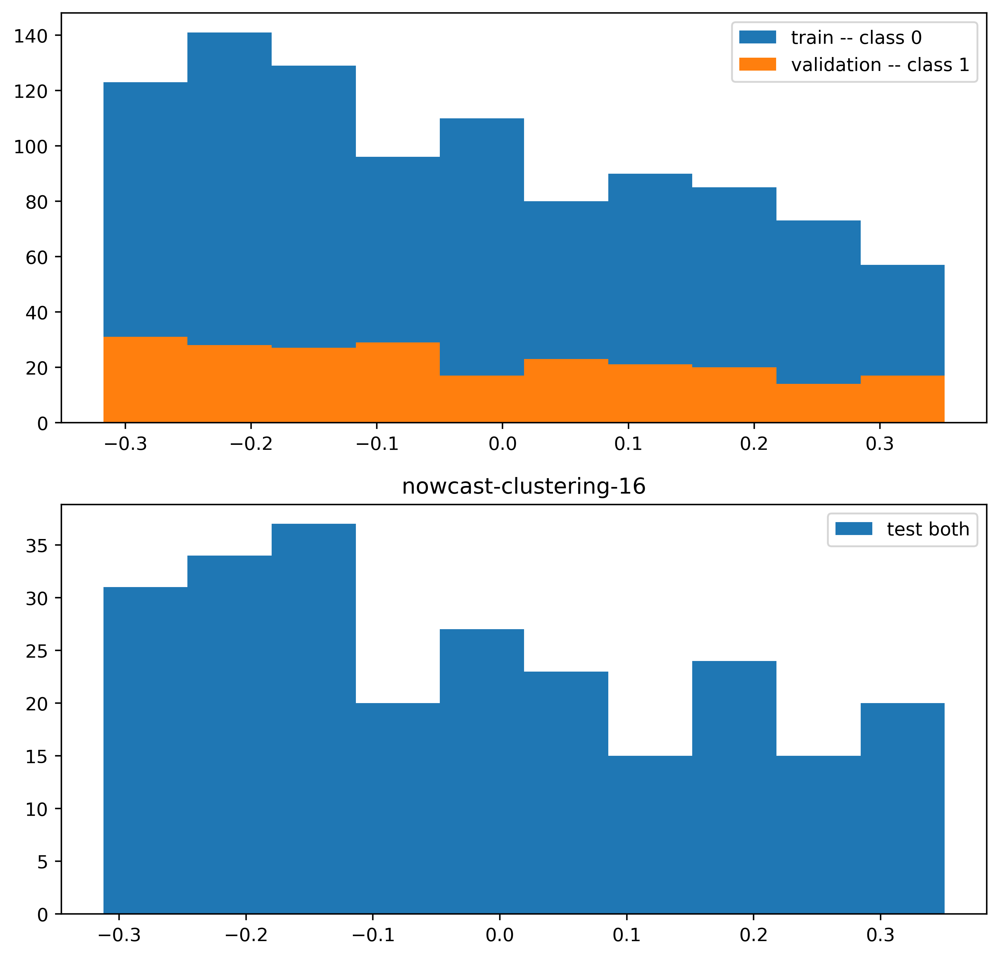

nowcast-clustering-16:  30%|███       | 9002/30000 [21:33<2:01:32,  2.88it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  30%|███       | 9102/30000 [21:47<49:18,  7.06it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  31%|███       | 9202/30000 [22:01<51:51,  6.68it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  31%|███       | 9302/30000 [22:15<49:29,  6.97it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  31%|███▏      | 9402/30000 [22:30<48:47,  7.03it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  32%|███▏      | 9502/30000 [22:44<48:32,  7.04it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  32%|███▏      | 9602/30000 [22:58<48:26,  7.02it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  32%|███▏      | 9702/30000 [23:13<48:18,  7.00it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  33%|███▎      | 9802/30000 [23:27<47:41,  7.06it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  33%|███▎      | 9902/30000 [23:41<47:41,  7.02it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  33%|███▎      | 10000/30000 [23:55<47:27,  7.02it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


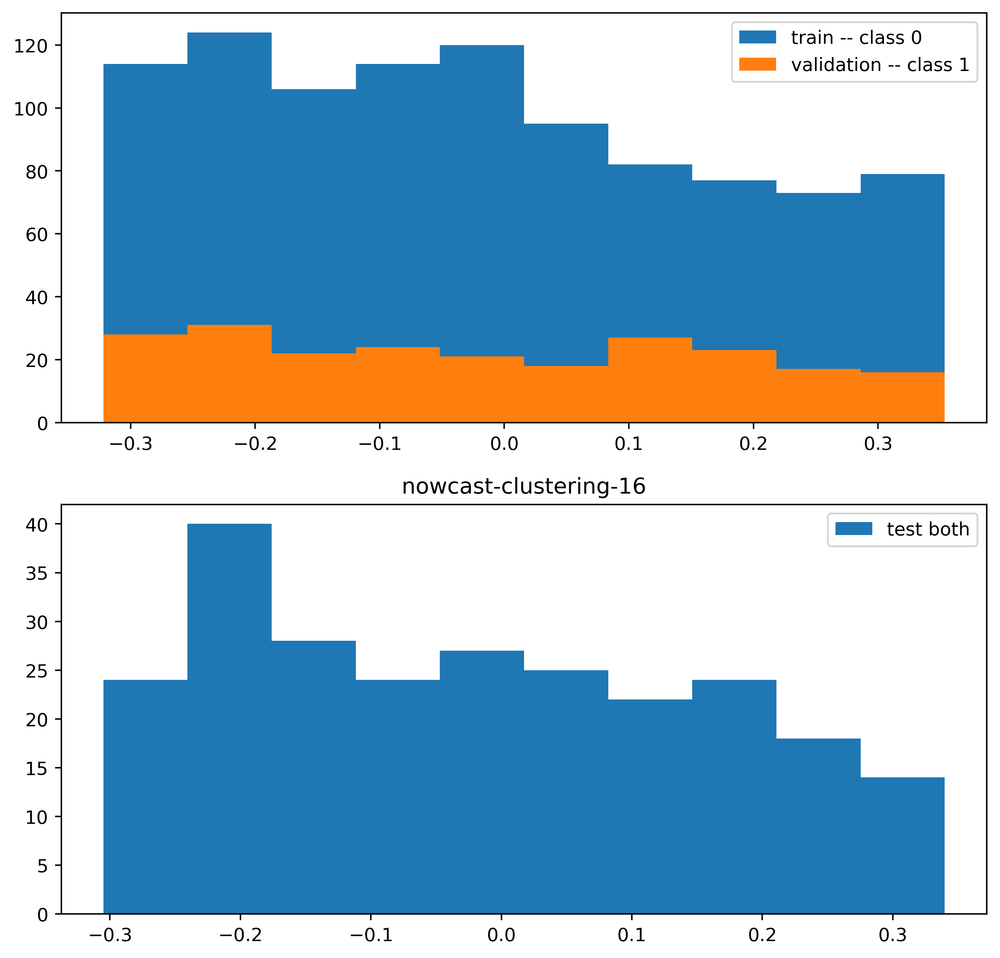

nowcast-clustering-16:  33%|███▎      | 10002/30000 [23:56<1:56:23,  2.86it/s, train_loss=-1.85, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  34%|███▎      | 10102/30000 [24:11<47:16,  7.01it/s, train_loss=-1.69, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  34%|███▍      | 10202/30000 [24:25<47:01,  7.02it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  34%|███▍      | 10302/30000 [24:39<46:55,  7.00it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  35%|███▍      | 10402/30000 [24:54<46:51,  6.97it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  35%|███▌      | 10502/30000 [25:08<46:19,  7.01it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  35%|███▌      | 10602/30000 [25:22<46:01,  7.02it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  36%|███▌      | 10702/30000 [25:37<46:01,  6.99it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  36%|███▌      | 10802/30000 [25:51<45:40,  7.00it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  36%|███▋      | 10902/30000 [26:05<45:36,  6.98it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  37%|███▋      | 11000/30000 [26:19<45:15,  7.00it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


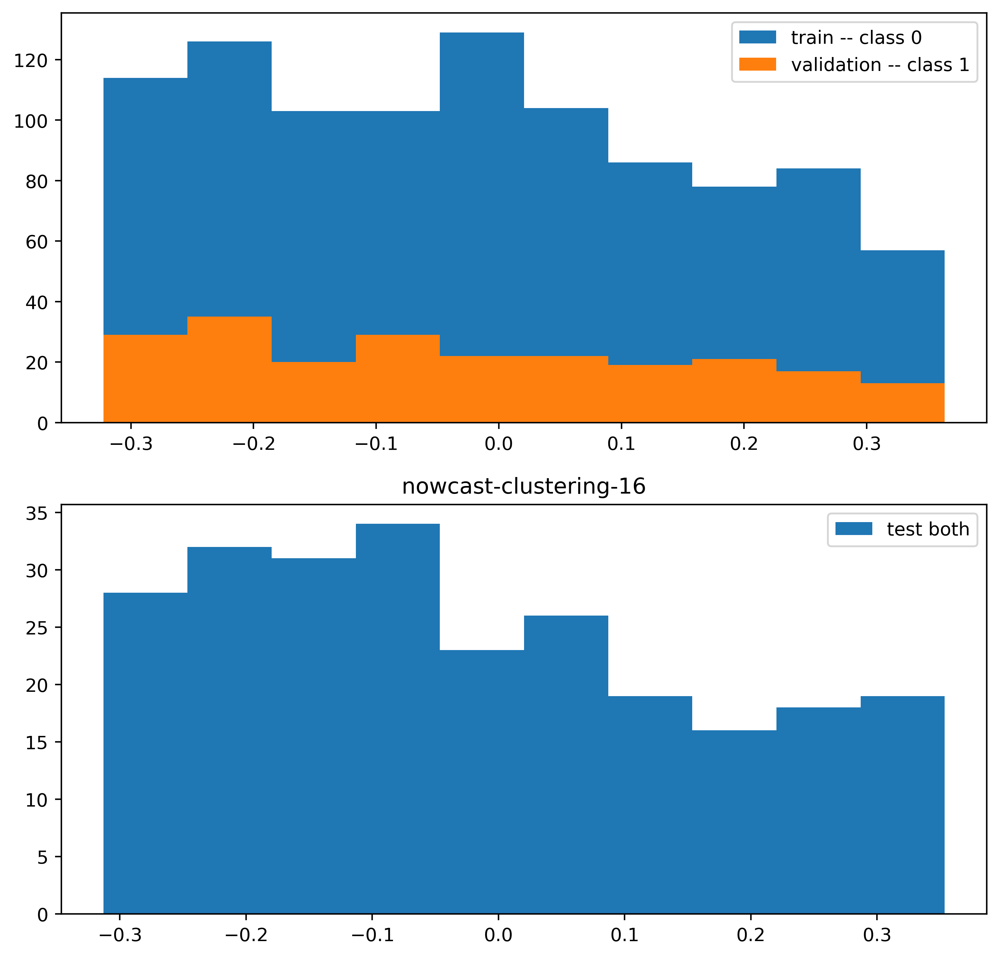

nowcast-clustering-16:  37%|███▋      | 11002/30000 [26:21<1:49:54,  2.88it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  37%|███▋      | 11102/30000 [26:35<45:12,  6.97it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  37%|███▋      | 11202/30000 [26:49<44:41,  7.01it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  38%|███▊      | 11302/30000 [27:04<44:33,  6.99it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  38%|███▊      | 11402/30000 [27:18<44:17,  7.00it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  38%|███▊      | 11502/30000 [27:32<43:59,  7.01it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  39%|███▊      | 11602/30000 [27:47<43:39,  7.02it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  39%|███▉      | 11702/30000 [28:01<43:33,  7.00it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  39%|███▉      | 11802/30000 [28:15<43:26,  6.98it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  40%|███▉      | 11902/30000 [28:30<43:24,  6.95it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  40%|████      | 12000/30000 [28:44<42:50,  7.00it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


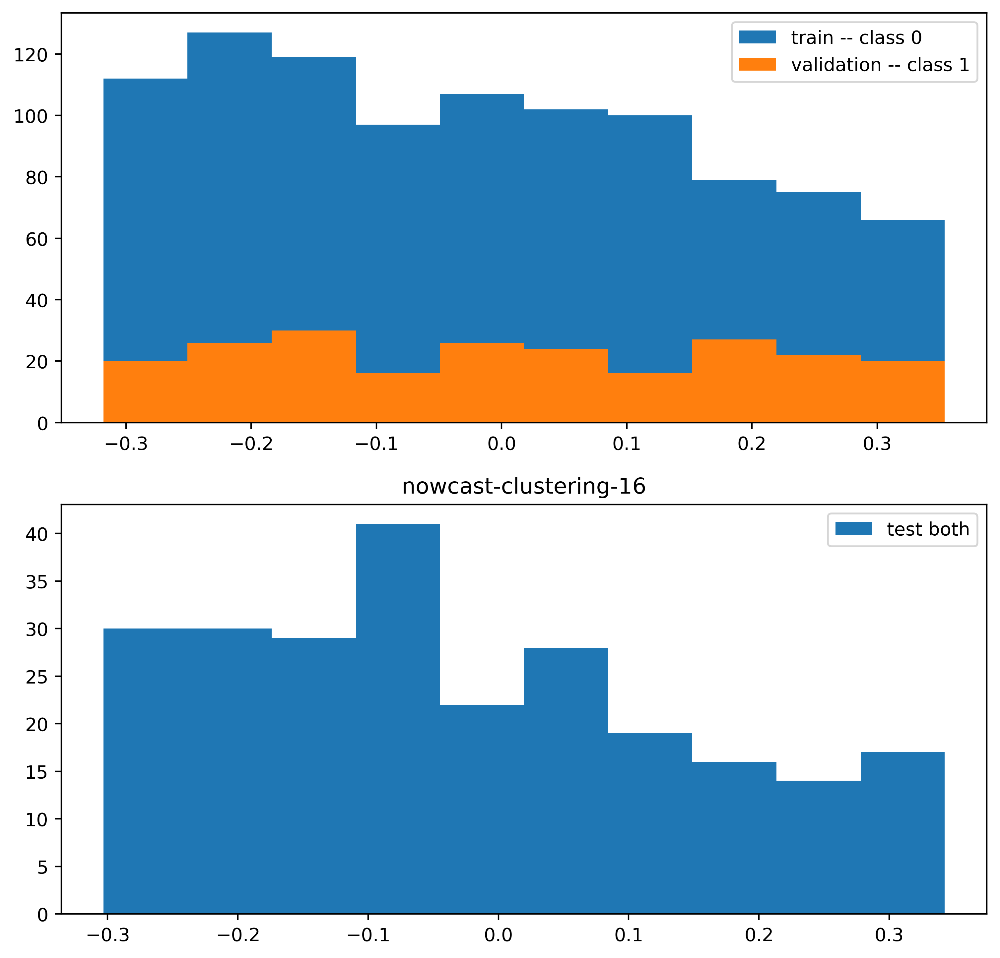

nowcast-clustering-16:  40%|████      | 12002/30000 [28:45<1:43:57,  2.89it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  40%|████      | 12102/30000 [28:59<42:32,  7.01it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  41%|████      | 12202/30000 [29:14<42:06,  7.04it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  41%|████      | 12302/30000 [29:28<42:14,  6.98it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  41%|████▏     | 12402/30000 [29:42<41:40,  7.04it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  42%|████▏     | 12502/30000 [29:57<41:32,  7.02it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  42%|████▏     | 12602/30000 [30:11<41:15,  7.03it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  42%|████▏     | 12702/30000 [30:25<40:54,  7.05it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  43%|████▎     | 12802/30000 [30:40<41:03,  6.98it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  43%|████▎     | 12902/30000 [30:54<40:25,  7.05it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  43%|████▎     | 13000/30000 [31:08<40:16,  7.04it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


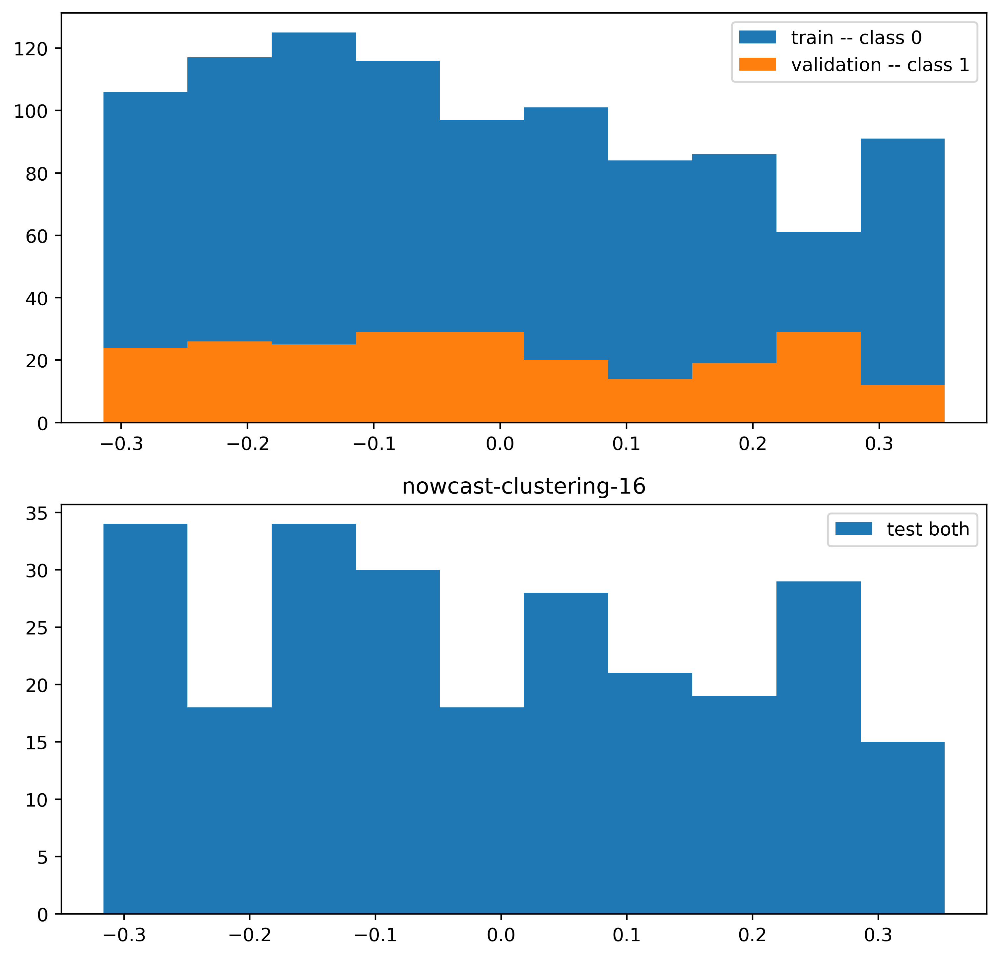

nowcast-clustering-16:  43%|████▎     | 13002/30000 [31:09<1:37:42,  2.90it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  44%|████▎     | 13102/30000 [31:23<40:28,  6.96it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  44%|████▍     | 13202/30000 [31:38<40:08,  6.97it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  44%|████▍     | 13302/30000 [31:52<39:47,  6.99it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  45%|████▍     | 13402/30000 [32:07<39:38,  6.98it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  45%|████▌     | 13502/30000 [32:21<39:22,  6.98it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  45%|████▌     | 13602/30000 [32:35<39:08,  6.98it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  46%|████▌     | 13702/30000 [32:50<38:41,  7.02it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  46%|████▌     | 13802/30000 [33:04<38:54,  6.94it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  46%|████▋     | 13902/30000 [33:18<38:42,  6.93it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  47%|████▋     | 14000/30000 [33:33<38:11,  6.98it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


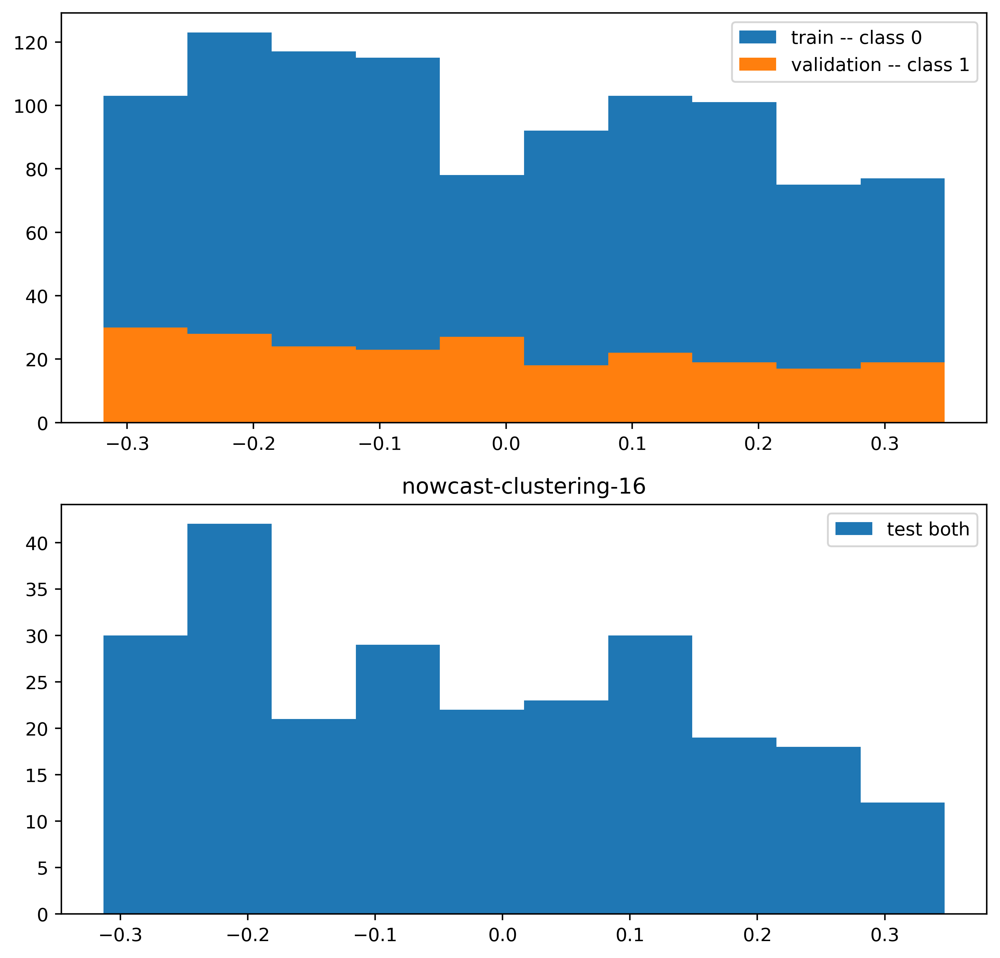

nowcast-clustering-16:  47%|████▋     | 14002/30000 [33:34<1:33:25,  2.85it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  47%|████▋     | 14102/30000 [33:48<37:50,  7.00it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]   

New Model Temperature: 0.001


nowcast-clustering-16:  47%|████▋     | 14202/30000 [34:02<37:43,  6.98it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  48%|████▊     | 14302/30000 [34:17<37:18,  7.01it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  48%|████▊     | 14402/30000 [34:31<37:18,  6.97it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  48%|████▊     | 14502/30000 [34:45<36:51,  7.01it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  49%|████▊     | 14602/30000 [35:00<36:43,  6.99it/s, train_loss=-1.86, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  49%|████▉     | 14702/30000 [35:14<36:28,  6.99it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  49%|████▉     | 14802/30000 [35:29<36:14,  6.99it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  50%|████▉     | 14902/30000 [35:43<35:54,  7.01it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  50%|█████     | 15000/30000 [35:57<35:56,  6.96it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


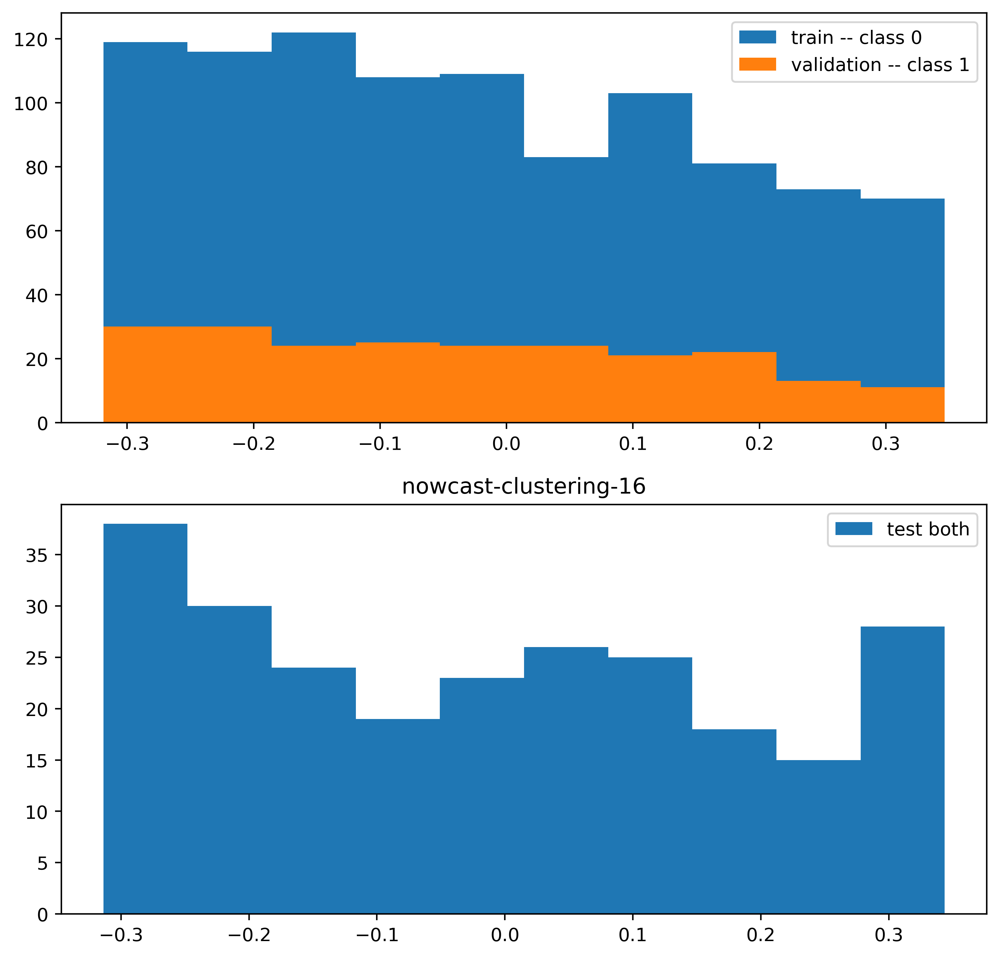

nowcast-clustering-16:  50%|█████     | 15002/30000 [35:58<1:26:48,  2.88it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  50%|█████     | 15102/30000 [36:13<35:35,  6.98it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  51%|█████     | 15202/30000 [36:27<35:06,  7.03it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  51%|█████     | 15302/30000 [36:41<34:57,  7.01it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  51%|█████▏    | 15402/30000 [36:55<34:33,  7.04it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  52%|█████▏    | 15502/30000 [37:10<34:21,  7.03it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  52%|█████▏    | 15602/30000 [37:24<34:08,  7.03it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  52%|█████▏    | 15702/30000 [37:38<33:47,  7.05it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  53%|█████▎    | 15802/30000 [37:53<33:59,  6.96it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  53%|█████▎    | 15902/30000 [38:07<33:23,  7.04it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  53%|█████▎    | 16000/30000 [38:21<33:17,  7.01it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


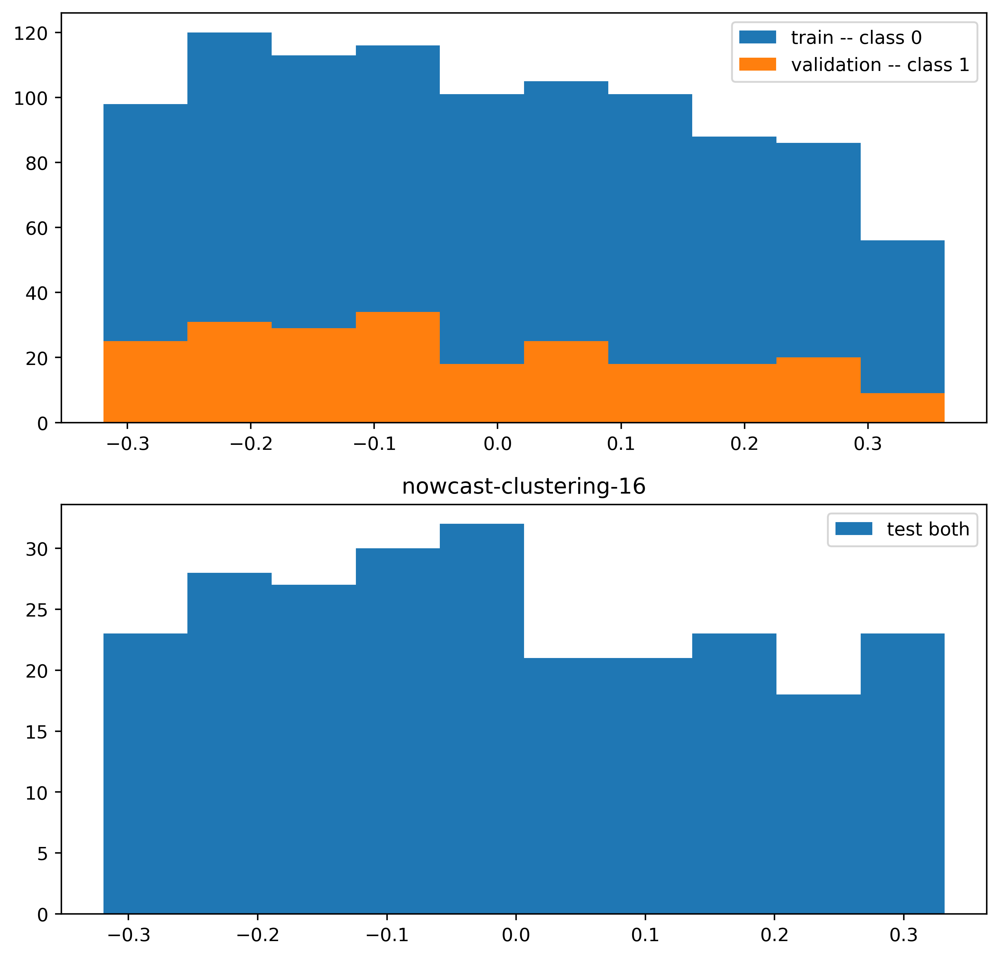

nowcast-clustering-16:  53%|█████▎    | 16002/30000 [38:22<1:21:11,  2.87it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  54%|█████▎    | 16102/30000 [38:36<32:42,  7.08it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  54%|█████▍    | 16202/30000 [38:51<32:32,  7.07it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  54%|█████▍    | 16302/30000 [39:05<32:23,  7.05it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  55%|█████▍    | 16402/30000 [39:19<32:10,  7.05it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  55%|█████▌    | 16502/30000 [39:34<31:53,  7.05it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  55%|█████▌    | 16602/30000 [39:48<31:31,  7.08it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  56%|█████▌    | 16702/30000 [40:02<31:32,  7.03it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  56%|█████▌    | 16802/30000 [40:16<31:22,  7.01it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  56%|█████▋    | 16902/30000 [40:31<31:24,  6.95it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  57%|█████▋    | 17000/30000 [40:45<30:46,  7.04it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


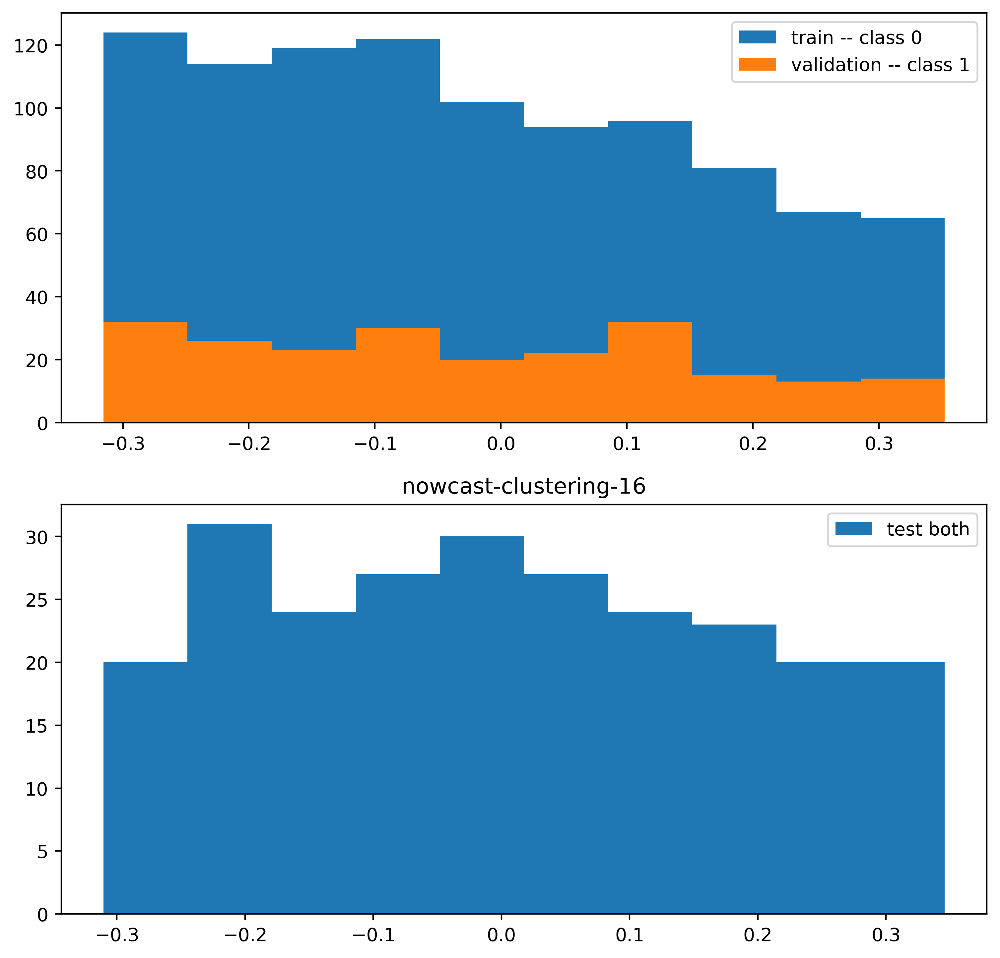

nowcast-clustering-16:  57%|█████▋    | 17002/30000 [40:46<1:15:21,  2.87it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  57%|█████▋    | 17102/30000 [41:00<30:19,  7.09it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  57%|█████▋    | 17202/30000 [41:14<30:07,  7.08it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  58%|█████▊    | 17302/30000 [41:28<30:03,  7.04it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  58%|█████▊    | 17402/30000 [41:43<29:43,  7.06it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  58%|█████▊    | 17502/30000 [41:57<29:27,  7.07it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  59%|█████▊    | 17602/30000 [42:11<29:21,  7.04it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  59%|█████▉    | 17702/30000 [42:25<29:11,  7.02it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  59%|█████▉    | 17802/30000 [42:40<28:51,  7.04it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  60%|█████▉    | 17902/30000 [42:54<28:32,  7.06it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  60%|██████    | 18000/30000 [43:08<28:25,  7.03it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


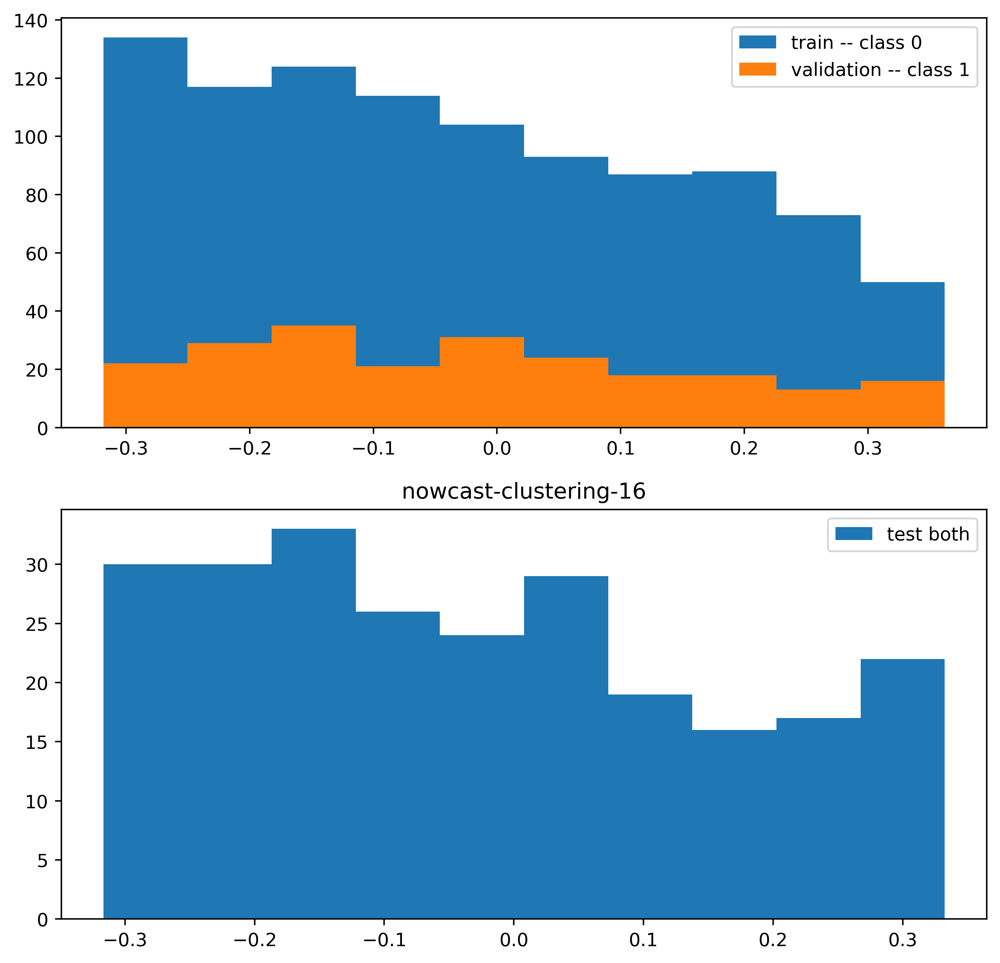

nowcast-clustering-16:  60%|██████    | 18002/30000 [43:09<1:11:02,  2.81it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  60%|██████    | 18102/30000 [43:23<28:02,  7.07it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]   

New Model Temperature: 0.001


nowcast-clustering-16:  61%|██████    | 18202/30000 [43:37<27:46,  7.08it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  61%|██████    | 18302/30000 [43:52<27:34,  7.07it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  61%|██████▏   | 18402/30000 [44:06<27:23,  7.06it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  62%|██████▏   | 18502/30000 [44:20<27:27,  6.98it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  62%|██████▏   | 18602/30000 [44:35<27:15,  6.97it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  62%|██████▏   | 18702/30000 [44:49<27:03,  6.96it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  63%|██████▎   | 18802/30000 [45:03<26:47,  6.97it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  63%|██████▎   | 18902/30000 [45:18<26:38,  6.94it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  63%|██████▎   | 19000/30000 [45:32<26:20,  6.96it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


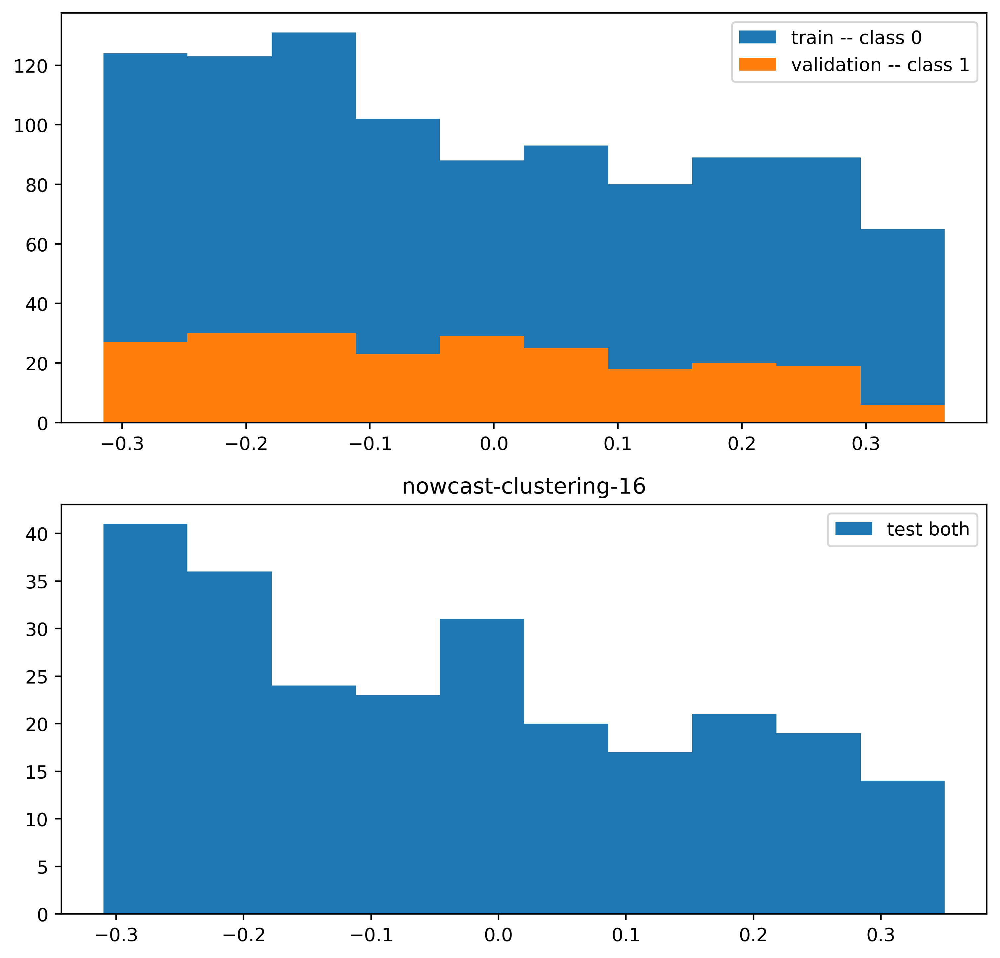

nowcast-clustering-16:  63%|██████▎   | 19002/30000 [45:33<1:03:24,  2.89it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  64%|██████▎   | 19102/30000 [45:47<25:58,  6.99it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


nowcast-clustering-16:  64%|██████▍   | 19202/30000 [46:02<25:46,  6.98it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  64%|██████▍   | 19302/30000 [46:16<25:51,  6.89it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  65%|██████▍   | 19402/30000 [46:31<25:27,  6.94it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  65%|██████▌   | 19502/30000 [46:45<25:04,  6.98it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  65%|██████▌   | 19602/30000 [46:59<24:51,  6.97it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  66%|██████▌   | 19702/30000 [47:14<24:35,  6.98it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  66%|██████▌   | 19802/30000 [47:28<24:20,  6.98it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  66%|██████▋   | 19902/30000 [47:43<24:06,  6.98it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  67%|██████▋   | 20000/30000 [47:57<23:53,  6.98it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


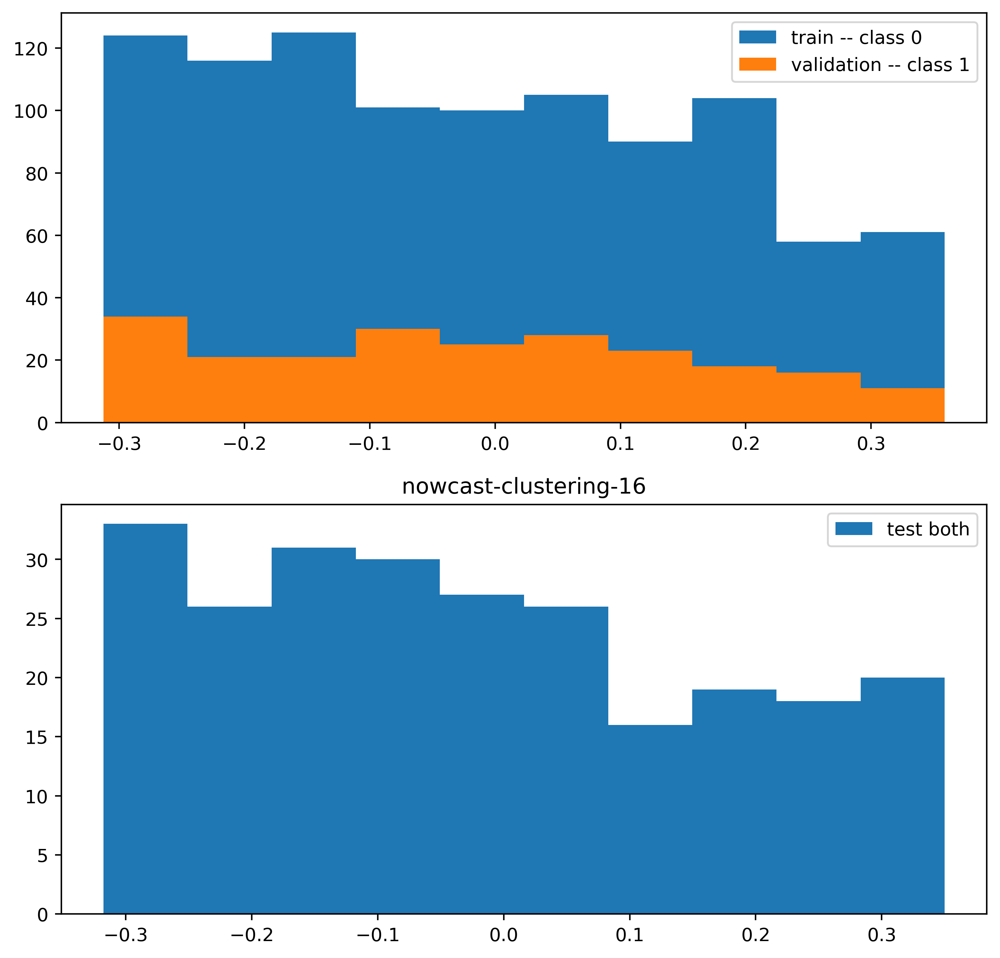

nowcast-clustering-16:  67%|██████▋   | 20002/30000 [47:58<57:56,  2.88it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  67%|██████▋   | 20102/30000 [48:12<23:45,  6.94it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  67%|██████▋   | 20202/30000 [48:27<23:26,  6.96it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  68%|██████▊   | 20302/30000 [48:41<23:06,  6.99it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  68%|██████▊   | 20402/30000 [48:55<22:51,  7.00it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  68%|██████▊   | 20502/30000 [49:10<22:40,  6.98it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  69%|██████▊   | 20602/30000 [49:24<22:20,  7.01it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  69%|██████▉   | 20702/30000 [49:38<22:00,  7.04it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  69%|██████▉   | 20802/30000 [49:53<21:59,  6.97it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  70%|██████▉   | 20902/30000 [50:07<21:44,  6.97it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  70%|███████   | 21000/30000 [50:21<21:23,  7.01it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


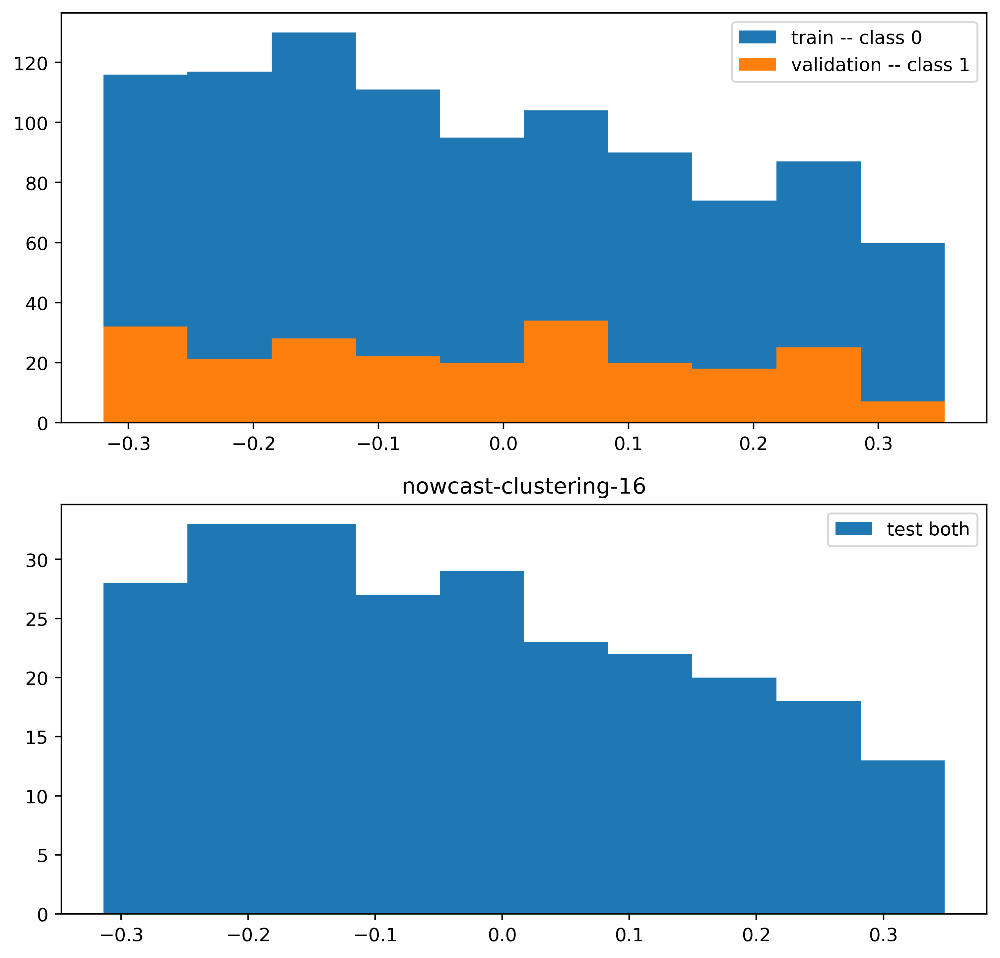

nowcast-clustering-16:  70%|███████   | 21002/30000 [50:22<52:17,  2.87it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  70%|███████   | 21102/30000 [50:37<20:57,  7.08it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  71%|███████   | 21202/30000 [50:51<20:47,  7.05it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  71%|███████   | 21302/30000 [51:05<20:41,  7.01it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  71%|███████▏  | 21402/30000 [51:20<20:23,  7.03it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  72%|███████▏  | 21502/30000 [51:34<20:14,  7.00it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  72%|███████▏  | 21602/30000 [51:48<20:06,  6.96it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  72%|███████▏  | 21702/30000 [52:02<19:35,  7.06it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  73%|███████▎  | 21802/30000 [52:17<19:22,  7.05it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  73%|███████▎  | 21902/30000 [52:31<19:01,  7.09it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  73%|███████▎  | 22000/30000 [52:45<18:48,  7.09it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


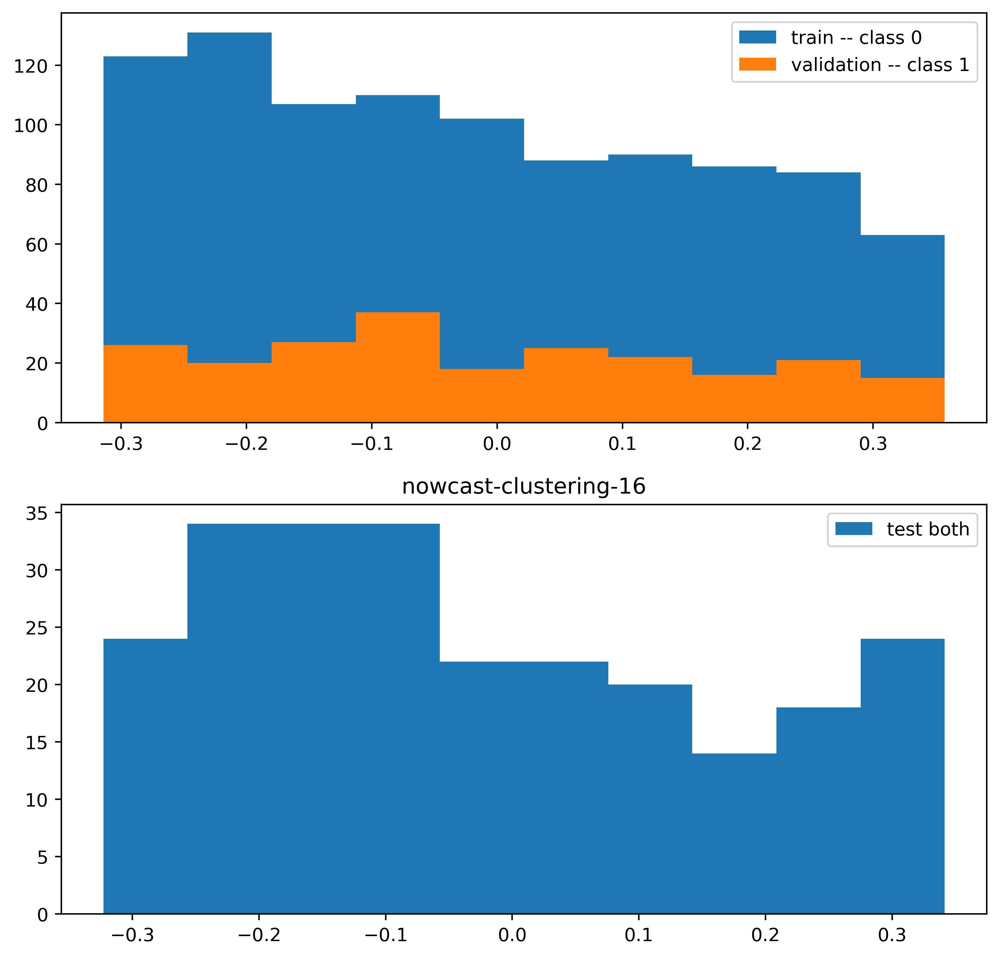

nowcast-clustering-16:  73%|███████▎  | 22002/30000 [52:46<46:15,  2.88it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  74%|███████▎  | 22102/30000 [53:00<18:48,  7.00it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  74%|███████▍  | 22202/30000 [53:15<18:31,  7.02it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  74%|███████▍  | 22302/30000 [53:29<18:17,  7.02it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  75%|███████▍  | 22402/30000 [53:44<18:07,  6.99it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  75%|███████▌  | 22502/30000 [53:58<17:51,  7.00it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  75%|███████▌  | 22602/30000 [54:12<17:33,  7.02it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  76%|███████▌  | 22702/30000 [54:26<17:17,  7.03it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  76%|███████▌  | 22802/30000 [54:41<17:05,  7.02it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  76%|███████▋  | 22902/30000 [54:55<16:58,  6.97it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  77%|███████▋  | 23000/30000 [55:09<16:37,  7.02it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


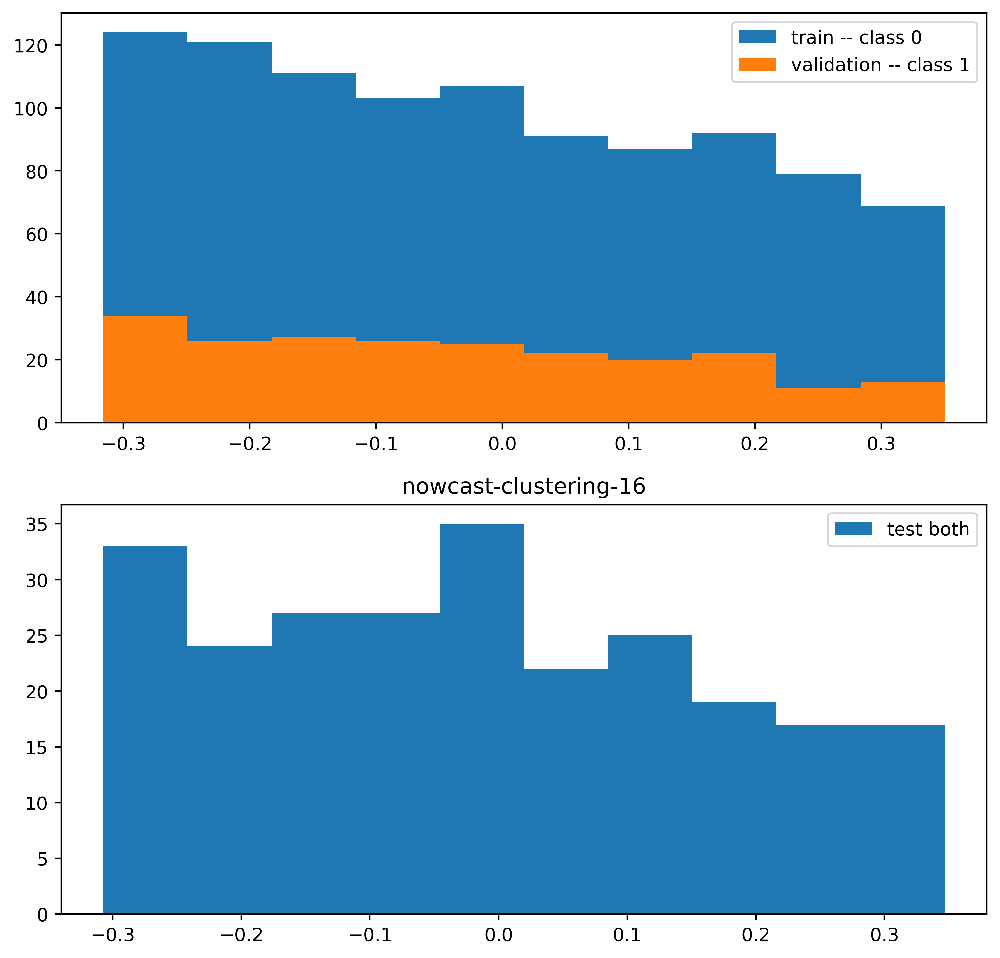

nowcast-clustering-16:  77%|███████▋  | 23002/30000 [55:10<40:13,  2.90it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  77%|███████▋  | 23102/30000 [55:25<16:17,  7.06it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  77%|███████▋  | 23202/30000 [55:39<16:07,  7.02it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  78%|███████▊  | 23302/30000 [55:53<15:52,  7.03it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  78%|███████▊  | 23402/30000 [56:07<15:36,  7.04it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  78%|███████▊  | 23502/30000 [56:22<15:26,  7.01it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  79%|███████▊  | 23602/30000 [56:36<15:11,  7.02it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  79%|███████▉  | 23702/30000 [56:50<14:53,  7.05it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  79%|███████▉  | 23802/30000 [57:04<14:38,  7.05it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  80%|███████▉  | 23902/30000 [57:19<14:28,  7.02it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  80%|████████  | 24000/30000 [57:33<14:11,  7.05it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


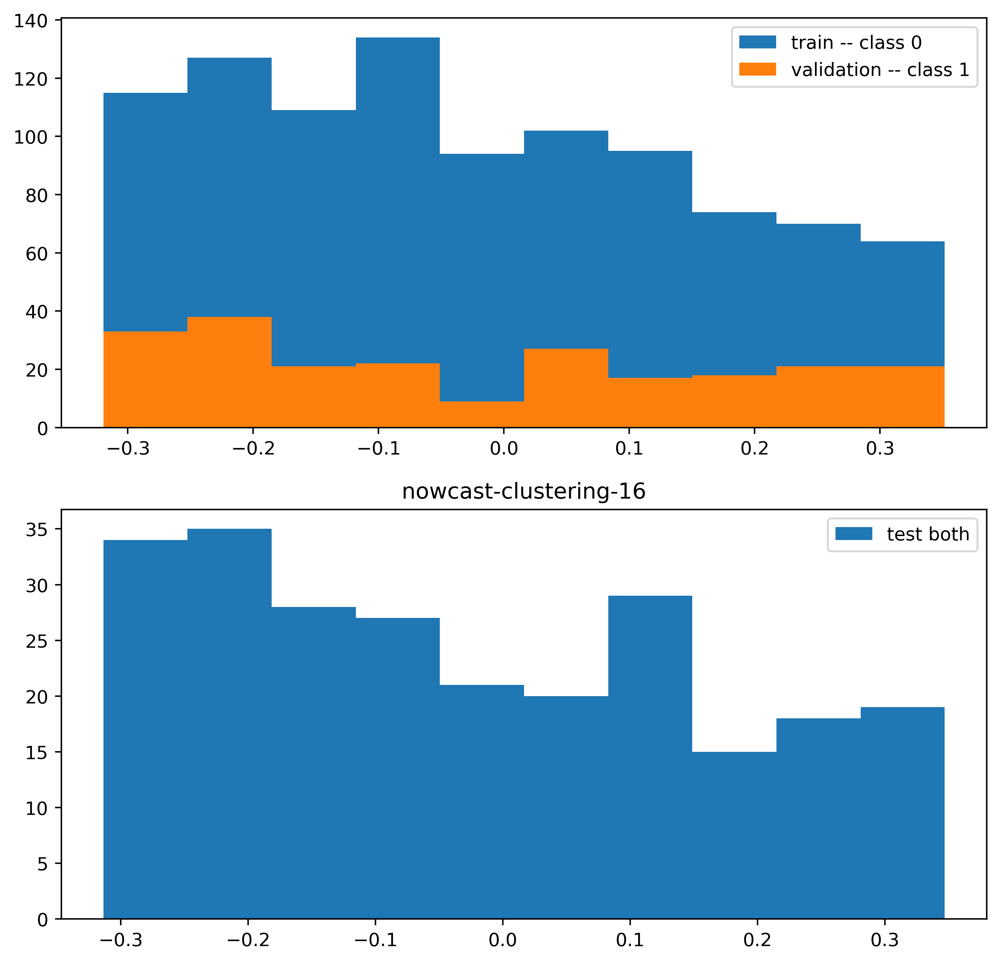

nowcast-clustering-16:  80%|████████  | 24002/30000 [57:34<34:56,  2.86it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  80%|████████  | 24102/30000 [57:48<13:52,  7.09it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  81%|████████  | 24202/30000 [58:02<13:31,  7.14it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  81%|████████  | 24302/30000 [58:16<13:22,  7.10it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  81%|████████▏ | 24402/30000 [58:30<13:07,  7.11it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  82%|████████▏ | 24502/30000 [58:45<12:52,  7.11it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  82%|████████▏ | 24602/30000 [58:59<12:38,  7.11it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  82%|████████▏ | 24702/30000 [59:13<12:26,  7.09it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  83%|████████▎ | 24802/30000 [59:27<12:10,  7.11it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  83%|████████▎ | 24902/30000 [59:41<11:57,  7.10it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  83%|████████▎ | 25000/30000 [59:55<11:44,  7.10it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


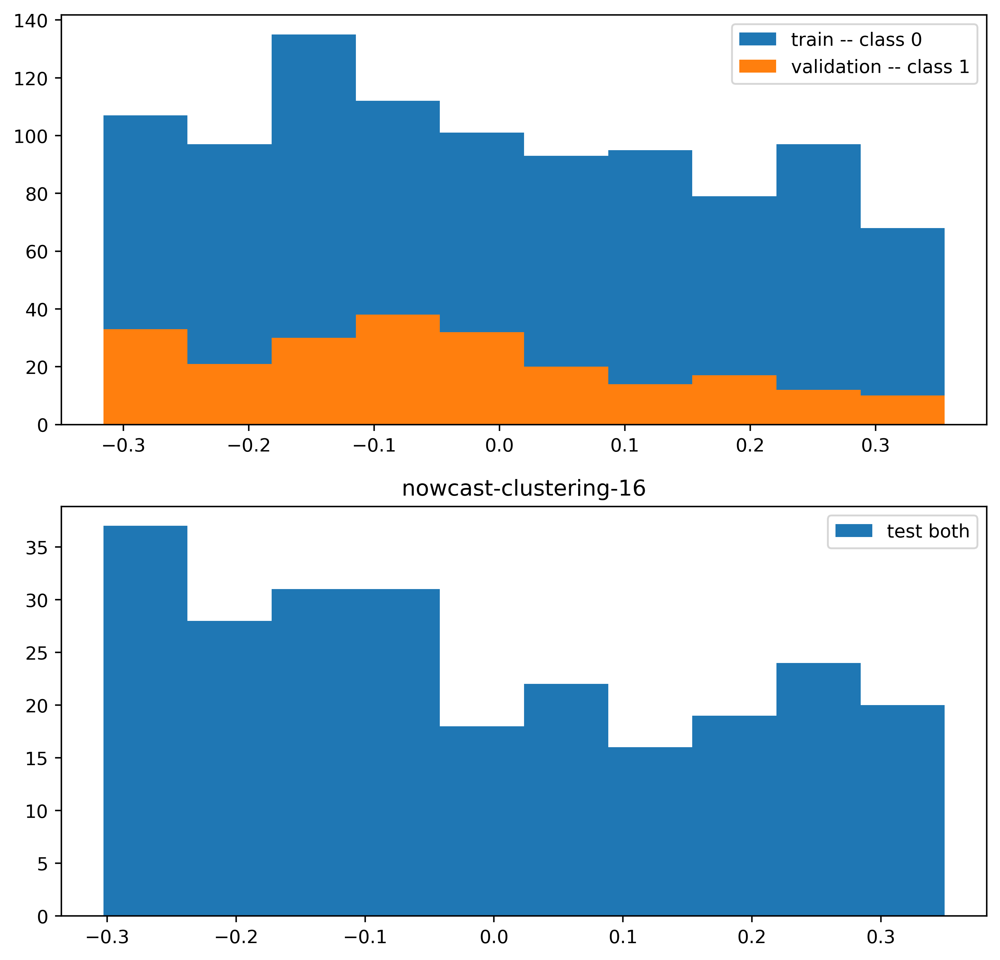

nowcast-clustering-16:  83%|████████▎ | 25002/30000 [59:56<29:26,  2.83it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  84%|████████▎ | 25102/30000 [1:00:10<11:32,  7.08it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  84%|████████▍ | 25202/30000 [1:00:24<11:15,  7.10it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  84%|████████▍ | 25302/30000 [1:00:39<11:02,  7.10it/s, train_loss=-1.85, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  85%|████████▍ | 25402/30000 [1:00:53<10:52,  7.05it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  85%|████████▌ | 25502/30000 [1:01:07<10:36,  7.07it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  85%|████████▌ | 25602/30000 [1:01:21<10:22,  7.07it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  86%|████████▌ | 25702/30000 [1:01:36<10:08,  7.07it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  86%|████████▌ | 25802/30000 [1:01:50<09:56,  7.04it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  86%|████████▋ | 25902/30000 [1:02:04<09:38,  7.09it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  87%|████████▋ | 26000/30000 [1:02:18<09:25,  7.07it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


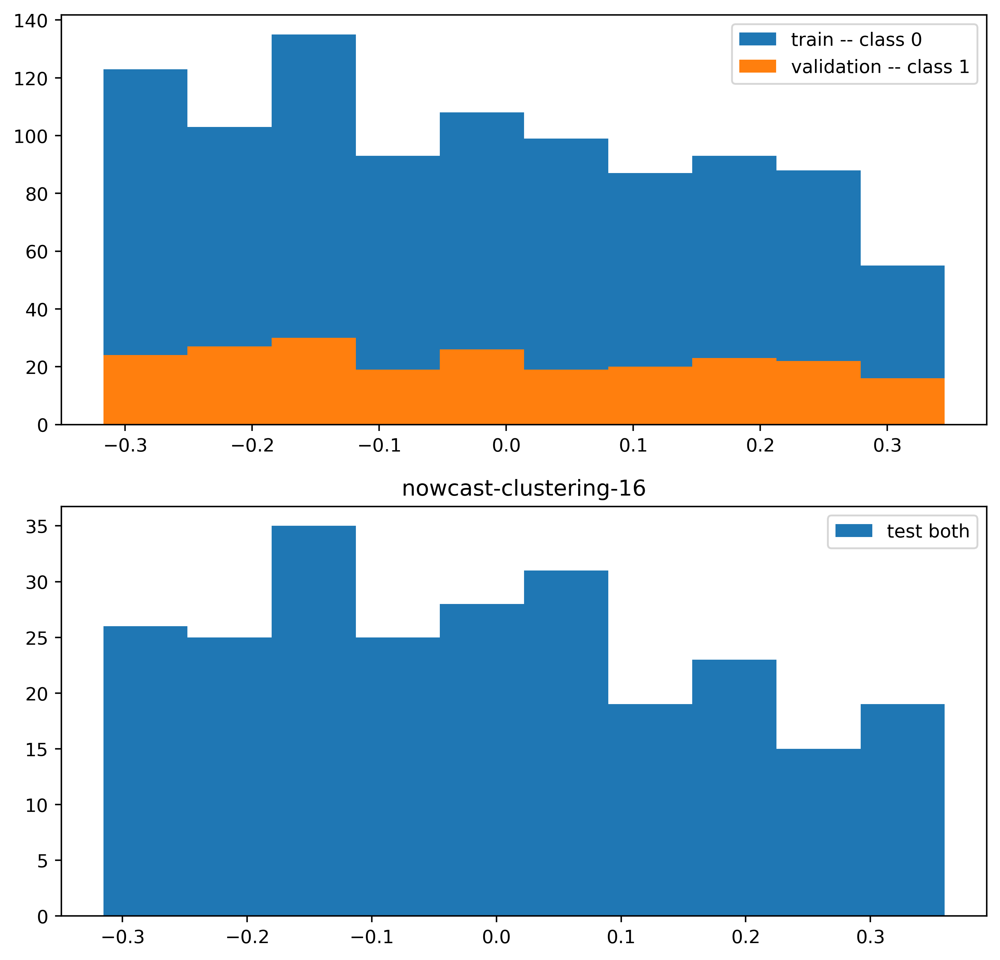

nowcast-clustering-16:  87%|████████▋ | 26002/30000 [1:02:19<23:10,  2.88it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  87%|████████▋ | 26102/30000 [1:02:33<09:09,  7.10it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  87%|████████▋ | 26202/30000 [1:02:47<08:52,  7.13it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  88%|████████▊ | 26302/30000 [1:03:02<08:38,  7.13it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  88%|████████▊ | 26402/30000 [1:03:16<08:24,  7.13it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  88%|████████▊ | 26502/30000 [1:03:30<08:11,  7.12it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  89%|████████▊ | 26602/30000 [1:03:44<07:58,  7.11it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  89%|████████▉ | 26702/30000 [1:03:58<07:42,  7.13it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  89%|████████▉ | 26802/30000 [1:04:12<07:30,  7.10it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  90%|████████▉ | 26902/30000 [1:04:26<07:17,  7.09it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  90%|█████████ | 27000/30000 [1:04:40<07:01,  7.11it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


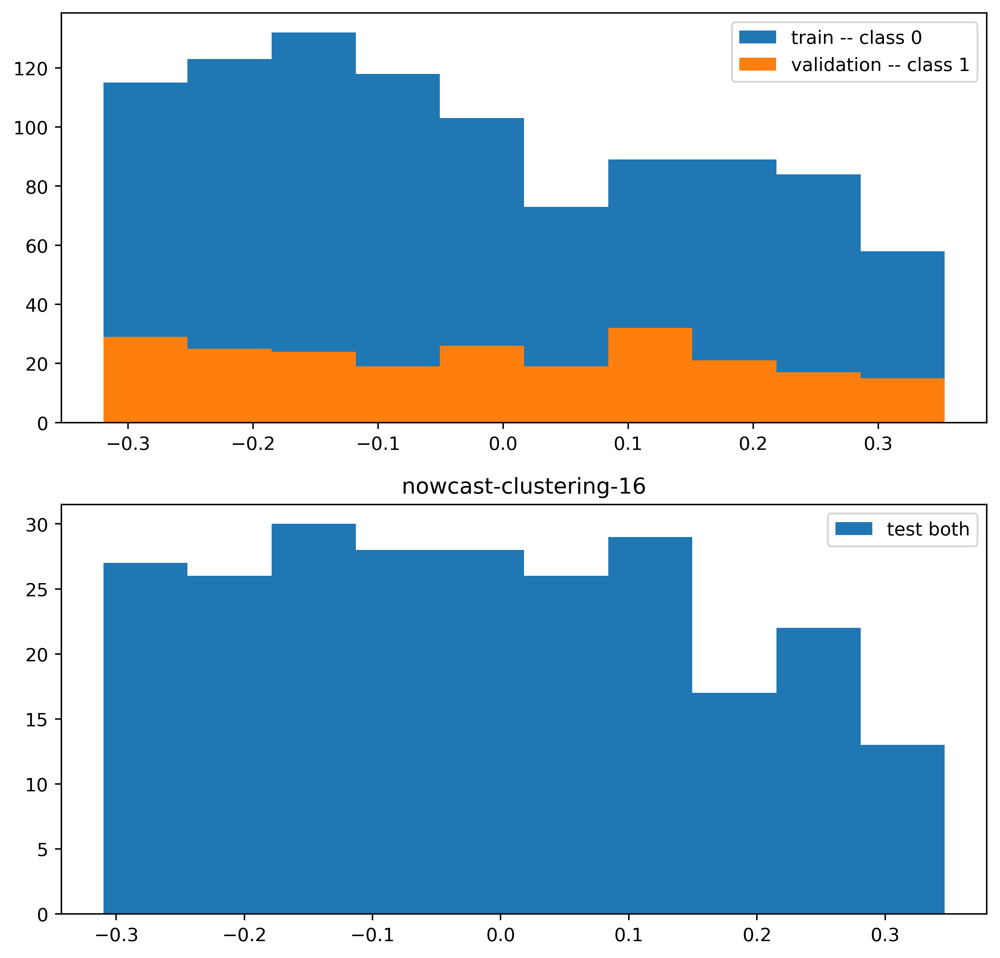

nowcast-clustering-16:  90%|█████████ | 27002/30000 [1:04:41<17:20,  2.88it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  90%|█████████ | 27102/30000 [1:04:56<06:50,  7.06it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  91%|█████████ | 27202/30000 [1:05:10<06:35,  7.07it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  91%|█████████ | 27302/30000 [1:05:24<06:20,  7.09it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  91%|█████████▏| 27402/30000 [1:05:38<06:08,  7.04it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  92%|█████████▏| 27502/30000 [1:05:52<05:54,  7.05it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  92%|█████████▏| 27602/30000 [1:06:07<05:39,  7.07it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  92%|█████████▏| 27702/30000 [1:06:21<05:25,  7.06it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  93%|█████████▎| 27802/30000 [1:06:35<05:11,  7.06it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  93%|█████████▎| 27902/30000 [1:06:49<04:55,  7.09it/s, train_loss=-1.85, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  93%|█████████▎| 28000/30000 [1:07:03<04:44,  7.03it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


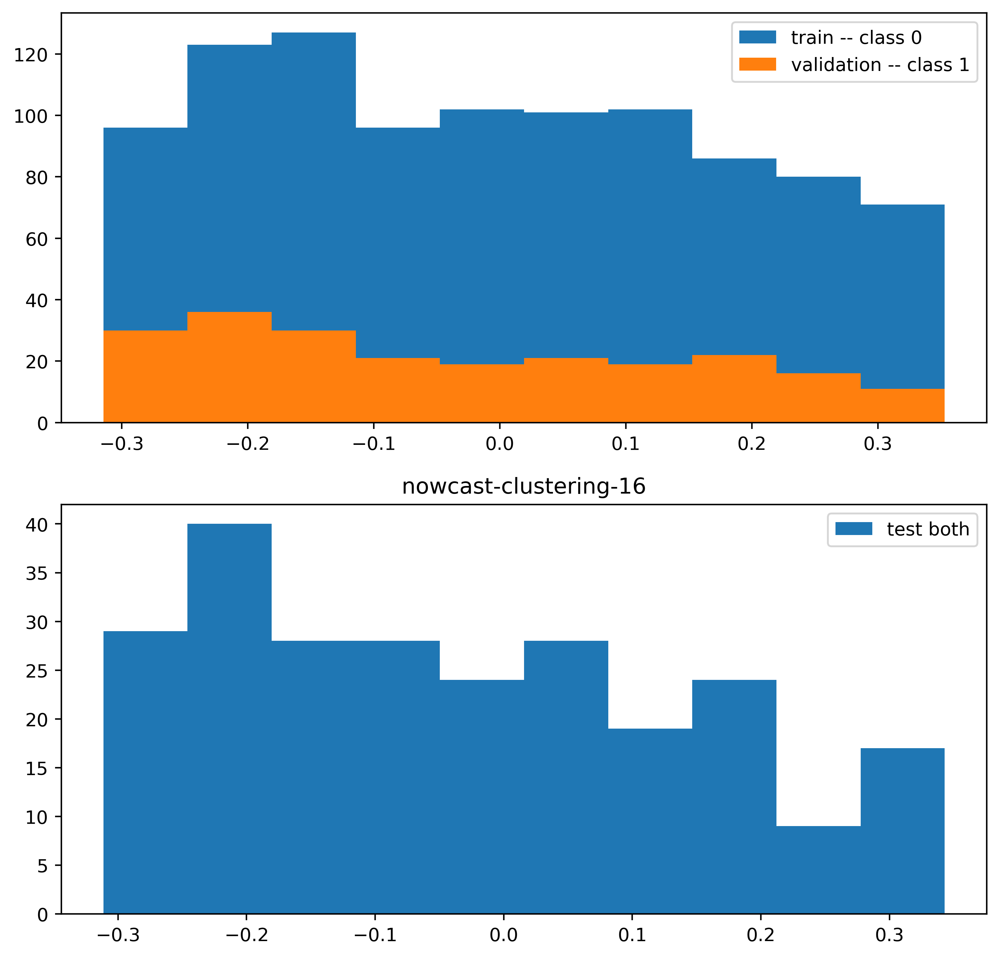

nowcast-clustering-16:  93%|█████████▎| 28002/30000 [1:07:05<11:52,  2.80it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  94%|█████████▎| 28102/30000 [1:07:19<04:30,  7.03it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  94%|█████████▍| 28202/30000 [1:07:34<04:17,  6.98it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  94%|█████████▍| 28302/30000 [1:07:48<04:00,  7.07it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  95%|█████████▍| 28402/30000 [1:08:02<03:48,  7.01it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  95%|█████████▌| 28502/30000 [1:08:17<03:33,  7.01it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  95%|█████████▌| 28602/30000 [1:08:31<03:19,  7.00it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  96%|█████████▌| 28702/30000 [1:08:45<03:04,  7.05it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  96%|█████████▌| 28802/30000 [1:09:00<02:50,  7.02it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  96%|█████████▋| 28902/30000 [1:09:14<02:36,  7.01it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


nowcast-clustering-16:  97%|█████████▋| 29000/30000 [1:09:28<02:22,  7.04it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


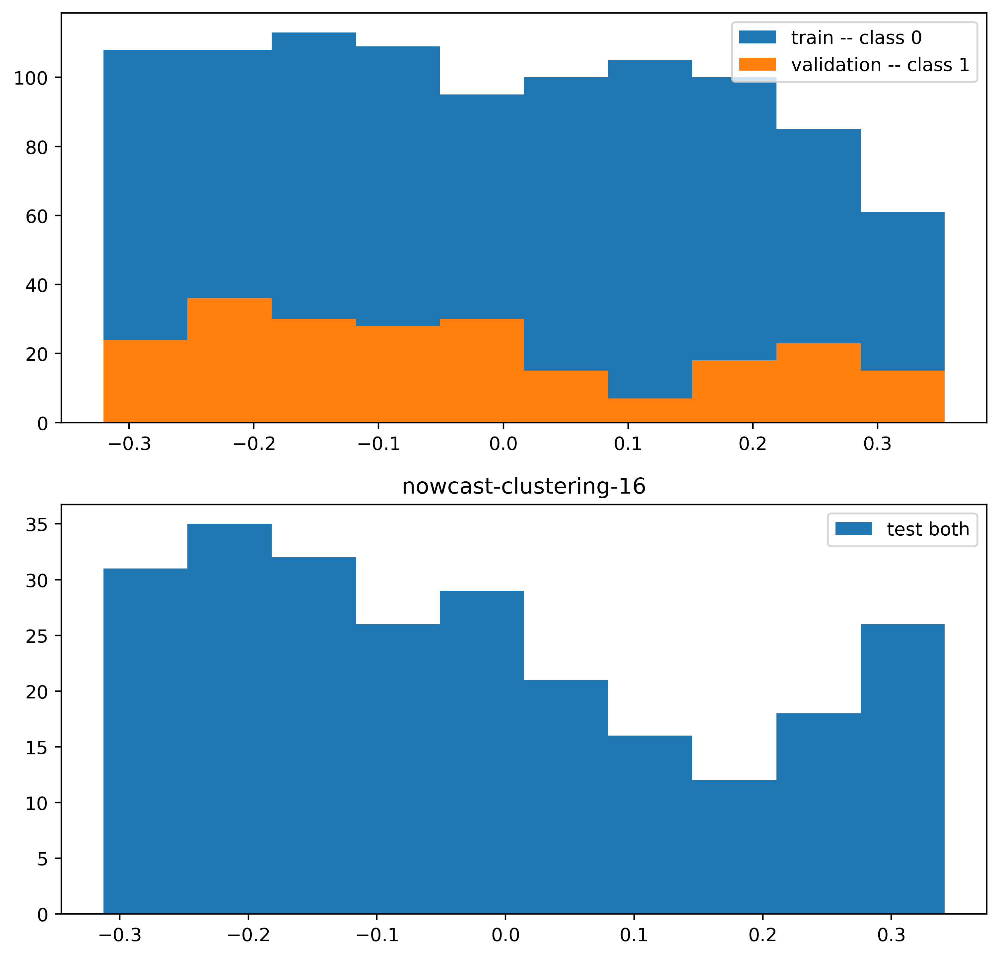

nowcast-clustering-16:  97%|█████████▋| 29002/30000 [1:09:29<05:53,  2.83it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: nowcast-clustering-16 binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



nowcast-clustering-16:  97%|█████████▋| 29102/30000 [1:09:44<02:08,  7.00it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  97%|█████████▋| 29202/30000 [1:09:58<01:53,  7.02it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  98%|█████████▊| 29302/30000 [1:10:12<01:39,  7.02it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  98%|█████████▊| 29402/30000 [1:10:26<01:25,  7.03it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  98%|█████████▊| 29502/30000 [1:10:41<01:11,  6.99it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  99%|█████████▊| 29602/30000 [1:10:55<00:56,  7.04it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  99%|█████████▉| 29702/30000 [1:11:09<00:42,  7.01it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16:  99%|█████████▉| 29802/30000 [1:11:23<00:28,  7.03it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


nowcast-clustering-16: 100%|█████████▉| 29902/30000 [1:11:38<00:13,  7.05it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:   0%|          | 0/30000 [00:00<?, ?it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 1.0
984 984 984
(array([0]), array([984]))


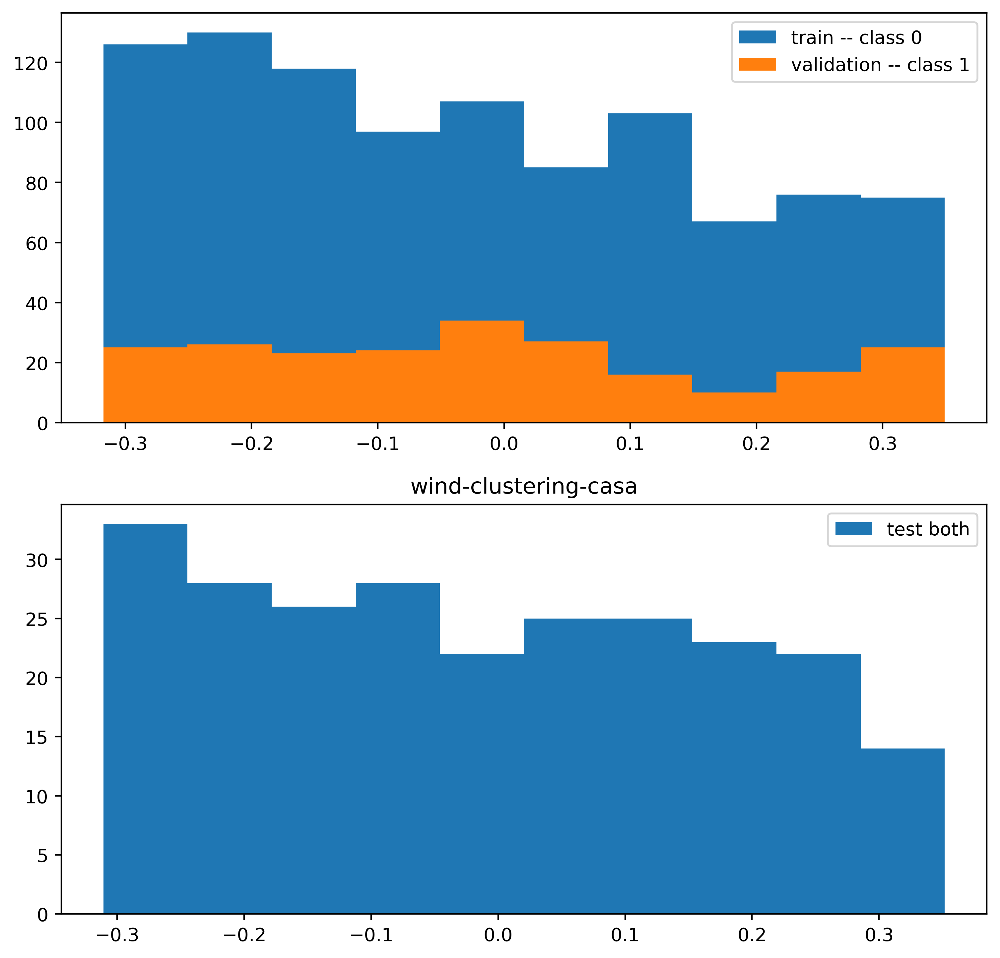

wind-clustering-casa:   0%|          | 2/30000 [00:01<4:49:18,  1.73it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:   0%|          | 102/30000 [00:15<1:08:40,  7.26it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.9801986733067553


wind-clustering-casa:   1%|          | 202/30000 [00:29<1:08:46,  7.22it/s, train_loss=-1.69, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.9417645335842486


wind-clustering-casa:   1%|          | 302/30000 [00:42<1:07:55,  7.29it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.8869204367171575


wind-clustering-casa:   1%|▏         | 402/30000 [00:56<1:08:12,  7.23it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.8187307530779818


wind-clustering-casa:   2%|▏         | 502/30000 [01:10<1:07:46,  7.25it/s, train_loss=-1.85, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.7408182206817178


wind-clustering-casa:   2%|▏         | 602/30000 [01:24<1:07:35,  7.25it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.6570468198150566


wind-clustering-casa:   2%|▏         | 702/30000 [01:38<1:07:22,  7.25it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.5712090638488148


wind-clustering-casa:   3%|▎         | 802/30000 [01:52<1:07:02,  7.26it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.48675225595997157


wind-clustering-casa:   3%|▎         | 902/30000 [02:05<1:06:53,  7.25it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.40656965974059905


wind-clustering-casa:   3%|▎         | 1000/30000 [02:19<1:06:44,  7.24it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.3328710836980795
984 984 984
(array([0]), array([984]))


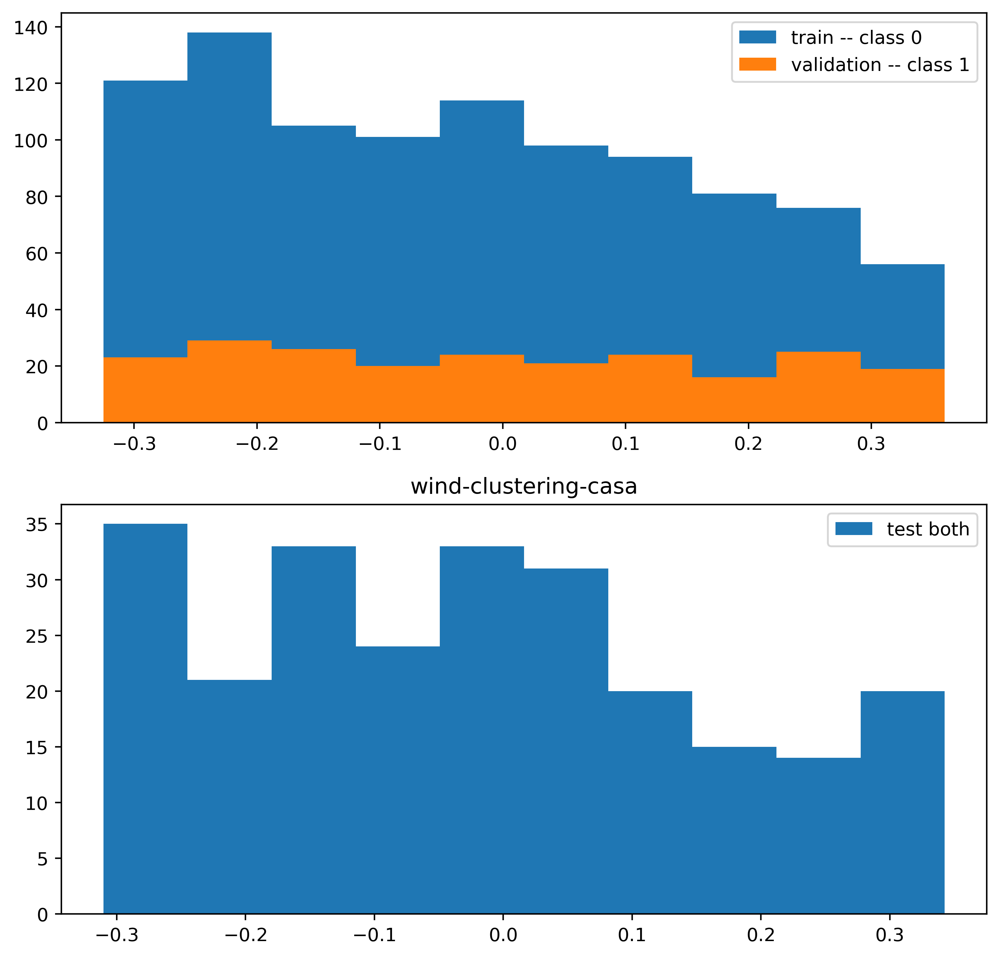

wind-clustering-casa:   3%|▎         | 1002/30000 [02:20<2:47:33,  2.88it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:   4%|▎         | 1102/30000 [02:34<1:06:29,  7.24it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.26713530196585034


wind-clustering-casa:   4%|▍         | 1202/30000 [02:48<1:06:38,  7.20it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.2101360712007647


wind-clustering-casa:   4%|▍         | 1302/30000 [03:02<1:06:20,  7.21it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.16202575093388072


wind-clustering-casa:   5%|▍         | 1402/30000 [03:16<1:05:50,  7.24it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.12245642825298188


wind-clustering-casa:   5%|▌         | 1502/30000 [03:30<1:06:06,  7.18it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.09071795328941248


wind-clustering-casa:   5%|▌         | 1602/30000 [03:44<1:06:45,  7.09it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.06587475442640295


wind-clustering-casa:   6%|▌         | 1702/30000 [03:58<1:07:15,  7.01it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.04688769521998848


wind-clustering-casa:   6%|▌         | 1802/30000 [04:12<1:09:25,  6.77it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.032712434939019805


wind-clustering-casa:   6%|▋         | 1902/30000 [04:26<1:05:30,  7.15it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.022370771856165587


wind-clustering-casa:   7%|▋         | 2000/30000 [04:40<1:04:43,  7.21it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.014995576820477701
984 984 984
(array([0]), array([984]))


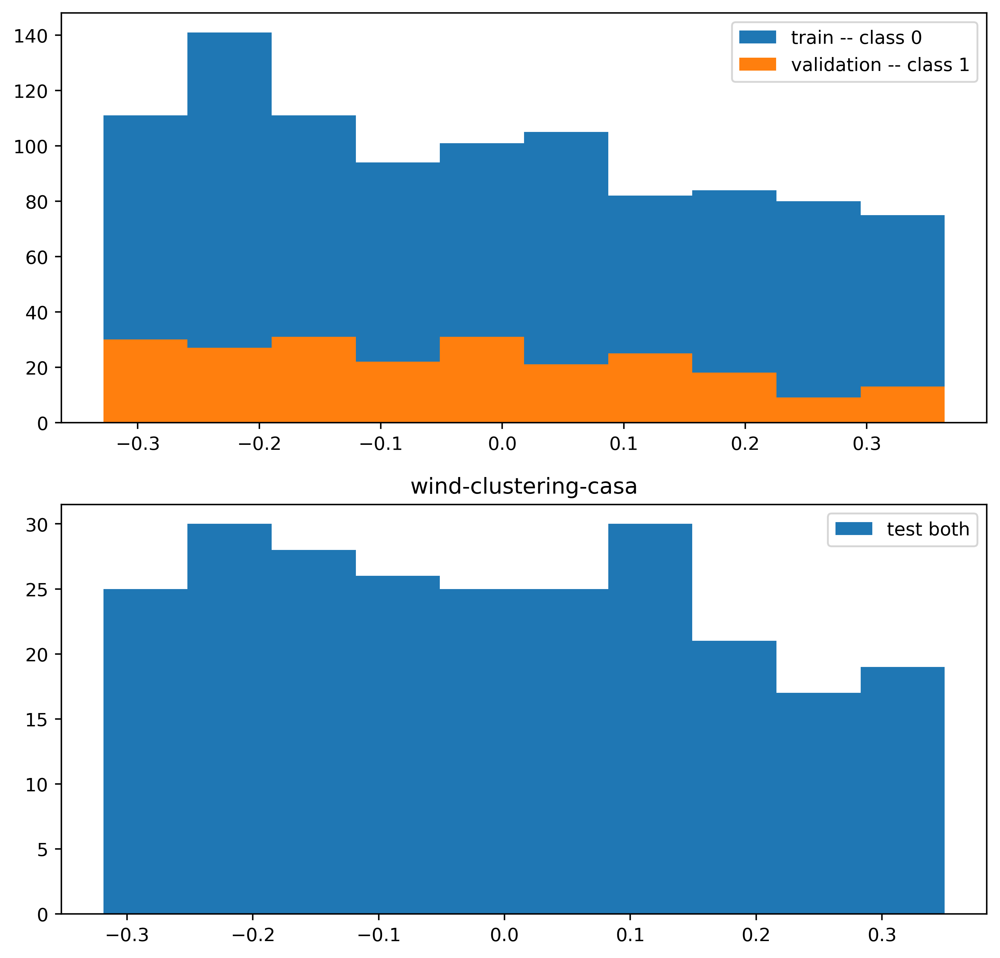

wind-clustering-casa:   7%|▋         | 2002/30000 [04:41<2:39:41,  2.92it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:   7%|▋         | 2102/30000 [04:55<1:04:11,  7.24it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.009852796061187254


wind-clustering-casa:   7%|▋         | 2202/30000 [05:08<1:04:07,  7.23it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.006345559512909111


wind-clustering-casa:   8%|▊         | 2302/30000 [05:22<1:03:32,  7.26it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.004005847942090417


wind-clustering-casa:   8%|▊         | 2402/30000 [05:36<1:03:28,  7.25it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.002478752176666357


wind-clustering-casa:   8%|▊         | 2502/30000 [05:50<1:03:16,  7.24it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.0015034391929775717


wind-clustering-casa:   9%|▊         | 2602/30000 [06:04<1:02:42,  7.28it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:   9%|▉         | 2702/30000 [06:18<1:02:44,  7.25it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:   9%|▉         | 2802/30000 [06:31<1:02:35,  7.24it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  10%|▉         | 2902/30000 [06:45<1:02:22,  7.24it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  10%|█         | 3000/30000 [06:59<1:02:04,  7.25it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


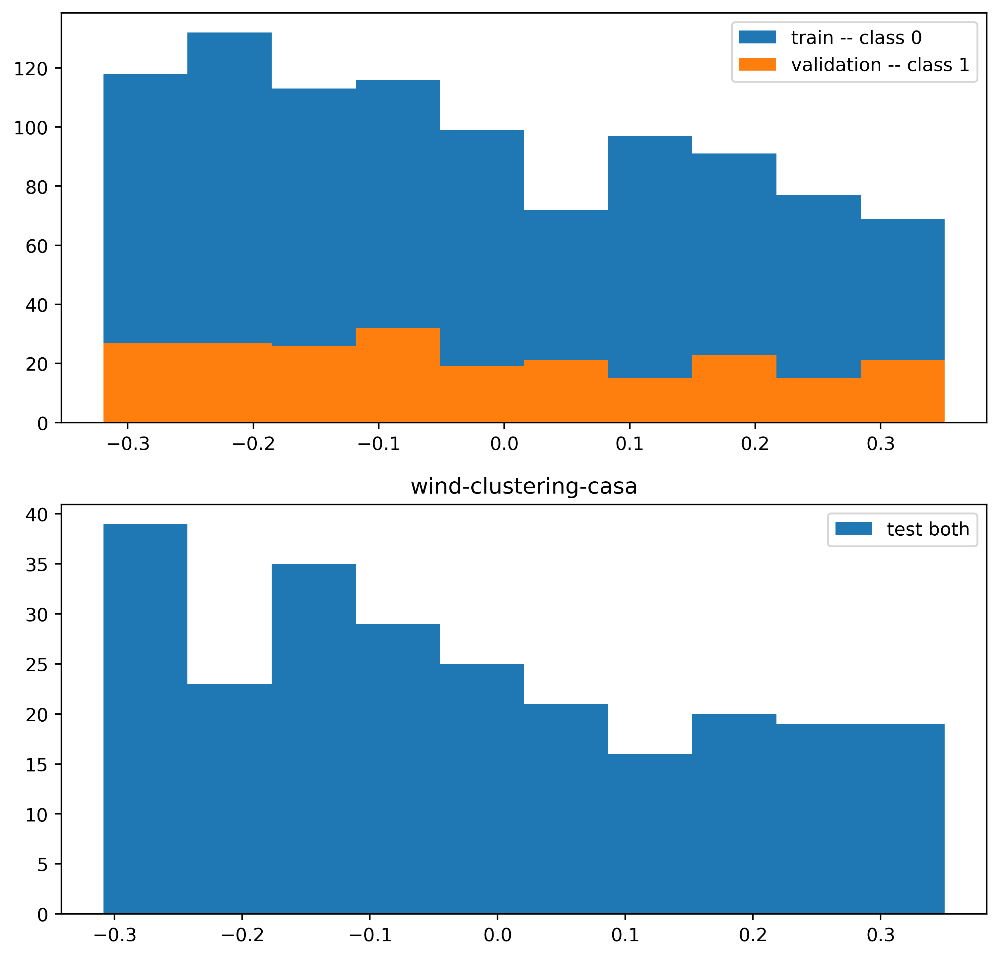

wind-clustering-casa:  10%|█         | 3002/30000 [07:00<2:43:13,  2.76it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  10%|█         | 3102/30000 [07:14<1:01:22,  7.30it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  11%|█         | 3202/30000 [07:28<1:01:06,  7.31it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  11%|█         | 3302/30000 [07:42<1:00:48,  7.32it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  11%|█▏        | 3402/30000 [07:55<1:00:53,  7.28it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  12%|█▏        | 3502/30000 [08:09<1:00:30,  7.30it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  12%|█▏        | 3602/30000 [08:23<1:00:19,  7.29it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  12%|█▏        | 3702/30000 [08:37<1:00:39,  7.23it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  13%|█▎        | 3802/30000 [08:50<59:40,  7.32it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  13%|█▎        | 3902/30000 [09:04<59:27,  7.32it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]   

New Model Temperature: 0.001


wind-clustering-casa:  13%|█▎        | 4000/30000 [09:18<59:30,  7.28it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


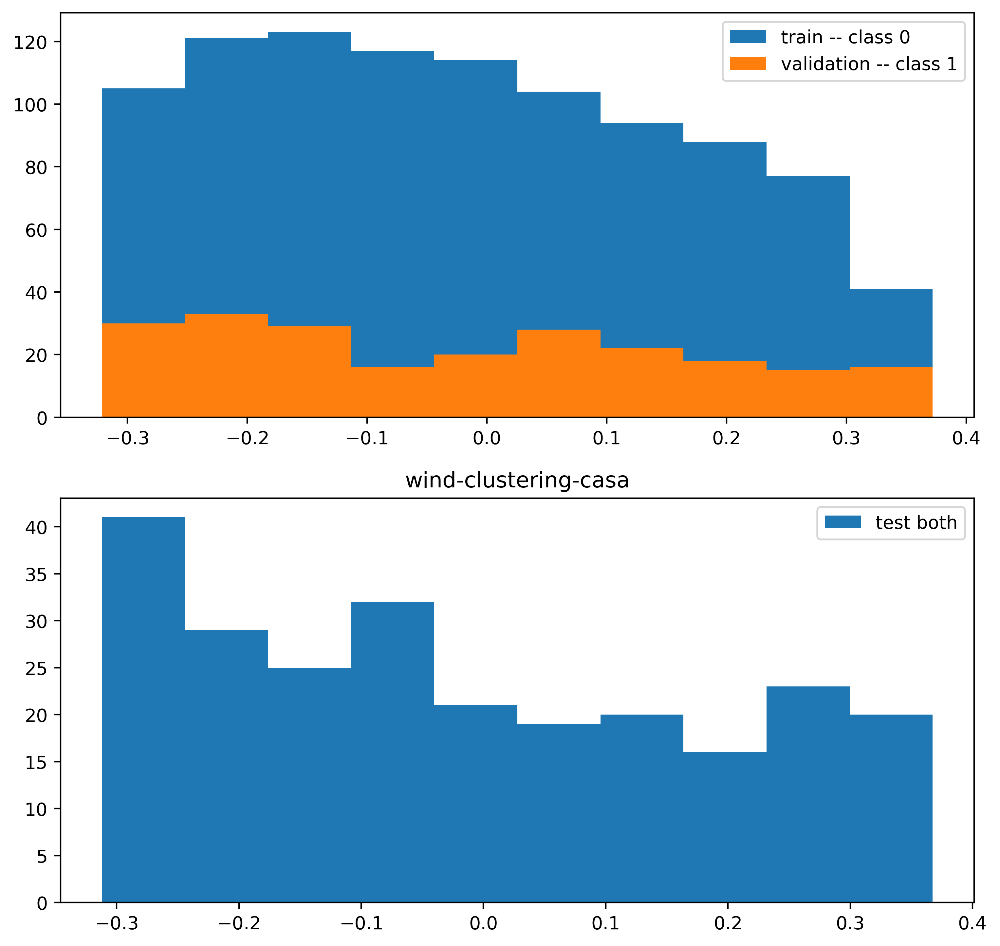

wind-clustering-casa:  13%|█▎        | 4002/30000 [09:19<2:29:55,  2.89it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  14%|█▎        | 4102/30000 [09:33<1:00:09,  7.18it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  14%|█▍        | 4202/30000 [09:47<59:22,  7.24it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  14%|█▍        | 4302/30000 [10:00<59:11,  7.24it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  15%|█▍        | 4402/30000 [10:15<58:46,  7.26it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  15%|█▌        | 4502/30000 [10:28<58:40,  7.24it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  15%|█▌        | 4602/30000 [10:42<58:31,  7.23it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  16%|█▌        | 4702/30000 [10:56<58:15,  7.24it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  16%|█▌        | 4802/30000 [11:10<58:13,  7.21it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  16%|█▋        | 4902/30000 [11:24<57:47,  7.24it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  17%|█▋        | 5000/30000 [11:38<57:52,  7.20it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


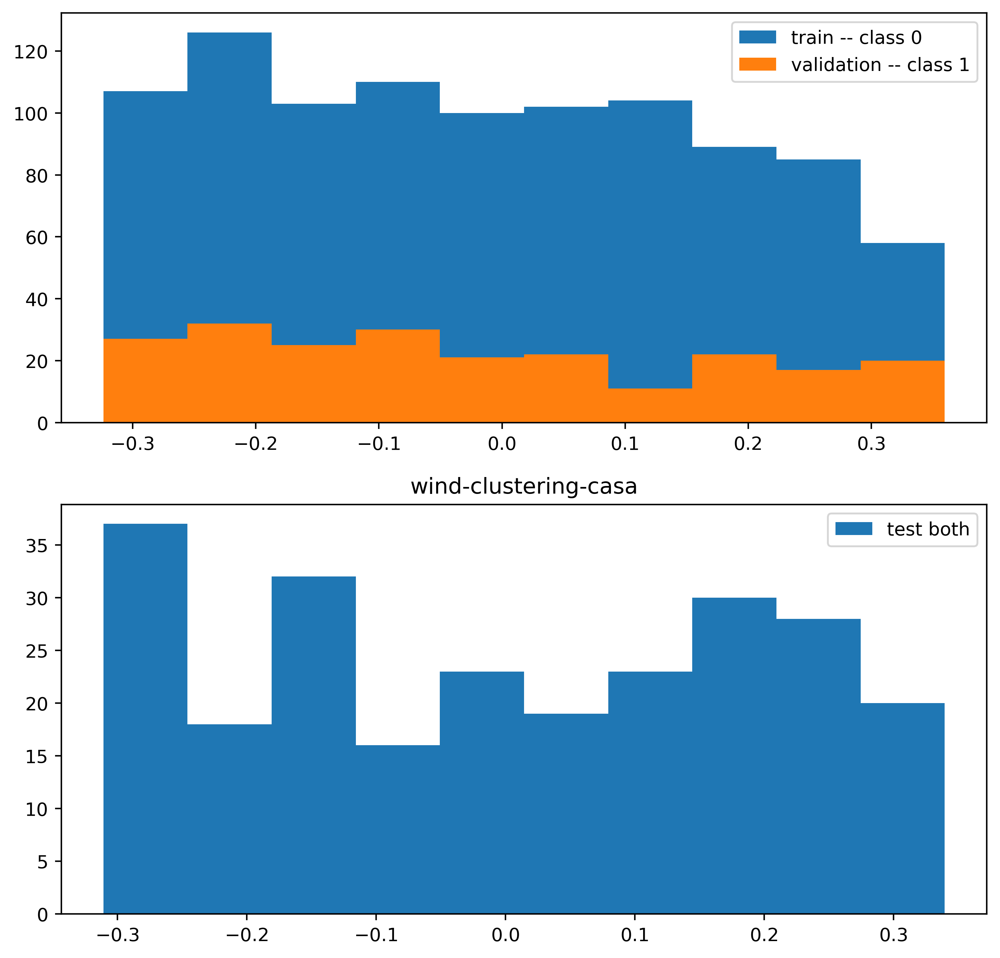

wind-clustering-casa:  17%|█▋        | 5002/30000 [11:39<2:25:28,  2.86it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  17%|█▋        | 5102/30000 [11:53<57:10,  7.26it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  17%|█▋        | 5202/30000 [12:07<57:10,  7.23it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  18%|█▊        | 5302/30000 [12:20<56:54,  7.23it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  18%|█▊        | 5402/30000 [12:34<56:40,  7.23it/s, train_loss=-1.69, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  18%|█▊        | 5502/30000 [12:48<56:30,  7.23it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  19%|█▊        | 5602/30000 [13:02<56:06,  7.25it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  19%|█▉        | 5702/30000 [13:16<55:41,  7.27it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  19%|█▉        | 5802/30000 [13:30<55:24,  7.28it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  20%|█▉        | 5902/30000 [13:44<55:07,  7.28it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  20%|██        | 6000/30000 [13:57<55:05,  7.26it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


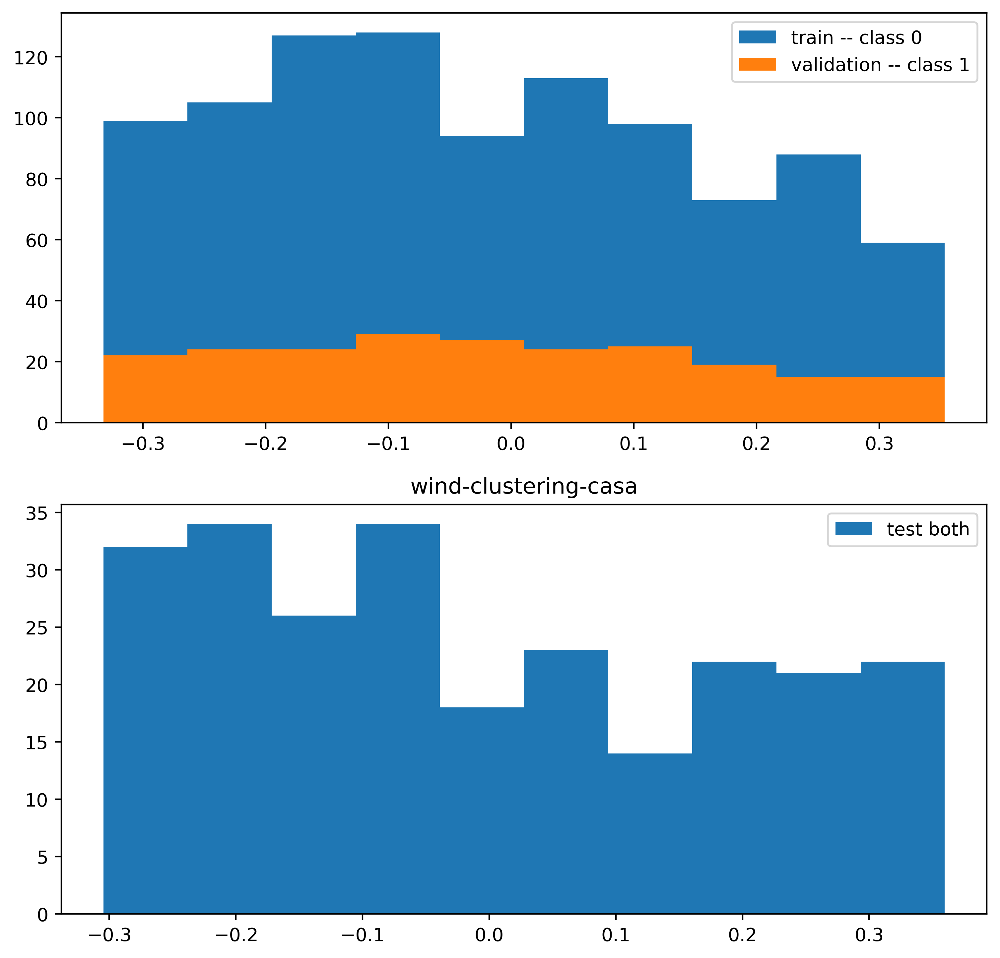

wind-clustering-casa:  20%|██        | 6002/30000 [13:58<2:18:04,  2.90it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  20%|██        | 6102/30000 [14:12<54:41,  7.28it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  21%|██        | 6202/30000 [14:26<54:19,  7.30it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  21%|██        | 6302/30000 [14:40<53:52,  7.33it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  21%|██▏       | 6402/30000 [14:54<54:01,  7.28it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  22%|██▏       | 6502/30000 [15:07<53:39,  7.30it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  22%|██▏       | 6602/30000 [15:21<53:41,  7.26it/s, train_loss=-1.85, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  22%|██▏       | 6702/30000 [15:35<53:23,  7.27it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  23%|██▎       | 6802/30000 [15:49<53:13,  7.26it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  23%|██▎       | 6902/30000 [16:02<52:49,  7.29it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  23%|██▎       | 7000/30000 [16:16<52:27,  7.31it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


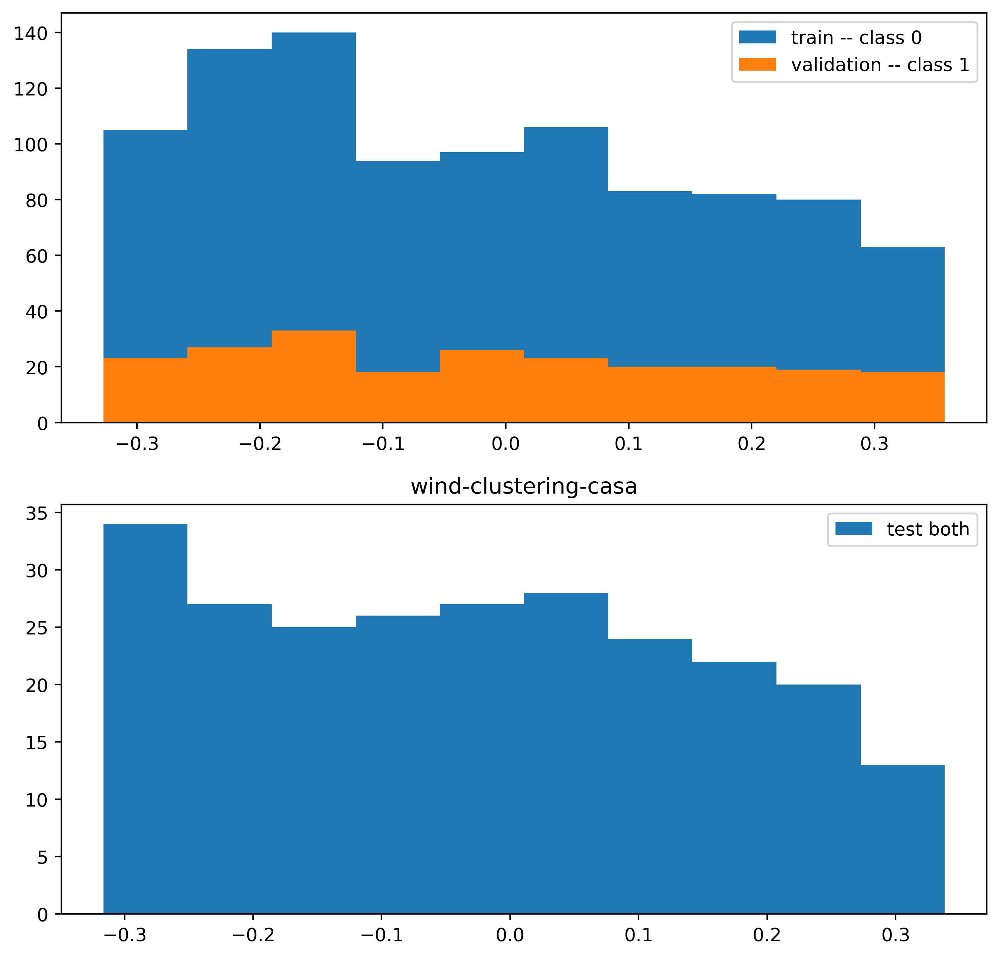

wind-clustering-casa:  23%|██▎       | 7002/30000 [16:17<2:12:47,  2.89it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  24%|██▎       | 7102/30000 [16:31<52:35,  7.26it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  24%|██▍       | 7202/30000 [16:45<52:29,  7.24it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  24%|██▍       | 7302/30000 [16:59<51:50,  7.30it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  25%|██▍       | 7402/30000 [17:12<51:48,  7.27it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  25%|██▌       | 7502/30000 [17:26<51:33,  7.27it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  25%|██▌       | 7602/30000 [17:40<51:19,  7.27it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  26%|██▌       | 7702/30000 [17:54<51:13,  7.26it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  26%|██▌       | 7802/30000 [18:08<50:55,  7.26it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  26%|██▋       | 7902/30000 [18:22<51:07,  7.20it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  27%|██▋       | 8000/30000 [18:36<50:37,  7.24it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


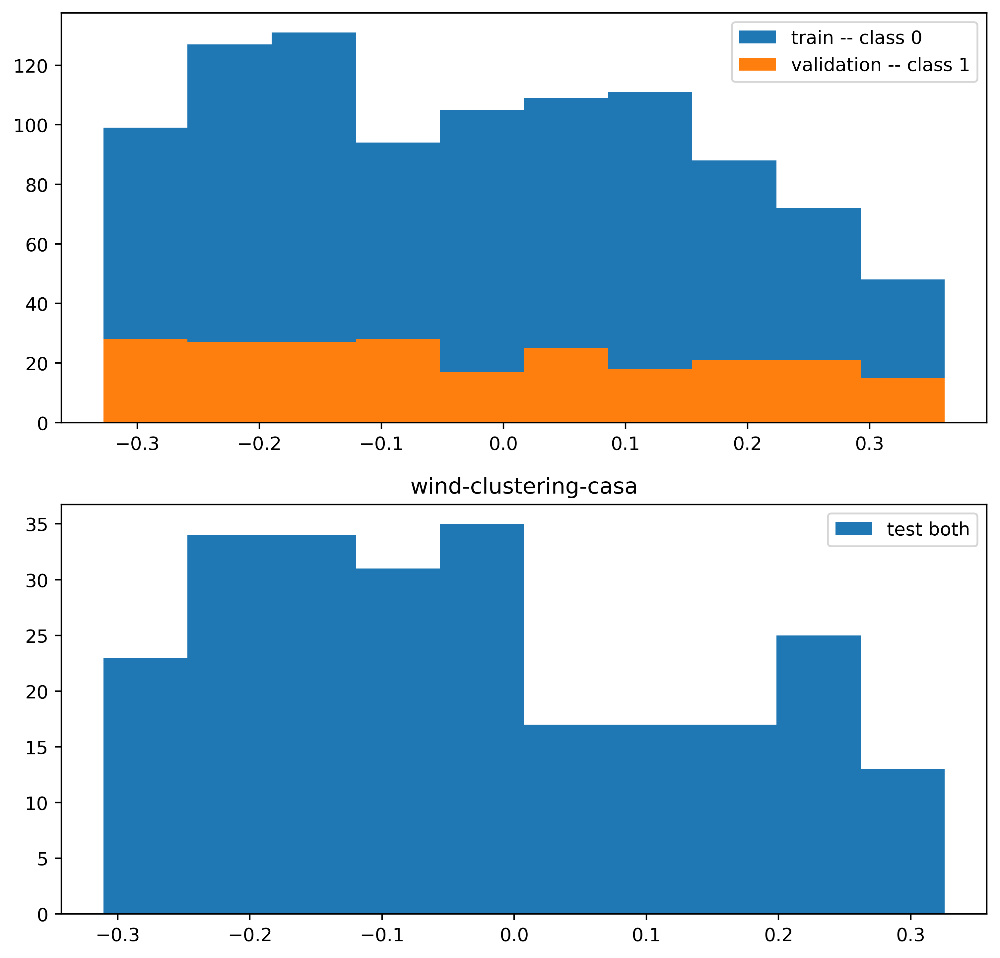

wind-clustering-casa:  27%|██▋       | 8002/30000 [18:37<2:07:14,  2.88it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  27%|██▋       | 8102/30000 [18:51<50:01,  7.29it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  27%|██▋       | 8202/30000 [19:04<49:58,  7.27it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  28%|██▊       | 8302/30000 [19:18<49:55,  7.24it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  28%|██▊       | 8402/30000 [19:32<49:19,  7.30it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  28%|██▊       | 8502/30000 [19:46<49:23,  7.26it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  29%|██▊       | 8602/30000 [20:00<48:53,  7.29it/s, train_loss=-1.69, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  29%|██▉       | 8702/30000 [20:13<48:37,  7.30it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  29%|██▉       | 8802/30000 [20:27<48:24,  7.30it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  30%|██▉       | 8902/30000 [20:41<48:33,  7.24it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  30%|███       | 9000/30000 [20:55<47:53,  7.31it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


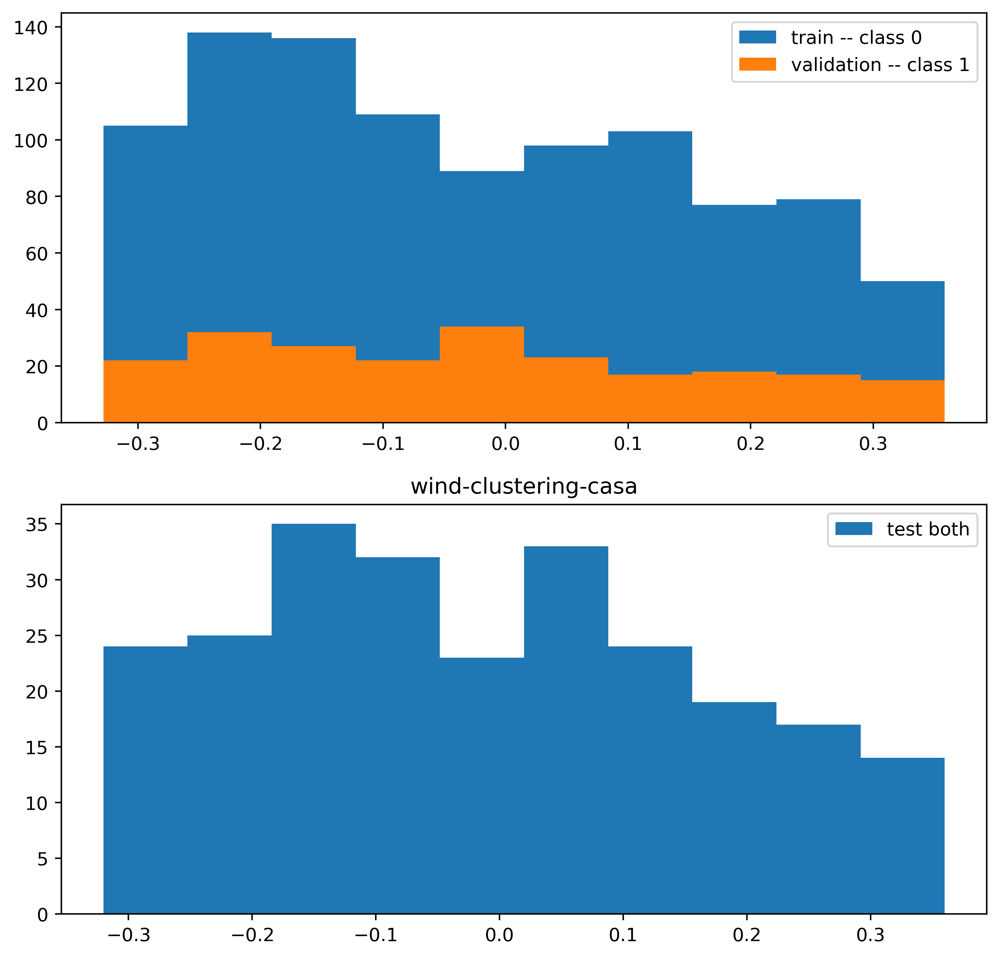

wind-clustering-casa:  30%|███       | 9002/30000 [20:56<2:00:35,  2.90it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  30%|███       | 9102/30000 [21:09<48:00,  7.25it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  31%|███       | 9202/30000 [21:23<48:11,  7.19it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  31%|███       | 9302/30000 [21:37<47:54,  7.20it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  31%|███▏      | 9402/30000 [21:51<47:34,  7.22it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  32%|███▏      | 9502/30000 [22:05<47:22,  7.21it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  32%|███▏      | 9602/30000 [22:19<47:08,  7.21it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  32%|███▏      | 9702/30000 [22:33<46:46,  7.23it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  33%|███▎      | 9802/30000 [22:47<46:46,  7.20it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  33%|███▎      | 9902/30000 [23:01<46:27,  7.21it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  33%|███▎      | 10000/30000 [23:14<46:22,  7.19it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


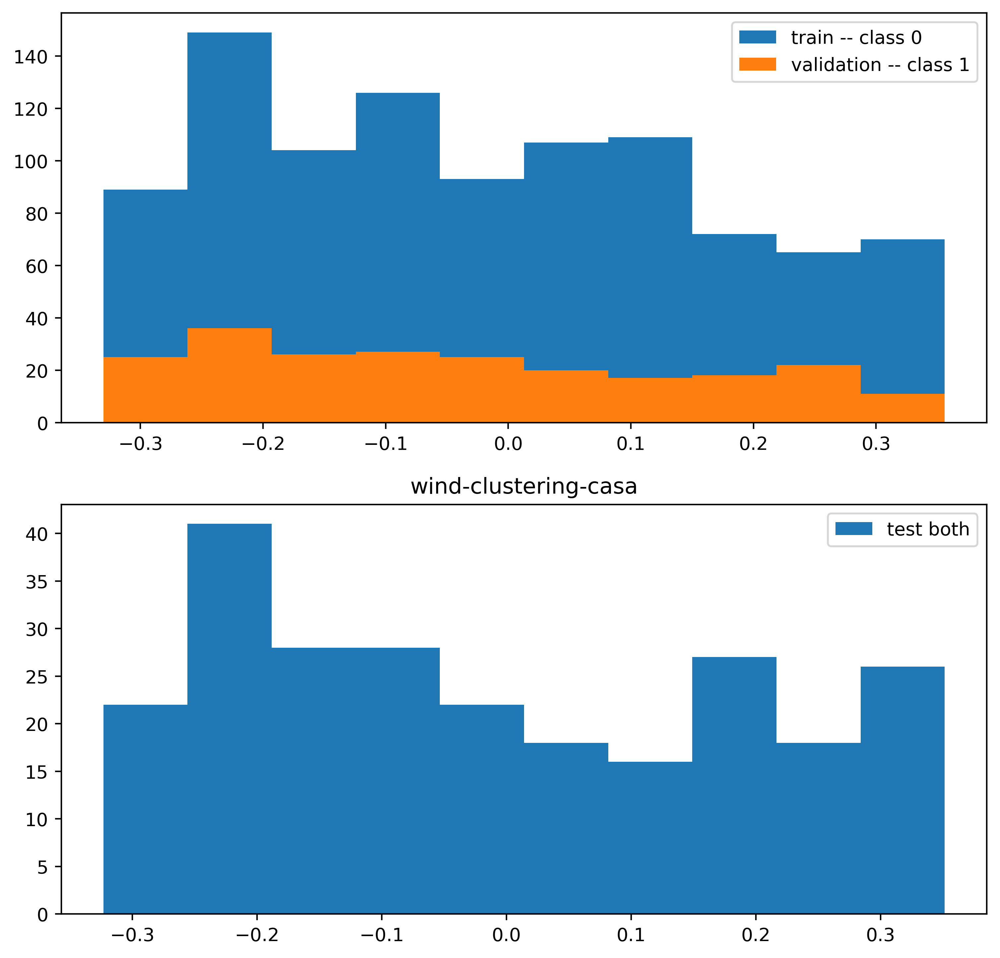

wind-clustering-casa:  33%|███▎      | 10002/30000 [23:16<1:55:47,  2.88it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  34%|███▎      | 10102/30000 [23:30<46:05,  7.20it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  34%|███▍      | 10202/30000 [23:43<45:45,  7.21it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  34%|███▍      | 10302/30000 [23:58<45:26,  7.22it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  35%|███▍      | 10402/30000 [24:11<45:02,  7.25it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  35%|███▌      | 10502/30000 [24:25<44:53,  7.24it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  35%|███▌      | 10602/30000 [24:39<45:03,  7.18it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  36%|███▌      | 10702/30000 [24:53<44:29,  7.23it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  36%|███▌      | 10802/30000 [25:07<44:40,  7.16it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  36%|███▋      | 10902/30000 [25:21<44:13,  7.20it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  37%|███▋      | 11000/30000 [25:35<43:49,  7.23it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


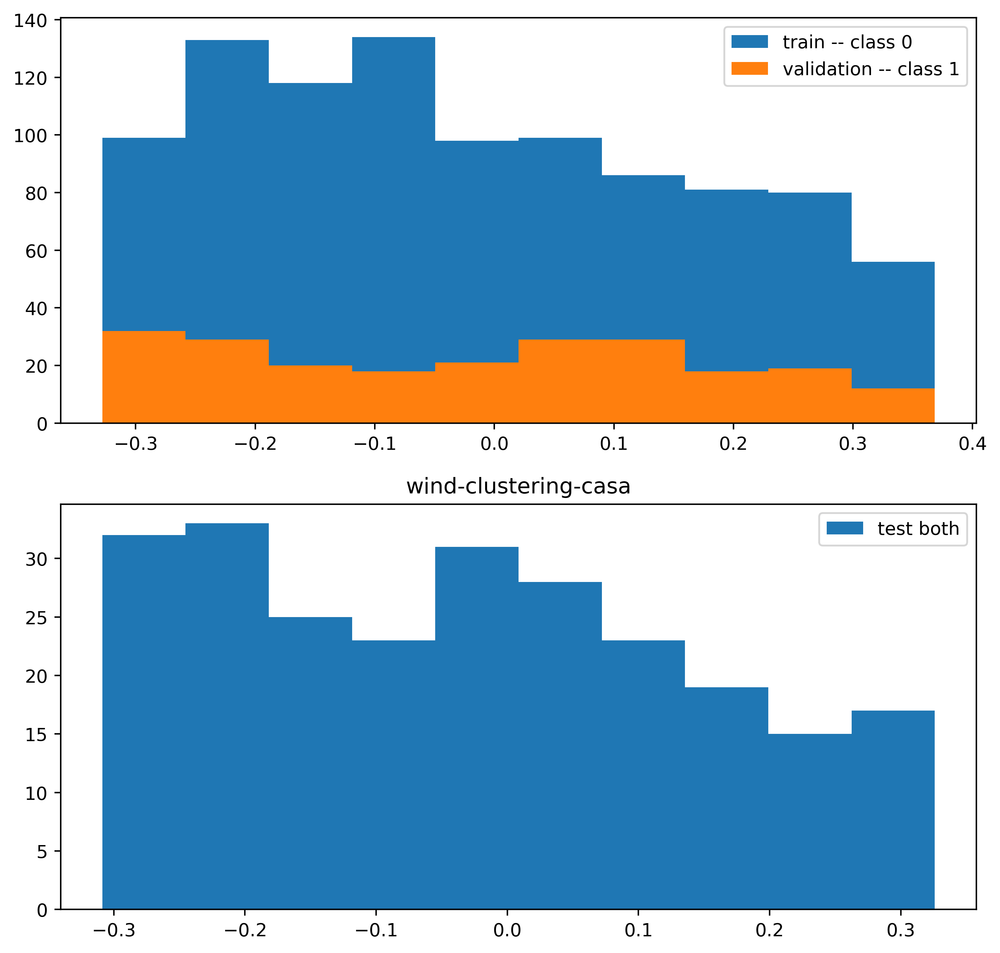

wind-clustering-casa:  37%|███▋      | 11002/30000 [25:36<1:49:08,  2.90it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  37%|███▋      | 11102/30000 [25:50<43:54,  7.17it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  37%|███▋      | 11202/30000 [26:04<43:53,  7.14it/s, train_loss=-1.65, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  38%|███▊      | 11302/30000 [26:18<43:57,  7.09it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  38%|███▊      | 11402/30000 [26:32<43:04,  7.19it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  38%|███▊      | 11502/30000 [26:46<43:03,  7.16it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  39%|███▊      | 11602/30000 [27:00<42:47,  7.16it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  39%|███▉      | 11702/30000 [27:14<42:31,  7.17it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  39%|███▉      | 11802/30000 [27:28<42:10,  7.19it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  40%|███▉      | 11902/30000 [27:42<41:51,  7.21it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  40%|████      | 12000/30000 [27:56<42:11,  7.11it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


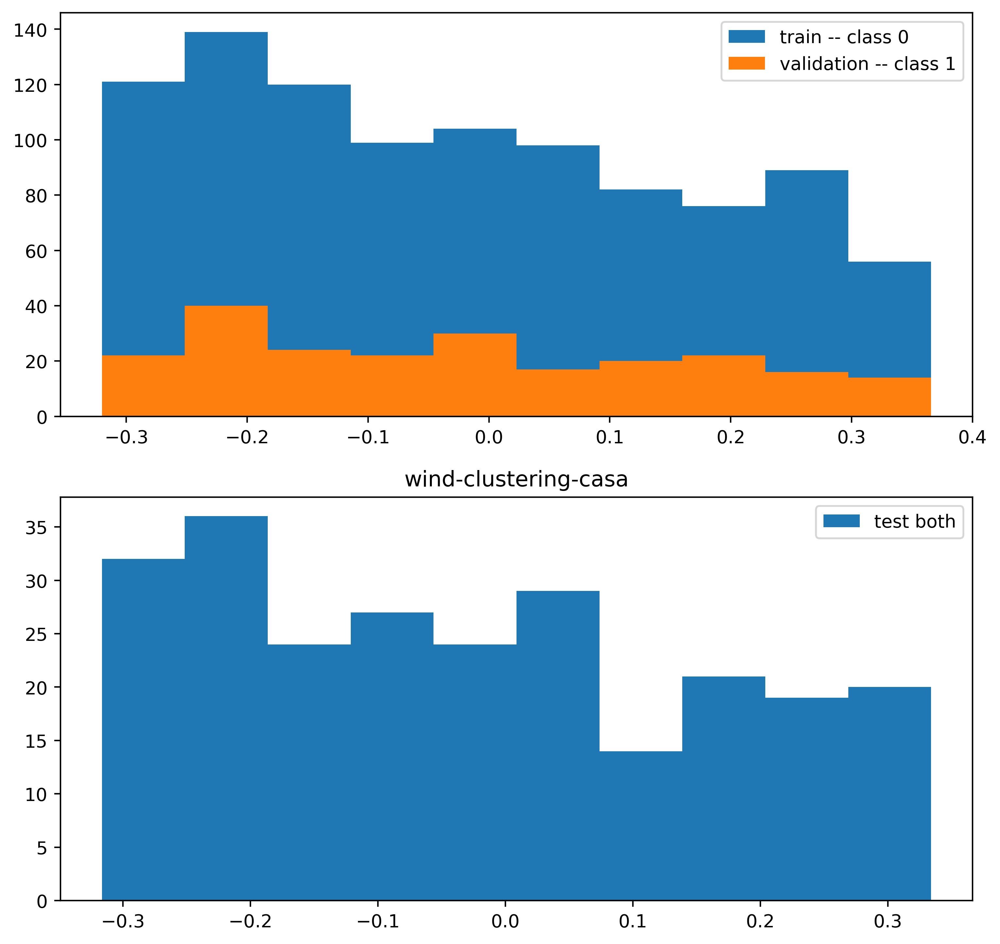

wind-clustering-casa:  40%|████      | 12002/30000 [27:57<1:45:40,  2.84it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  40%|████      | 12102/30000 [28:11<41:14,  7.23it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  41%|████      | 12202/30000 [28:25<40:56,  7.25it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  41%|████      | 12302/30000 [28:39<40:40,  7.25it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  41%|████▏     | 12402/30000 [28:53<46:24,  6.32it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  42%|████▏     | 12502/30000 [29:07<40:12,  7.25it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  42%|████▏     | 12602/30000 [29:21<39:56,  7.26it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  42%|████▏     | 12702/30000 [29:35<39:44,  7.26it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  43%|████▎     | 12802/30000 [29:49<39:33,  7.25it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  43%|████▎     | 12902/30000 [30:02<39:23,  7.23it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  43%|████▎     | 13000/30000 [30:16<38:56,  7.27it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


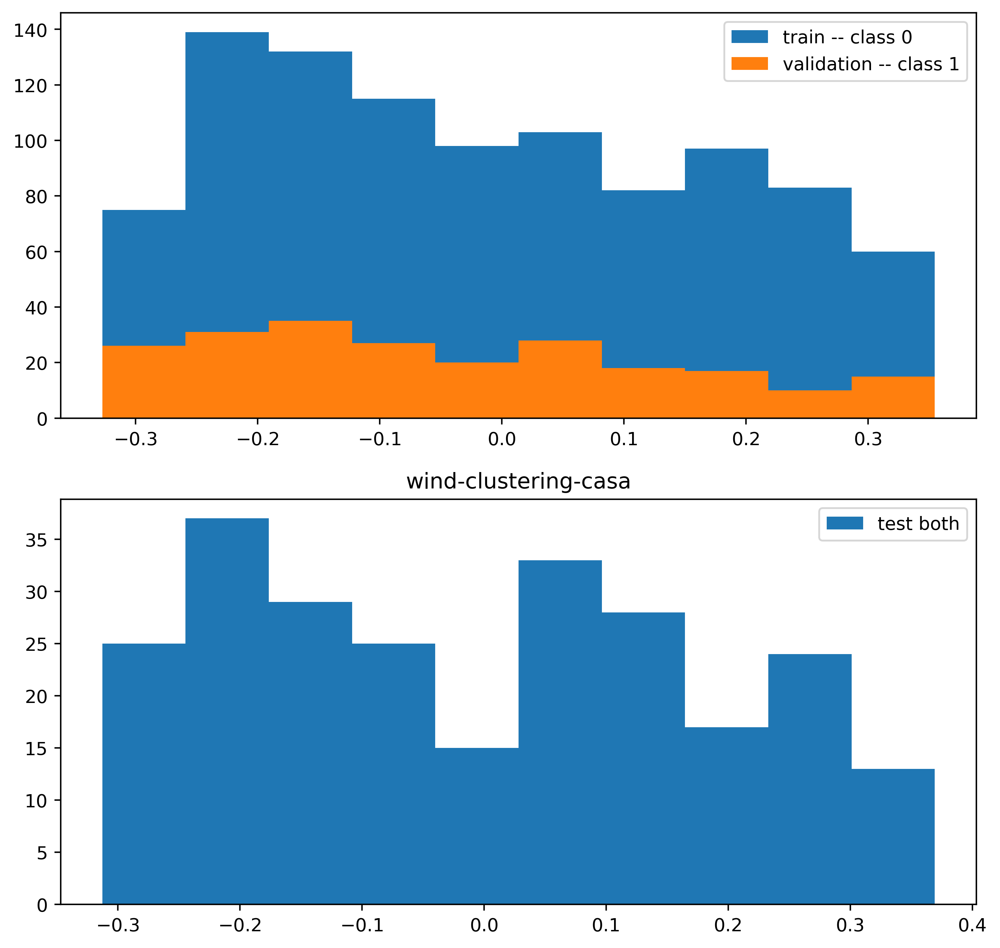

wind-clustering-casa:  43%|████▎     | 13002/30000 [30:17<1:38:30,  2.88it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  44%|████▎     | 13102/30000 [30:31<38:41,  7.28it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  44%|████▍     | 13202/30000 [30:45<38:28,  7.28it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  44%|████▍     | 13302/30000 [30:59<42:16,  6.58it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  45%|████▍     | 13402/30000 [31:13<38:04,  7.26it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  45%|████▌     | 13502/30000 [31:27<38:02,  7.23it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  45%|████▌     | 13602/30000 [31:40<37:23,  7.31it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  46%|████▌     | 13702/30000 [31:54<37:26,  7.25it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  46%|████▌     | 13802/30000 [32:08<37:07,  7.27it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  46%|████▋     | 13902/30000 [32:22<36:49,  7.28it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  47%|████▋     | 14000/30000 [32:36<36:45,  7.25it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


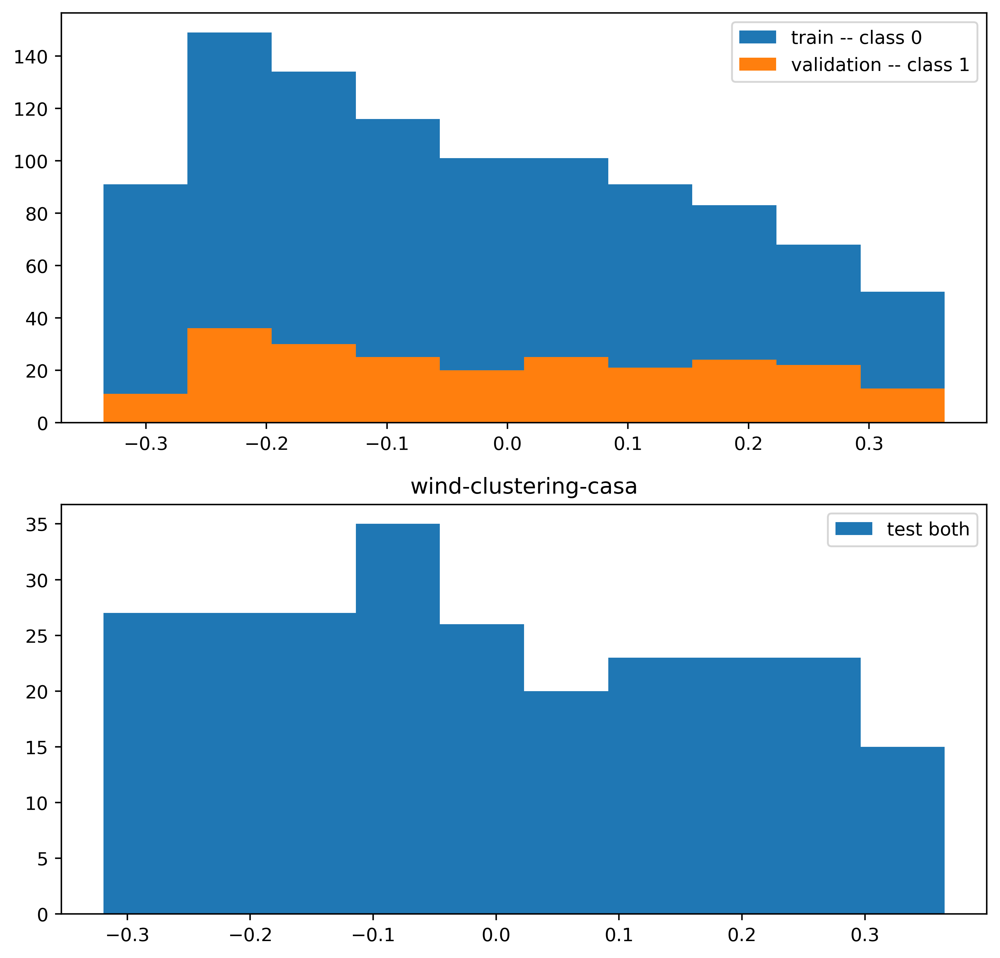

wind-clustering-casa:  47%|████▋     | 14002/30000 [32:37<1:32:28,  2.88it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  47%|████▋     | 14102/30000 [32:51<36:36,  7.24it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  47%|████▋     | 14202/30000 [33:04<36:18,  7.25it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  48%|████▊     | 14302/30000 [33:18<36:10,  7.23it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  48%|████▊     | 14402/30000 [33:32<35:58,  7.23it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  48%|████▊     | 14502/30000 [33:46<35:48,  7.21it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  49%|████▊     | 14602/30000 [34:00<35:30,  7.23it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  49%|████▉     | 14702/30000 [34:14<35:03,  7.27it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  49%|████▉     | 14802/30000 [34:28<35:05,  7.22it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  50%|████▉     | 14902/30000 [34:41<34:42,  7.25it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  50%|█████     | 15000/30000 [34:55<34:42,  7.20it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


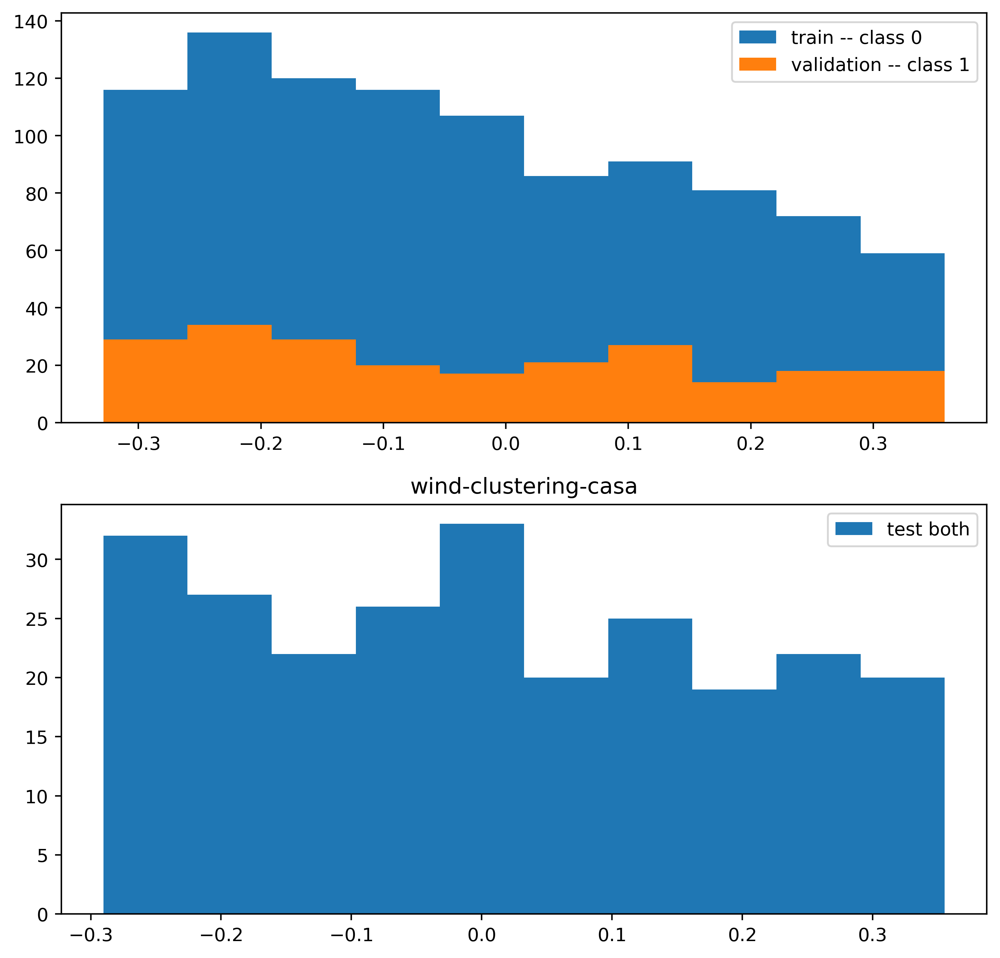

wind-clustering-casa:  50%|█████     | 15002/30000 [34:56<1:27:35,  2.85it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  50%|█████     | 15102/30000 [35:10<34:15,  7.25it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  51%|█████     | 15202/30000 [35:24<33:53,  7.28it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  51%|█████     | 15302/30000 [35:38<34:16,  7.15it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  51%|█████▏    | 15402/30000 [35:52<33:50,  7.19it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  52%|█████▏    | 15502/30000 [36:06<33:21,  7.24it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  52%|█████▏    | 15602/30000 [36:20<33:25,  7.18it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  52%|█████▏    | 15702/30000 [36:34<32:58,  7.23it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  53%|█████▎    | 15802/30000 [36:48<32:47,  7.21it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  53%|█████▎    | 15902/30000 [37:02<32:51,  7.15it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  53%|█████▎    | 16000/30000 [37:15<32:24,  7.20it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


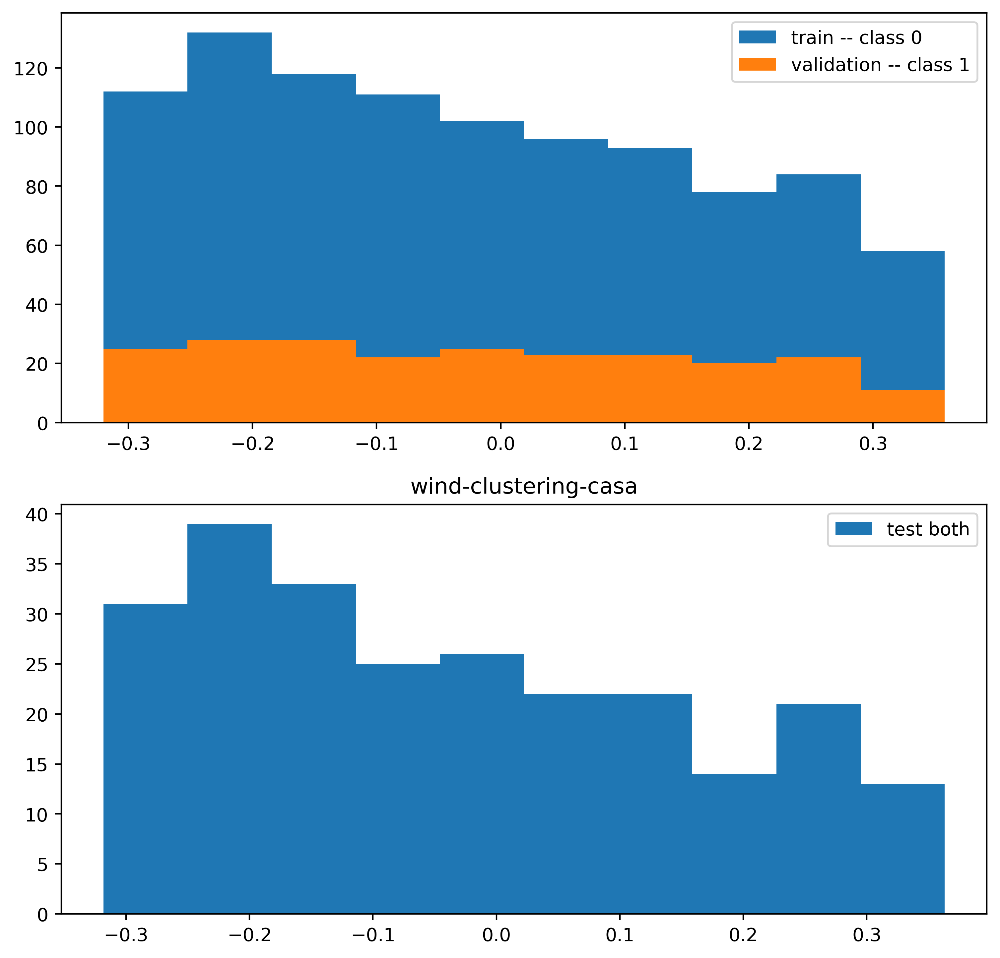

wind-clustering-casa:  53%|█████▎    | 16002/30000 [37:16<1:20:45,  2.89it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  54%|█████▎    | 16102/30000 [37:31<32:53,  7.04it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  54%|█████▍    | 16202/30000 [37:45<32:08,  7.16it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  54%|█████▍    | 16302/30000 [37:59<32:11,  7.09it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  55%|█████▍    | 16402/30000 [38:13<31:38,  7.16it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  55%|█████▌    | 16502/30000 [38:27<31:23,  7.17it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  55%|█████▌    | 16602/30000 [38:41<31:10,  7.16it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  56%|█████▌    | 16702/30000 [38:55<31:00,  7.15it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  56%|█████▌    | 16802/30000 [39:09<31:03,  7.08it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  56%|█████▋    | 16902/30000 [39:23<30:30,  7.15it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  57%|█████▋    | 17000/30000 [39:37<30:05,  7.20it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


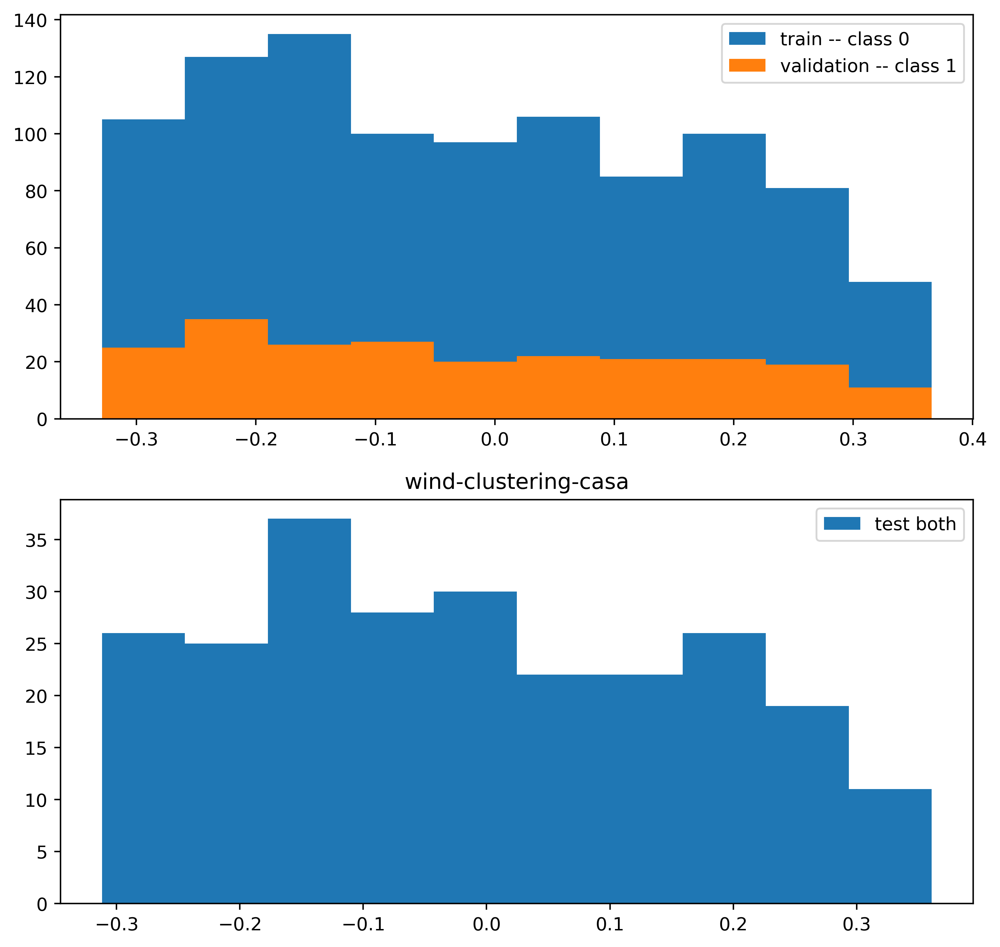

wind-clustering-casa:  57%|█████▋    | 17002/30000 [39:38<1:15:38,  2.86it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  57%|█████▋    | 17102/30000 [39:52<29:54,  7.19it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  57%|█████▋    | 17202/30000 [40:06<29:48,  7.15it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  58%|█████▊    | 17302/30000 [40:20<29:35,  7.15it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  58%|█████▊    | 17402/30000 [40:34<29:15,  7.18it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  58%|█████▊    | 17502/30000 [40:48<29:13,  7.13it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  59%|█████▊    | 17602/30000 [41:02<28:49,  7.17it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  59%|█████▉    | 17702/30000 [41:16<28:38,  7.15it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  59%|█████▉    | 17802/30000 [41:30<28:21,  7.17it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  60%|█████▉    | 17902/30000 [41:44<28:24,  7.10it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  60%|██████    | 18000/30000 [41:58<28:05,  7.12it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


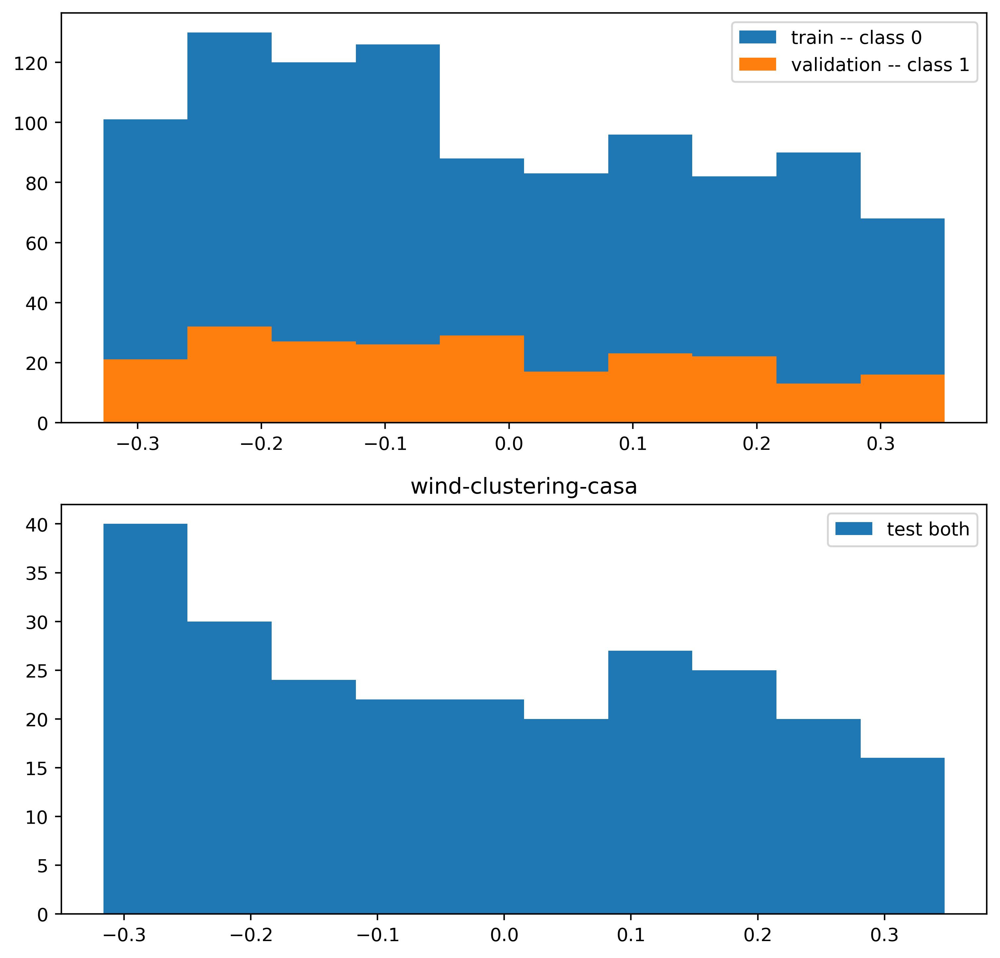

wind-clustering-casa:  60%|██████    | 18002/30000 [41:59<1:10:10,  2.85it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  60%|██████    | 18102/30000 [42:13<27:47,  7.14it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  61%|██████    | 18202/30000 [42:27<27:39,  7.11it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  61%|██████    | 18302/30000 [42:41<27:21,  7.13it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  61%|██████▏   | 18402/30000 [42:55<26:51,  7.20it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  62%|██████▏   | 18502/30000 [43:09<26:55,  7.12it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  62%|██████▏   | 18602/30000 [43:23<26:38,  7.13it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  62%|██████▏   | 18702/30000 [43:37<26:45,  7.04it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  63%|██████▎   | 18802/30000 [43:51<26:04,  7.16it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  63%|██████▎   | 18902/30000 [44:05<26:09,  7.07it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  63%|██████▎   | 19000/30000 [44:19<25:24,  7.21it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


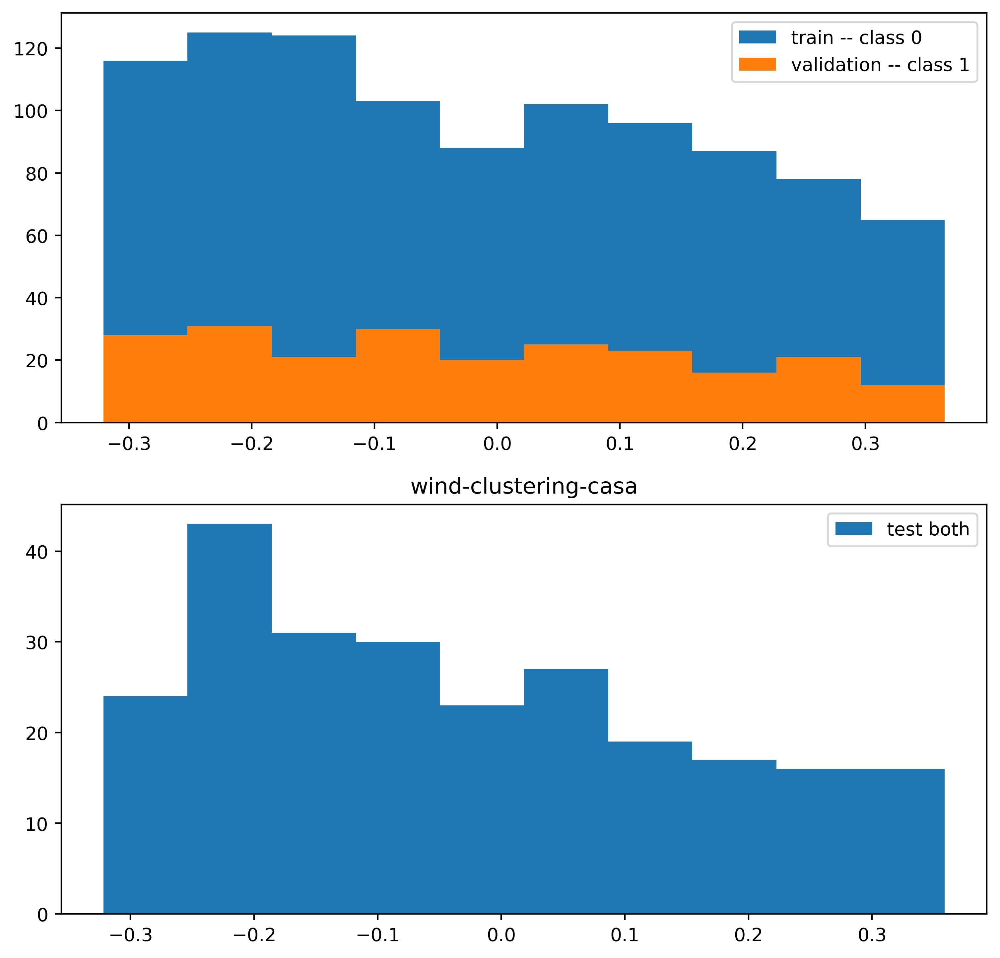

wind-clustering-casa:  63%|██████▎   | 19002/30000 [44:20<1:02:34,  2.93it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  64%|██████▎   | 19102/30000 [44:34<25:26,  7.14it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-clustering-casa:  64%|██████▍   | 19202/30000 [44:48<24:58,  7.20it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  64%|██████▍   | 19302/30000 [45:02<25:03,  7.12it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  65%|██████▍   | 19402/30000 [45:16<24:37,  7.17it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  65%|██████▌   | 19502/30000 [45:30<24:22,  7.18it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  65%|██████▌   | 19602/30000 [45:44<24:12,  7.16it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  66%|██████▌   | 19702/30000 [45:58<23:49,  7.20it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  66%|██████▌   | 19802/30000 [46:12<23:34,  7.21it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  66%|██████▋   | 19902/30000 [46:26<23:23,  7.19it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  67%|██████▋   | 20000/30000 [46:40<23:07,  7.21it/s, train_loss=-1.69, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


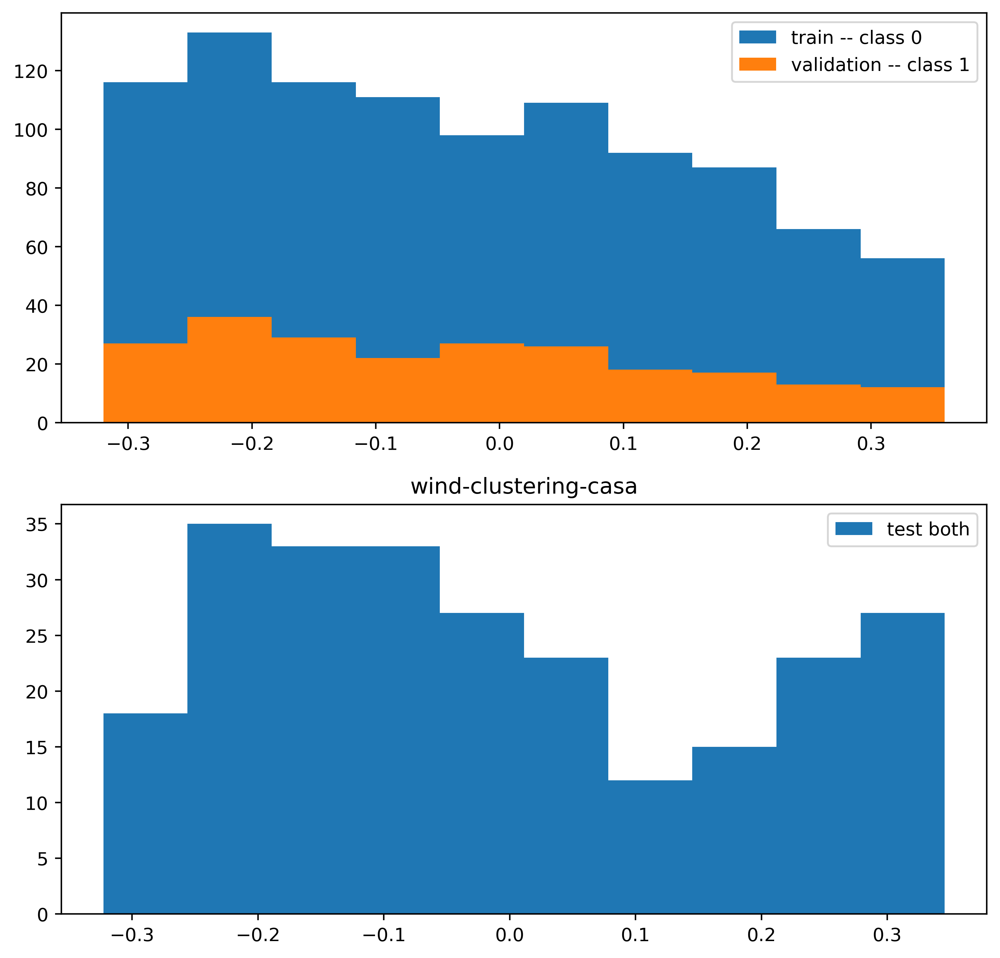

wind-clustering-casa:  67%|██████▋   | 20002/30000 [46:41<57:15,  2.91it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  67%|██████▋   | 20102/30000 [46:55<22:56,  7.19it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  67%|██████▋   | 20202/30000 [47:09<22:37,  7.22it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  68%|██████▊   | 20302/30000 [47:23<22:26,  7.20it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  68%|██████▊   | 20402/30000 [47:37<22:02,  7.26it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  68%|██████▊   | 20502/30000 [47:51<21:54,  7.22it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  69%|██████▊   | 20602/30000 [48:05<21:42,  7.22it/s, train_loss=-1.71, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  69%|██████▉   | 20702/30000 [48:19<21:32,  7.19it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  69%|██████▉   | 20802/30000 [48:33<21:09,  7.25it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  70%|██████▉   | 20902/30000 [48:46<20:55,  7.25it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  70%|███████   | 21000/30000 [49:00<20:47,  7.21it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


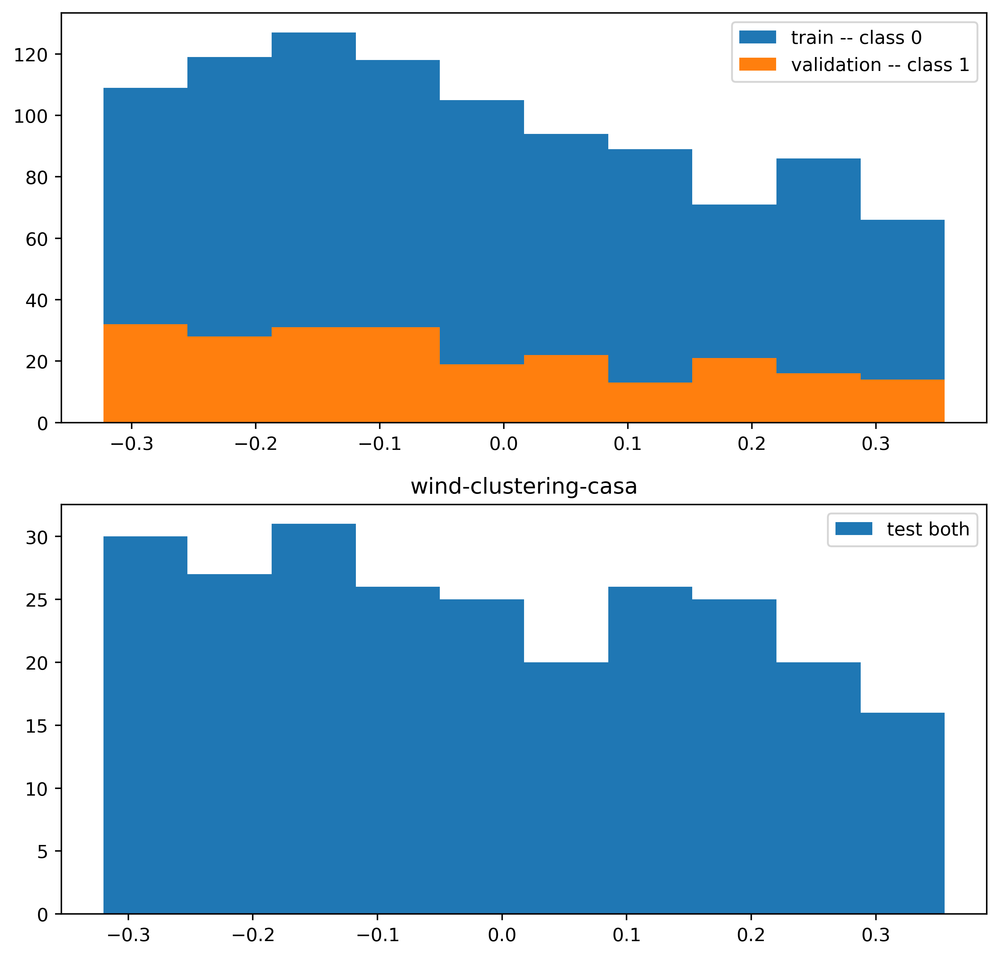

wind-clustering-casa:  70%|███████   | 21002/30000 [49:01<52:25,  2.86it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]  

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  70%|███████   | 21102/30000 [49:15<20:13,  7.33it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  71%|███████   | 21202/30000 [49:29<20:09,  7.27it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  71%|███████   | 21302/30000 [49:43<19:50,  7.31it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  71%|███████▏  | 21402/30000 [49:56<19:38,  7.30it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  72%|███████▏  | 21502/30000 [50:10<19:24,  7.30it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  72%|███████▏  | 21602/30000 [50:24<19:14,  7.27it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  72%|███████▏  | 21702/30000 [50:38<18:58,  7.29it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  73%|███████▎  | 21802/30000 [50:52<18:42,  7.30it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  73%|███████▎  | 21902/30000 [51:05<18:26,  7.32it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  73%|███████▎  | 22000/30000 [51:19<18:16,  7.30it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


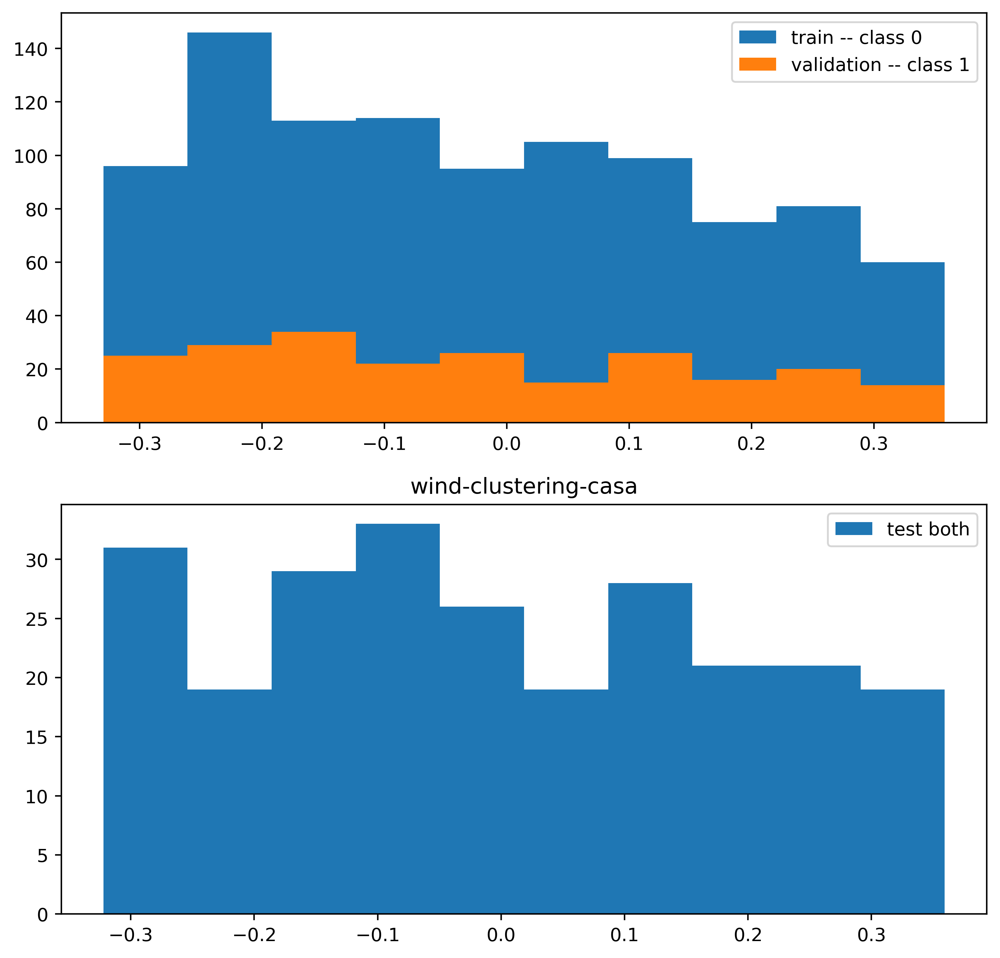

wind-clustering-casa:  73%|███████▎  | 22002/30000 [51:20<46:26,  2.87it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  74%|███████▎  | 22102/30000 [51:34<18:10,  7.24it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  74%|███████▍  | 22202/30000 [51:48<17:55,  7.25it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  74%|███████▍  | 22302/30000 [52:02<17:42,  7.24it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  75%|███████▍  | 22402/30000 [52:16<17:25,  7.27it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  75%|███████▌  | 22502/30000 [52:29<17:14,  7.25it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  75%|███████▌  | 22602/30000 [52:43<16:59,  7.26it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  76%|███████▌  | 22702/30000 [52:57<16:52,  7.21it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  76%|███████▌  | 22802/30000 [53:11<16:36,  7.23it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  76%|███████▋  | 22902/30000 [53:25<16:20,  7.24it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  77%|███████▋  | 23000/30000 [53:39<16:07,  7.24it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


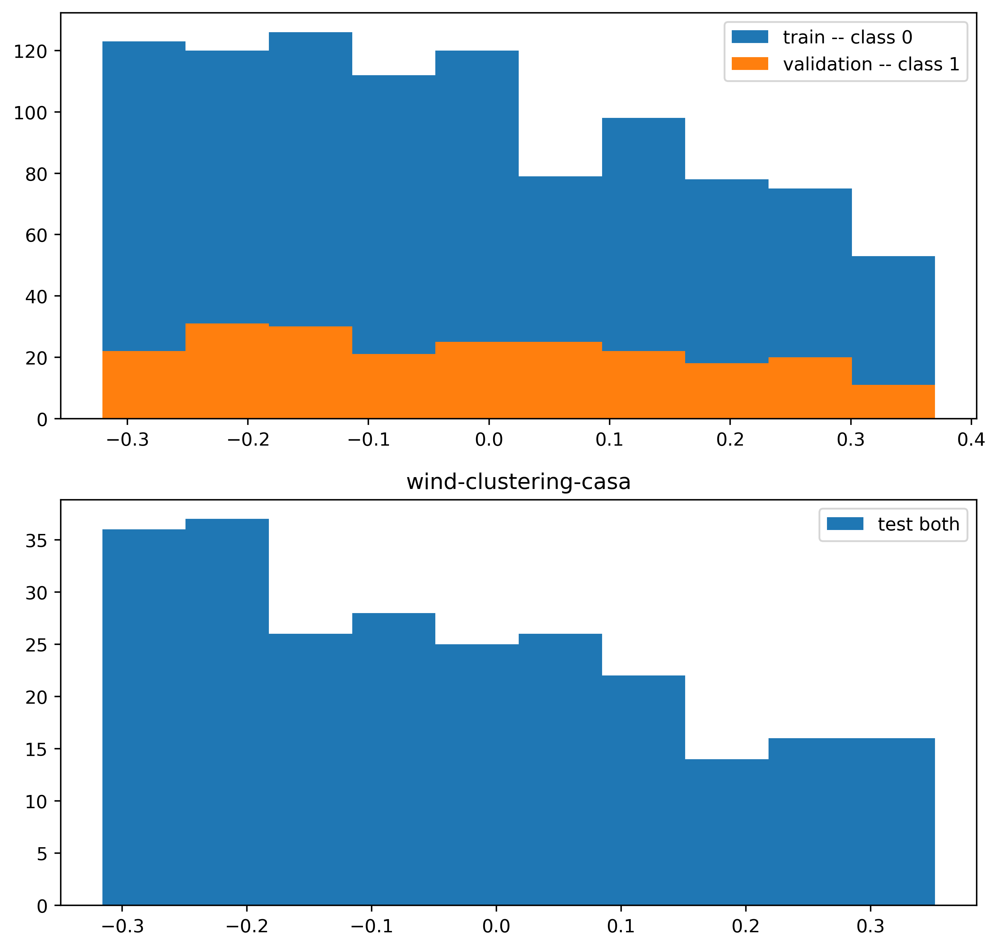

wind-clustering-casa:  77%|███████▋  | 23002/30000 [53:40<40:26,  2.88it/s, train_loss=-1.84, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  77%|███████▋  | 23102/30000 [53:54<15:57,  7.20it/s, train_loss=-1.82, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  77%|███████▋  | 23202/30000 [54:08<15:42,  7.21it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  78%|███████▊  | 23302/30000 [54:21<15:30,  7.20it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  78%|███████▊  | 23402/30000 [54:35<15:16,  7.20it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  78%|███████▊  | 23502/30000 [54:49<15:00,  7.21it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  79%|███████▊  | 23602/30000 [55:03<14:46,  7.22it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  79%|███████▉  | 23702/30000 [55:17<14:33,  7.21it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  79%|███████▉  | 23802/30000 [55:31<14:19,  7.21it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  80%|███████▉  | 23902/30000 [55:45<14:02,  7.24it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  80%|████████  | 24000/30000 [55:59<13:44,  7.28it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


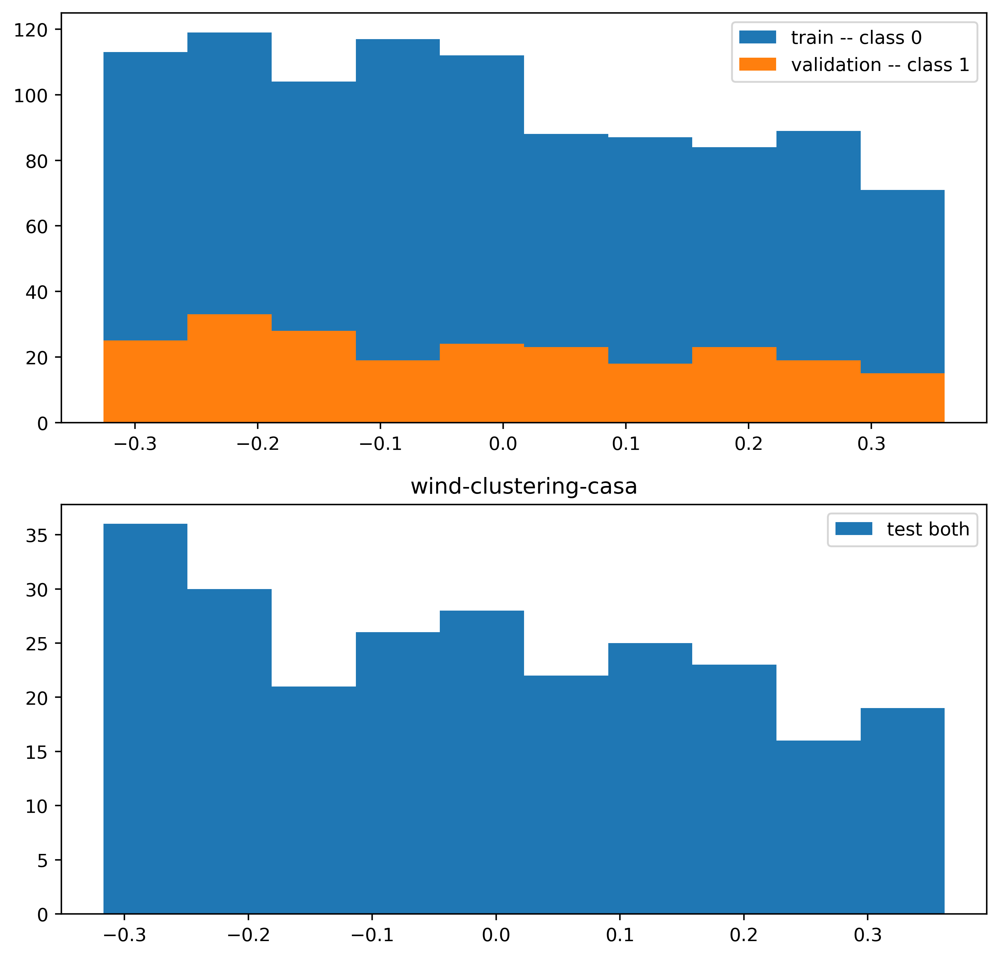

wind-clustering-casa:  80%|████████  | 24002/30000 [56:00<34:32,  2.89it/s, train_loss=-1.83, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  80%|████████  | 24102/30000 [56:14<13:41,  7.18it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  81%|████████  | 24202/30000 [56:28<13:22,  7.23it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  81%|████████  | 24302/30000 [56:41<13:06,  7.25it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  81%|████████▏ | 24402/30000 [56:55<12:54,  7.23it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  82%|████████▏ | 24502/30000 [57:09<12:45,  7.18it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  82%|████████▏ | 24602/30000 [57:23<12:40,  7.10it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  82%|████████▏ | 24702/30000 [57:37<12:25,  7.11it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  83%|████████▎ | 24802/30000 [57:51<12:03,  7.18it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  83%|████████▎ | 24902/30000 [58:05<11:47,  7.20it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  83%|████████▎ | 25000/30000 [58:19<11:31,  7.23it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


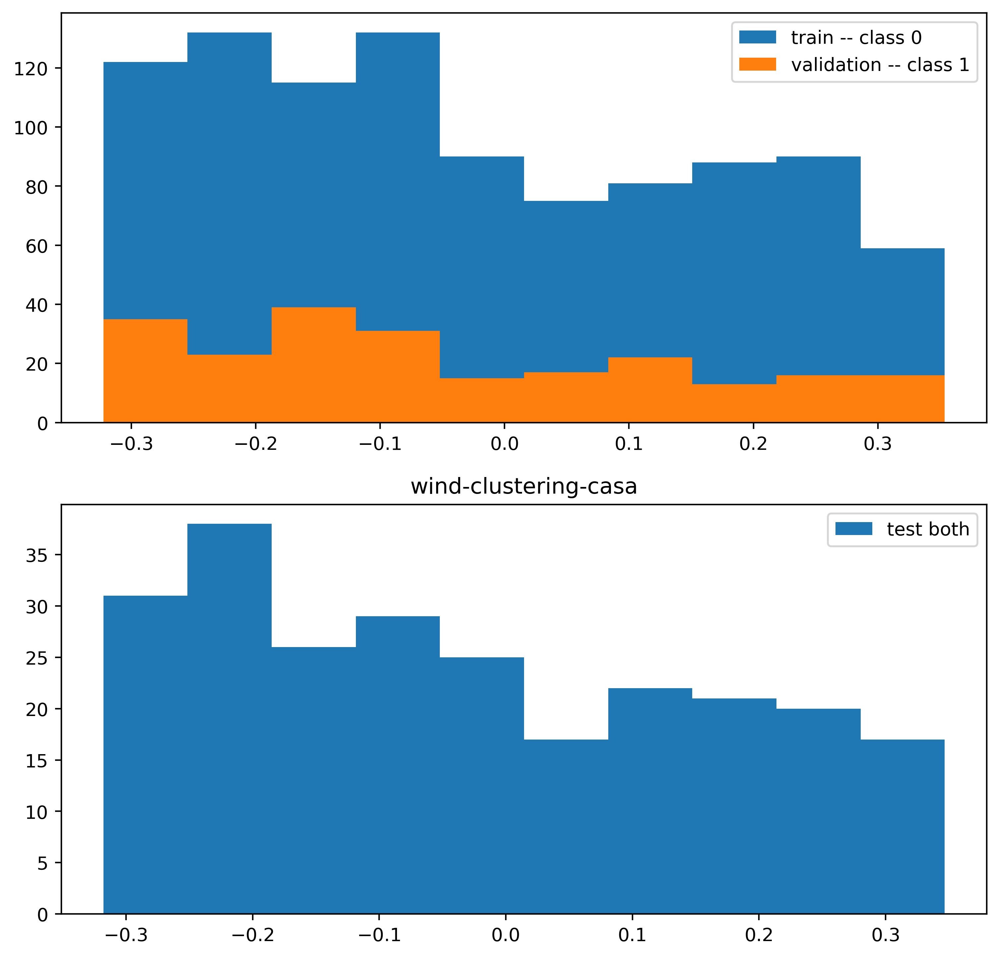

wind-clustering-casa:  83%|████████▎ | 25002/30000 [58:20<28:48,  2.89it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  84%|████████▎ | 25102/30000 [58:34<11:19,  7.21it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  84%|████████▍ | 25202/30000 [58:48<11:05,  7.21it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  84%|████████▍ | 25302/30000 [59:02<10:52,  7.20it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  85%|████████▍ | 25402/30000 [59:16<10:39,  7.18it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  85%|████████▌ | 25502/30000 [59:30<10:29,  7.14it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  85%|████████▌ | 25602/30000 [59:44<10:11,  7.19it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  86%|████████▌ | 25702/30000 [59:58<09:57,  7.20it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  86%|████████▌ | 25802/30000 [1:00:12<09:40,  7.23it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  86%|████████▋ | 25902/30000 [1:00:26<09:29,  7.20it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  87%|████████▋ | 26000/30000 [1:00:40<09:15,  7.20it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


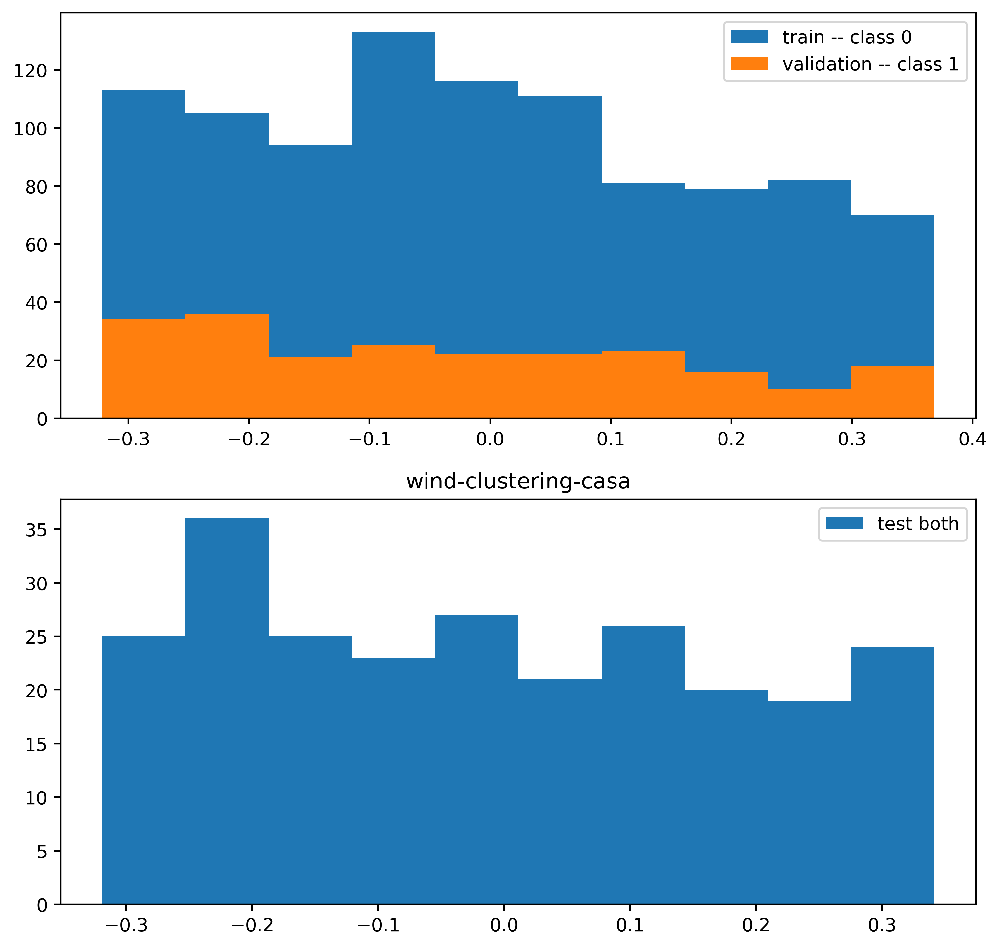

wind-clustering-casa:  87%|████████▋ | 26002/30000 [1:00:41<23:25,  2.84it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  87%|████████▋ | 26102/30000 [1:00:55<09:07,  7.13it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  87%|████████▋ | 26202/30000 [1:01:09<08:49,  7.18it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  88%|████████▊ | 26302/30000 [1:01:23<08:35,  7.17it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  88%|████████▊ | 26402/30000 [1:01:37<08:23,  7.15it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  88%|████████▊ | 26502/30000 [1:01:51<08:05,  7.21it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  89%|████████▊ | 26602/30000 [1:02:06<07:56,  7.13it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  89%|████████▉ | 26702/30000 [1:02:20<07:41,  7.15it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  89%|████████▉ | 26802/30000 [1:02:34<07:26,  7.16it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  90%|████████▉ | 26902/30000 [1:02:48<07:14,  7.13it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  90%|█████████ | 27000/30000 [1:03:01<06:58,  7.16it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


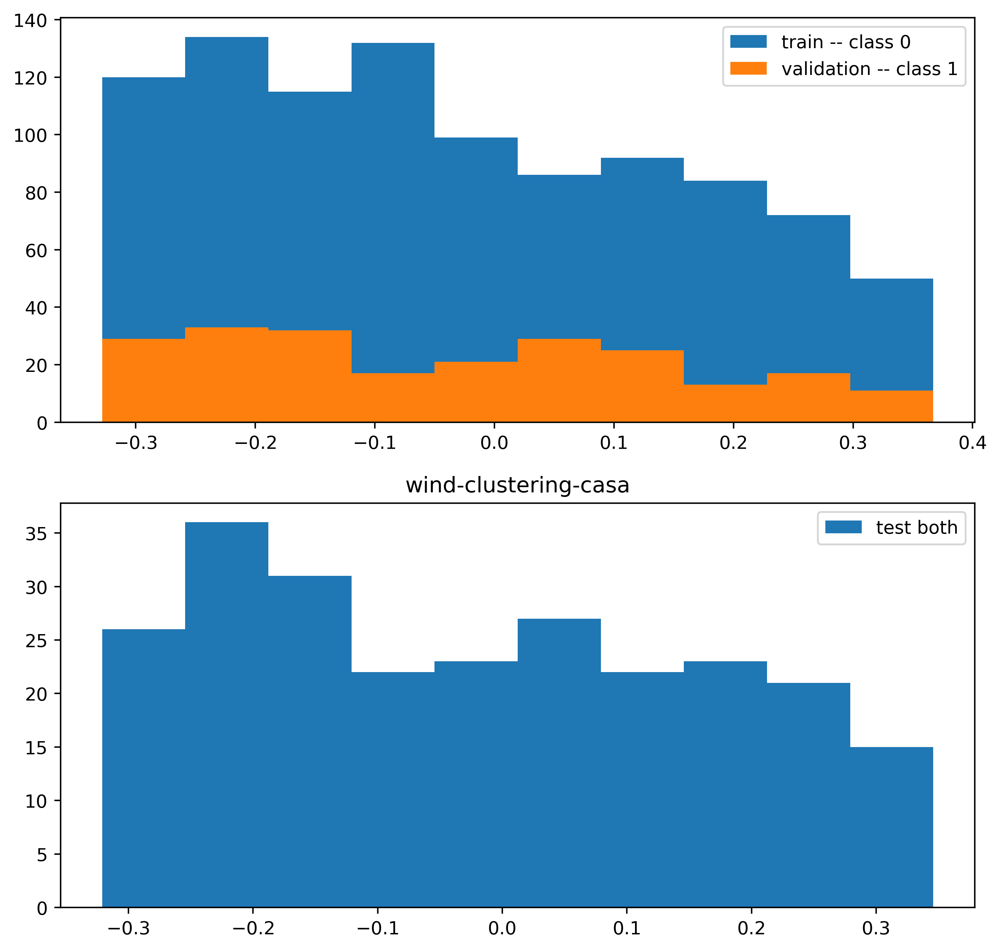

wind-clustering-casa:  90%|█████████ | 27002/30000 [1:03:03<17:37,  2.84it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  90%|█████████ | 27102/30000 [1:03:16<06:38,  7.28it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  91%|█████████ | 27202/30000 [1:03:30<06:24,  7.27it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  91%|█████████ | 27302/30000 [1:03:44<06:07,  7.34it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  91%|█████████▏| 27402/30000 [1:03:58<05:59,  7.22it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  92%|█████████▏| 27502/30000 [1:04:12<05:44,  7.24it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  92%|█████████▏| 27602/30000 [1:04:25<05:28,  7.31it/s, train_loss=-1.7, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  92%|█████████▏| 27702/30000 [1:04:40<05:18,  7.22it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  93%|█████████▎| 27802/30000 [1:04:53<05:02,  7.26it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  93%|█████████▎| 27902/30000 [1:05:07<04:49,  7.24it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  93%|█████████▎| 28000/30000 [1:05:21<04:34,  7.29it/s, train_loss=-1.72, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


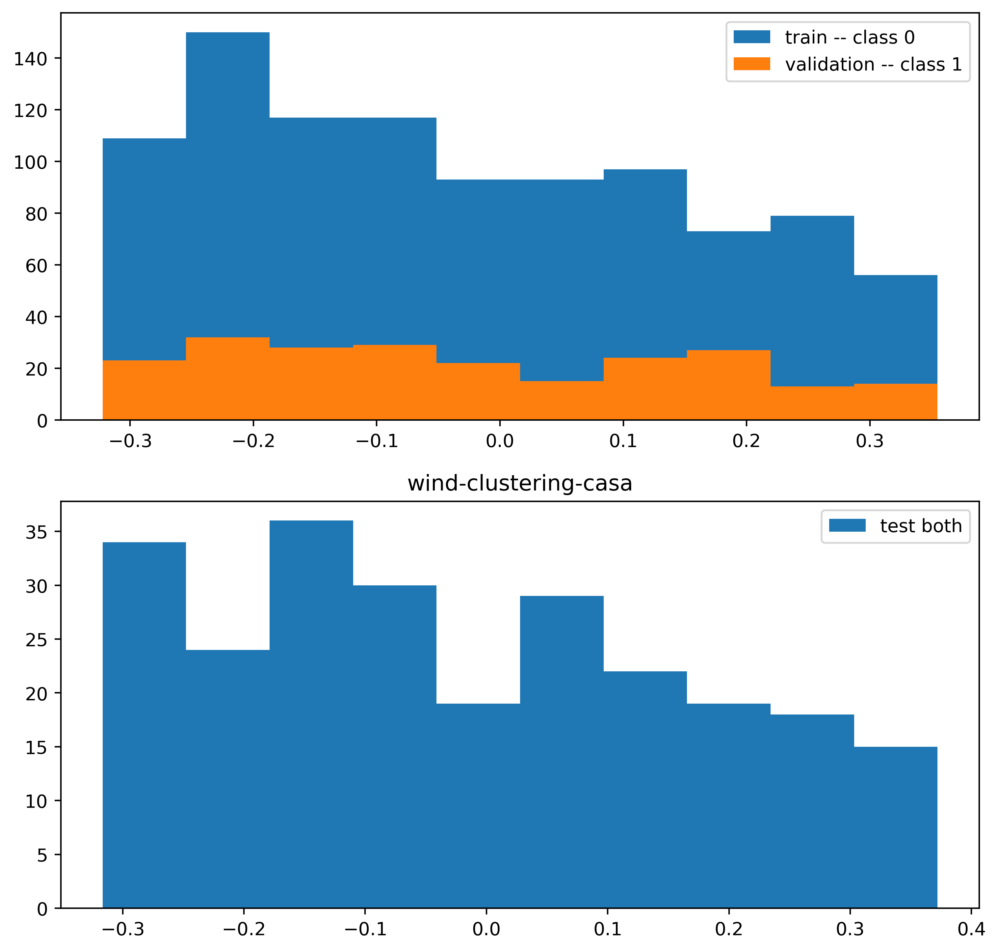

wind-clustering-casa:  93%|█████████▎| 28002/30000 [1:05:22<11:28,  2.90it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  94%|█████████▎| 28102/30000 [1:05:36<04:23,  7.20it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  94%|█████████▍| 28202/30000 [1:05:50<04:07,  7.28it/s, train_loss=-1.78, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  94%|█████████▍| 28302/30000 [1:06:04<03:58,  7.13it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  95%|█████████▍| 28402/30000 [1:06:17<03:39,  7.27it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  95%|█████████▌| 28502/30000 [1:06:31<03:25,  7.28it/s, train_loss=-1.74, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  95%|█████████▌| 28602/30000 [1:06:45<03:12,  7.25it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  96%|█████████▌| 28702/30000 [1:06:59<02:59,  7.22it/s, train_loss=-1.81, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  96%|█████████▌| 28802/30000 [1:07:13<02:44,  7.26it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  96%|█████████▋| 28902/30000 [1:07:27<02:31,  7.23it/s, train_loss=-1.79, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  97%|█████████▋| 29000/30000 [1:07:40<02:18,  7.23it/s, train_loss=-1.77, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001
984 984 984
(array([0]), array([984]))


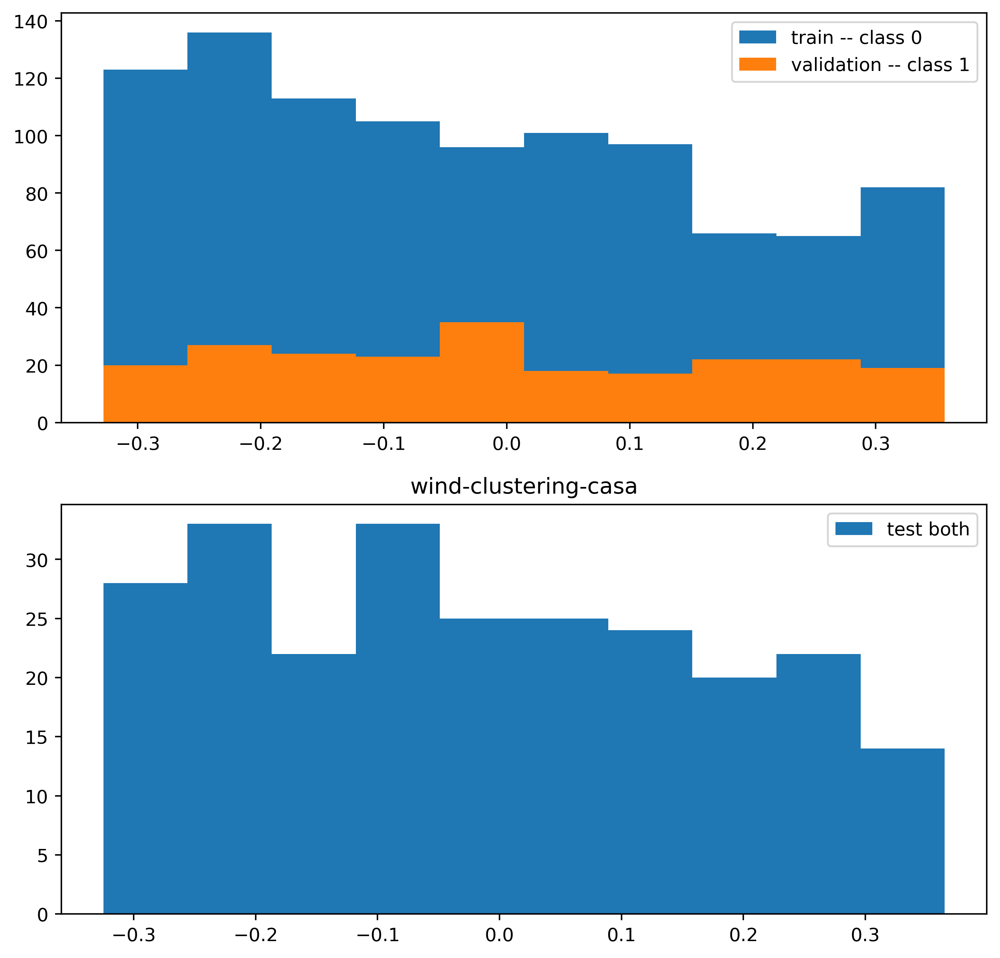

wind-clustering-casa:  97%|█████████▋| 29002/30000 [1:07:41<05:43,  2.91it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

graph level clf: wind-clustering-casa binary True test acc 0.1748 f1 0.0000 recall 0.0000 prec 0.0000 [[ 43   0]
 [203   0]] 



wind-clustering-casa:  97%|█████████▋| 29102/30000 [1:07:55<02:04,  7.22it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  97%|█████████▋| 29202/30000 [1:08:09<01:50,  7.21it/s, train_loss=-1.8, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-clustering-casa:  98%|█████████▊| 29302/30000 [1:08:23<01:36,  7.23it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  98%|█████████▊| 29402/30000 [1:08:37<01:23,  7.20it/s, train_loss=-1.75, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  98%|█████████▊| 29502/30000 [1:08:51<01:09,  7.13it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  99%|█████████▊| 29602/30000 [1:09:05<00:55,  7.24it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  99%|█████████▉| 29702/30000 [1:09:19<00:41,  7.14it/s, train_loss=-1.76, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa:  99%|█████████▉| 29802/30000 [1:09:33<00:27,  7.26it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-clustering-casa: 100%|█████████▉| 29902/30000 [1:09:47<00:14,  6.88it/s, train_loss=-1.73, train_acc=0.231, test_acc=0.175, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:   0%|          | 0/30000 [00:00<?, ?it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 1.0
951 951 951
(array([0]), array([951]))


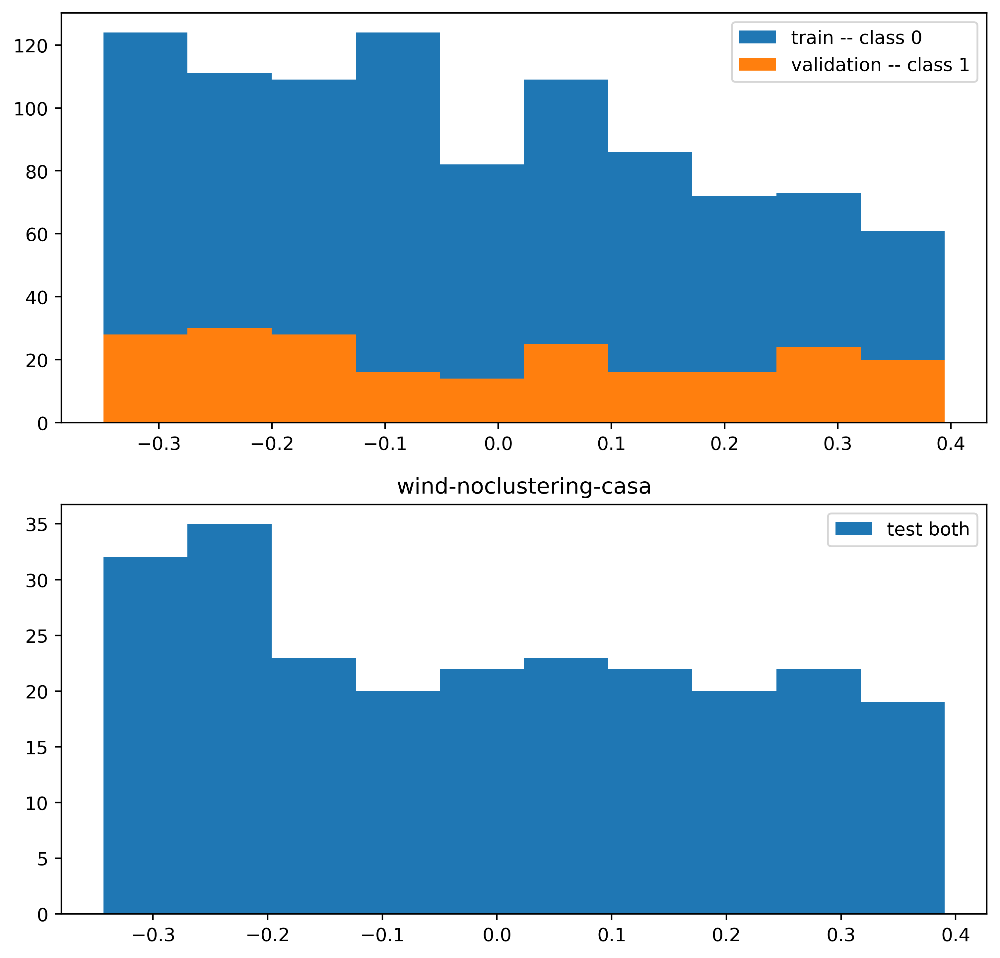

wind-noclustering-casa:   0%|          | 1/30000 [00:01<10:27:39,  1.26s/it, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:   0%|          | 102/30000 [00:18<1:27:01,  5.73it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.9801986733067553


wind-noclustering-casa:   1%|          | 202/30000 [00:36<1:26:56,  5.71it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.9417645335842486


wind-noclustering-casa:   1%|          | 302/30000 [00:53<1:26:35,  5.72it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.8869204367171575


wind-noclustering-casa:   1%|▏         | 402/30000 [01:11<1:26:16,  5.72it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.8187307530779818


wind-noclustering-casa:   2%|▏         | 502/30000 [01:28<1:25:57,  5.72it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.7408182206817178


wind-noclustering-casa:   2%|▏         | 602/30000 [01:46<1:25:17,  5.74it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.6570468198150566


wind-noclustering-casa:   2%|▏         | 702/30000 [02:04<1:25:09,  5.73it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.5712090638488148


wind-noclustering-casa:   3%|▎         | 802/30000 [02:21<1:25:03,  5.72it/s, train_loss=-1.83, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.48675225595997157


wind-noclustering-casa:   3%|▎         | 902/30000 [02:39<1:24:32,  5.74it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.40656965974059905


wind-noclustering-casa:   3%|▎         | 1000/30000 [02:56<1:27:27,  5.53it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.3328710836980795
951 951 951
(array([0]), array([951]))


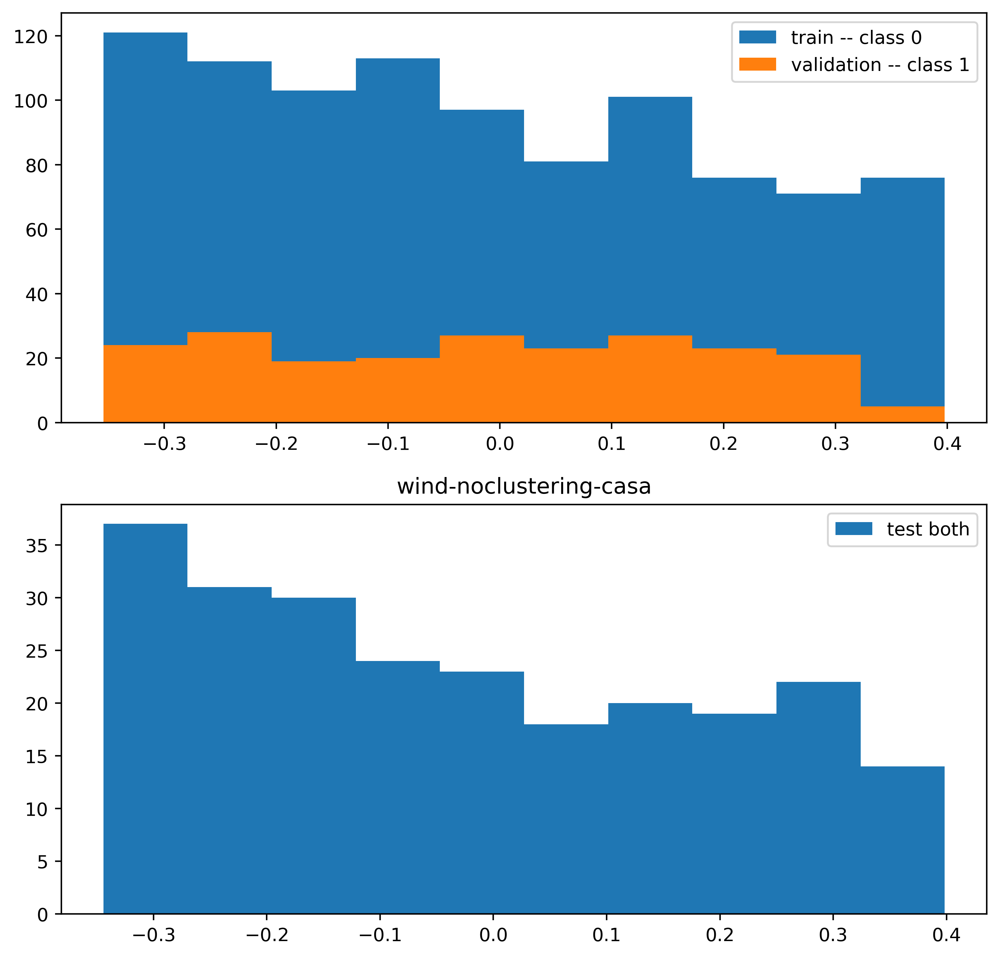

wind-noclustering-casa:   3%|▎         | 1001/30000 [02:57<3:47:49,  2.12it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:   4%|▎         | 1102/30000 [03:15<1:24:36,  5.69it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.26713530196585034


wind-noclustering-casa:   4%|▍         | 1202/30000 [03:33<1:23:53,  5.72it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.2101360712007647


wind-noclustering-casa:   4%|▍         | 1302/30000 [03:50<1:23:48,  5.71it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.16202575093388072


wind-noclustering-casa:   5%|▍         | 1402/30000 [04:08<1:23:09,  5.73it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.12245642825298188


wind-noclustering-casa:   5%|▌         | 1502/30000 [04:25<1:23:18,  5.70it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.09071795328941248


wind-noclustering-casa:   5%|▌         | 1602/30000 [04:43<1:23:17,  5.68it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.06587475442640295


wind-noclustering-casa:   6%|▌         | 1702/30000 [05:01<1:22:46,  5.70it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.04688769521998848


wind-noclustering-casa:   6%|▌         | 1802/30000 [05:19<1:22:45,  5.68it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.032712434939019805


wind-noclustering-casa:   6%|▋         | 1902/30000 [05:36<1:22:20,  5.69it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.022370771856165587


wind-noclustering-casa:   7%|▋         | 2000/30000 [05:54<1:22:05,  5.68it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.014995576820477701
951 951 951
(array([0]), array([951]))


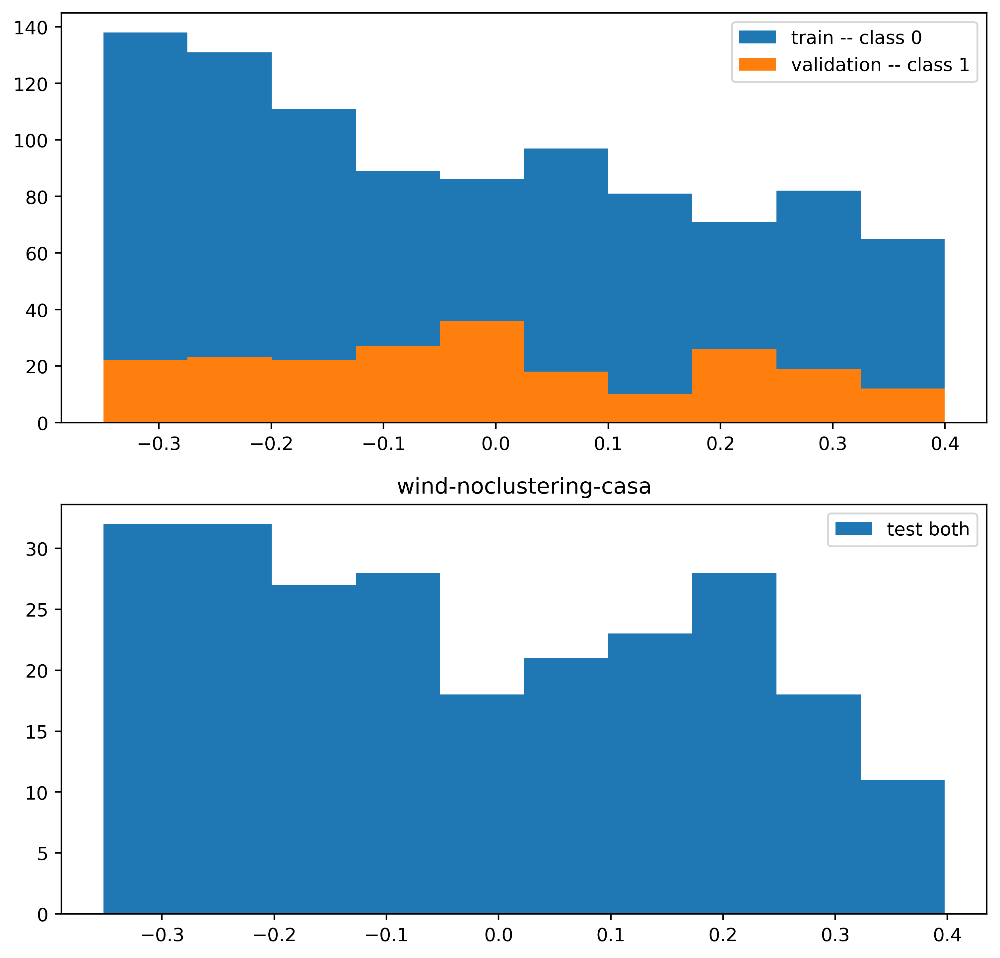

wind-noclustering-casa:   7%|▋         | 2001/30000 [05:55<3:39:01,  2.13it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:   7%|▋         | 2102/30000 [06:13<1:21:36,  5.70it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.009852796061187254


wind-noclustering-casa:   7%|▋         | 2202/30000 [06:30<1:20:38,  5.74it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.006345559512909111


wind-noclustering-casa:   8%|▊         | 2302/30000 [06:48<1:20:39,  5.72it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.004005847942090417


wind-noclustering-casa:   8%|▊         | 2402/30000 [07:05<1:20:15,  5.73it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.002478752176666357


wind-noclustering-casa:   8%|▊         | 2502/30000 [07:23<1:21:00,  5.66it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.0015034391929775717


wind-noclustering-casa:   9%|▊         | 2602/30000 [07:41<1:20:01,  5.71it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:   9%|▉         | 2702/30000 [07:58<1:19:56,  5.69it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:   9%|▉         | 2802/30000 [08:16<1:19:17,  5.72it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  10%|▉         | 2902/30000 [08:33<1:18:48,  5.73it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  10%|█         | 3000/30000 [08:51<1:18:43,  5.72it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


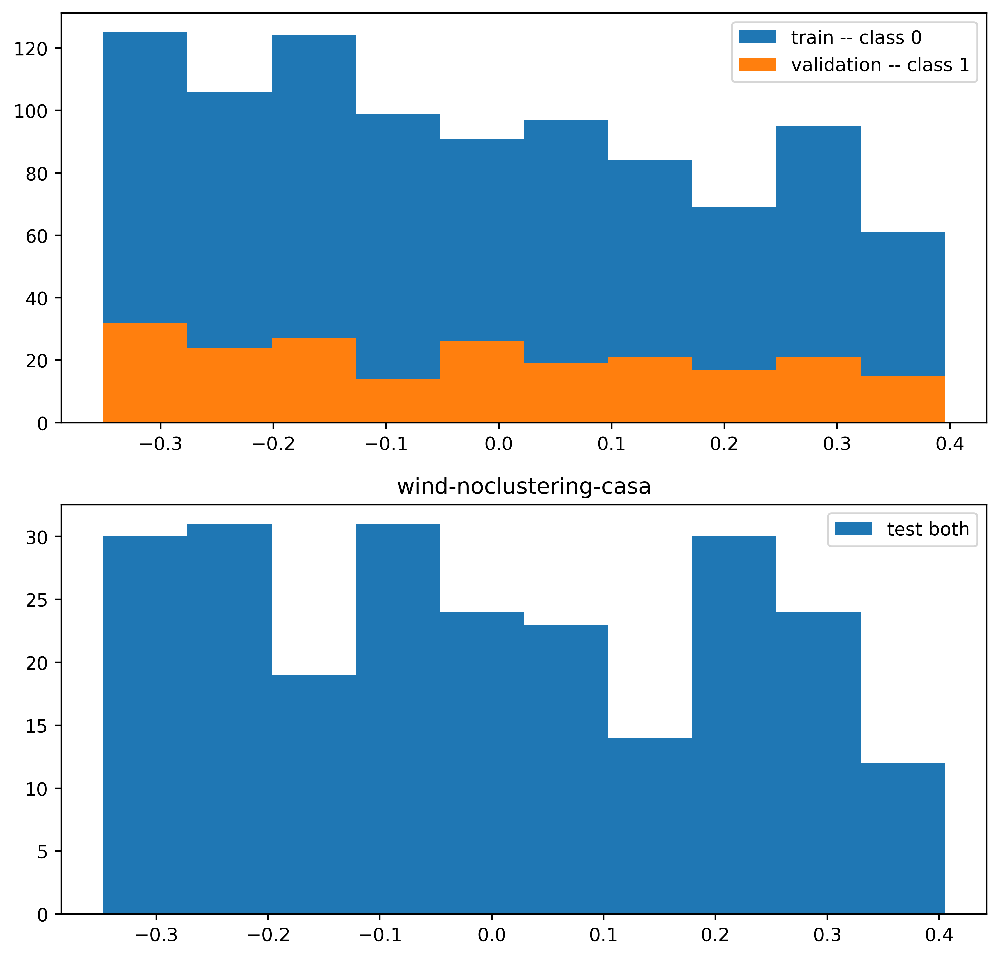

wind-noclustering-casa:  10%|█         | 3002/30000 [08:52<2:54:30,  2.58it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  10%|█         | 3102/30000 [09:10<1:18:06,  5.74it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  11%|█         | 3202/30000 [09:27<1:17:46,  5.74it/s, train_loss=-1.71, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  11%|█         | 3302/30000 [09:45<1:17:28,  5.74it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  11%|█▏        | 3402/30000 [10:02<1:17:10,  5.74it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  12%|█▏        | 3502/30000 [10:20<1:17:10,  5.72it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  12%|█▏        | 3602/30000 [10:37<1:16:43,  5.73it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  12%|█▏        | 3702/30000 [10:55<1:16:39,  5.72it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  13%|█▎        | 3802/30000 [11:12<1:15:45,  5.76it/s, train_loss=-1.7, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  13%|█▎        | 3902/30000 [11:30<1:16:14,  5.71it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  13%|█▎        | 4000/30000 [11:47<1:15:12,  5.76it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


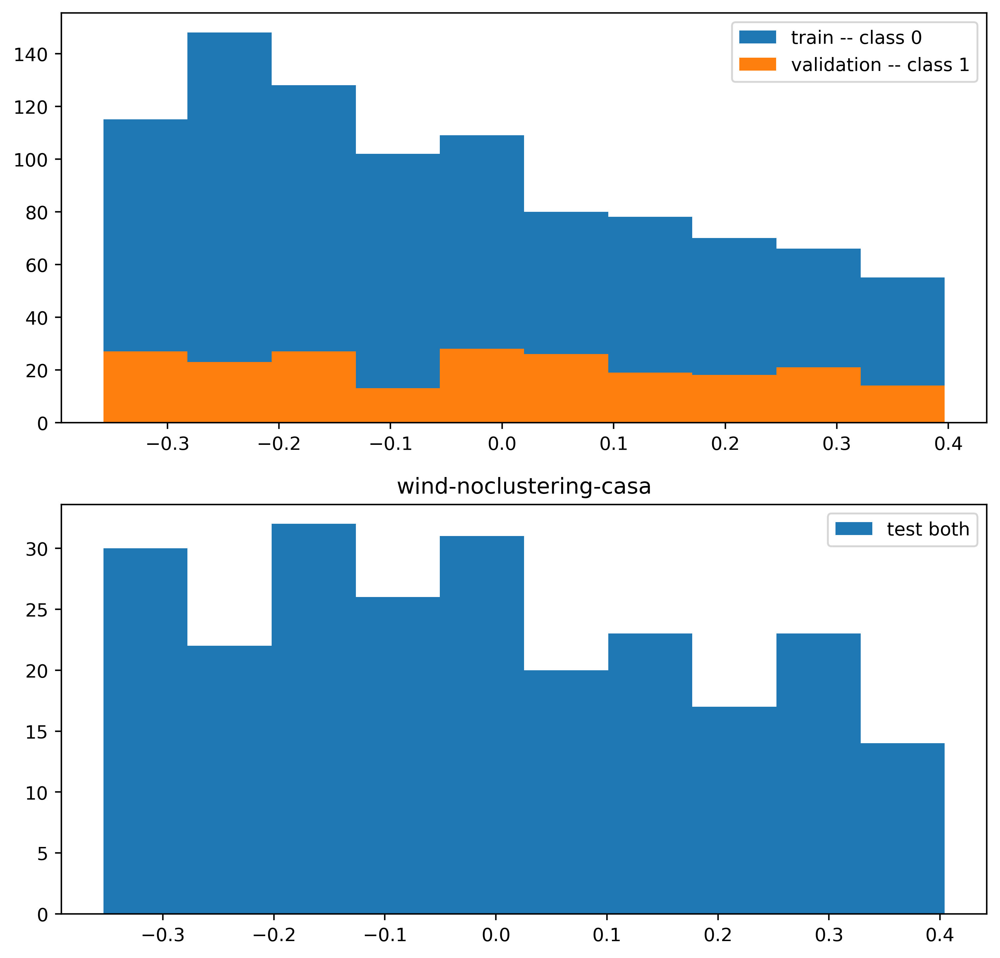

wind-noclustering-casa:  13%|█▎        | 4001/30000 [11:48<3:24:00,  2.12it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  14%|█▎        | 4102/30000 [12:06<1:15:44,  5.70it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  14%|█▍        | 4202/30000 [12:24<1:14:56,  5.74it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  14%|█▍        | 4302/30000 [12:41<1:14:29,  5.75it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  15%|█▍        | 4402/30000 [12:59<1:14:09,  5.75it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  15%|█▌        | 4502/30000 [13:16<1:13:51,  5.75it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  15%|█▌        | 4602/30000 [13:34<1:13:36,  5.75it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  16%|█▌        | 4702/30000 [13:51<1:13:20,  5.75it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  16%|█▌        | 4802/30000 [14:09<1:13:26,  5.72it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  16%|█▋        | 4902/30000 [14:26<1:12:35,  5.76it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  17%|█▋        | 5000/30000 [14:44<1:12:23,  5.76it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


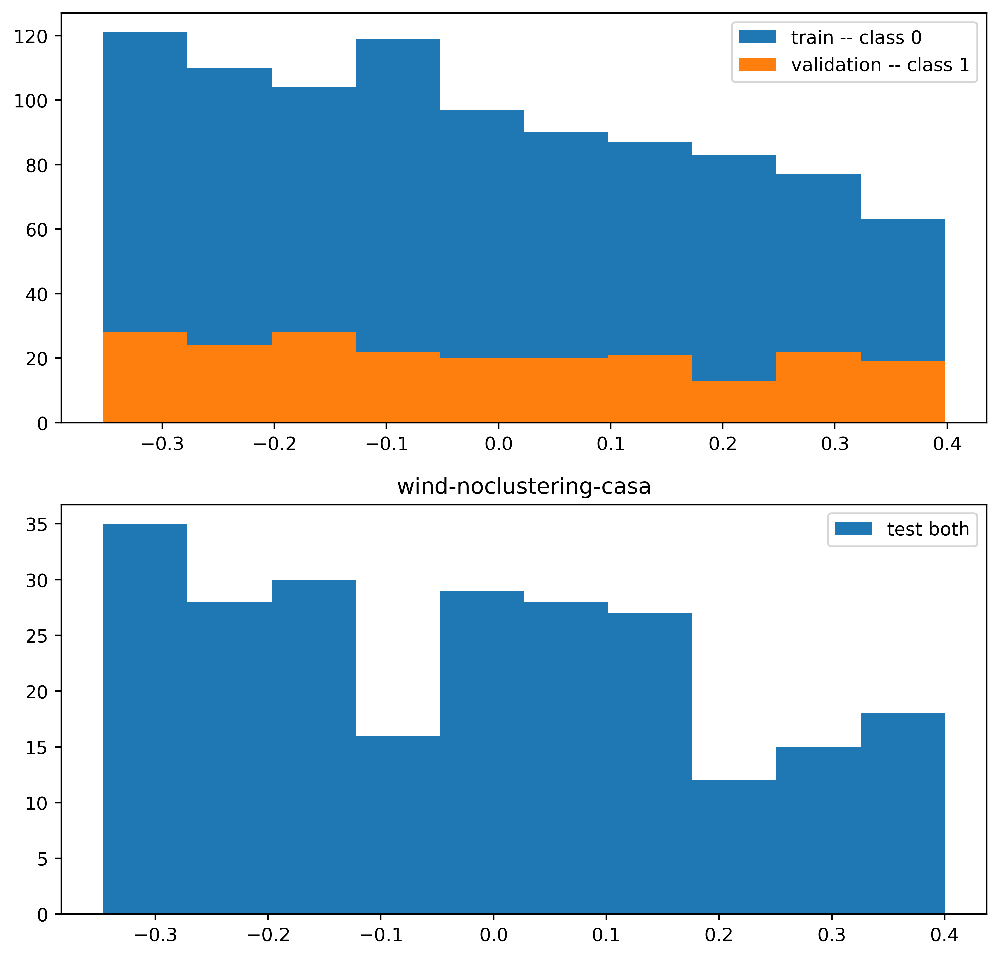

wind-noclustering-casa:  17%|█▋        | 5001/30000 [14:45<3:13:35,  2.15it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  17%|█▋        | 5102/30000 [15:02<1:12:28,  5.73it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  17%|█▋        | 5202/30000 [15:20<1:12:14,  5.72it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  18%|█▊        | 5302/30000 [15:37<1:12:31,  5.68it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  18%|█▊        | 5402/30000 [15:55<1:11:14,  5.76it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  18%|█▊        | 5502/30000 [16:12<1:10:51,  5.76it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  19%|█▊        | 5602/30000 [16:30<1:11:09,  5.71it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  19%|█▉        | 5702/30000 [16:48<1:10:38,  5.73it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  19%|█▉        | 5802/30000 [17:05<1:10:23,  5.73it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  20%|█▉        | 5902/30000 [17:23<1:11:57,  5.58it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  20%|██        | 6000/30000 [17:40<1:09:59,  5.72it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


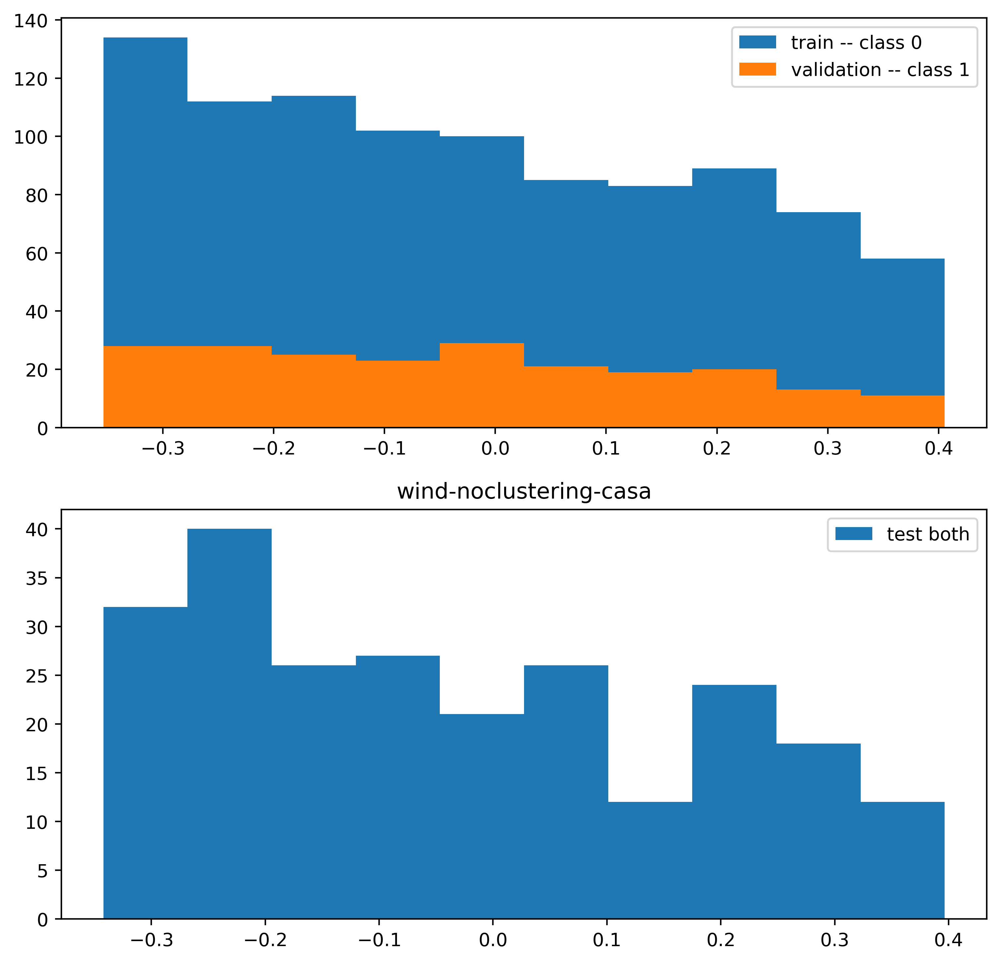

wind-noclustering-casa:  20%|██        | 6001/30000 [17:41<3:08:58,  2.12it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  20%|██        | 6102/30000 [17:59<1:11:15,  5.59it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  21%|██        | 6202/30000 [18:16<1:09:20,  5.72it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  21%|██        | 6302/30000 [18:34<1:08:27,  5.77it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  21%|██▏       | 6402/30000 [18:51<1:08:32,  5.74it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  22%|██▏       | 6502/30000 [19:09<1:08:15,  5.74it/s, train_loss=-1.71, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  22%|██▏       | 6602/30000 [19:26<1:07:55,  5.74it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  22%|██▏       | 6702/30000 [19:44<1:07:42,  5.73it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  23%|██▎       | 6802/30000 [20:01<1:07:10,  5.76it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  23%|██▎       | 6902/30000 [20:19<1:07:10,  5.73it/s, train_loss=-1.83, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  23%|██▎       | 7000/30000 [20:36<1:07:06,  5.71it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


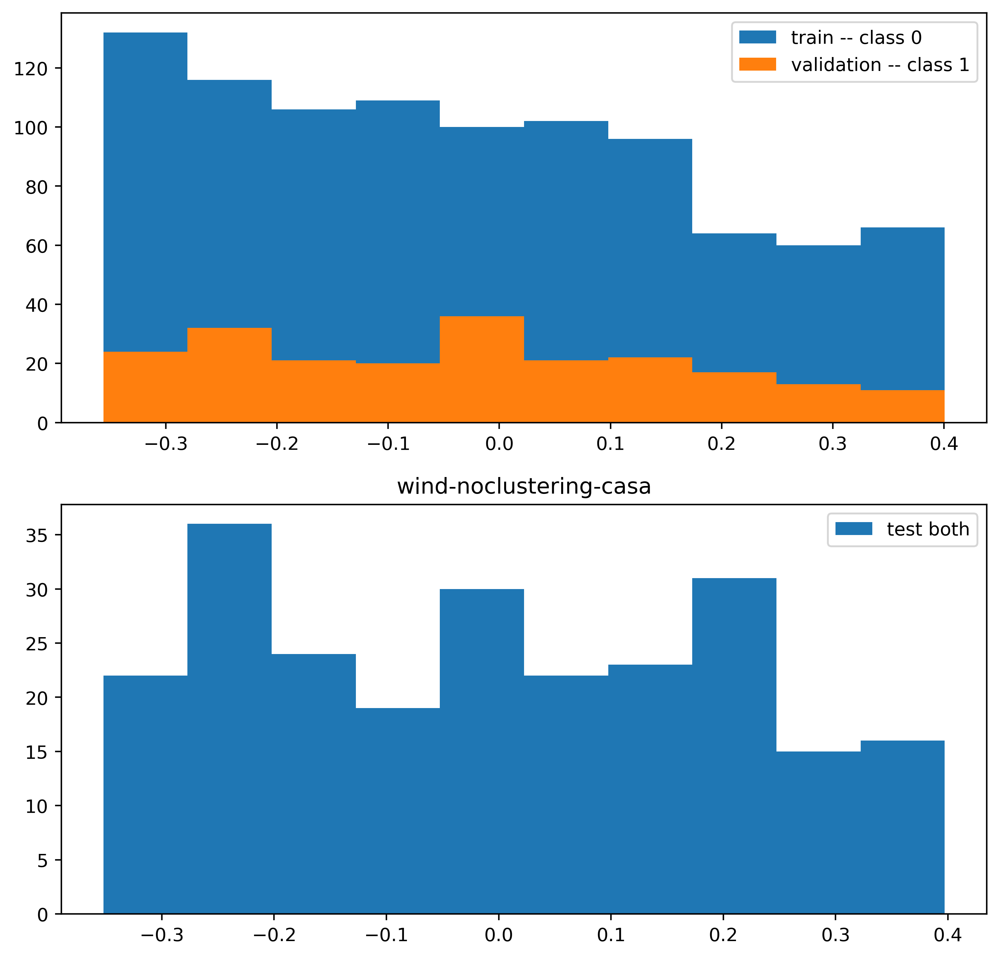

wind-noclustering-casa:  23%|██▎       | 7001/30000 [20:37<2:59:41,  2.13it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  24%|██▎       | 7102/30000 [20:55<1:07:00,  5.70it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  24%|██▍       | 7202/30000 [21:12<1:06:12,  5.74it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  24%|██▍       | 7302/30000 [21:30<1:05:40,  5.76it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  25%|██▍       | 7402/30000 [21:47<1:05:38,  5.74it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  25%|██▌       | 7502/30000 [22:05<1:05:01,  5.77it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  25%|██▌       | 7602/30000 [22:22<1:05:21,  5.71it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  26%|██▌       | 7702/30000 [22:40<1:04:49,  5.73it/s, train_loss=-1.67, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  26%|██▌       | 7802/30000 [22:57<1:04:24,  5.74it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  26%|██▋       | 7902/30000 [23:15<1:03:50,  5.77it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  27%|██▋       | 8000/30000 [23:32<1:03:59,  5.73it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


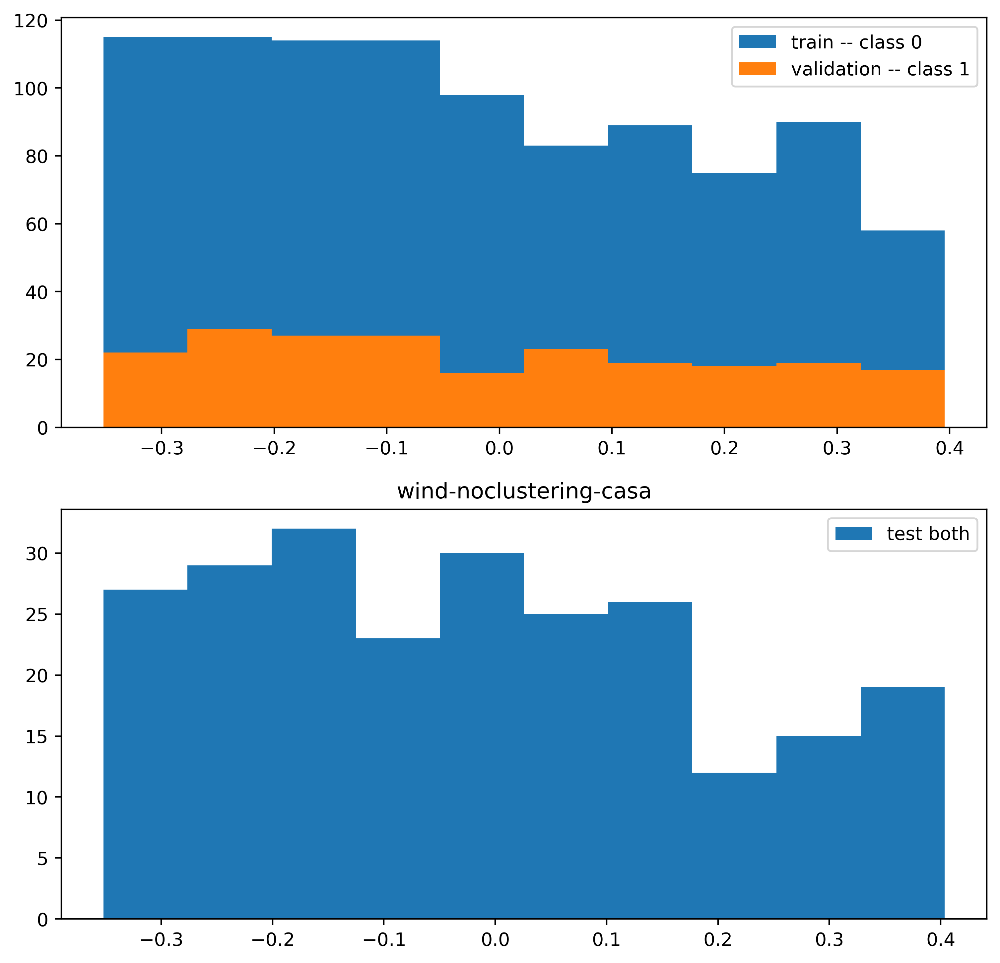

wind-noclustering-casa:  27%|██▋       | 8001/30000 [23:33<2:50:04,  2.16it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  27%|██▋       | 8102/30000 [23:51<1:03:33,  5.74it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  27%|██▋       | 8202/30000 [24:08<1:03:30,  5.72it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  28%|██▊       | 8302/30000 [24:26<1:03:23,  5.71it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  28%|██▊       | 8402/30000 [24:44<1:03:05,  5.71it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  28%|██▊       | 8502/30000 [25:01<1:02:20,  5.75it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  29%|██▊       | 8602/30000 [25:19<1:02:16,  5.73it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  29%|██▉       | 8702/30000 [25:36<1:02:13,  5.70it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  29%|██▉       | 8802/30000 [25:54<1:01:39,  5.73it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  30%|██▉       | 8902/30000 [26:11<1:01:19,  5.73it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  30%|███       | 9000/30000 [26:29<1:01:06,  5.73it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


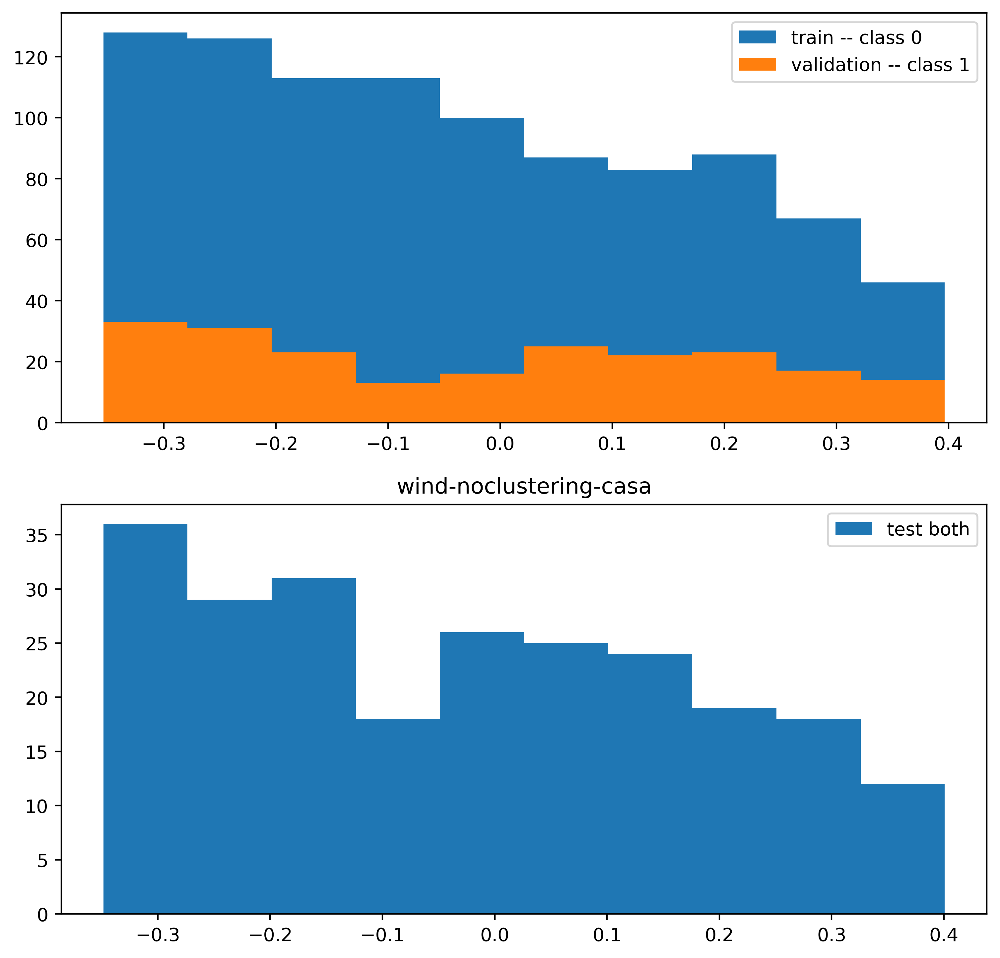

wind-noclustering-casa:  30%|███       | 9001/30000 [26:30<2:42:31,  2.15it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  30%|███       | 9102/30000 [26:47<1:00:41,  5.74it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  31%|███       | 9202/30000 [27:05<1:00:36,  5.72it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  31%|███       | 9302/30000 [27:22<1:01:03,  5.65it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  31%|███▏      | 9402/30000 [27:40<1:00:05,  5.71it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  32%|███▏      | 9502/30000 [27:58<59:53,  5.70it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  32%|███▏      | 9602/30000 [28:15<59:26,  5.72it/s, train_loss=-1.71, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  32%|███▏      | 9702/30000 [28:33<59:48,  5.66it/s, train_loss=-1.85, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  33%|███▎      | 9802/30000 [28:51<58:57,  5.71it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  33%|███▎      | 9902/30000 [29:08<58:48,  5.70it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  33%|███▎      | 10000/30000 [29:26<58:24,  5.71it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


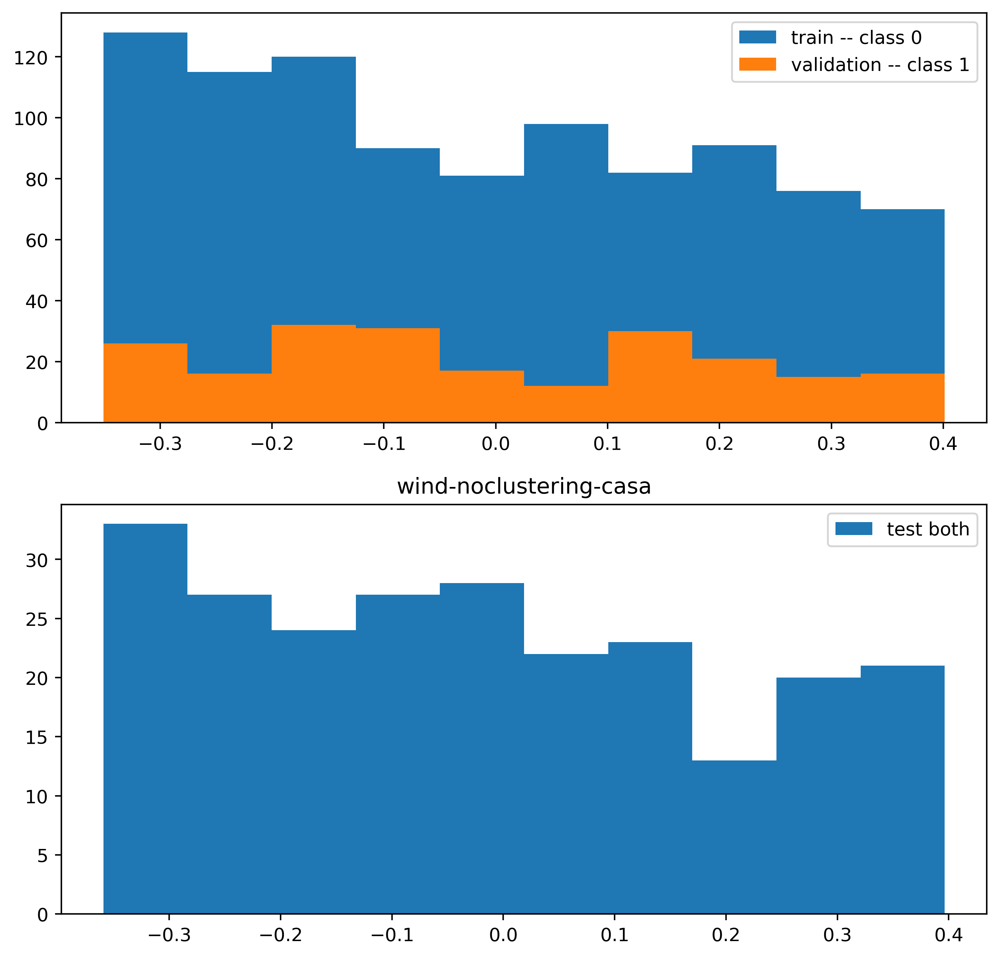

wind-noclustering-casa:  33%|███▎      | 10001/30000 [29:27<2:36:33,  2.13it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  34%|███▎      | 10102/30000 [29:44<58:06,  5.71it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  34%|███▍      | 10202/30000 [30:02<57:50,  5.70it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  34%|███▍      | 10302/30000 [30:19<57:13,  5.74it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  35%|███▍      | 10402/30000 [30:37<57:05,  5.72it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  35%|███▌      | 10502/30000 [30:55<56:36,  5.74it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]   

New Model Temperature: 0.001


wind-noclustering-casa:  35%|███▌      | 10602/30000 [31:12<56:41,  5.70it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  36%|███▌      | 10702/30000 [31:30<56:10,  5.73it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  36%|███▌      | 10802/30000 [31:47<55:55,  5.72it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  36%|███▋      | 10902/30000 [32:05<55:38,  5.72it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  37%|███▋      | 11000/30000 [32:22<55:15,  5.73it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


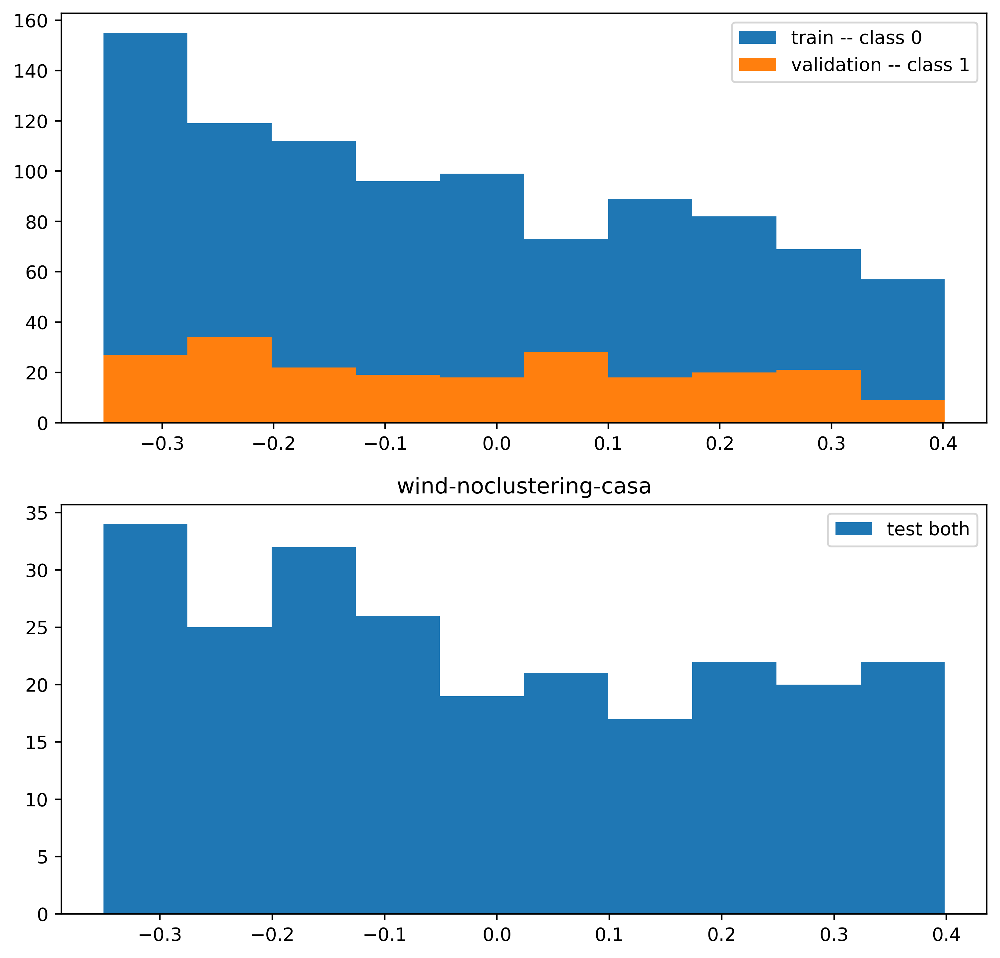

wind-noclustering-casa:  37%|███▋      | 11001/30000 [32:23<2:29:51,  2.11it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  37%|███▋      | 11102/30000 [32:41<54:58,  5.73it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  37%|███▋      | 11202/30000 [32:59<55:26,  5.65it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  38%|███▊      | 11302/30000 [33:16<54:27,  5.72it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  38%|███▊      | 11402/30000 [33:34<53:51,  5.76it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  38%|███▊      | 11502/30000 [33:51<54:02,  5.71it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  39%|███▊      | 11602/30000 [34:09<53:33,  5.73it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  39%|███▉      | 11702/30000 [34:26<53:13,  5.73it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  39%|███▉      | 11802/30000 [34:44<52:50,  5.74it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  40%|███▉      | 11902/30000 [35:01<52:59,  5.69it/s, train_loss=-1.69, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  40%|████      | 12000/30000 [35:19<52:15,  5.74it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


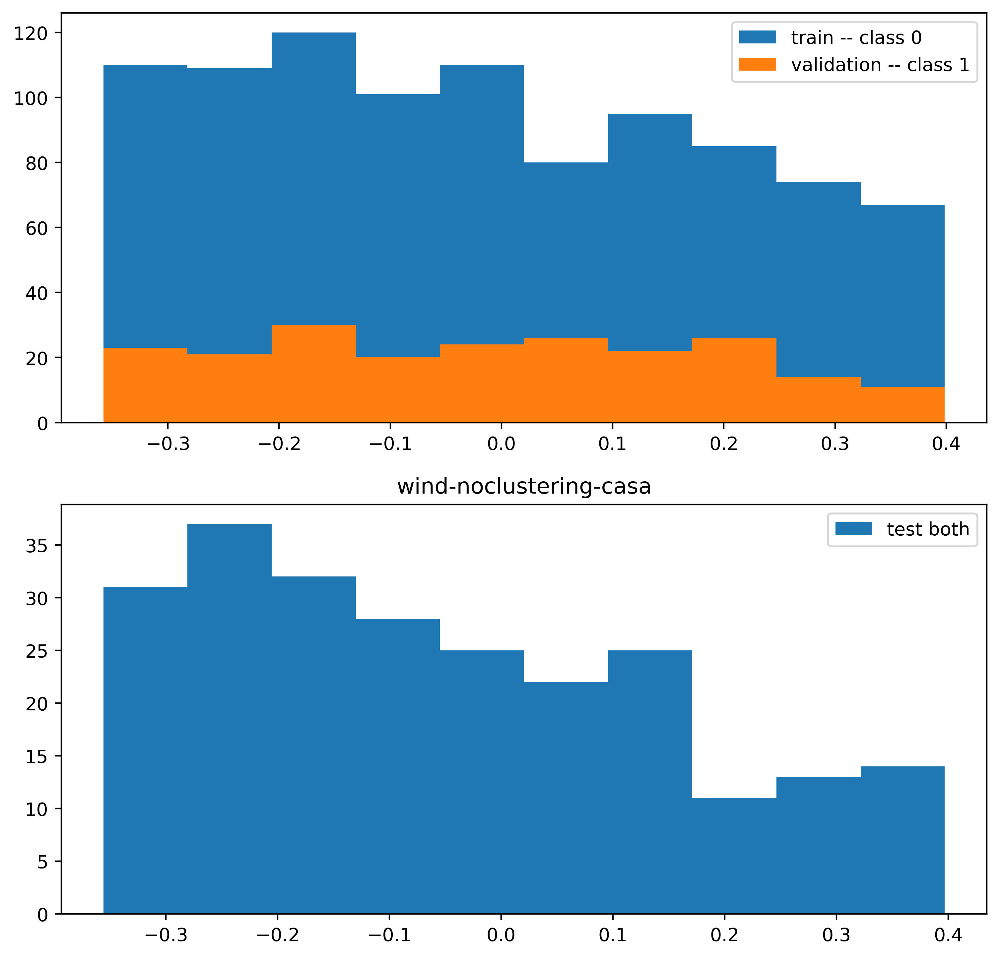

wind-noclustering-casa:  40%|████      | 12001/30000 [35:20<2:18:57,  2.16it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  40%|████      | 12102/30000 [35:37<51:42,  5.77it/s, train_loss=-1.71, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  41%|████      | 12202/30000 [35:55<51:32,  5.76it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  41%|████      | 12302/30000 [36:12<51:33,  5.72it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  41%|████▏     | 12402/30000 [36:30<51:23,  5.71it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  42%|████▏     | 12502/30000 [36:48<50:51,  5.73it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  42%|████▏     | 12602/30000 [37:05<50:42,  5.72it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  42%|████▏     | 12702/30000 [37:23<50:31,  5.71it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  43%|████▎     | 12802/30000 [37:40<50:12,  5.71it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  43%|████▎     | 12902/30000 [37:58<50:03,  5.69it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  43%|████▎     | 13000/30000 [38:16<49:35,  5.71it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


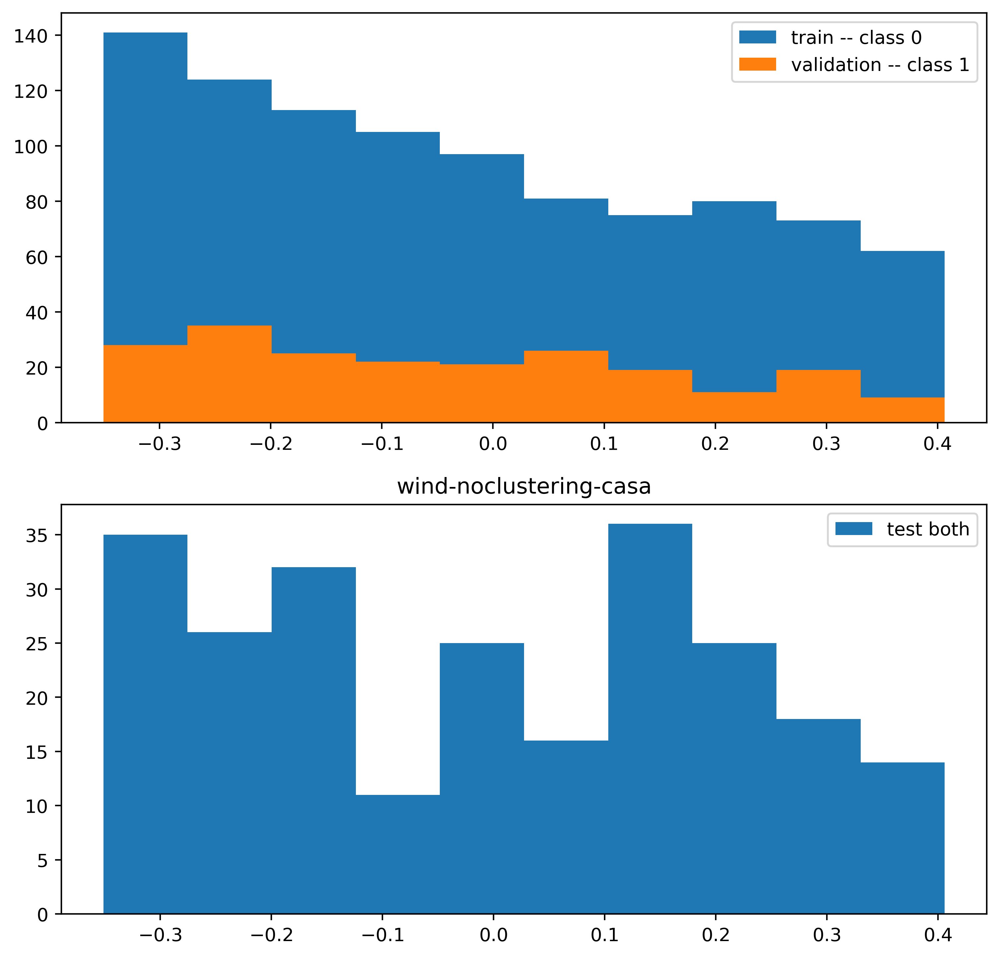

wind-noclustering-casa:  43%|████▎     | 13001/30000 [38:17<2:13:53,  2.12it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  44%|████▎     | 13102/30000 [38:34<48:58,  5.75it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  44%|████▍     | 13202/30000 [38:52<48:48,  5.74it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  44%|████▍     | 13302/30000 [39:09<48:21,  5.76it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  45%|████▍     | 13402/30000 [39:27<48:13,  5.74it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  45%|████▌     | 13502/30000 [39:45<47:50,  5.75it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  45%|████▌     | 13602/30000 [40:02<47:46,  5.72it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  46%|████▌     | 13702/30000 [40:20<47:22,  5.73it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  46%|████▌     | 13802/30000 [40:37<47:00,  5.74it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  46%|████▋     | 13902/30000 [40:55<46:43,  5.74it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  47%|████▋     | 14000/30000 [41:12<46:28,  5.74it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


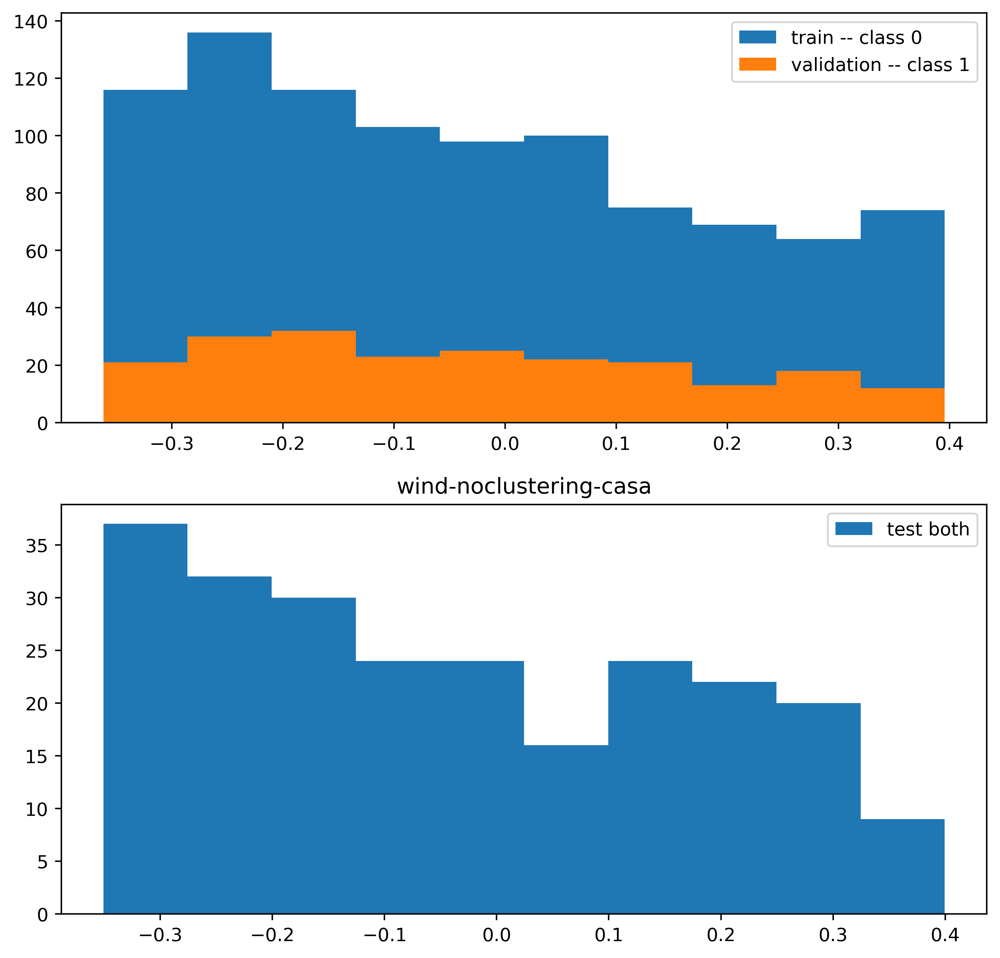

wind-noclustering-casa:  47%|████▋     | 14002/30000 [41:13<1:43:45,  2.57it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  47%|████▋     | 14102/30000 [41:31<46:19,  5.72it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  47%|████▋     | 14202/30000 [41:48<45:42,  5.76it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  48%|████▊     | 14302/30000 [42:06<46:09,  5.67it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  48%|████▊     | 14402/30000 [42:23<45:07,  5.76it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  48%|████▊     | 14502/30000 [42:41<45:00,  5.74it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  49%|████▊     | 14602/30000 [42:58<44:37,  5.75it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  49%|████▉     | 14702/30000 [43:16<44:25,  5.74it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  49%|████▉     | 14802/30000 [43:33<43:58,  5.76it/s, train_loss=-1.71, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  50%|████▉     | 14902/30000 [43:51<43:45,  5.75it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  50%|█████     | 15000/30000 [44:08<43:33,  5.74it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


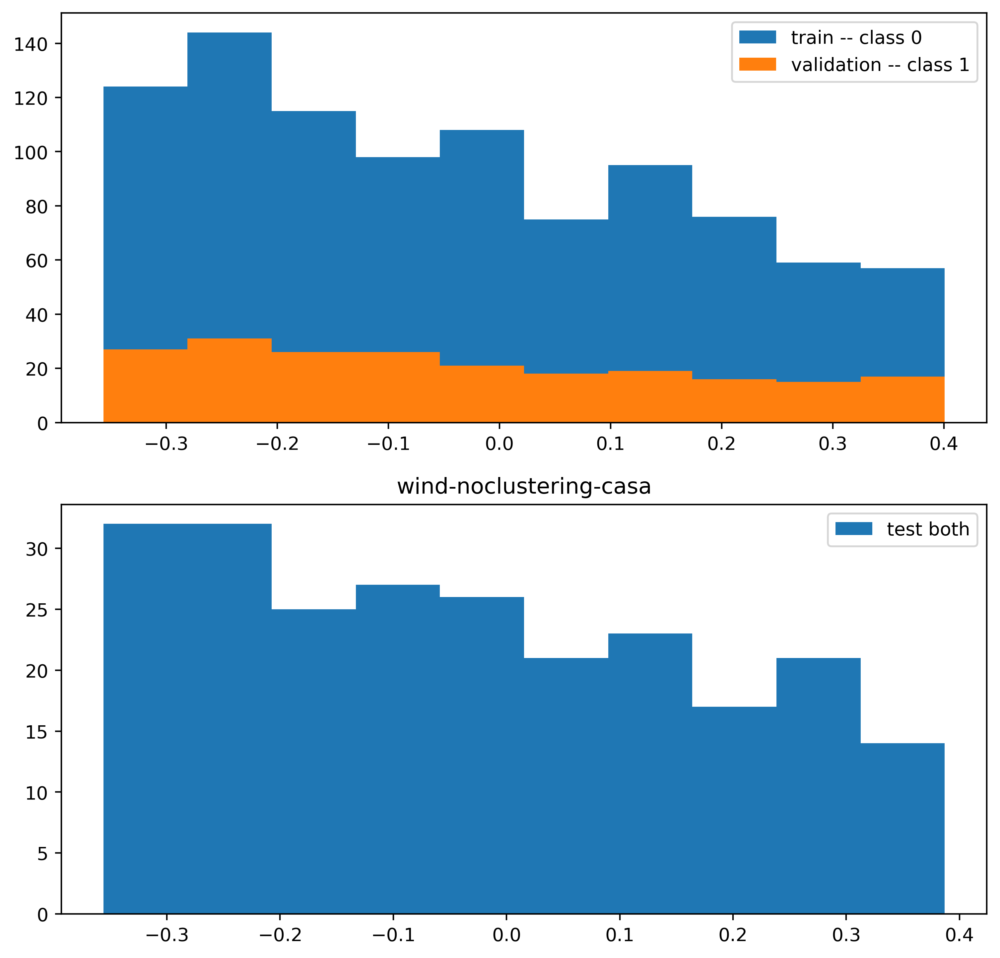

wind-noclustering-casa:  50%|█████     | 15001/30000 [44:09<1:59:32,  2.09it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  50%|█████     | 15102/30000 [44:27<43:58,  5.65it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  51%|█████     | 15202/30000 [44:45<43:35,  5.66it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  51%|█████     | 15302/30000 [45:03<43:24,  5.64it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  51%|█████▏    | 15402/30000 [45:21<42:53,  5.67it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  52%|█████▏    | 15502/30000 [45:39<44:04,  5.48it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  52%|█████▏    | 15602/30000 [45:57<42:45,  5.61it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  52%|█████▏    | 15702/30000 [46:15<42:23,  5.62it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  53%|█████▎    | 15802/30000 [46:33<42:26,  5.57it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  53%|█████▎    | 15902/30000 [46:50<41:50,  5.61it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  53%|█████▎    | 16000/30000 [47:08<41:32,  5.62it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


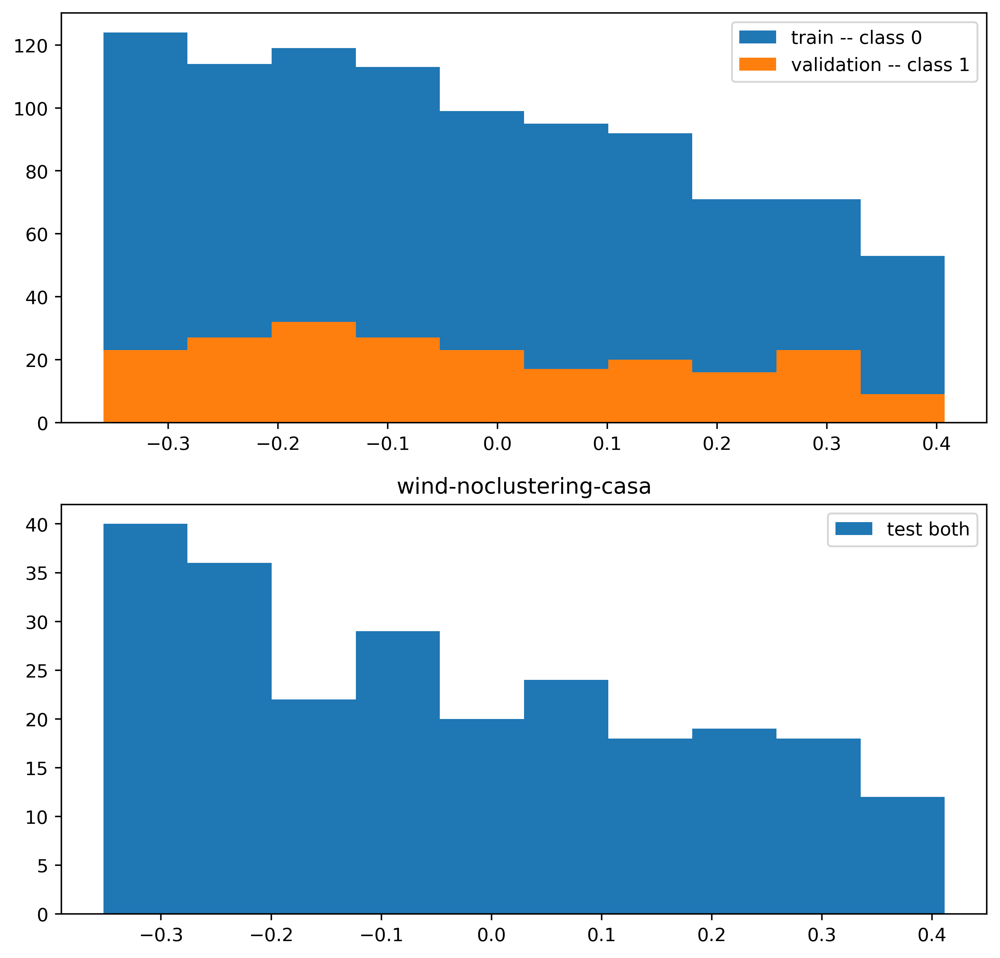

wind-noclustering-casa:  53%|█████▎    | 16001/30000 [47:09<1:49:50,  2.12it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  54%|█████▎    | 16102/30000 [47:27<41:05,  5.64it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  54%|█████▍    | 16202/30000 [47:45<40:54,  5.62it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  54%|█████▍    | 16302/30000 [48:03<40:43,  5.60it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  55%|█████▍    | 16402/30000 [48:21<40:11,  5.64it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  55%|█████▌    | 16502/30000 [48:39<40:02,  5.62it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  55%|█████▌    | 16602/30000 [48:57<39:43,  5.62it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  56%|█████▌    | 16702/30000 [49:15<39:29,  5.61it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  56%|█████▌    | 16802/30000 [49:33<38:59,  5.64it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  56%|█████▋    | 16902/30000 [49:50<39:03,  5.59it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  57%|█████▋    | 17000/30000 [50:08<38:37,  5.61it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


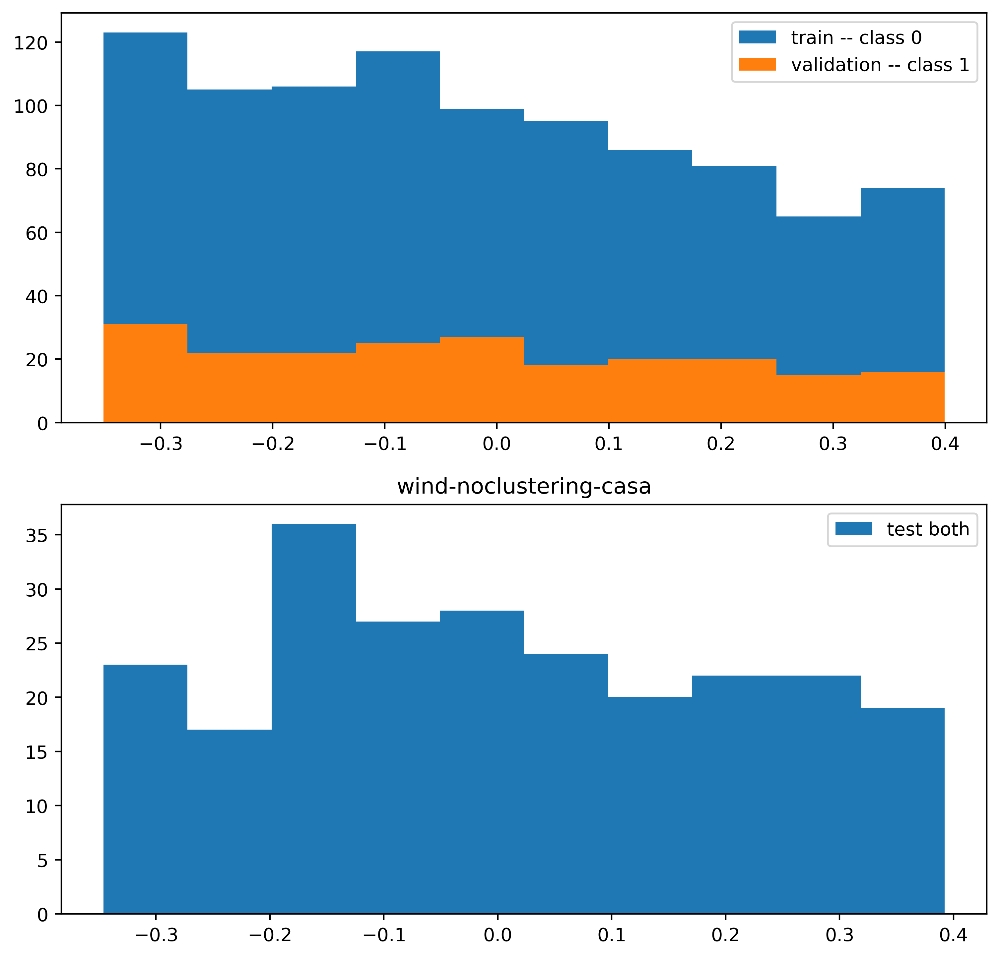

wind-noclustering-casa:  57%|█████▋    | 17001/30000 [50:09<1:41:41,  2.13it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  57%|█████▋    | 17102/30000 [50:27<38:54,  5.52it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  57%|█████▋    | 17202/30000 [50:45<38:15,  5.58it/s, train_loss=-1.83, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  58%|█████▊    | 17302/30000 [51:03<38:01,  5.57it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  58%|█████▊    | 17402/30000 [51:21<37:38,  5.58it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  58%|█████▊    | 17502/30000 [51:39<37:19,  5.58it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  59%|█████▊    | 17602/30000 [51:57<36:58,  5.59it/s, train_loss=-1.71, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  59%|█████▉    | 17702/30000 [52:15<36:45,  5.58it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  59%|█████▉    | 17802/30000 [52:33<36:25,  5.58it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  60%|█████▉    | 17902/30000 [52:51<36:01,  5.60it/s, train_loss=-1.84, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  60%|██████    | 18000/30000 [53:09<35:45,  5.59it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


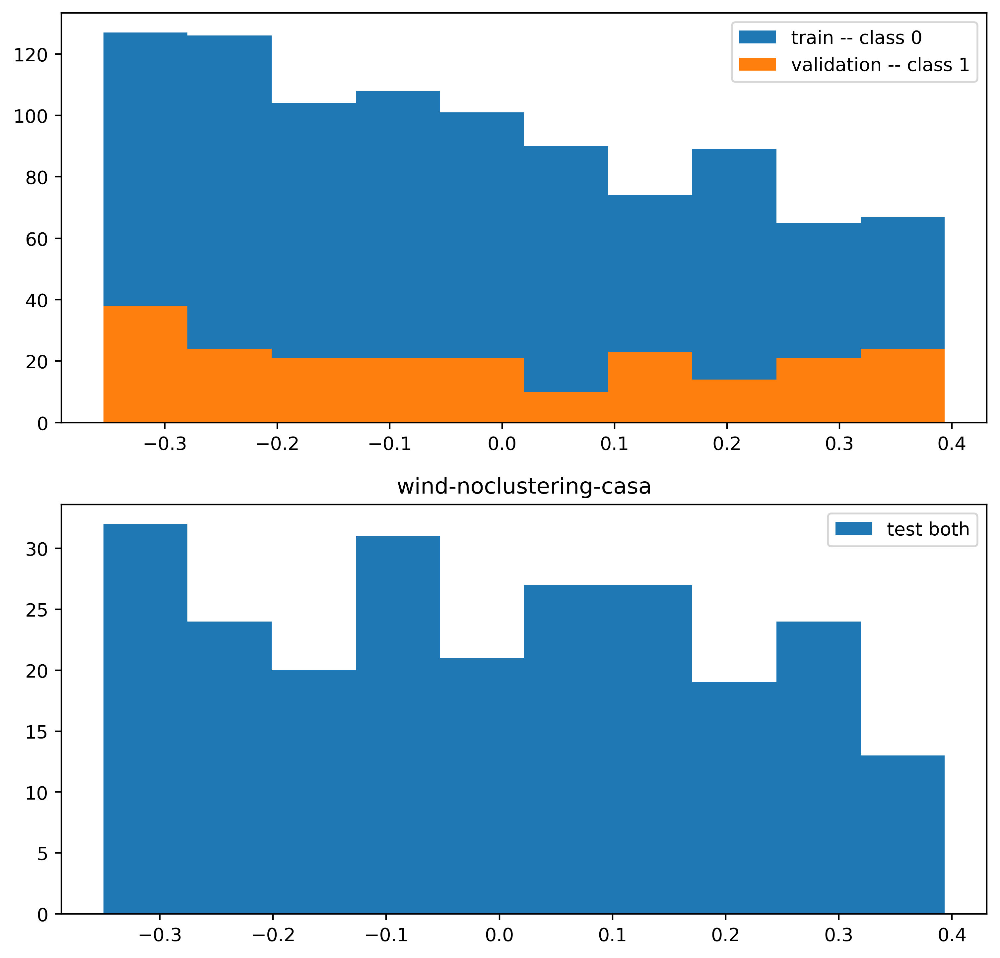

wind-noclustering-casa:  60%|██████    | 18001/30000 [53:10<1:33:28,  2.14it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  60%|██████    | 18102/30000 [53:28<35:19,  5.61it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  61%|██████    | 18202/30000 [53:46<34:53,  5.63it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  61%|██████    | 18302/30000 [54:04<34:49,  5.60it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  61%|██████▏   | 18402/30000 [54:22<34:35,  5.59it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  62%|██████▏   | 18502/30000 [54:40<34:10,  5.61it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  62%|██████▏   | 18602/30000 [54:58<33:23,  5.69it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  62%|██████▏   | 18702/30000 [55:15<33:07,  5.68it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  63%|██████▎   | 18802/30000 [55:33<32:49,  5.69it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  63%|██████▎   | 18902/30000 [55:51<32:55,  5.62it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  63%|██████▎   | 19000/30000 [56:08<32:09,  5.70it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


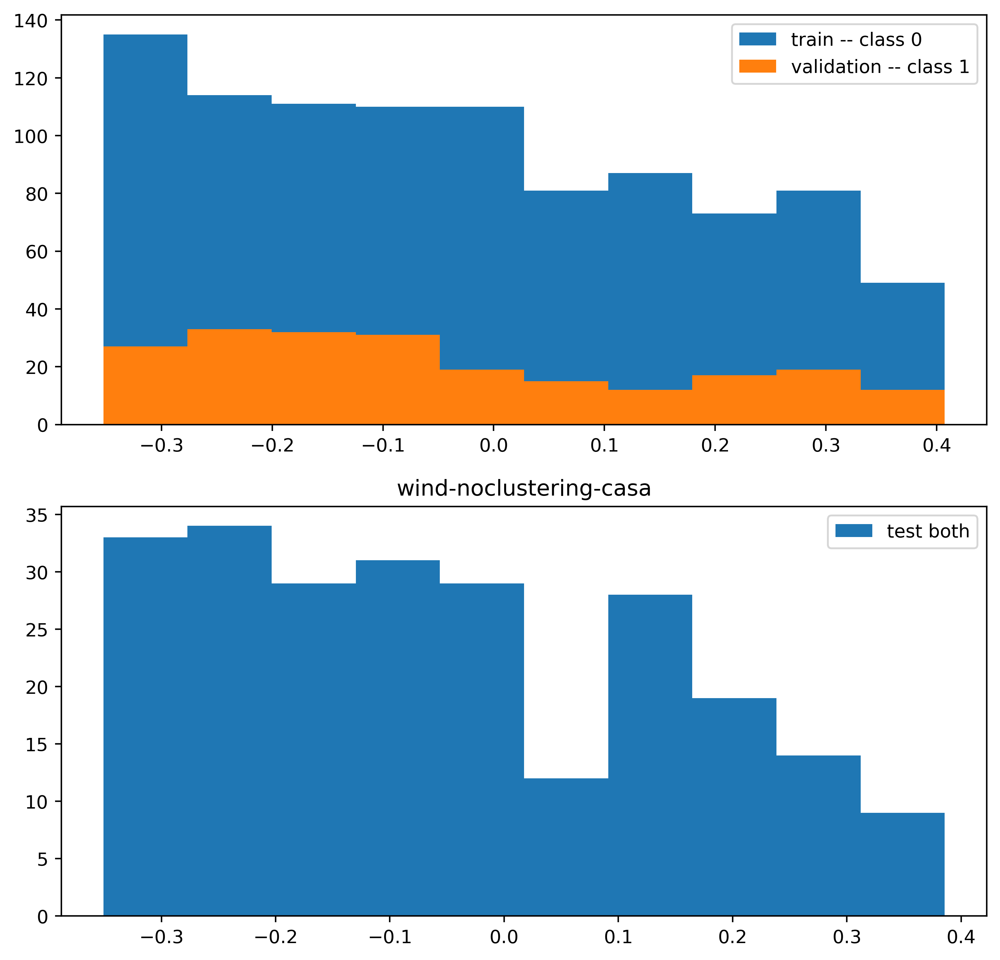

wind-noclustering-casa:  63%|██████▎   | 19001/30000 [56:09<1:25:38,  2.14it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  64%|██████▎   | 19102/30000 [56:27<32:09,  5.65it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  64%|██████▍   | 19202/30000 [56:45<31:41,  5.68it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  64%|██████▍   | 19302/30000 [57:02<31:25,  5.68it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  65%|██████▍   | 19402/30000 [57:20<31:09,  5.67it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  65%|██████▌   | 19502/30000 [57:38<30:49,  5.68it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  65%|██████▌   | 19602/30000 [57:56<30:28,  5.69it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  66%|██████▌   | 19702/30000 [58:13<30:10,  5.69it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  66%|██████▌   | 19802/30000 [58:31<29:58,  5.67it/s, train_loss=-1.71, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  66%|██████▋   | 19902/30000 [58:49<29:41,  5.67it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  67%|██████▋   | 20000/30000 [59:06<29:23,  5.67it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


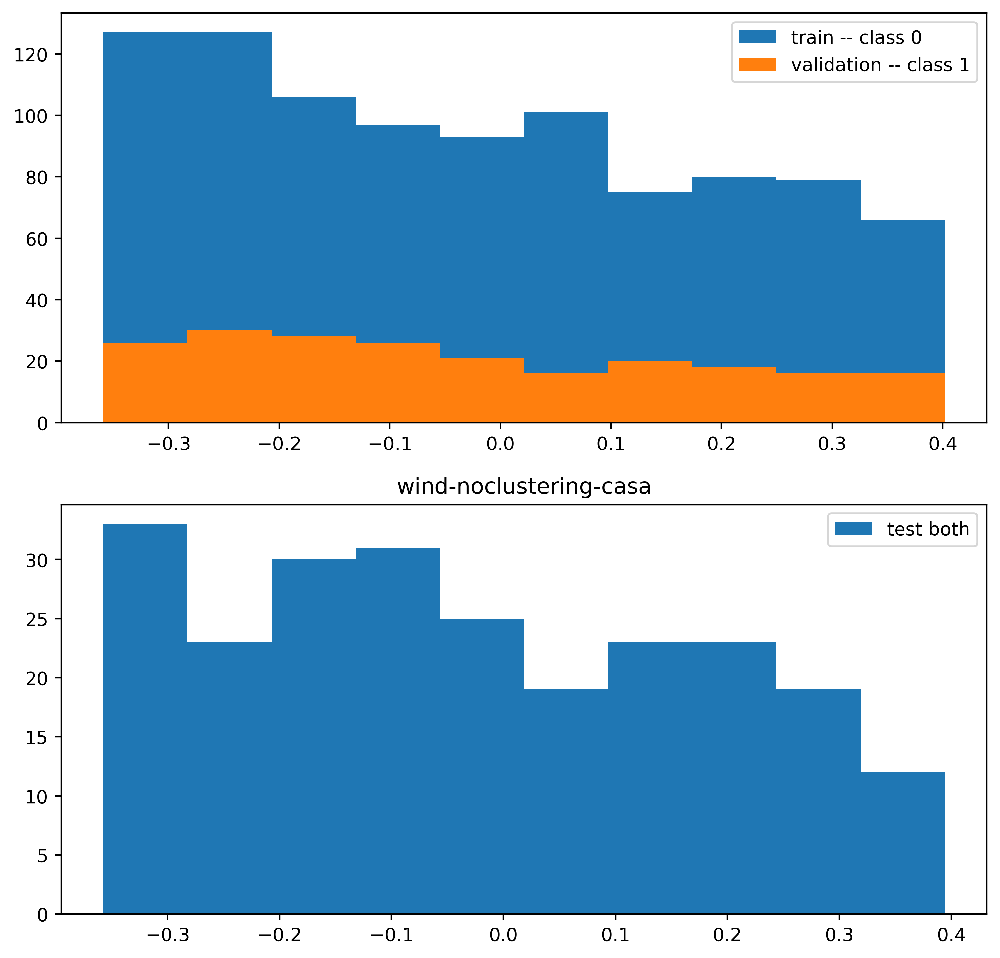

wind-noclustering-casa:  67%|██████▋   | 20001/30000 [59:07<1:17:43,  2.14it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  67%|██████▋   | 20102/30000 [59:25<29:07,  5.66it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  67%|██████▋   | 20202/30000 [59:43<28:47,  5.67it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  68%|██████▊   | 20302/30000 [1:00:01<28:23,  5.69it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  68%|██████▊   | 20402/30000 [1:00:18<28:16,  5.66it/s, train_loss=-1.83, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  68%|██████▊   | 20502/30000 [1:00:36<28:13,  5.61it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  69%|██████▊   | 20602/30000 [1:00:54<27:36,  5.67it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  69%|██████▉   | 20702/30000 [1:01:12<27:20,  5.67it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  69%|██████▉   | 20802/30000 [1:01:29<27:06,  5.65it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  70%|██████▉   | 20902/30000 [1:01:47<26:44,  5.67it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  70%|███████   | 21000/30000 [1:02:05<26:43,  5.61it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


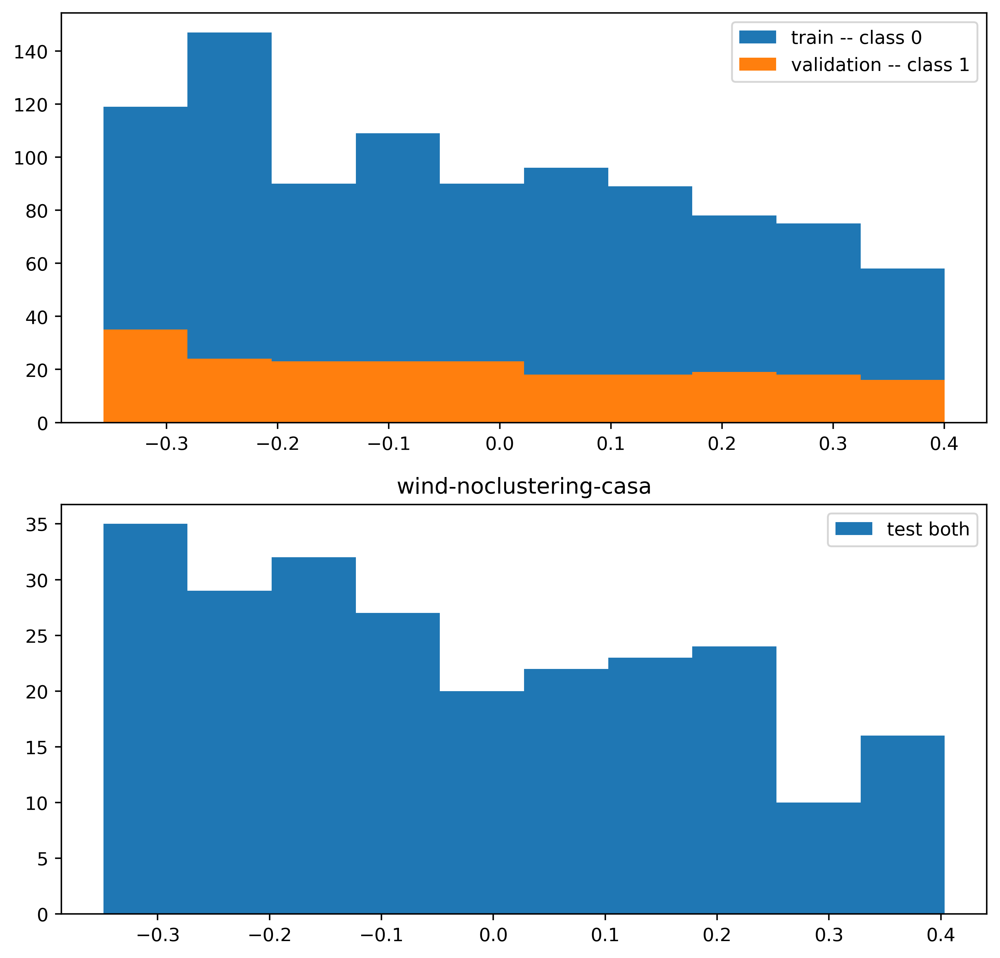

wind-noclustering-casa:  70%|███████   | 21001/30000 [1:02:06<1:10:42,  2.12it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  70%|███████   | 21102/30000 [1:02:24<26:24,  5.62it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

New Model Temperature: 0.001


wind-noclustering-casa:  71%|███████   | 21202/30000 [1:02:41<25:53,  5.66it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  71%|███████   | 21302/30000 [1:02:59<25:38,  5.65it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  71%|███████▏  | 21402/30000 [1:03:17<25:19,  5.66it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  72%|███████▏  | 21502/30000 [1:03:34<25:01,  5.66it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  72%|███████▏  | 21602/30000 [1:03:52<24:41,  5.67it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  72%|███████▏  | 21702/30000 [1:04:10<25:25,  5.44it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  73%|███████▎  | 21802/30000 [1:04:28<23:57,  5.70it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  73%|███████▎  | 21902/30000 [1:04:45<23:46,  5.68it/s, train_loss=-1.86, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  73%|███████▎  | 22000/30000 [1:05:03<23:23,  5.70it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


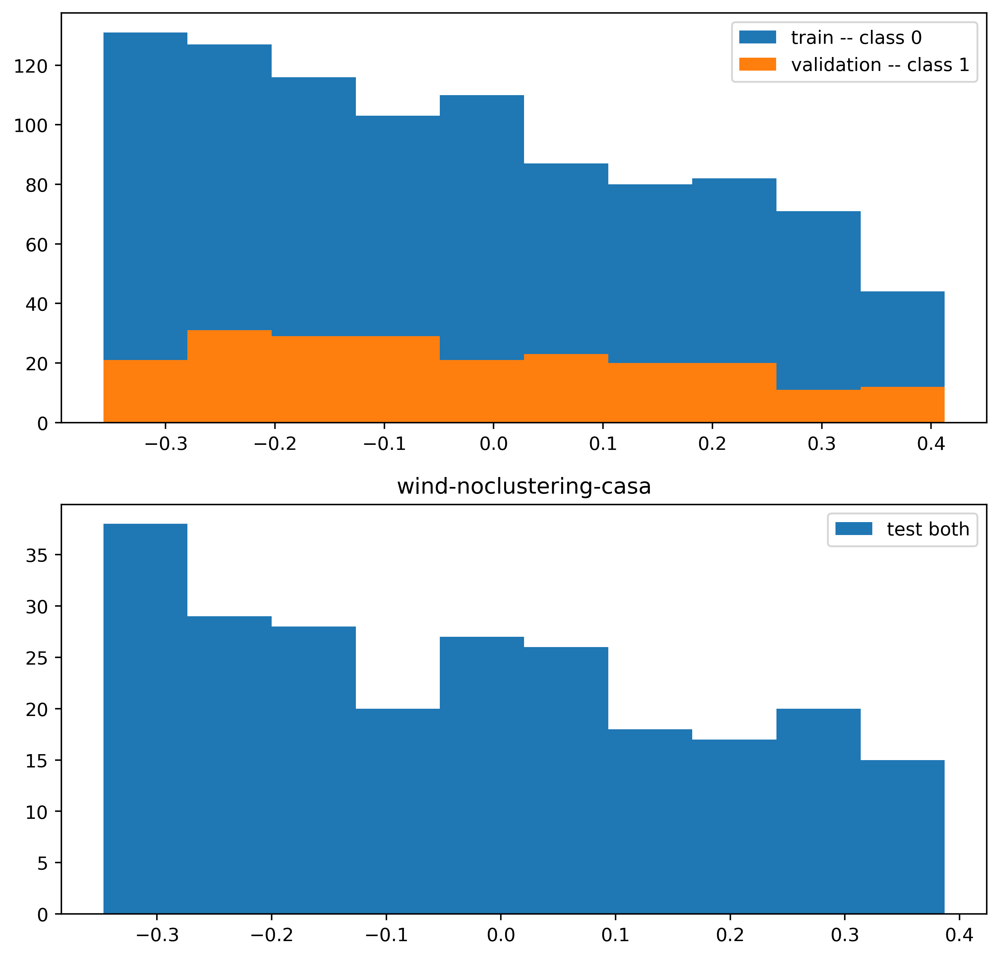

wind-noclustering-casa:  73%|███████▎  | 22002/30000 [1:05:04<51:59,  2.56it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]  

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  74%|███████▎  | 22102/30000 [1:05:22<23:07,  5.69it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  74%|███████▍  | 22202/30000 [1:05:39<22:42,  5.72it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  74%|███████▍  | 22302/30000 [1:05:57<22:41,  5.65it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  75%|███████▍  | 22402/30000 [1:06:15<22:12,  5.70it/s, train_loss=-1.7, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  75%|███████▌  | 22502/30000 [1:06:32<22:05,  5.66it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  75%|███████▌  | 22602/30000 [1:06:50<21:35,  5.71it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  76%|███████▌  | 22702/30000 [1:07:08<21:30,  5.66it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  76%|███████▌  | 22802/30000 [1:07:25<21:03,  5.70it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  76%|███████▋  | 22902/30000 [1:07:43<20:47,  5.69it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  77%|███████▋  | 23000/30000 [1:08:00<20:30,  5.69it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


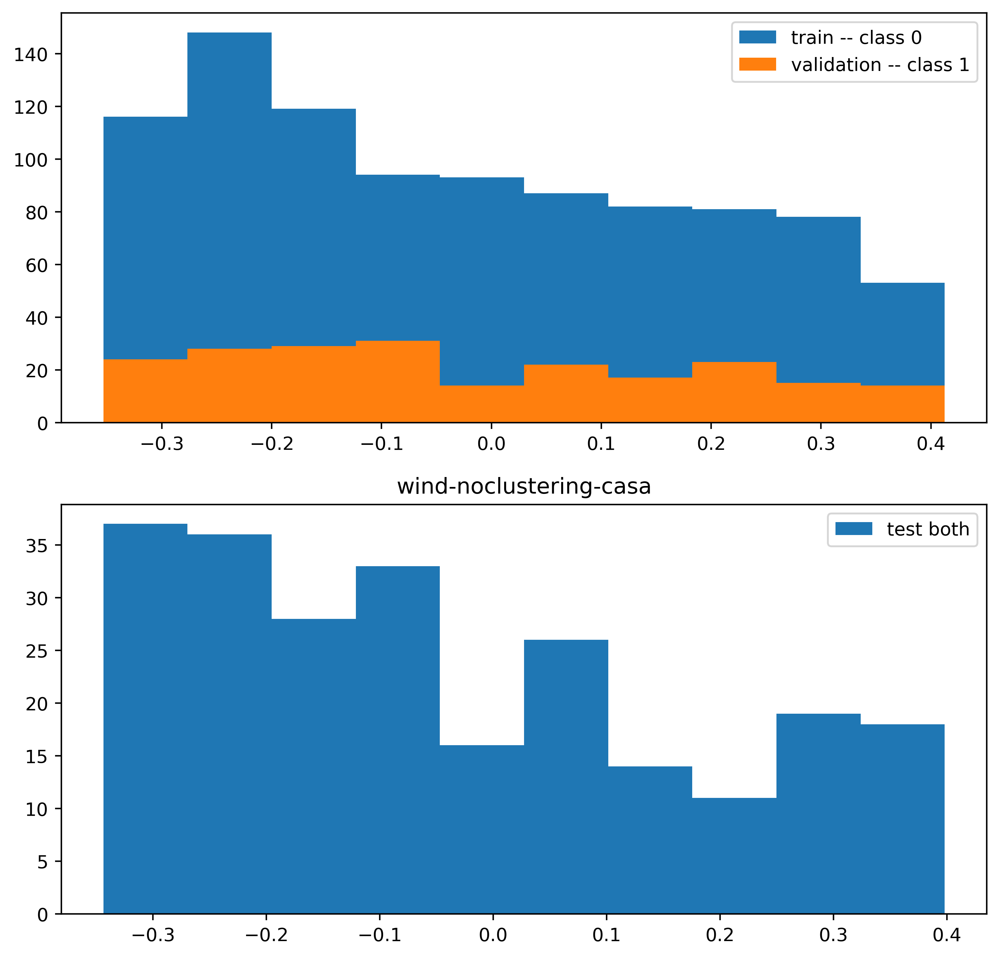

wind-noclustering-casa:  77%|███████▋  | 23002/30000 [1:08:01<45:45,  2.55it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  77%|███████▋  | 23102/30000 [1:08:19<20:08,  5.71it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  77%|███████▋  | 23202/30000 [1:08:36<19:45,  5.73it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  78%|███████▊  | 23302/30000 [1:08:54<19:24,  5.75it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  78%|███████▊  | 23402/30000 [1:09:11<19:15,  5.71it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  78%|███████▊  | 23502/30000 [1:09:29<18:56,  5.72it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  79%|███████▊  | 23602/30000 [1:09:47<18:25,  5.79it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  79%|███████▉  | 23702/30000 [1:10:04<18:16,  5.74it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  79%|███████▉  | 23802/30000 [1:10:22<17:57,  5.75it/s, train_loss=-1.84, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  80%|███████▉  | 23902/30000 [1:10:39<17:42,  5.74it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  80%|████████  | 24000/30000 [1:10:56<17:24,  5.74it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


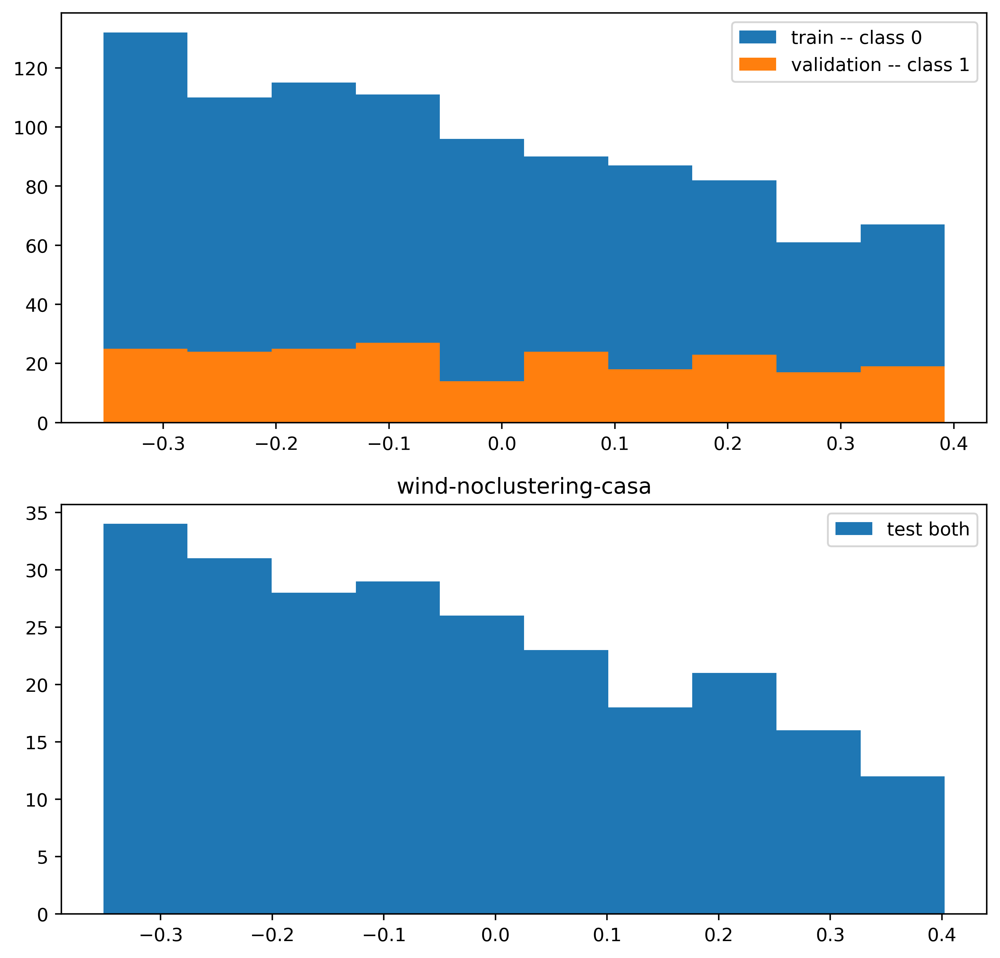

wind-noclustering-casa:  80%|████████  | 24001/30000 [1:10:58<46:41,  2.14it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  80%|████████  | 24102/30000 [1:11:15<17:13,  5.71it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  81%|████████  | 24202/30000 [1:11:33<16:47,  5.75it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  81%|████████  | 24302/30000 [1:11:50<16:31,  5.75it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  81%|████████▏ | 24401/30000 [1:12:07<18:16,  5.11it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  82%|████████▏ | 24502/30000 [1:12:25<15:55,  5.75it/s, train_loss=-1.83, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  82%|████████▏ | 24602/30000 [1:12:43<15:35,  5.77it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  82%|████████▏ | 24702/30000 [1:13:00<15:21,  5.75it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  83%|████████▎ | 24802/30000 [1:13:18<15:07,  5.73it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  83%|████████▎ | 24902/30000 [1:13:35<14:57,  5.68it/s, train_loss=-1.68, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  83%|████████▎ | 25000/30000 [1:13:53<14:35,  5.71it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


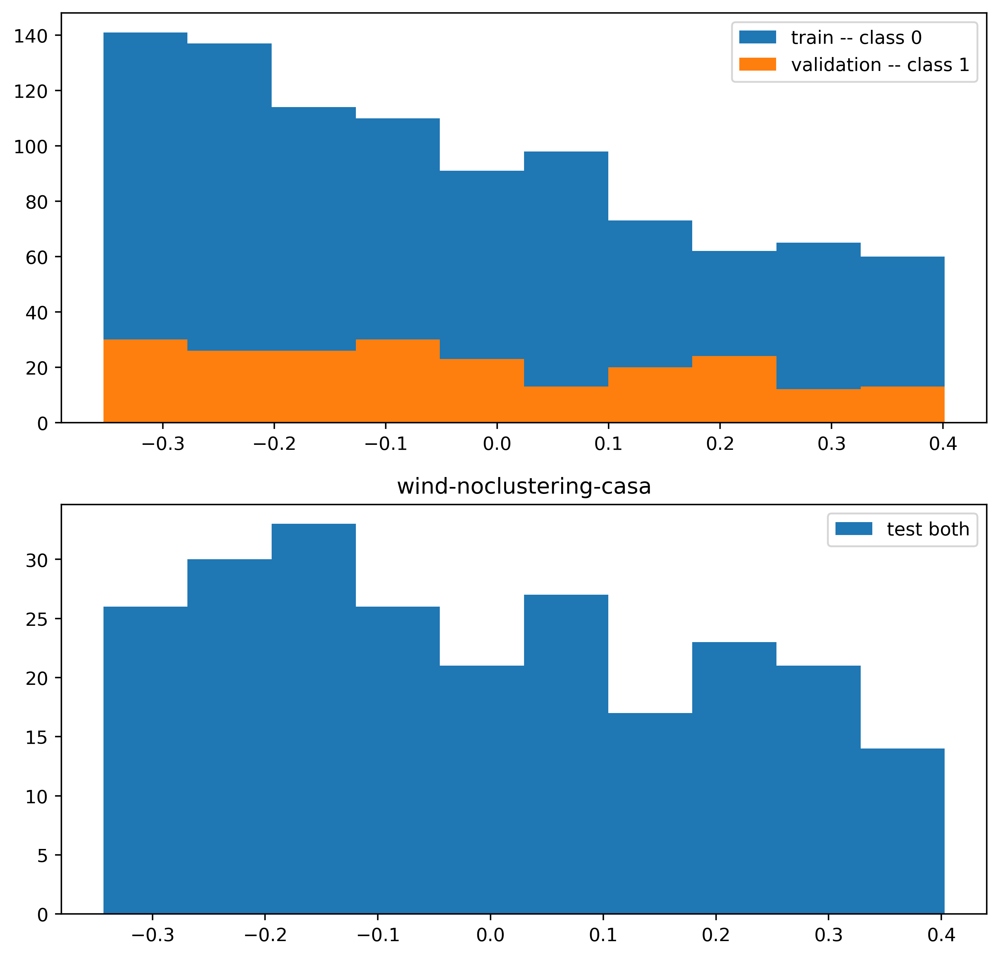

wind-noclustering-casa:  83%|████████▎ | 25001/30000 [1:13:54<39:07,  2.13it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  84%|████████▎ | 25102/30000 [1:14:12<14:17,  5.71it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  84%|████████▍ | 25202/30000 [1:14:29<14:01,  5.70it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  84%|████████▍ | 25302/30000 [1:14:47<13:39,  5.74it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  85%|████████▍ | 25402/30000 [1:15:04<13:23,  5.72it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  85%|████████▌ | 25502/30000 [1:15:22<13:05,  5.72it/s, train_loss=-1.84, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  85%|████████▌ | 25602/30000 [1:15:40<12:48,  5.73it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  86%|████████▌ | 25702/30000 [1:15:57<12:31,  5.72it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  86%|████████▌ | 25802/30000 [1:16:15<12:11,  5.74it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  86%|████████▋ | 25902/30000 [1:16:32<11:54,  5.74it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  87%|████████▋ | 26000/30000 [1:16:50<11:40,  5.71it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


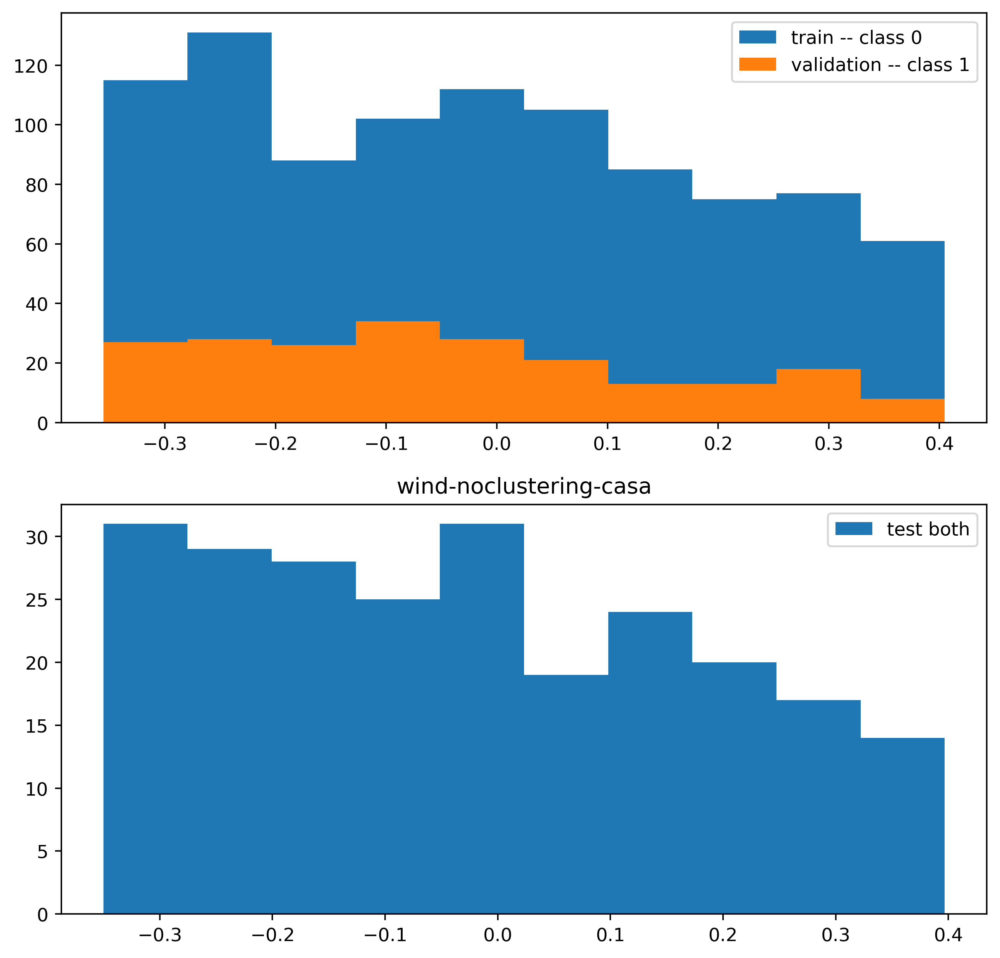

wind-noclustering-casa:  87%|████████▋ | 26001/30000 [1:16:51<31:20,  2.13it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  87%|████████▋ | 26102/30000 [1:17:09<11:25,  5.69it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  87%|████████▋ | 26202/30000 [1:17:26<11:06,  5.70it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  88%|████████▊ | 26302/30000 [1:17:44<10:49,  5.70it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  88%|████████▊ | 26402/30000 [1:18:02<10:32,  5.69it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  88%|████████▊ | 26502/30000 [1:18:19<10:15,  5.68it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  89%|████████▊ | 26602/30000 [1:18:37<09:56,  5.70it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  89%|████████▉ | 26702/30000 [1:18:55<09:37,  5.71it/s, train_loss=-1.71, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  89%|████████▉ | 26802/30000 [1:19:12<09:22,  5.69it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  90%|████████▉ | 26902/30000 [1:19:30<09:01,  5.72it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  90%|█████████ | 27000/30000 [1:19:47<08:46,  5.69it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


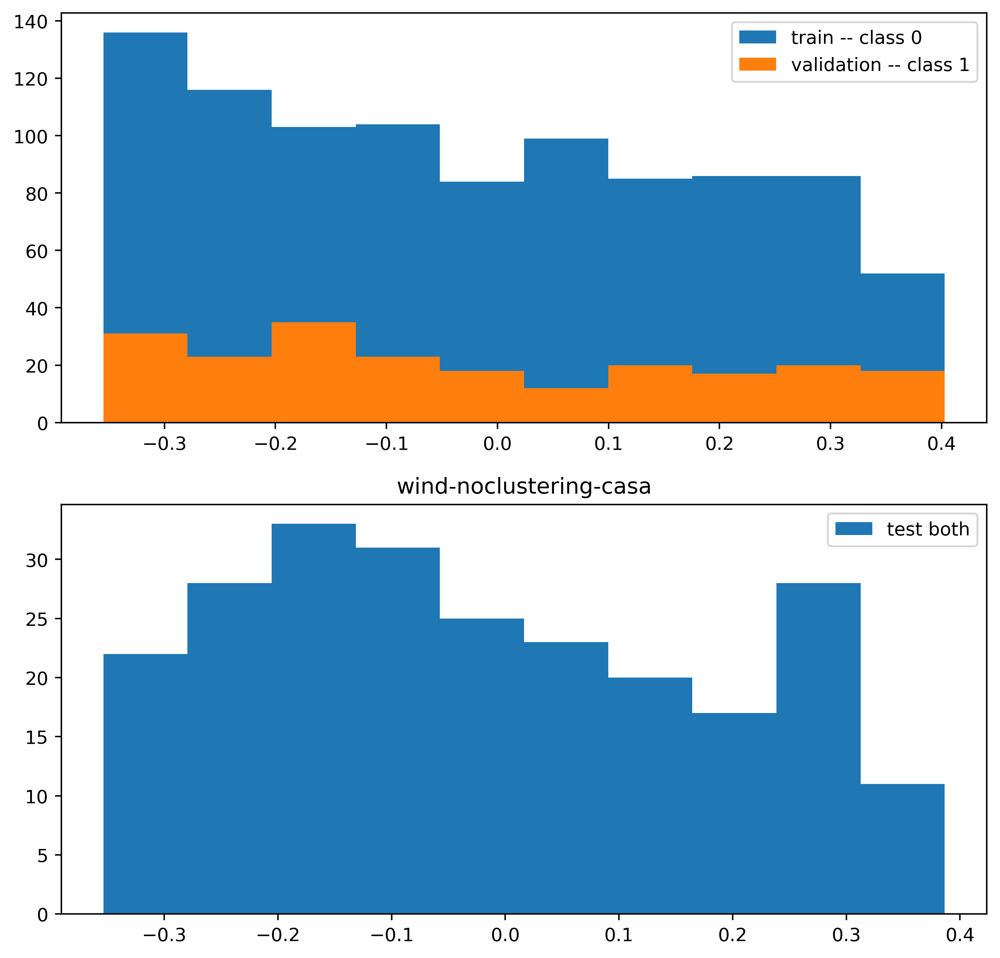

wind-noclustering-casa:  90%|█████████ | 27001/30000 [1:19:48<23:38,  2.11it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  90%|█████████ | 27102/30000 [1:20:06<08:38,  5.59it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  91%|█████████ | 27202/30000 [1:20:24<08:20,  5.59it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  91%|█████████ | 27302/30000 [1:20:42<08:02,  5.59it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  91%|█████████▏| 27402/30000 [1:21:00<07:43,  5.60it/s, train_loss=-1.8, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1] 

New Model Temperature: 0.001


wind-noclustering-casa:  92%|█████████▏| 27502/30000 [1:21:18<07:26,  5.60it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  92%|█████████▏| 27602/30000 [1:21:36<07:08,  5.59it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  92%|█████████▏| 27702/30000 [1:21:54<06:50,  5.60it/s, train_loss=-1.77, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  93%|█████████▎| 27802/30000 [1:22:12<06:32,  5.60it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  93%|█████████▎| 27902/30000 [1:22:30<06:13,  5.61it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  93%|█████████▎| 28000/30000 [1:22:48<05:59,  5.56it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


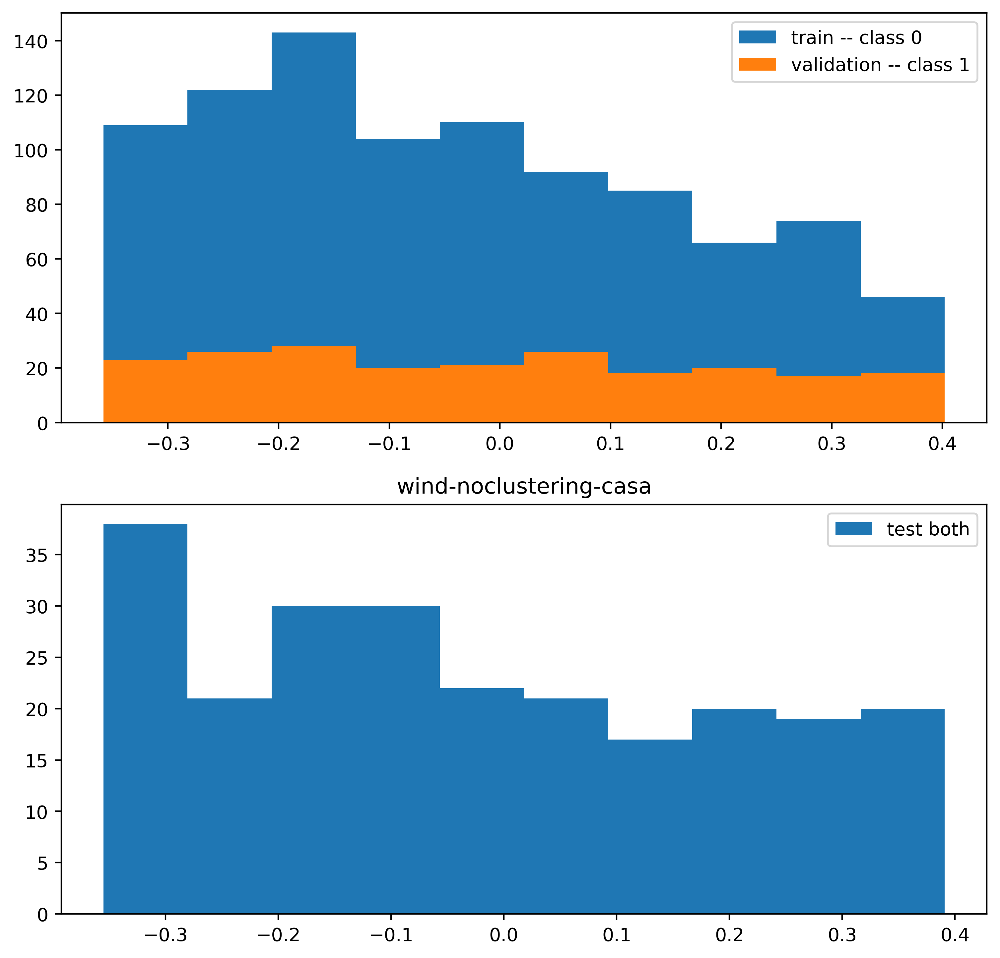

wind-noclustering-casa:  93%|█████████▎| 28001/30000 [1:22:49<15:44,  2.12it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  94%|█████████▎| 28102/30000 [1:23:07<05:40,  5.57it/s, train_loss=-1.74, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  94%|█████████▍| 28202/30000 [1:23:25<05:22,  5.57it/s, train_loss=-1.71, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  94%|█████████▍| 28302/30000 [1:23:43<05:05,  5.57it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  95%|█████████▍| 28402/30000 [1:24:01<04:46,  5.58it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  95%|█████████▌| 28502/30000 [1:24:19<04:28,  5.58it/s, train_loss=-1.81, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  95%|█████████▌| 28602/30000 [1:24:37<04:11,  5.56it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  96%|█████████▌| 28702/30000 [1:24:55<03:53,  5.57it/s, train_loss=-1.79, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  96%|█████████▌| 28802/30000 [1:25:13<03:35,  5.57it/s, train_loss=-1.69, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  96%|█████████▋| 28902/30000 [1:25:32<03:16,  5.59it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  97%|█████████▋| 29000/30000 [1:25:49<02:59,  5.58it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001
951 951 951
(array([0]), array([951]))


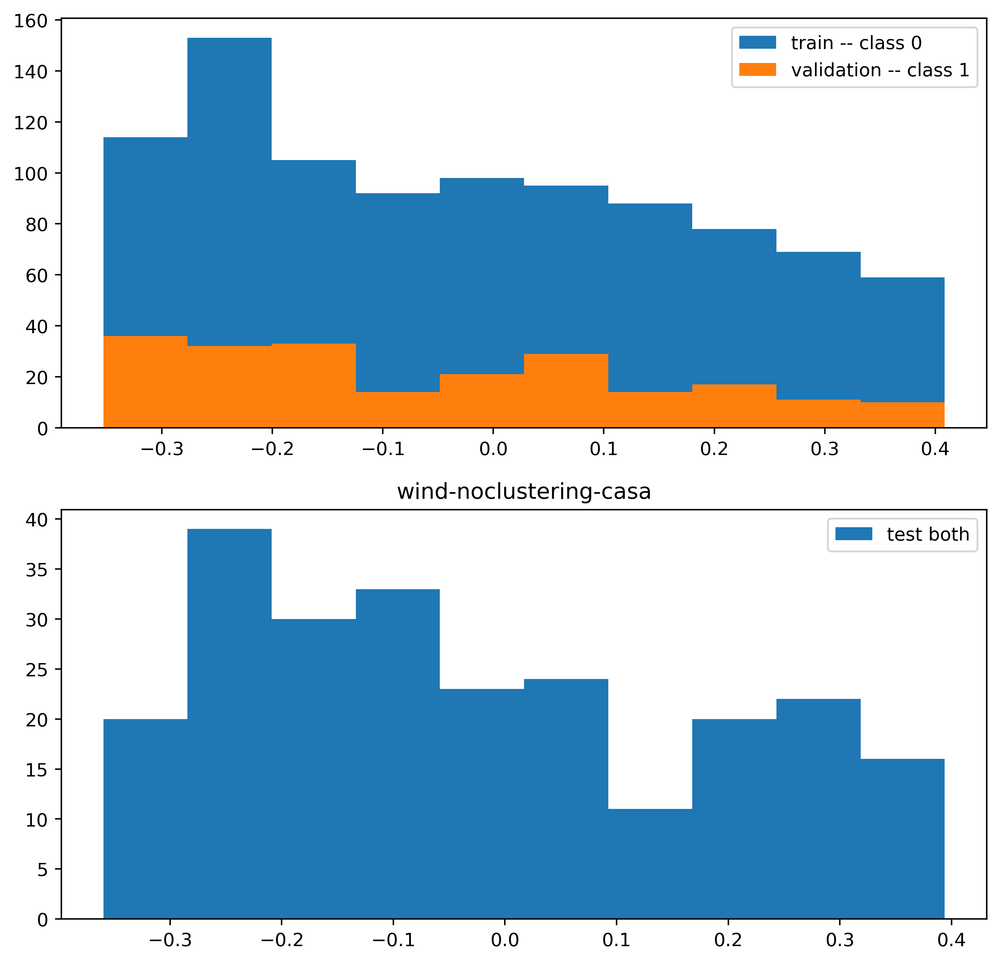

wind-noclustering-casa:  97%|█████████▋| 29001/30000 [1:25:50<07:55,  2.10it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

graph level clf: wind-noclustering-casa binary True test acc 0.1849 f1 0.0000 recall 0.0000 prec 0.0000 [[ 44   0]
 [194   0]] 



wind-noclustering-casa:  97%|█████████▋| 29102/30000 [1:26:09<02:41,  5.56it/s, train_loss=-1.75, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  97%|█████████▋| 29202/30000 [1:26:27<02:23,  5.57it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  98%|█████████▊| 29302/30000 [1:26:45<02:05,  5.56it/s, train_loss=-1.78, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  98%|█████████▊| 29402/30000 [1:27:03<01:47,  5.57it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  98%|█████████▊| 29502/30000 [1:27:21<01:30,  5.51it/s, train_loss=-1.73, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  99%|█████████▊| 29602/30000 [1:27:39<01:11,  5.57it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  99%|█████████▉| 29702/30000 [1:27:57<00:53,  5.58it/s, train_loss=-1.76, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa:  99%|█████████▉| 29802/30000 [1:28:15<00:35,  5.59it/s, train_loss=-1.72, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


wind-noclustering-casa: 100%|█████████▉| 29902/30000 [1:28:33<00:17,  5.57it/s, train_loss=-1.82, train_acc=0.228, test_acc=0.185, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:   0%|          | 0/30000 [00:01<?, ?it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 1.0
4919 4919 4919
(array([0]), array([4919]))


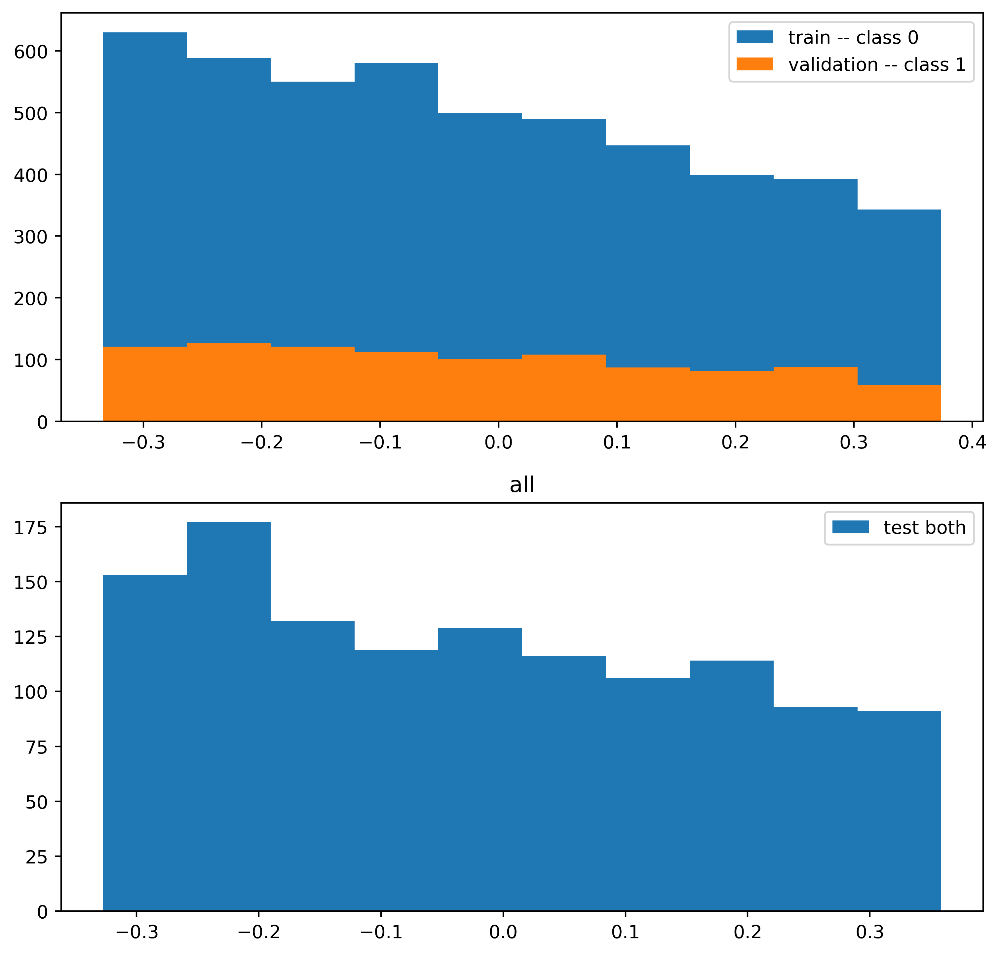

all:   0%|          | 1/30000 [00:02<20:34:49,  2.47s/it, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:   0%|          | 101/30000 [01:33<7:33:41,  1.10it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.9801986733067553


all:   1%|          | 201/30000 [03:04<7:31:43,  1.10it/s, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.9417645335842486


all:   1%|          | 301/30000 [04:35<7:29:43,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.8869204367171575


all:   1%|▏         | 401/30000 [06:06<7:27:19,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.8187307530779818


all:   2%|▏         | 501/30000 [07:37<7:26:38,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.7408182206817178


all:   2%|▏         | 601/30000 [09:08<7:24:30,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.6570468198150566


all:   2%|▏         | 701/30000 [10:39<7:24:59,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.5712090638488148


all:   3%|▎         | 801/30000 [12:10<7:22:40,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.48675225595997157


all:   3%|▎         | 901/30000 [13:41<7:20:58,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.40656965974059905


all:   3%|▎         | 1000/30000 [15:12<7:19:06,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.3328710836980795
4919 4919 4919
(array([0]), array([4919]))


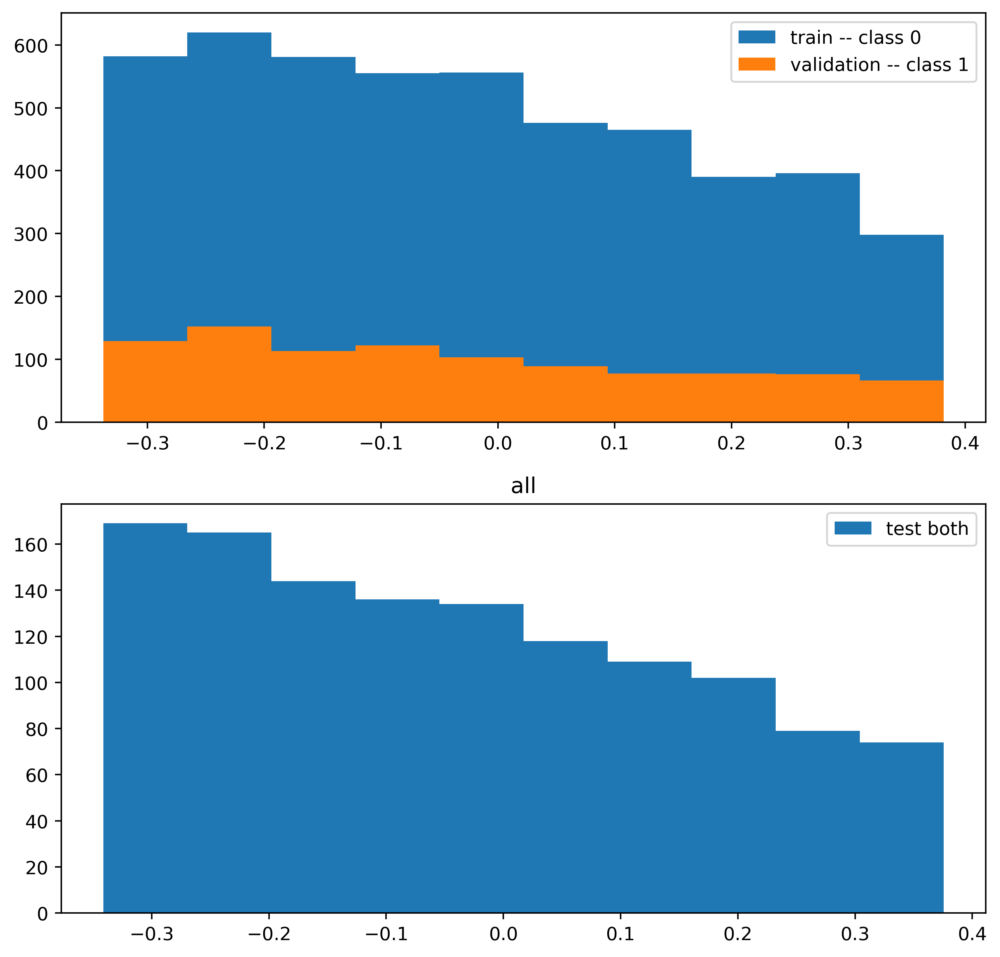

all:   3%|▎         | 1001/30000 [15:13<10:31:21,  1.31s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:   4%|▎         | 1101/30000 [16:44<7:17:16,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.26713530196585034


all:   4%|▍         | 1201/30000 [18:15<7:14:20,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.2101360712007647


all:   4%|▍         | 1301/30000 [19:46<7:15:38,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.16202575093388072


all:   5%|▍         | 1401/30000 [21:16<7:11:57,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.12245642825298188


all:   5%|▌         | 1501/30000 [22:47<7:09:10,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.09071795328941248


all:   5%|▌         | 1601/30000 [24:17<7:07:24,  1.11it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.06587475442640295


all:   6%|▌         | 1701/30000 [25:48<7:07:24,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.04688769521998848


all:   6%|▌         | 1801/30000 [27:19<7:07:10,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.032712434939019805


all:   6%|▋         | 1901/30000 [28:50<7:06:42,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.022370771856165587


all:   7%|▋         | 2000/30000 [30:21<7:03:08,  1.10it/s, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.014995576820477701
4919 4919 4919
(array([0]), array([4919]))


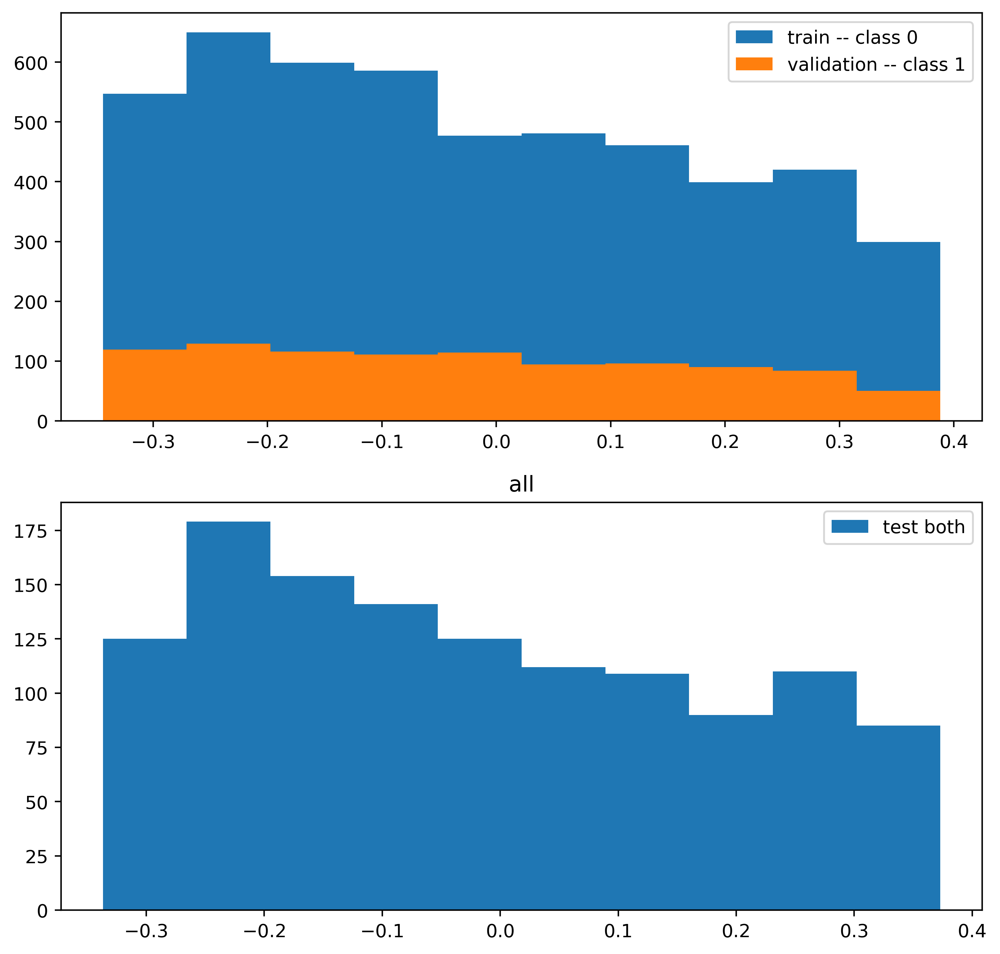

all:   7%|▋         | 2001/30000 [30:22<10:10:04,  1.31s/it, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:   7%|▋         | 2101/30000 [31:53<6:59:21,  1.11it/s, train_loss=-1.81, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.009852796061187254


all:   7%|▋         | 2201/30000 [33:23<6:56:23,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.006345559512909111


all:   8%|▊         | 2301/30000 [34:53<6:54:58,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.004005847942090417


all:   8%|▊         | 2401/30000 [36:23<6:53:04,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.002478752176666357


all:   8%|▊         | 2501/30000 [37:53<6:51:17,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.0015034391929775717


all:   9%|▊         | 2601/30000 [39:23<6:50:13,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:   9%|▉         | 2701/30000 [40:52<6:47:29,  1.12it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:   9%|▉         | 2801/30000 [42:22<6:46:53,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  10%|▉         | 2901/30000 [43:52<6:45:56,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  10%|█         | 3000/30000 [45:22<6:44:25,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


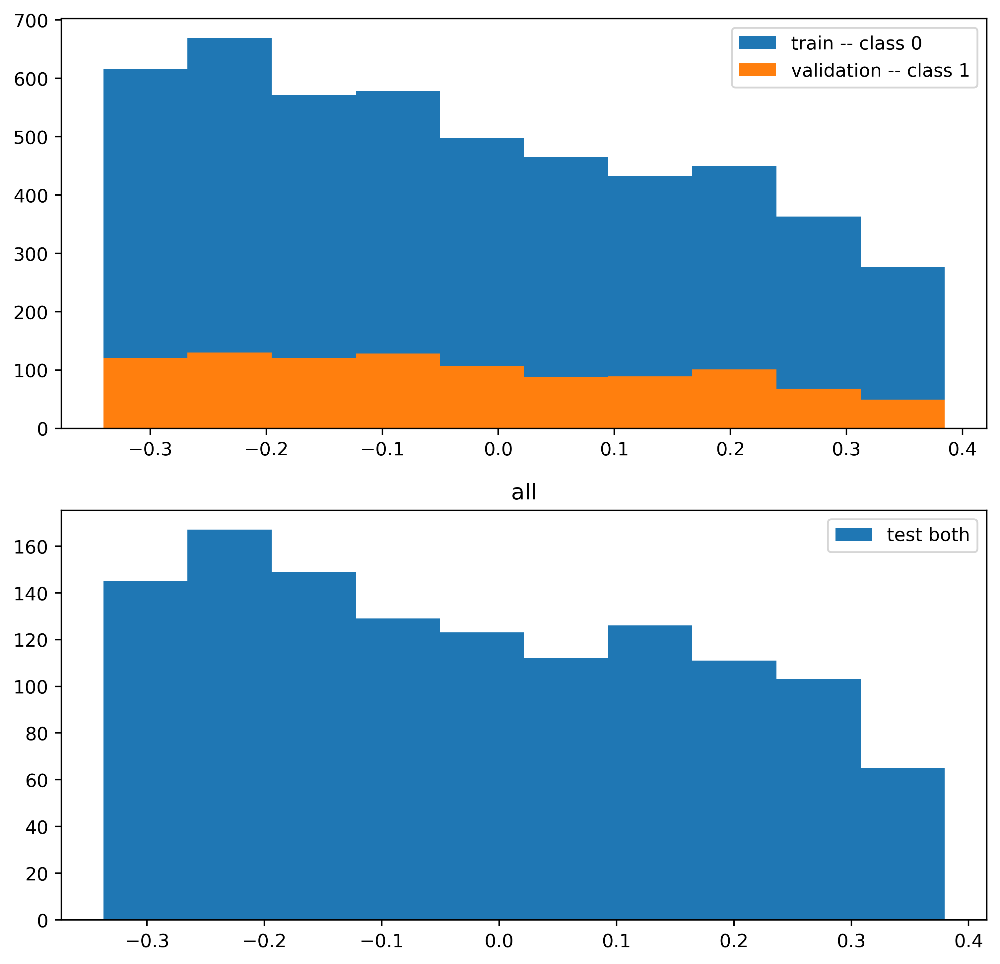

all:  10%|█         | 3001/30000 [45:23<9:45:52,  1.30s/it, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  10%|█         | 3101/30000 [46:54<6:44:14,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  11%|█         | 3201/30000 [48:24<6:41:09,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  11%|█         | 3301/30000 [49:54<6:43:35,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  11%|█▏        | 3401/30000 [51:25<6:40:36,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  12%|█▏        | 3501/30000 [52:55<6:38:51,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  12%|█▏        | 3601/30000 [54:26<6:37:44,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  12%|█▏        | 3701/30000 [55:56<6:36:32,  1.11it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  13%|█▎        | 3801/30000 [57:27<6:35:04,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  13%|█▎        | 3901/30000 [58:57<6:33:42,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  13%|█▎        | 4000/30000 [1:00:27<6:31:20,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


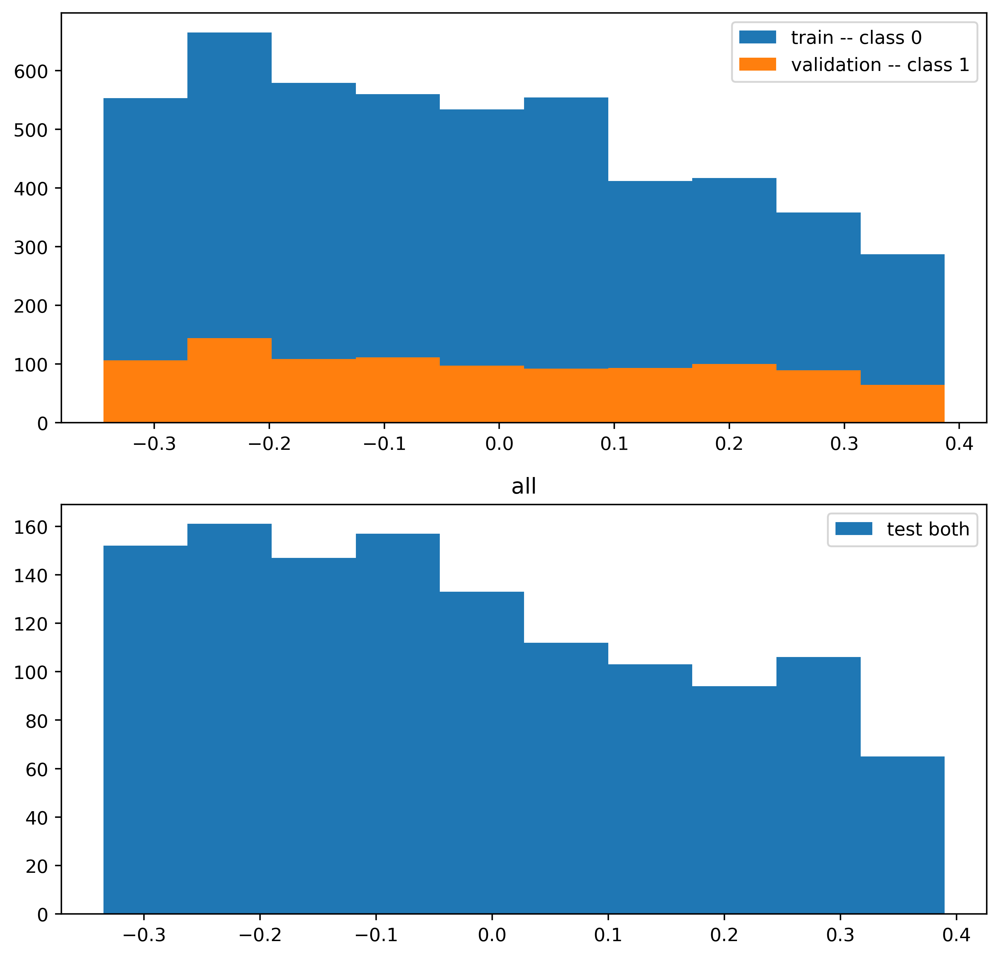

all:  13%|█▎        | 4001/30000 [1:00:29<9:26:44,  1.31s/it, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  14%|█▎        | 4101/30000 [1:01:58<6:26:04,  1.12it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  14%|█▍        | 4201/30000 [1:03:28<6:23:47,  1.12it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  14%|█▍        | 4301/30000 [1:04:57<6:23:30,  1.12it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  15%|█▍        | 4401/30000 [1:06:27<6:21:31,  1.12it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  15%|█▌        | 4501/30000 [1:07:56<6:18:37,  1.12it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  15%|█▌        | 4601/30000 [1:09:25<6:17:25,  1.12it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  16%|█▌        | 4701/30000 [1:10:54<6:15:14,  1.12it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  16%|█▌        | 4801/30000 [1:12:24<6:14:31,  1.12it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  16%|█▋        | 4901/30000 [1:13:53<6:12:54,  1.12it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  17%|█▋        | 5000/30000 [1:15:22<6:12:11,  1.12it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


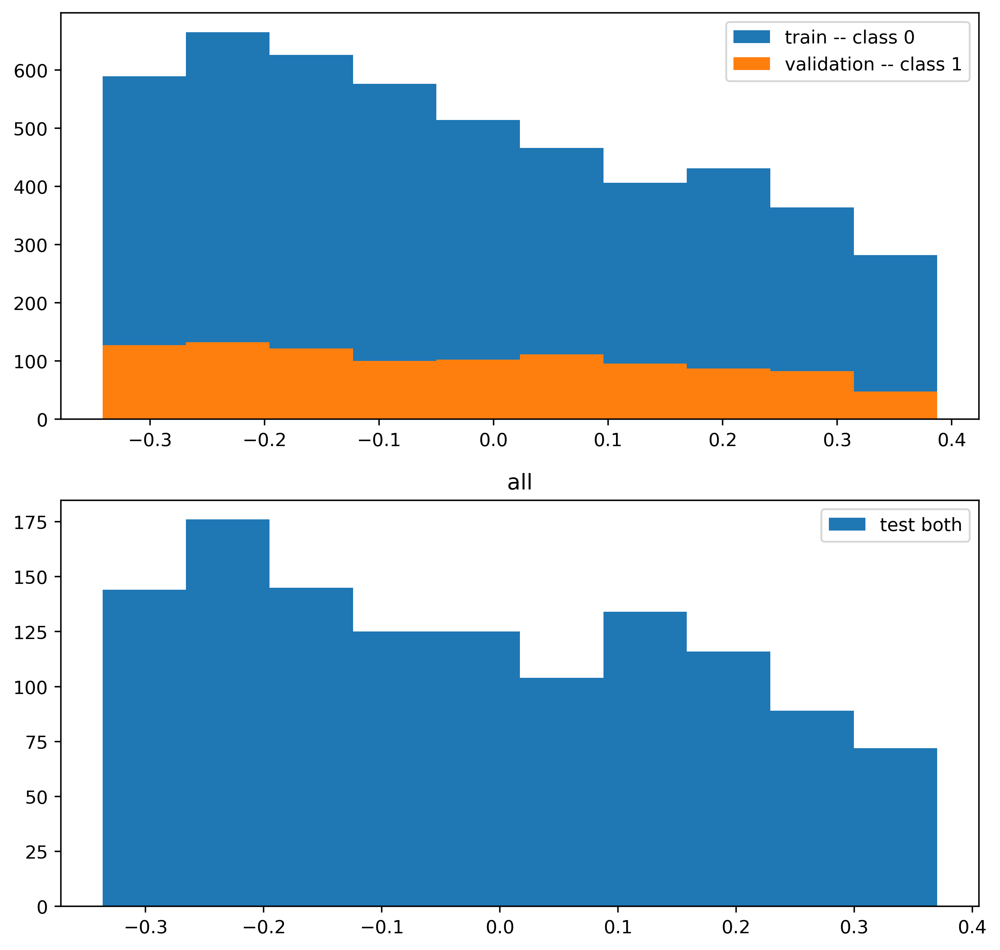

all:  17%|█▋        | 5001/30000 [1:15:23<8:56:56,  1.29s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  17%|█▋        | 5101/30000 [1:16:53<6:13:02,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  17%|█▋        | 5201/30000 [1:18:22<6:08:08,  1.12it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  18%|█▊        | 5301/30000 [1:19:51<6:06:37,  1.12it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  18%|█▊        | 5401/30000 [1:21:20<6:06:12,  1.12it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  18%|█▊        | 5501/30000 [1:22:50<6:08:30,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  19%|█▊        | 5601/30000 [1:24:20<6:07:08,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  19%|█▉        | 5701/30000 [1:25:51<6:07:02,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  19%|█▉        | 5801/30000 [1:27:21<6:04:25,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  20%|█▉        | 5901/30000 [1:28:52<6:02:10,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  20%|██        | 6000/30000 [1:30:22<6:00:35,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


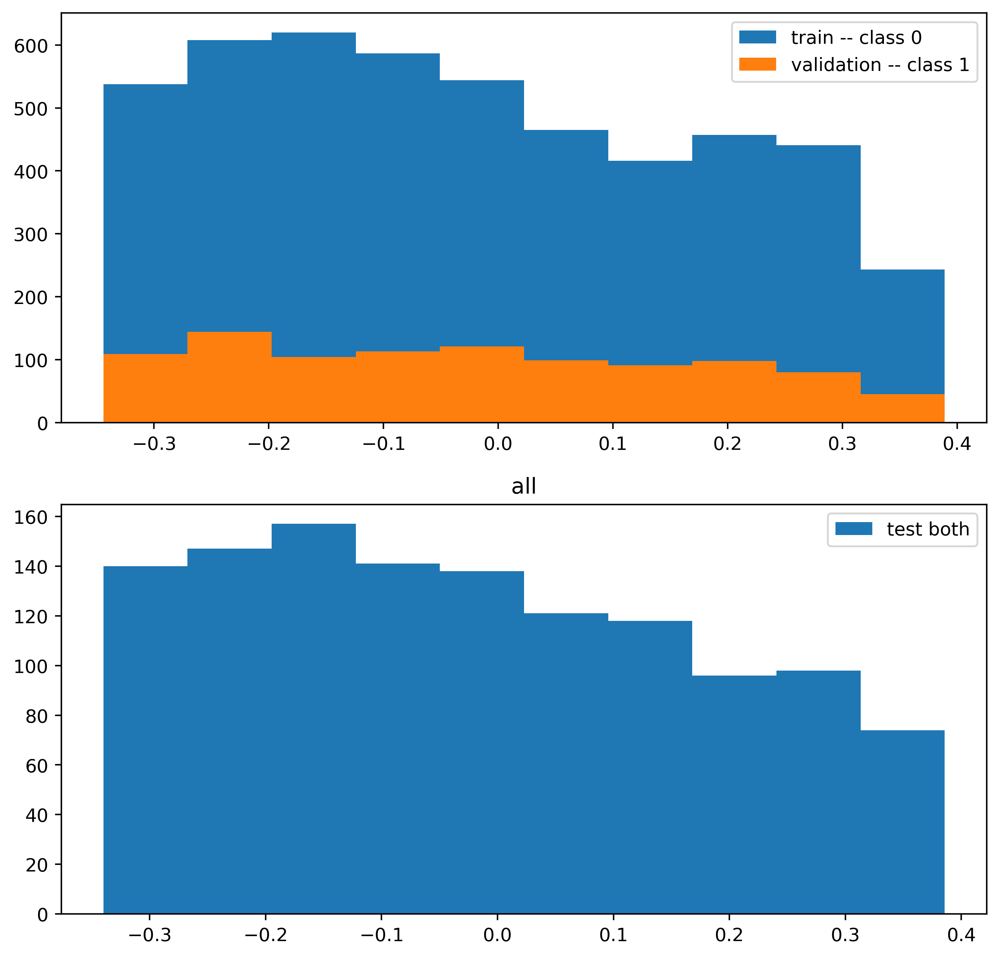

all:  20%|██        | 6001/30000 [1:30:23<8:40:23,  1.30s/it, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  20%|██        | 6101/30000 [1:31:53<5:58:33,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  21%|██        | 6201/30000 [1:33:23<5:56:05,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  21%|██        | 6301/30000 [1:34:53<5:54:27,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  21%|██▏       | 6401/30000 [1:36:22<5:52:05,  1.12it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  22%|██▏       | 6501/30000 [1:37:52<5:51:18,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  22%|██▏       | 6601/30000 [1:39:22<5:52:08,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  22%|██▏       | 6701/30000 [1:40:53<5:51:25,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  23%|██▎       | 6801/30000 [1:42:23<5:48:07,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  23%|██▎       | 6901/30000 [1:43:53<5:46:38,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  23%|██▎       | 7000/30000 [1:45:23<5:45:58,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


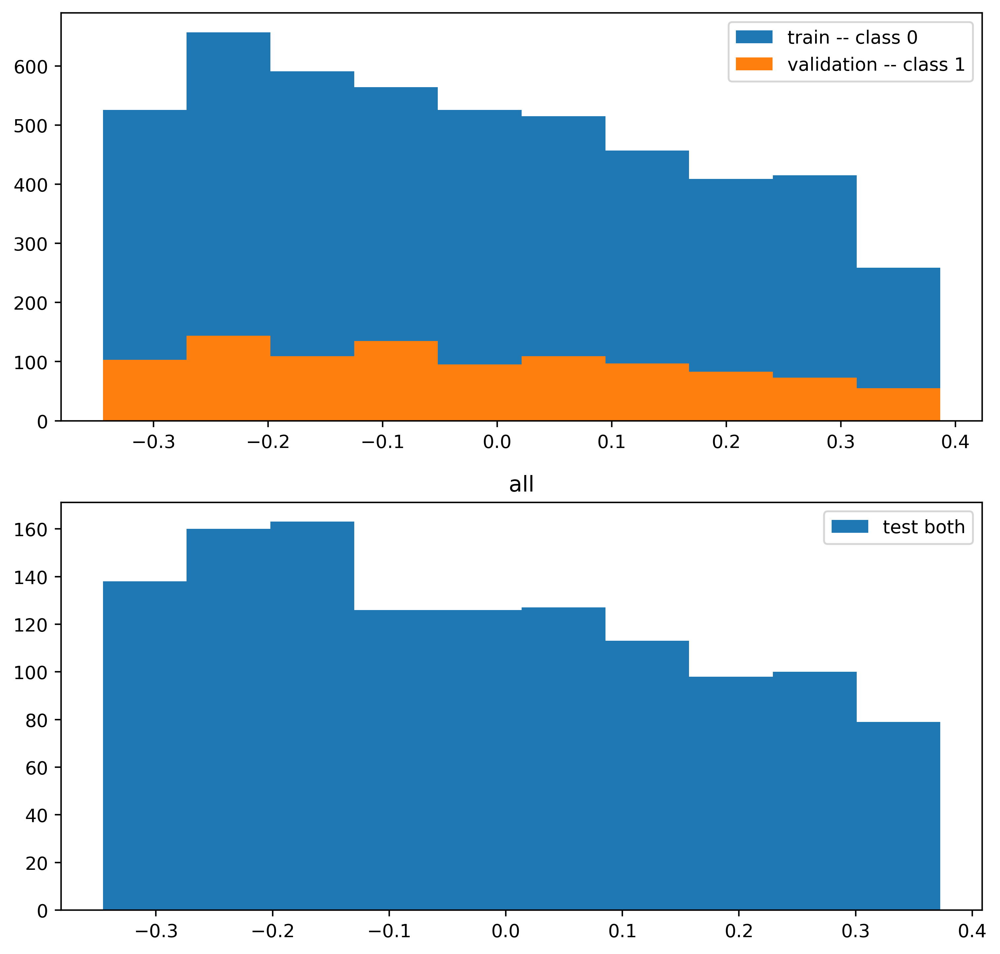

all:  23%|██▎       | 7001/30000 [1:45:25<8:17:15,  1.30s/it, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  24%|██▎       | 7101/30000 [1:46:55<5:43:48,  1.11it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  24%|██▍       | 7201/30000 [1:48:26<5:43:48,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  24%|██▍       | 7301/30000 [1:49:56<5:41:16,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  25%|██▍       | 7401/30000 [1:51:27<5:41:00,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  25%|██▌       | 7501/30000 [1:52:57<5:37:53,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  25%|██▌       | 7601/30000 [1:54:28<5:38:38,  1.10it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  26%|██▌       | 7701/30000 [1:55:59<5:37:42,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  26%|██▌       | 7801/30000 [1:57:29<5:35:10,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  26%|██▋       | 7901/30000 [1:59:00<5:34:38,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  27%|██▋       | 8000/30000 [2:00:31<5:32:31,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


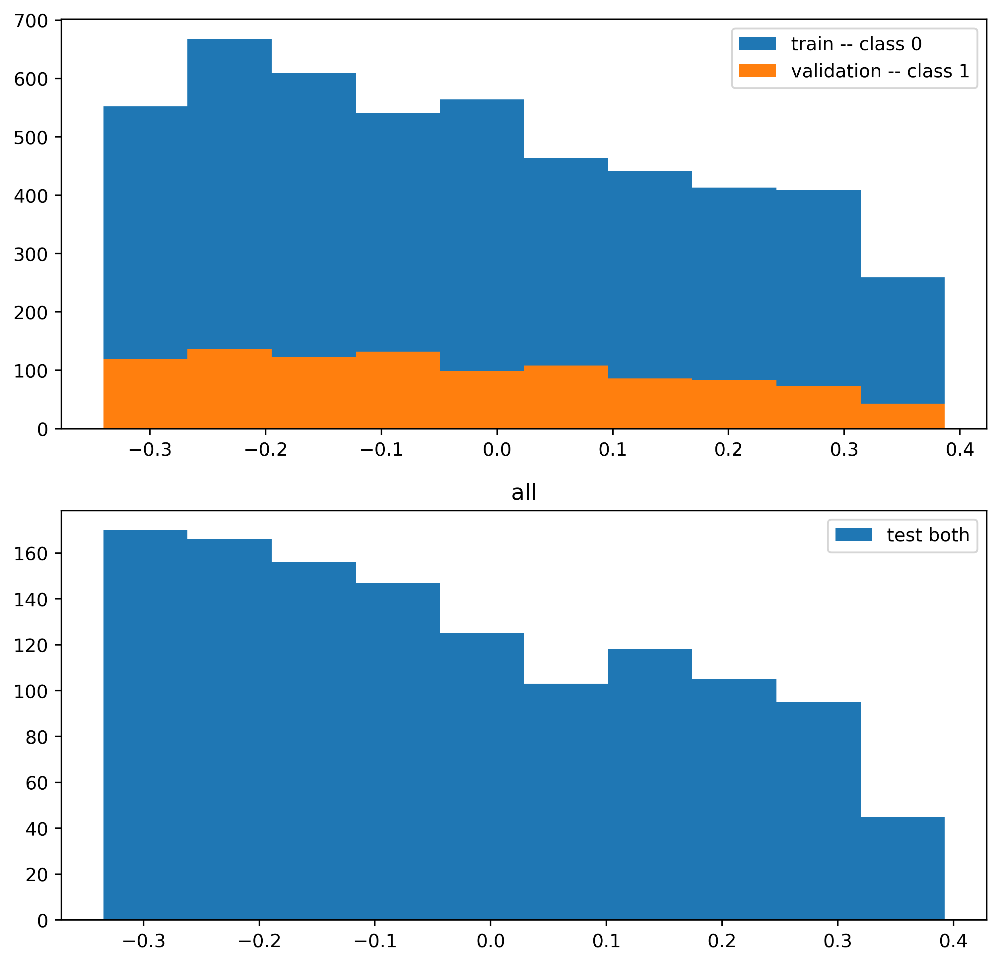

all:  27%|██▋       | 8001/30000 [2:00:33<8:01:06,  1.31s/it, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  27%|██▋       | 8101/30000 [2:02:04<5:33:11,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  27%|██▋       | 8201/30000 [2:03:35<5:30:25,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  28%|██▊       | 8301/30000 [2:05:06<5:28:41,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  28%|██▊       | 8401/30000 [2:06:37<5:28:04,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  28%|██▊       | 8501/30000 [2:08:08<5:26:10,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  29%|██▊       | 8601/30000 [2:09:39<5:24:01,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  29%|██▉       | 8701/30000 [2:11:10<5:22:28,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  29%|██▉       | 8801/30000 [2:12:41<5:19:50,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  30%|██▉       | 8901/30000 [2:14:11<5:19:06,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  30%|███       | 9000/30000 [2:15:42<5:20:19,  1.09it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


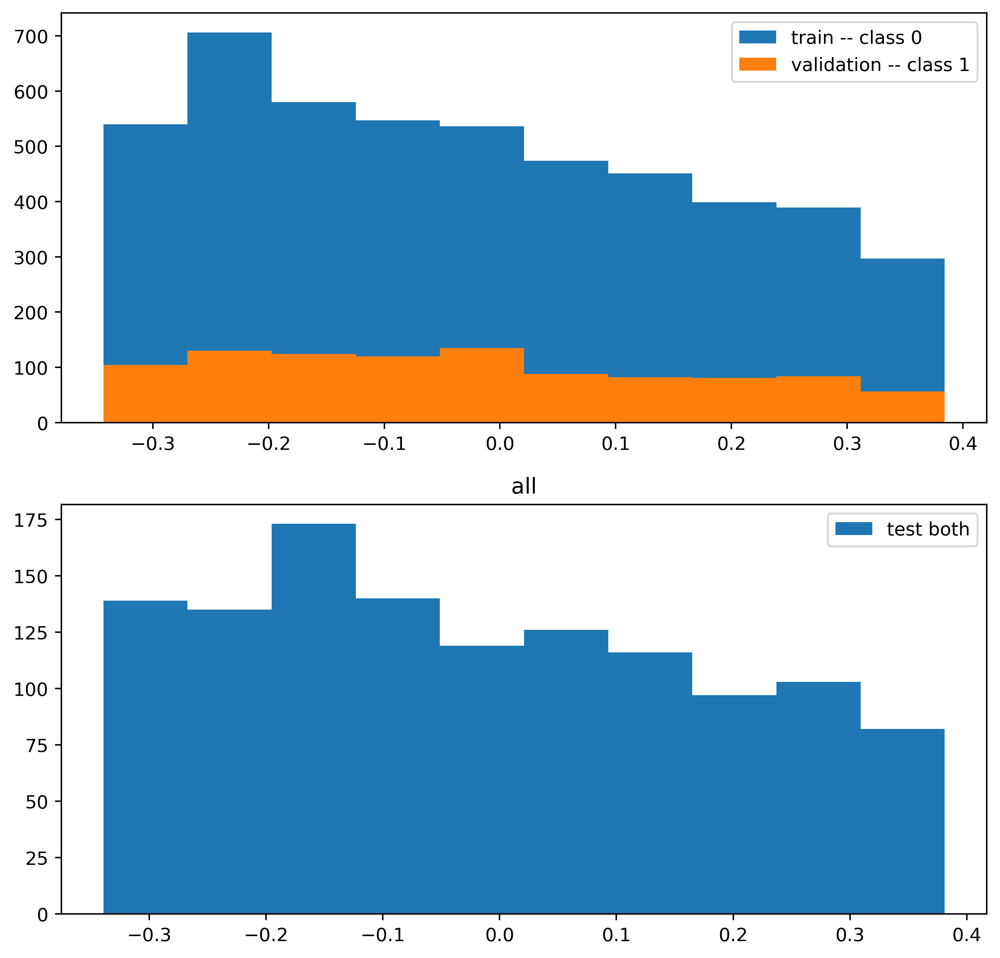

all:  30%|███       | 9001/30000 [2:15:44<7:38:44,  1.31s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  30%|███       | 9101/30000 [2:17:14<5:18:41,  1.09it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  31%|███       | 9201/30000 [2:18:45<5:13:45,  1.10it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  31%|███       | 9301/30000 [2:20:16<5:12:00,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  31%|███▏      | 9401/30000 [2:21:46<5:11:12,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  32%|███▏      | 9501/30000 [2:23:17<5:09:25,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  32%|███▏      | 9601/30000 [2:24:47<5:07:08,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  32%|███▏      | 9701/30000 [2:26:18<5:05:56,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  33%|███▎      | 9801/30000 [2:27:48<5:04:51,  1.10it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  33%|███▎      | 9901/30000 [2:29:19<5:02:33,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  33%|███▎      | 10000/30000 [2:30:49<5:00:56,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


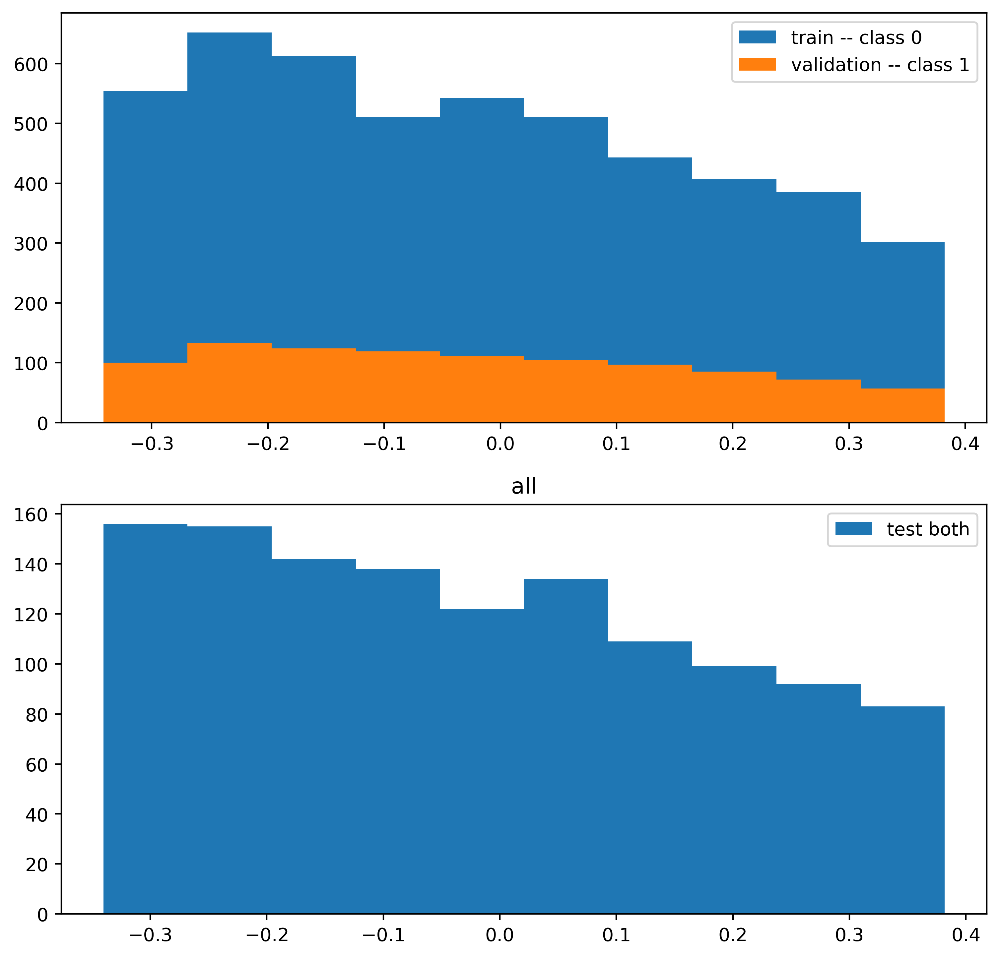

all:  33%|███▎      | 10001/30000 [2:30:51<7:14:10,  1.30s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  34%|███▎      | 10101/30000 [2:32:21<4:59:46,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  34%|███▍      | 10201/30000 [2:33:52<4:57:56,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  34%|███▍      | 10301/30000 [2:35:22<4:55:57,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  35%|███▍      | 10401/30000 [2:36:53<4:56:10,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  35%|███▌      | 10501/30000 [2:38:23<4:53:20,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  35%|███▌      | 10601/30000 [2:39:53<4:54:44,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  36%|███▌      | 10701/30000 [2:41:24<4:52:16,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  36%|███▌      | 10801/30000 [2:42:55<4:49:28,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  36%|███▋      | 10901/30000 [2:44:25<4:46:50,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  37%|███▋      | 11000/30000 [2:45:56<4:46:40,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


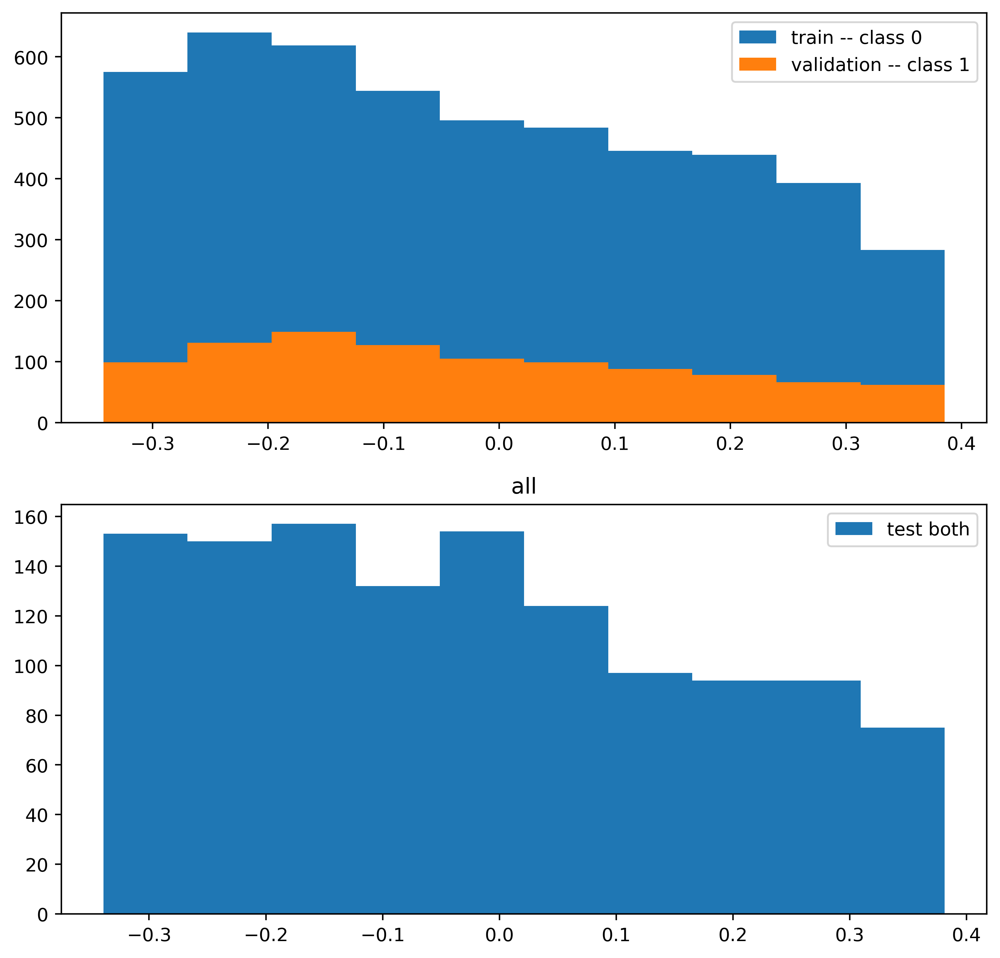

all:  37%|███▋      | 11001/30000 [2:45:57<6:53:58,  1.31s/it, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  37%|███▋      | 11101/30000 [2:47:28<4:45:09,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  37%|███▋      | 11201/30000 [2:48:58<4:43:45,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  38%|███▊      | 11301/30000 [2:50:29<4:42:01,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  38%|███▊      | 11401/30000 [2:52:00<4:41:17,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  38%|███▊      | 11501/30000 [2:53:30<4:38:43,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  39%|███▊      | 11601/30000 [2:55:01<4:36:51,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  39%|███▉      | 11701/30000 [2:56:31<4:36:28,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  39%|███▉      | 11801/30000 [2:58:02<4:34:21,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  40%|███▉      | 11901/30000 [2:59:32<4:33:00,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  40%|████      | 12000/30000 [3:01:03<4:30:09,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


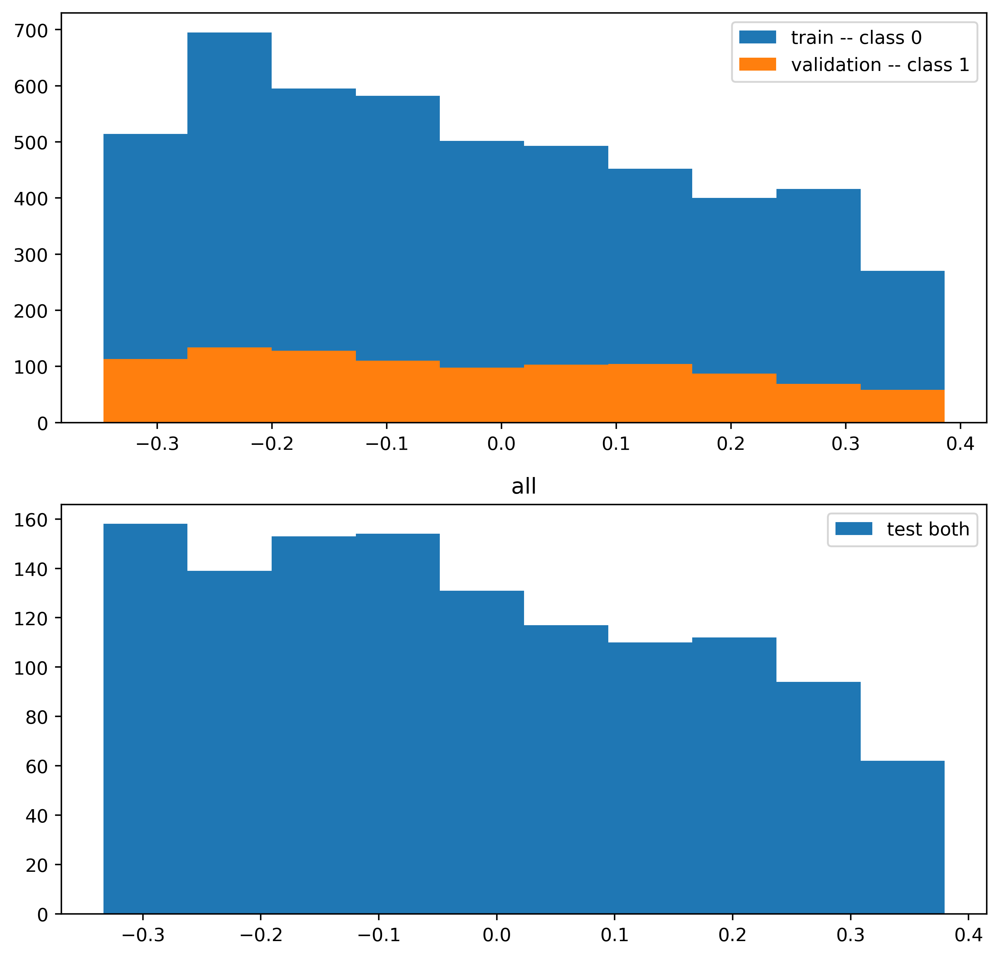

all:  40%|████      | 12001/30000 [3:01:04<6:37:19,  1.32s/it, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  40%|████      | 12101/30000 [3:02:35<4:29:54,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  41%|████      | 12201/30000 [3:04:05<4:28:06,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  41%|████      | 12301/30000 [3:05:36<4:26:03,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  41%|████▏     | 12401/30000 [3:07:06<4:25:09,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  42%|████▏     | 12501/30000 [3:08:36<4:23:26,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  42%|████▏     | 12601/30000 [3:10:07<4:21:26,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  42%|████▏     | 12701/30000 [3:11:37<4:20:37,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  43%|████▎     | 12801/30000 [3:13:07<4:19:09,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  43%|████▎     | 12901/30000 [3:14:38<4:17:26,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  43%|████▎     | 13000/30000 [3:16:09<4:24:45,  1.07it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


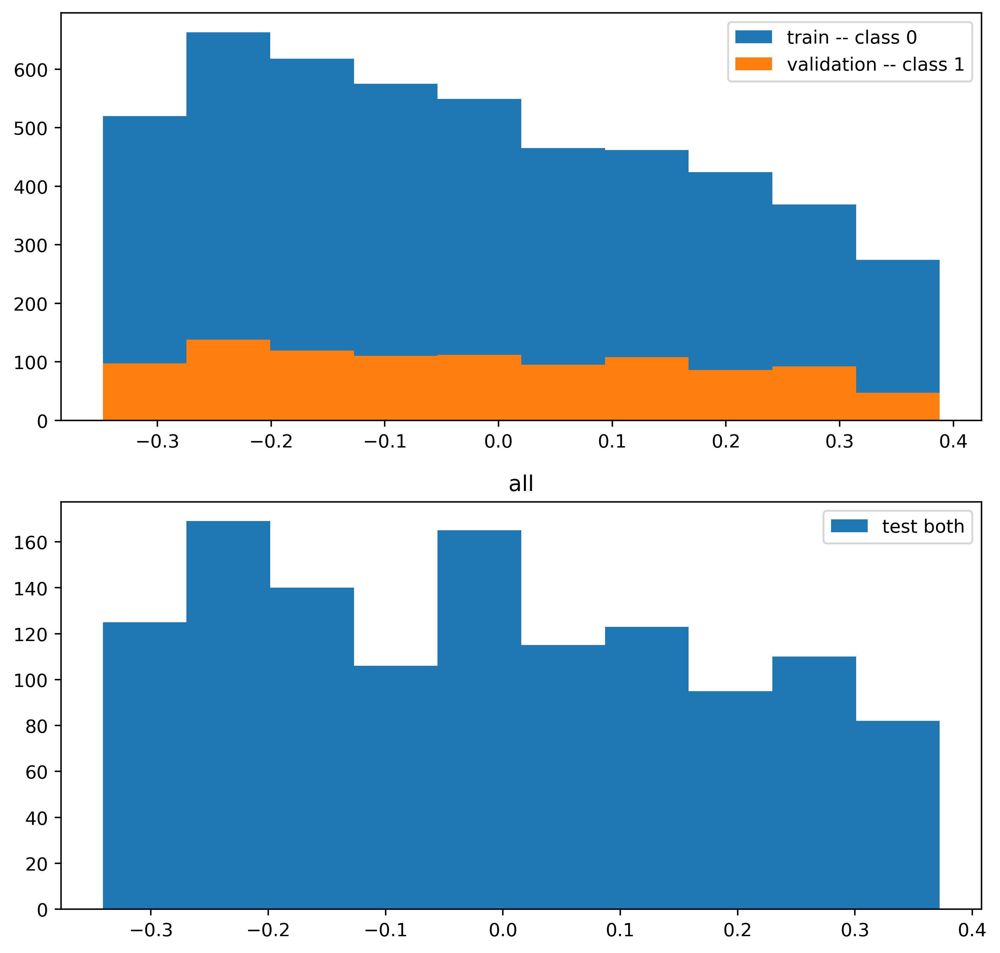

all:  43%|████▎     | 13001/30000 [3:16:10<6:18:07,  1.33s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  44%|████▎     | 13101/30000 [3:17:41<4:14:10,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  44%|████▍     | 13201/30000 [3:19:12<4:12:57,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  44%|████▍     | 13301/30000 [3:20:42<4:10:51,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  45%|████▍     | 13401/30000 [3:22:12<4:09:17,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  45%|████▌     | 13501/30000 [3:23:42<4:07:59,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  45%|████▌     | 13601/30000 [3:25:13<4:06:36,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  46%|████▌     | 13701/30000 [3:26:43<4:05:46,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  46%|████▌     | 13801/30000 [3:28:13<4:03:06,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  46%|████▋     | 13901/30000 [3:29:44<4:01:32,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  47%|████▋     | 14000/30000 [3:31:14<4:00:43,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


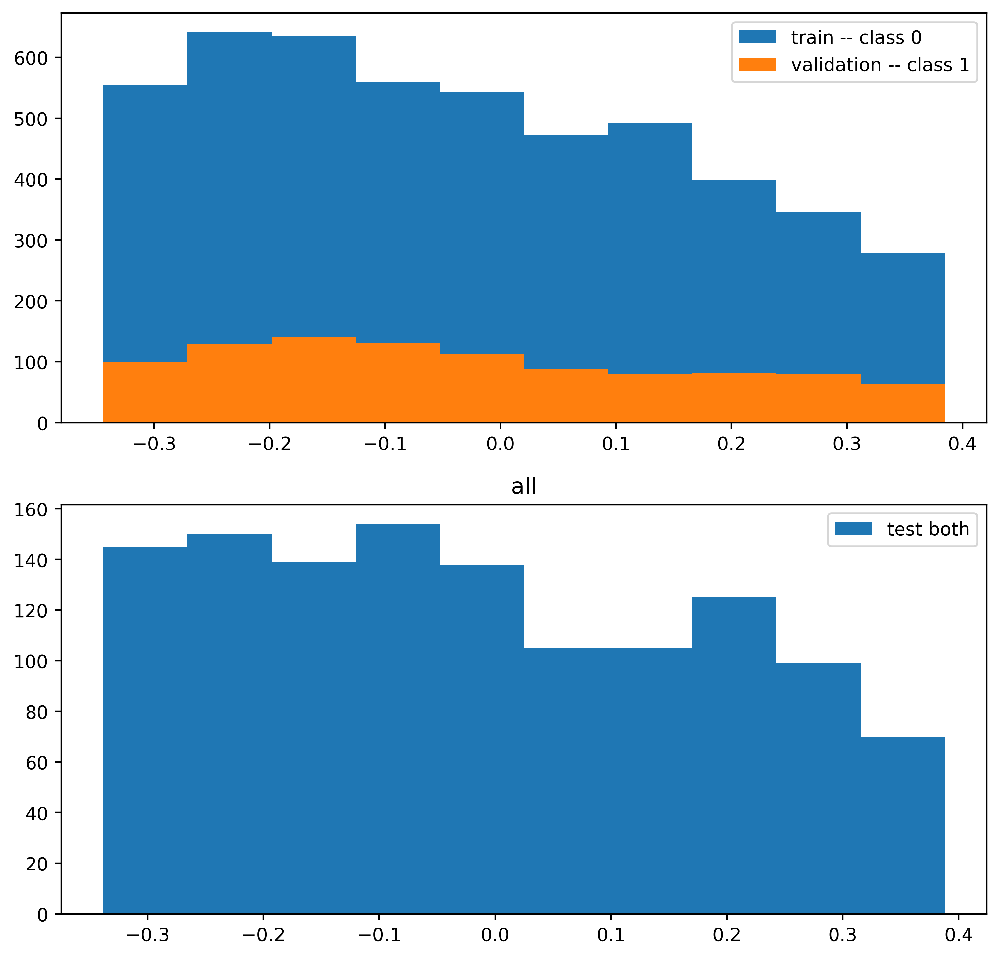

all:  47%|████▋     | 14001/30000 [3:31:15<5:46:57,  1.30s/it, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  47%|████▋     | 14101/30000 [3:32:46<3:59:23,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  47%|████▋     | 14201/30000 [3:34:16<3:56:42,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  48%|████▊     | 14301/30000 [3:35:46<3:55:14,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  48%|████▊     | 14401/30000 [3:37:15<3:52:54,  1.12it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  48%|████▊     | 14501/30000 [3:38:45<3:51:15,  1.12it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  49%|████▊     | 14601/30000 [3:40:15<3:50:09,  1.12it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  49%|████▉     | 14701/30000 [3:41:44<3:48:32,  1.12it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  49%|████▉     | 14801/30000 [3:43:14<3:46:31,  1.12it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  50%|████▉     | 14901/30000 [3:44:44<3:45:43,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  50%|█████     | 15000/30000 [3:46:13<3:44:11,  1.12it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


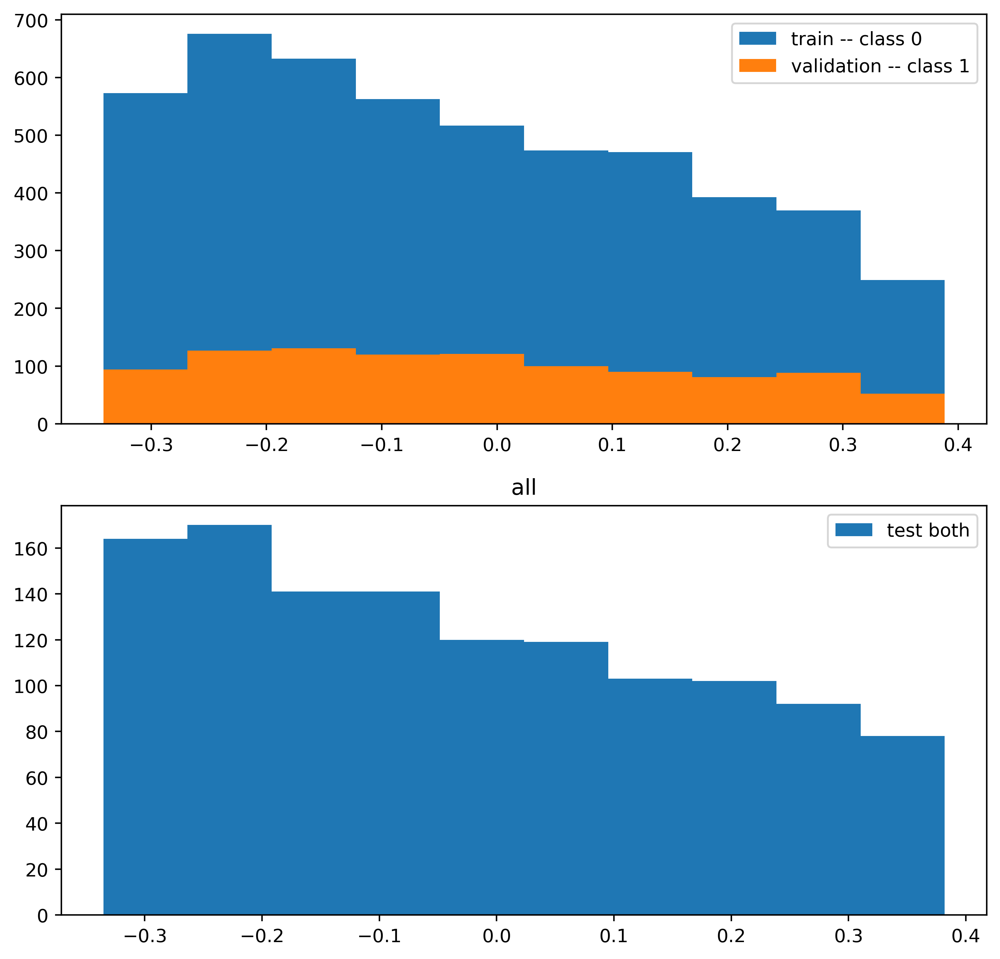

all:  50%|█████     | 15001/30000 [3:46:15<5:23:54,  1.30s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  50%|█████     | 15101/30000 [3:47:44<3:42:51,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  51%|█████     | 15201/30000 [3:49:14<3:40:17,  1.12it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  51%|█████     | 15301/30000 [3:50:44<3:41:02,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  51%|█████▏    | 15401/30000 [3:52:14<3:42:34,  1.09it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  52%|█████▏    | 15501/30000 [3:53:45<3:38:13,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  52%|█████▏    | 15601/30000 [3:55:15<3:36:35,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  52%|█████▏    | 15701/30000 [3:56:45<3:34:41,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  53%|█████▎    | 15801/30000 [3:58:16<3:33:07,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  53%|█████▎    | 15901/30000 [3:59:46<3:32:38,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  53%|█████▎    | 16000/30000 [4:01:16<3:31:15,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


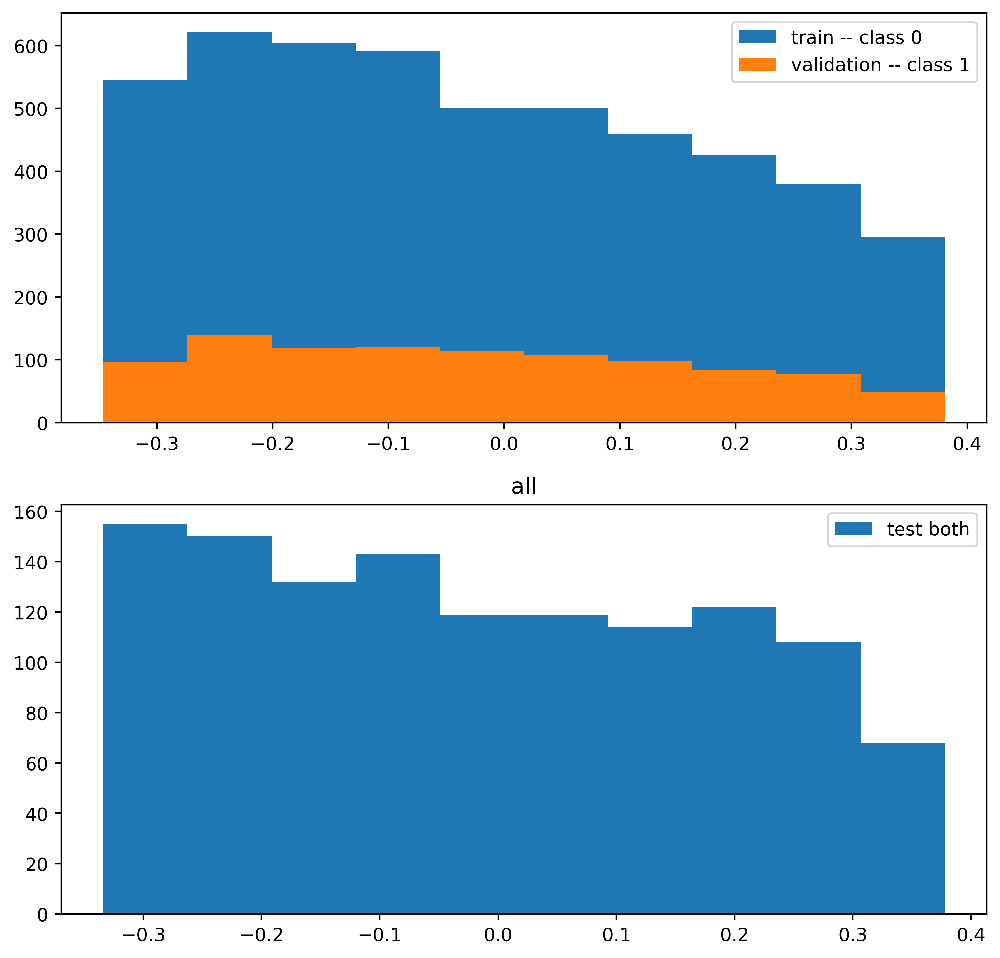

all:  53%|█████▎    | 16001/30000 [4:01:18<5:04:48,  1.31s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  54%|█████▎    | 16101/30000 [4:02:48<3:29:33,  1.11it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  54%|█████▍    | 16201/30000 [4:04:19<3:28:09,  1.10it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  54%|█████▍    | 16301/30000 [4:05:49<3:26:45,  1.10it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  55%|█████▍    | 16401/30000 [4:07:20<3:25:57,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  55%|█████▌    | 16501/30000 [4:08:51<3:24:03,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  55%|█████▌    | 16601/30000 [4:10:22<3:22:33,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  56%|█████▌    | 16701/30000 [4:11:52<3:21:04,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  56%|█████▌    | 16801/30000 [4:13:23<3:19:11,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  56%|█████▋    | 16901/30000 [4:14:54<3:17:38,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  57%|█████▋    | 17000/30000 [4:16:24<3:16:10,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


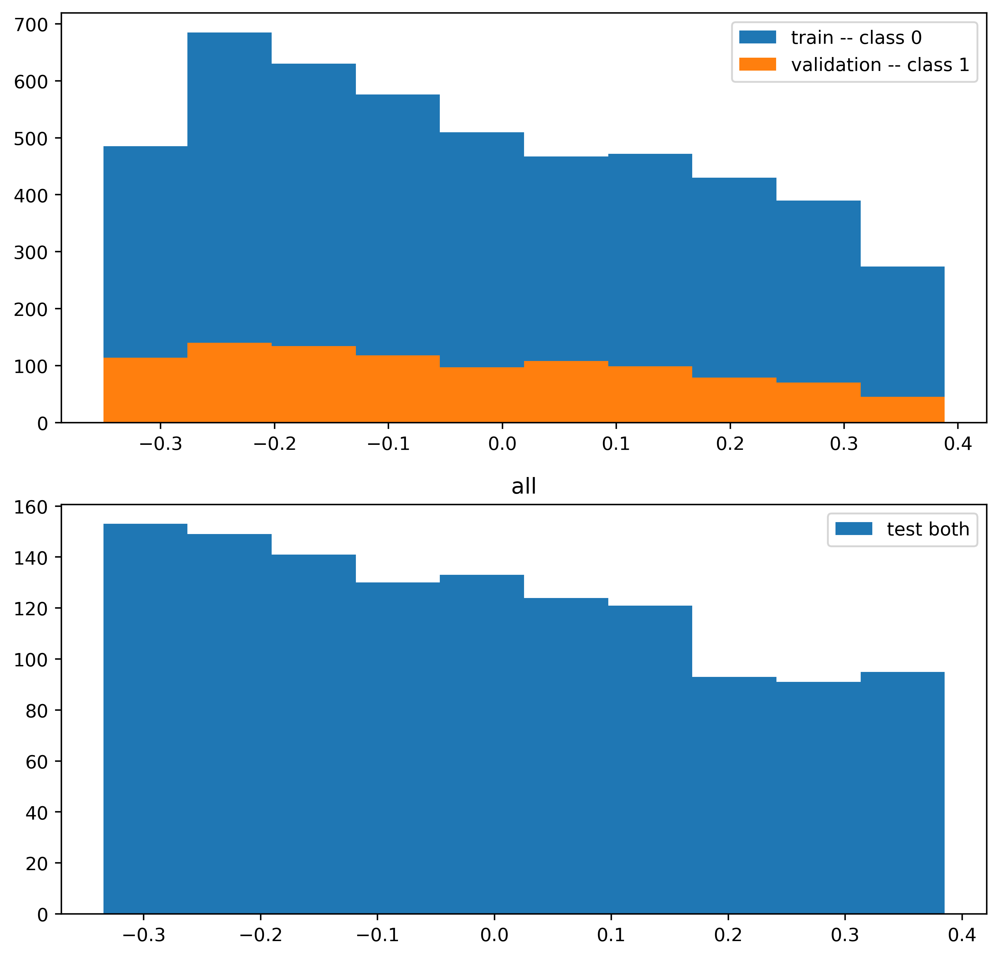

all:  57%|█████▋    | 17001/30000 [4:16:26<4:42:13,  1.30s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  57%|█████▋    | 17101/30000 [4:17:57<3:15:22,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  57%|█████▋    | 17201/30000 [4:19:28<3:13:38,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  58%|█████▊    | 17301/30000 [4:20:59<3:13:50,  1.09it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  58%|█████▊    | 17401/30000 [4:22:30<3:10:40,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  58%|█████▊    | 17501/30000 [4:24:00<3:09:06,  1.10it/s, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  59%|█████▊    | 17601/30000 [4:25:31<3:07:24,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  59%|█████▉    | 17701/30000 [4:27:02<3:05:39,  1.10it/s, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  59%|█████▉    | 17801/30000 [4:28:33<3:04:52,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  60%|█████▉    | 17901/30000 [4:30:03<3:03:06,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  60%|██████    | 18000/30000 [4:31:34<3:01:17,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


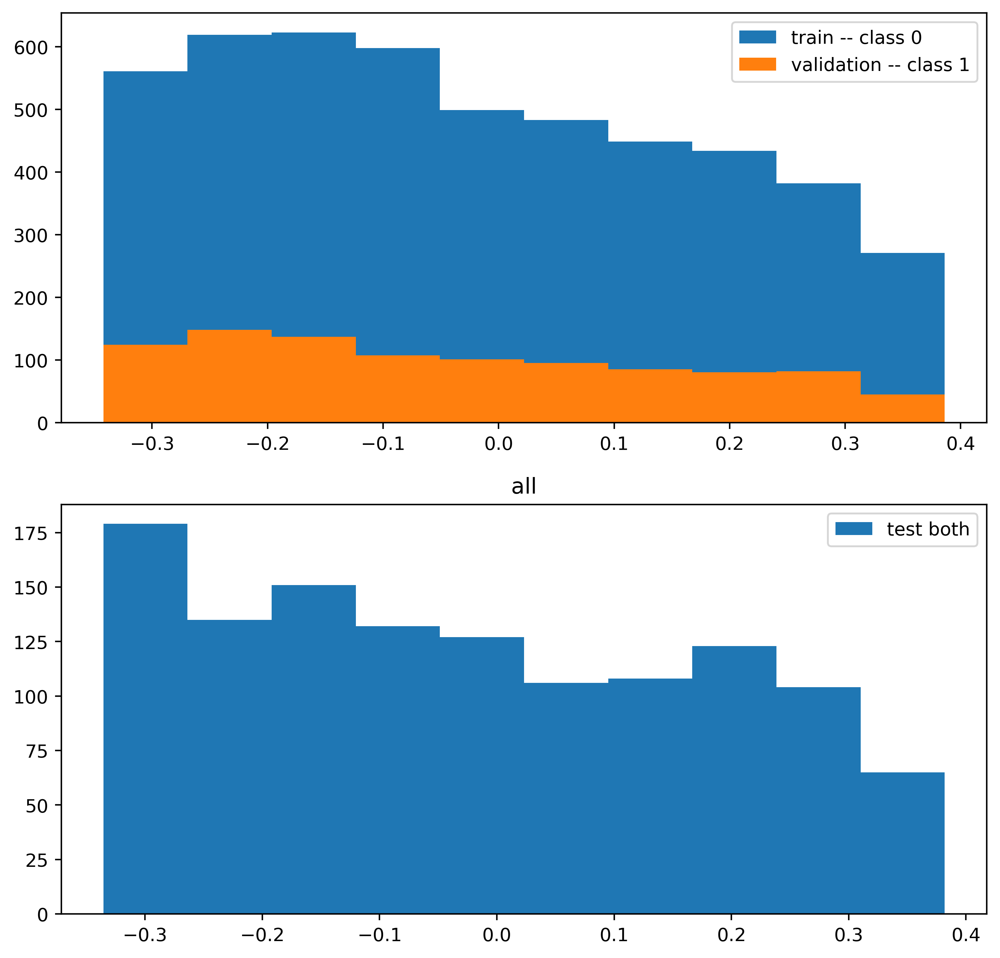

all:  60%|██████    | 18001/30000 [4:31:36<4:20:02,  1.30s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  60%|██████    | 18101/30000 [4:33:06<2:58:56,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  61%|██████    | 18201/30000 [4:34:37<2:57:41,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  61%|██████    | 18301/30000 [4:36:07<2:56:30,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  61%|██████▏   | 18401/30000 [4:37:37<2:54:24,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  62%|██████▏   | 18501/30000 [4:39:08<2:53:15,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  62%|██████▏   | 18601/30000 [4:40:38<2:51:24,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  62%|██████▏   | 18701/30000 [4:42:09<2:49:55,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  63%|██████▎   | 18801/30000 [4:43:39<2:48:17,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  63%|██████▎   | 18901/30000 [4:45:09<2:47:09,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  63%|██████▎   | 19000/30000 [4:46:39<2:44:59,  1.11it/s, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


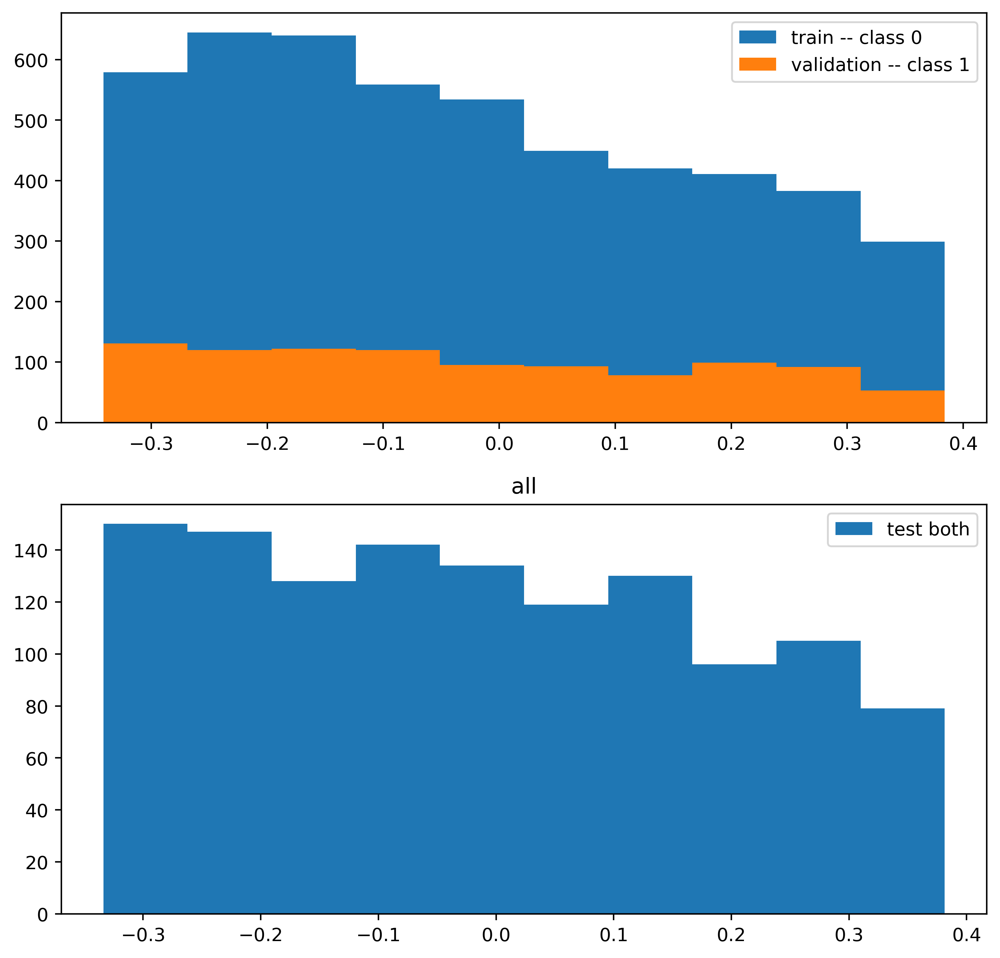

all:  63%|██████▎   | 19001/30000 [4:46:41<3:58:46,  1.30s/it, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  64%|██████▎   | 19101/30000 [4:48:11<2:44:21,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  64%|██████▍   | 19201/30000 [4:49:42<2:41:38,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  64%|██████▍   | 19301/30000 [4:51:12<2:40:31,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  65%|██████▍   | 19401/30000 [4:52:42<2:39:11,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  65%|██████▌   | 19501/30000 [4:54:12<2:37:48,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  65%|██████▌   | 19601/30000 [4:55:43<2:36:15,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  66%|██████▌   | 19701/30000 [4:57:13<2:36:16,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  66%|██████▌   | 19801/30000 [4:58:44<2:34:37,  1.10it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  66%|██████▋   | 19901/30000 [5:00:15<2:32:49,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  67%|██████▋   | 20000/30000 [5:01:46<2:31:54,  1.10it/s, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


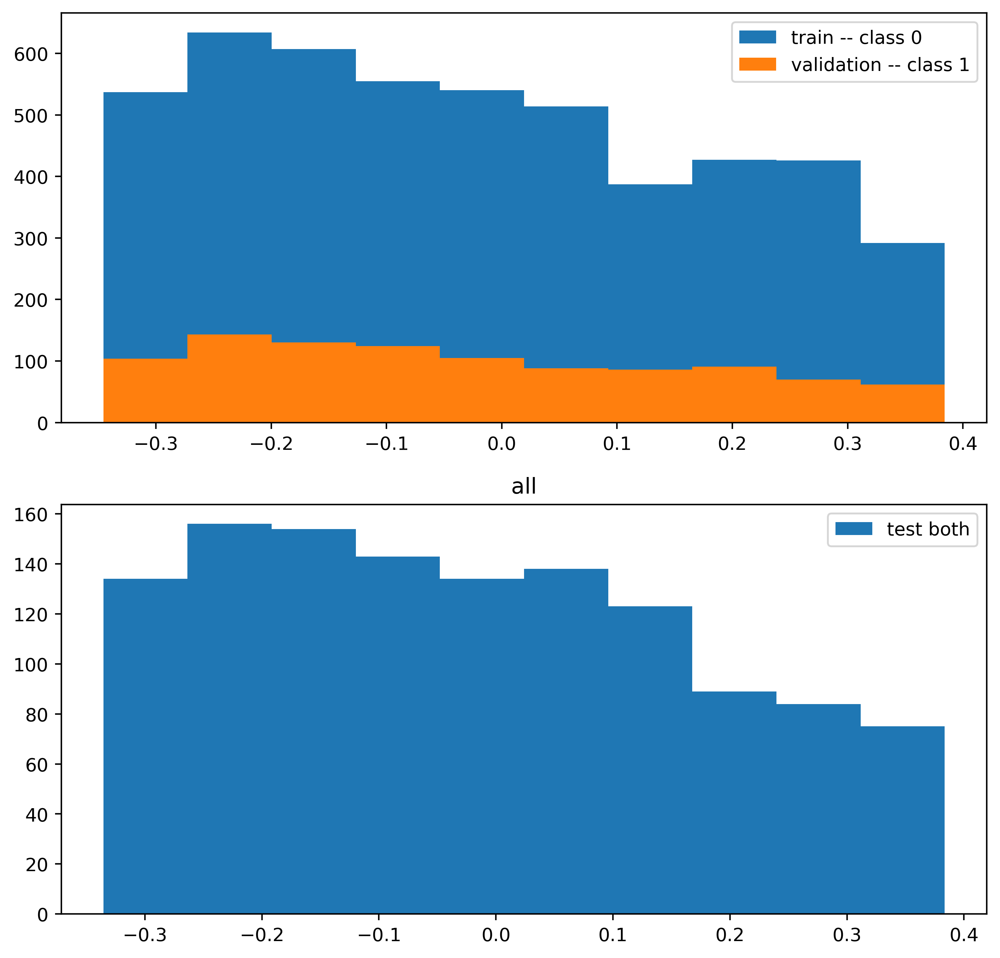

all:  67%|██████▋   | 20001/30000 [5:01:47<3:38:47,  1.31s/it, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  67%|██████▋   | 20101/30000 [5:03:18<2:29:13,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  67%|██████▋   | 20201/30000 [5:04:48<2:27:33,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  68%|██████▊   | 20301/30000 [5:06:19<2:26:09,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  68%|██████▊   | 20401/30000 [5:07:49<2:24:30,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  68%|██████▊   | 20501/30000 [5:09:19<2:23:07,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  69%|██████▊   | 20601/30000 [5:10:50<2:21:33,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  69%|██████▉   | 20701/30000 [5:12:20<2:20:12,  1.11it/s, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  69%|██████▉   | 20801/30000 [5:13:49<2:15:01,  1.14it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  70%|██████▉   | 20901/30000 [5:15:18<2:13:13,  1.14it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  70%|███████   | 21000/30000 [5:16:46<2:12:34,  1.13it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


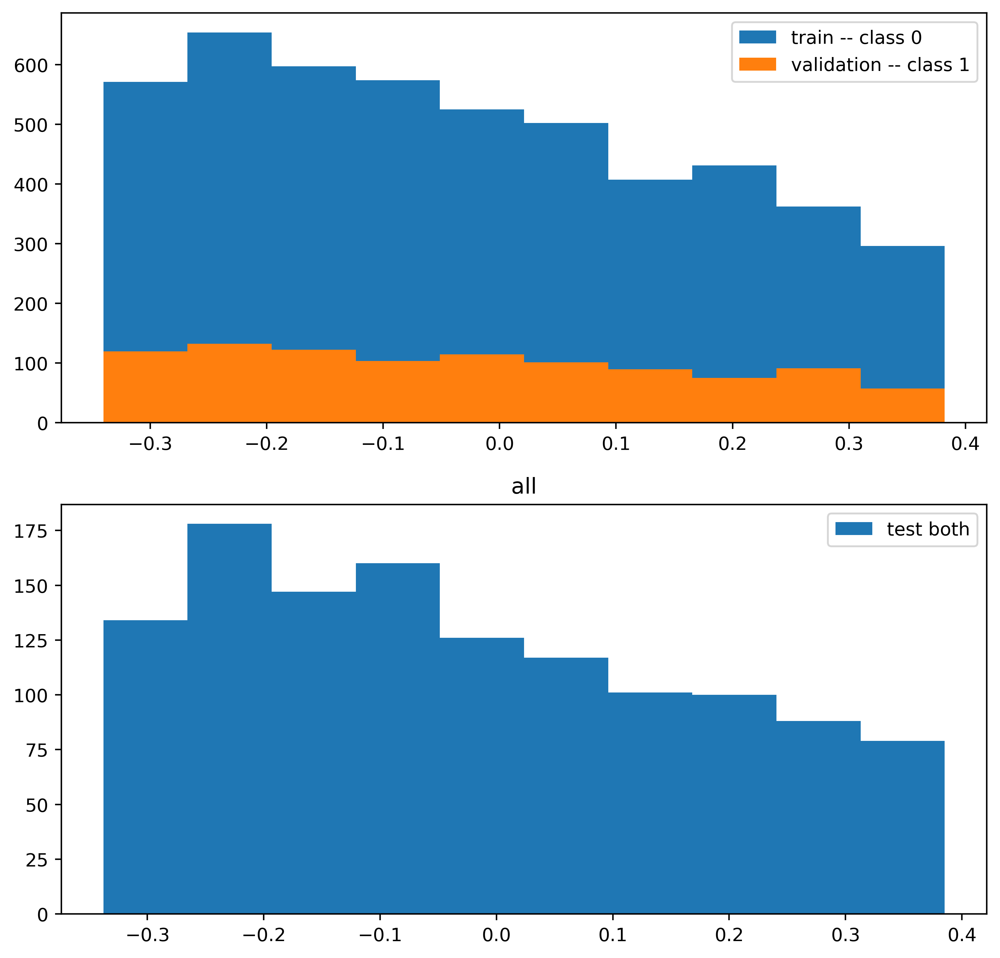

all:  70%|███████   | 21001/30000 [5:16:47<3:10:35,  1.27s/it, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  70%|███████   | 21101/30000 [5:18:16<2:11:10,  1.13it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  71%|███████   | 21201/30000 [5:19:44<2:09:20,  1.13it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  71%|███████   | 21301/30000 [5:21:12<2:08:09,  1.13it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  71%|███████▏  | 21401/30000 [5:22:41<2:06:12,  1.14it/s, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  72%|███████▏  | 21501/30000 [5:24:09<2:05:02,  1.13it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  72%|███████▏  | 21601/30000 [5:25:37<2:03:33,  1.13it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  72%|███████▏  | 21701/30000 [5:27:05<2:01:56,  1.13it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  73%|███████▎  | 21801/30000 [5:28:34<2:00:41,  1.13it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  73%|███████▎  | 21901/30000 [5:30:04<2:02:32,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  73%|███████▎  | 22000/30000 [5:31:35<2:00:42,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


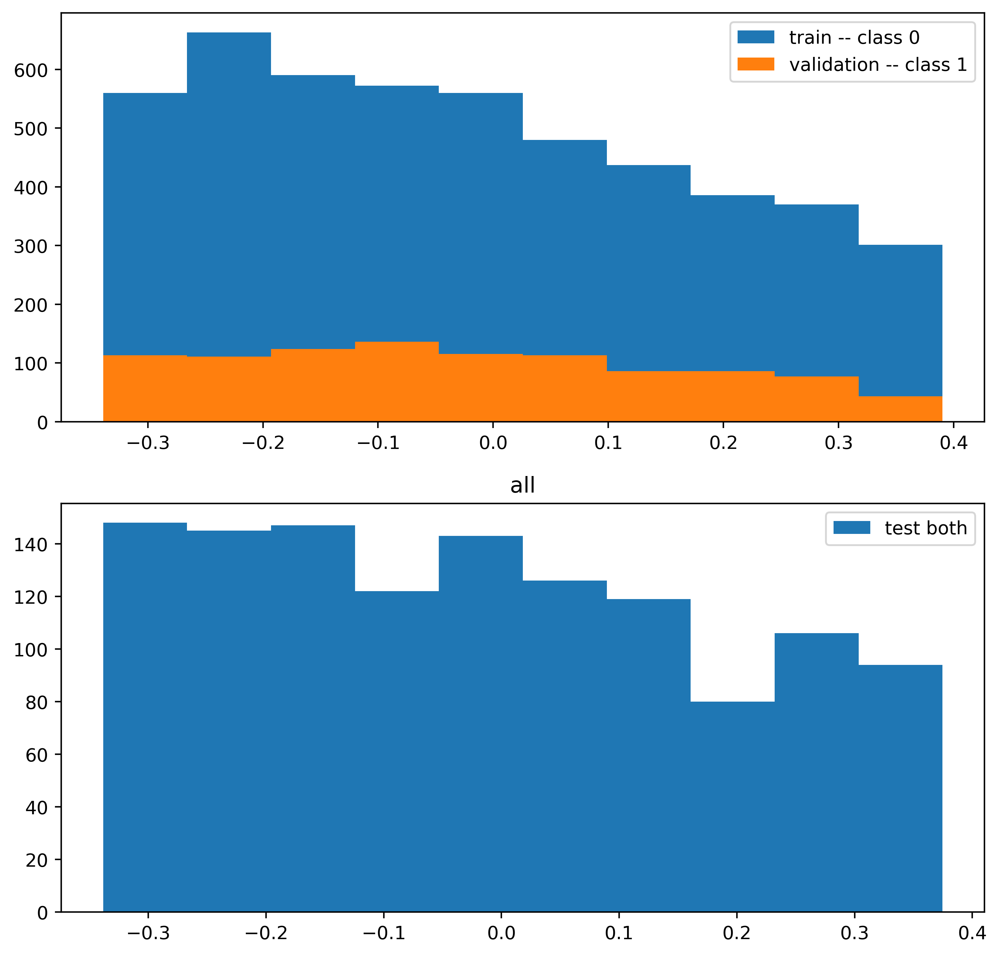

all:  73%|███████▎  | 22001/30000 [5:31:36<2:52:53,  1.30s/it, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  74%|███████▎  | 22101/30000 [5:33:07<1:59:16,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  74%|███████▍  | 22201/30000 [5:34:37<1:57:50,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  74%|███████▍  | 22301/30000 [5:36:08<1:56:10,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  75%|███████▍  | 22401/30000 [5:37:39<1:54:36,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  75%|███████▌  | 22501/30000 [5:39:10<1:53:29,  1.10it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  75%|███████▌  | 22601/30000 [5:40:41<1:51:47,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  76%|███████▌  | 22701/30000 [5:42:11<1:50:23,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  76%|███████▌  | 22801/30000 [5:43:42<1:48:49,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  76%|███████▋  | 22901/30000 [5:45:14<1:47:26,  1.10it/s, train_loss=-1.8, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1] 

New Model Temperature: 0.001


all:  77%|███████▋  | 23000/30000 [5:46:44<1:46:12,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


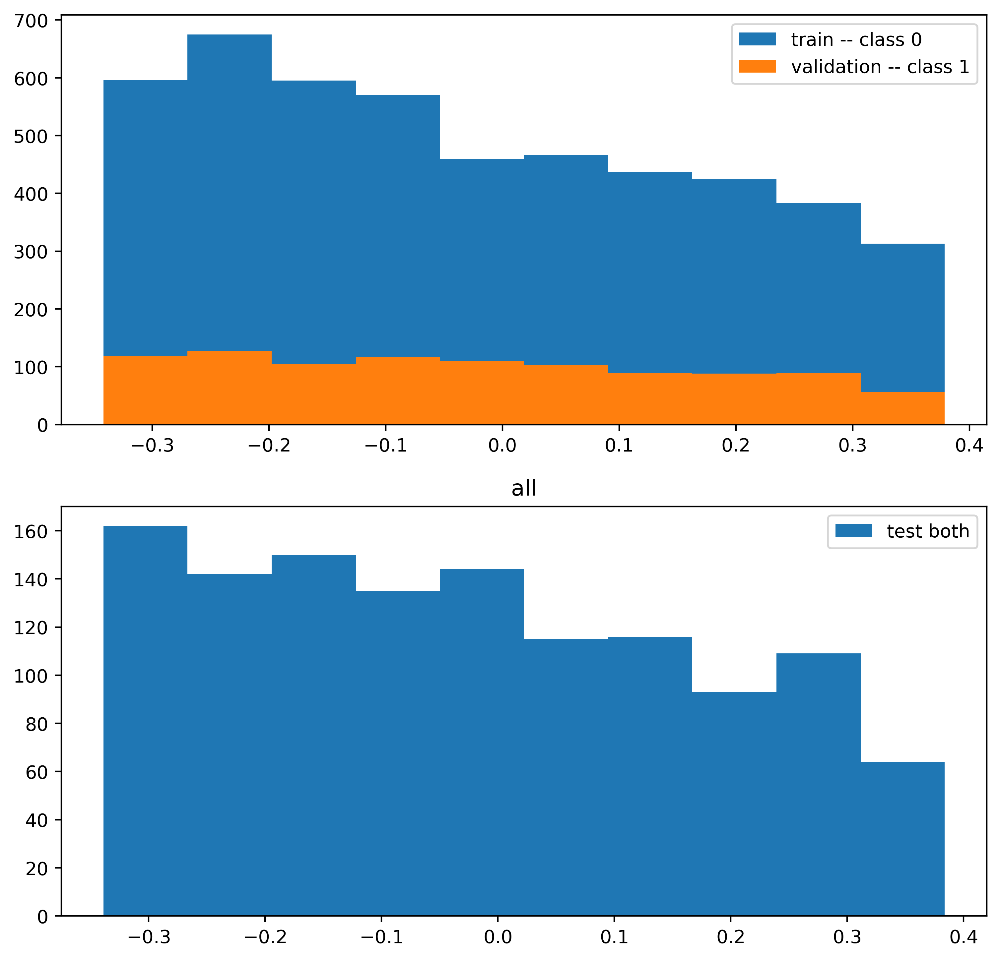

all:  77%|███████▋  | 23001/30000 [5:46:46<2:33:06,  1.31s/it, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  77%|███████▋  | 23101/30000 [5:48:16<1:43:31,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  77%|███████▋  | 23201/30000 [5:49:46<1:42:28,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  78%|███████▊  | 23301/30000 [5:51:16<1:40:30,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  78%|███████▊  | 23401/30000 [5:52:47<1:39:11,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  78%|███████▊  | 23501/30000 [5:54:17<1:37:32,  1.11it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  79%|███████▊  | 23601/30000 [5:55:47<1:36:09,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  79%|███████▉  | 23701/30000 [5:57:17<1:34:24,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  79%|███████▉  | 23801/30000 [5:58:47<1:32:53,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  80%|███████▉  | 23901/30000 [6:00:17<1:31:35,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  80%|████████  | 24000/30000 [6:01:47<1:30:26,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


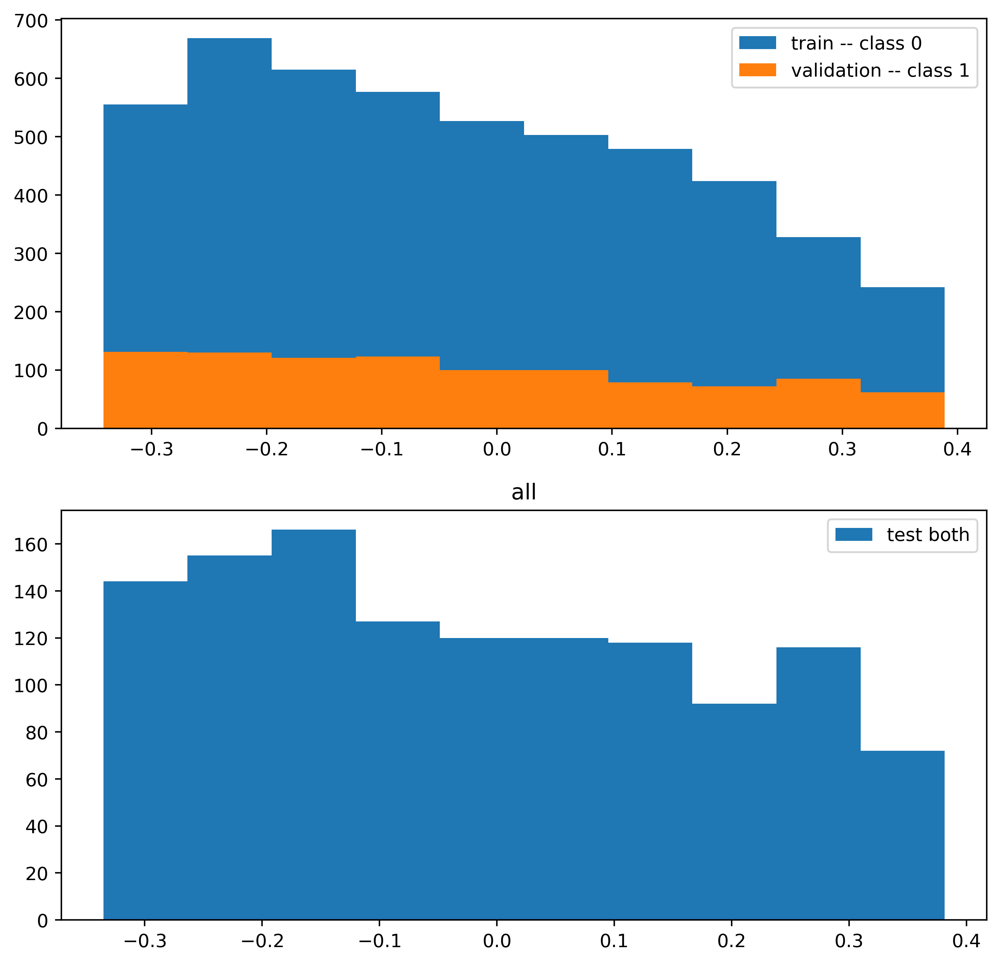

all:  80%|████████  | 24001/30000 [6:01:49<2:12:40,  1.33s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  80%|████████  | 24101/30000 [6:03:19<1:28:19,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  81%|████████  | 24201/30000 [6:04:48<1:26:48,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  81%|████████  | 24301/30000 [6:06:18<1:25:23,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  81%|████████▏ | 24401/30000 [6:07:48<1:23:45,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  82%|████████▏ | 24501/30000 [6:09:18<1:22:07,  1.12it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  82%|████████▏ | 24601/30000 [6:10:48<1:20:41,  1.12it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  82%|████████▏ | 24701/30000 [6:12:18<1:19:12,  1.12it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  83%|████████▎ | 24801/30000 [6:13:47<1:17:40,  1.12it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  83%|████████▎ | 24901/30000 [6:15:17<1:16:18,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  83%|████████▎ | 25000/30000 [6:16:47<1:14:43,  1.12it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


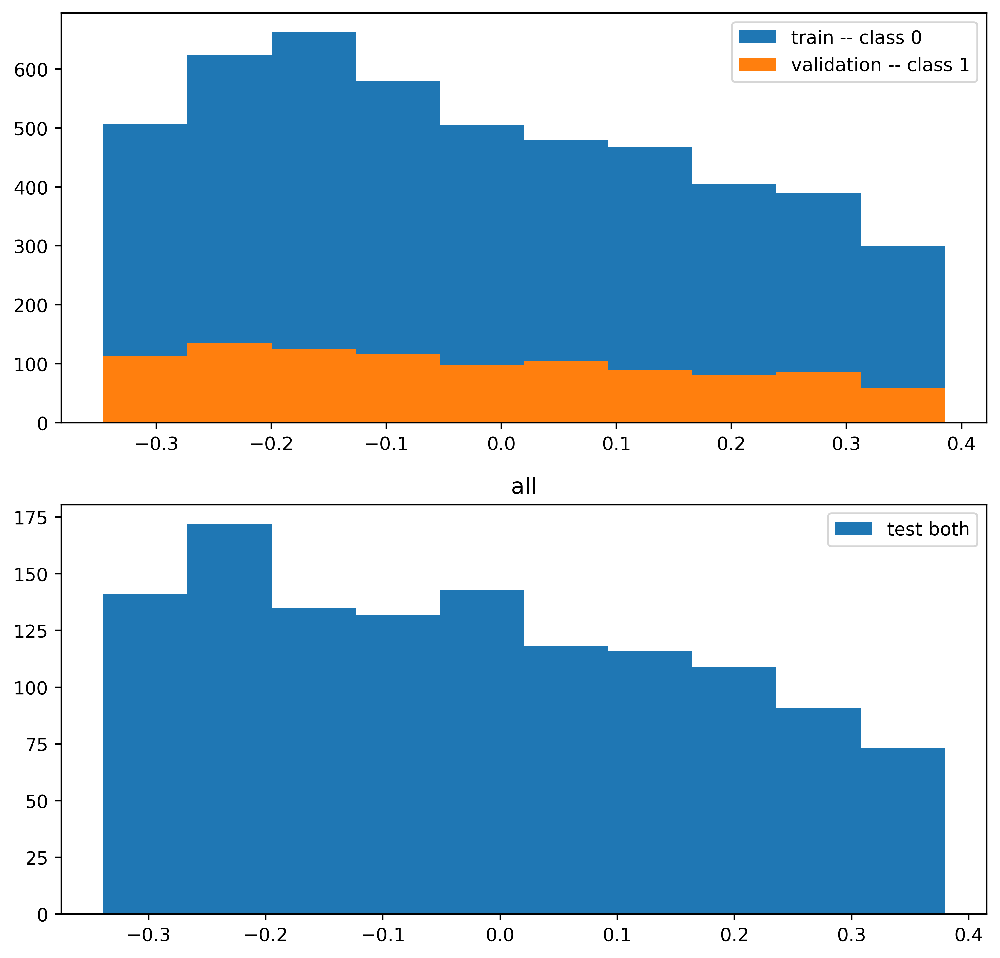

all:  83%|████████▎ | 25001/30000 [6:16:48<1:47:08,  1.29s/it, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  84%|████████▎ | 25101/30000 [6:18:19<1:13:44,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  84%|████████▍ | 25201/30000 [6:19:49<1:12:18,  1.11it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  84%|████████▍ | 25301/30000 [6:21:20<1:10:54,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  85%|████████▍ | 25401/30000 [6:22:50<1:09:14,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  85%|████████▌ | 25501/30000 [6:24:21<1:07:45,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  85%|████████▌ | 25601/30000 [6:25:51<1:06:14,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  86%|████████▌ | 25701/30000 [6:27:22<1:04:44,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  86%|████████▌ | 25801/30000 [6:28:52<1:03:11,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  86%|████████▋ | 25901/30000 [6:30:23<1:01:47,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  87%|████████▋ | 26000/30000 [6:31:53<1:00:08,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


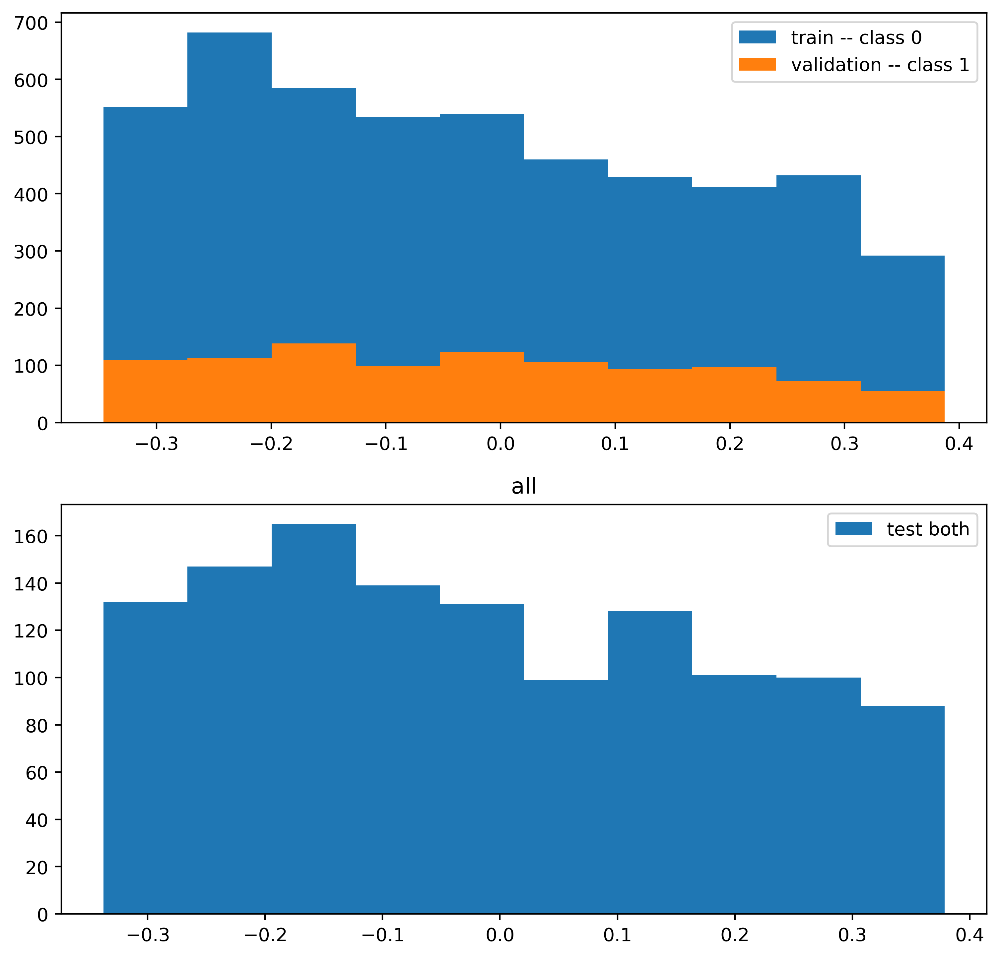

all:  87%|████████▋ | 26001/30000 [6:31:55<1:27:02,  1.31s/it, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  87%|████████▋ | 26101/30000 [6:33:25<58:34,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]  

New Model Temperature: 0.001


all:  87%|████████▋ | 26201/30000 [6:34:55<56:59,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]  

New Model Temperature: 0.001


all:  88%|████████▊ | 26301/30000 [6:36:26<55:34,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  88%|████████▊ | 26401/30000 [6:37:56<53:55,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  88%|████████▊ | 26501/30000 [6:39:26<52:37,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  89%|████████▊ | 26601/30000 [6:40:56<50:58,  1.11it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  89%|████████▉ | 26701/30000 [6:42:26<49:36,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  89%|████████▉ | 26801/30000 [6:43:56<48:03,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  90%|████████▉ | 26901/30000 [6:45:26<46:36,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  90%|█████████ | 27000/30000 [6:46:57<45:07,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


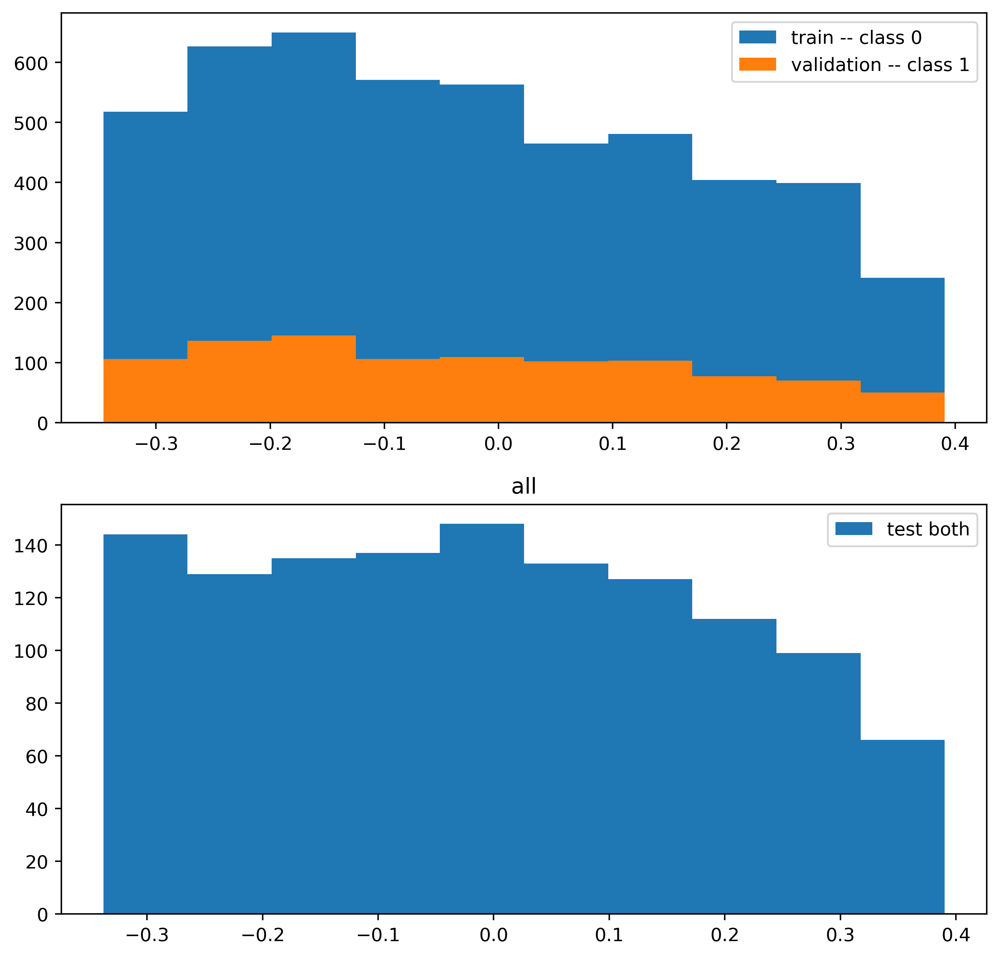

all:  90%|█████████ | 27001/30000 [6:46:58<1:04:36,  1.29s/it, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  90%|█████████ | 27101/30000 [6:48:28<43:33,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]  

New Model Temperature: 0.001


all:  91%|█████████ | 27201/30000 [6:49:59<42:07,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  91%|█████████ | 27301/30000 [6:51:30<41:05,  1.09it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  91%|█████████▏| 27401/30000 [6:53:01<39:22,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  92%|█████████▏| 27501/30000 [6:54:32<37:53,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  92%|█████████▏| 27601/30000 [6:56:03<36:20,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  92%|█████████▏| 27701/30000 [6:57:34<34:41,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  93%|█████████▎| 27801/30000 [6:59:05<33:16,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  93%|█████████▎| 27901/30000 [7:00:36<31:49,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  93%|█████████▎| 28000/30000 [7:02:07<30:20,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


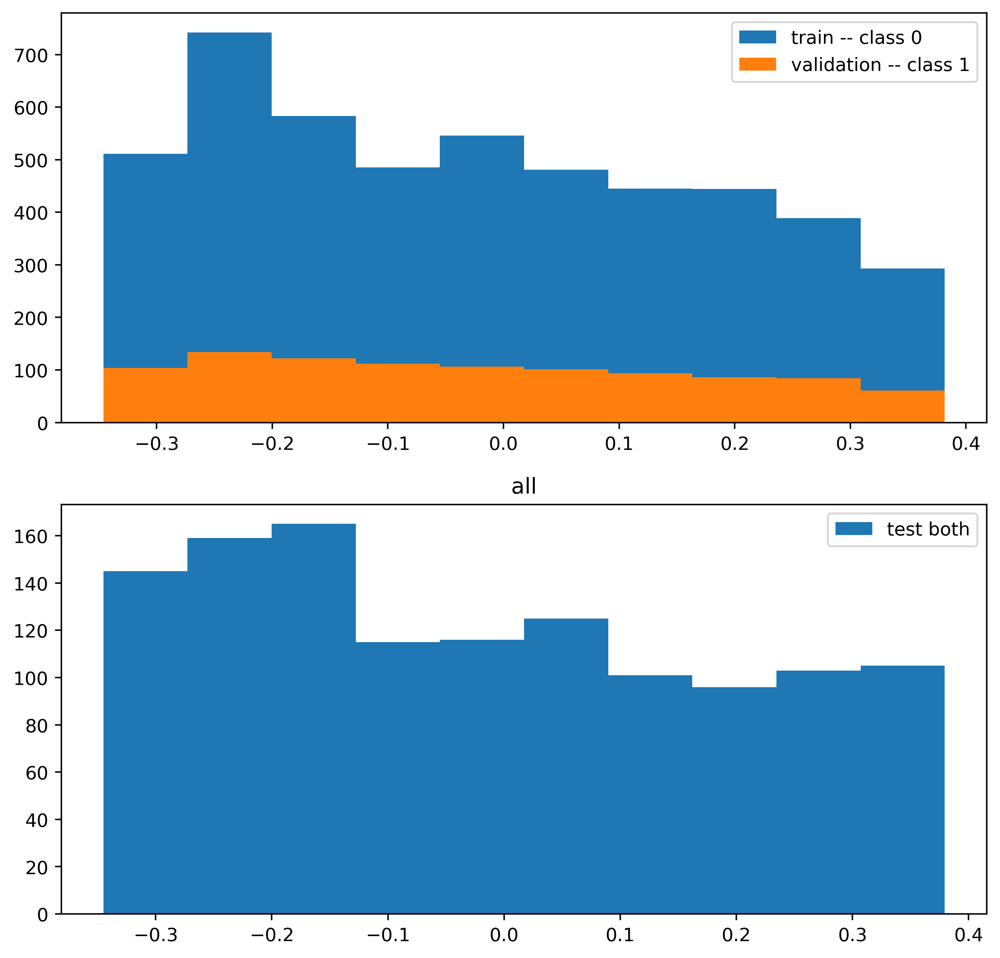

all:  93%|█████████▎| 28001/30000 [7:02:08<43:49,  1.32s/it, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  94%|█████████▎| 28101/30000 [7:03:39<28:49,  1.10it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  94%|█████████▍| 28201/30000 [7:05:10<27:15,  1.10it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  94%|█████████▍| 28301/30000 [7:06:41<25:46,  1.10it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  95%|█████████▍| 28401/30000 [7:08:12<24:07,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  95%|█████████▌| 28501/30000 [7:09:43<22:39,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  95%|█████████▌| 28601/30000 [7:11:13<21:06,  1.10it/s, train_loss=-1.79, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  96%|█████████▌| 28701/30000 [7:12:44<19:37,  1.10it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  96%|█████████▌| 28801/30000 [7:14:15<18:06,  1.10it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  96%|█████████▋| 28901/30000 [7:15:45<16:36,  1.10it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  97%|█████████▋| 29000/30000 [7:17:16<15:15,  1.09it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001
4919 4919 4919
(array([0]), array([4919]))


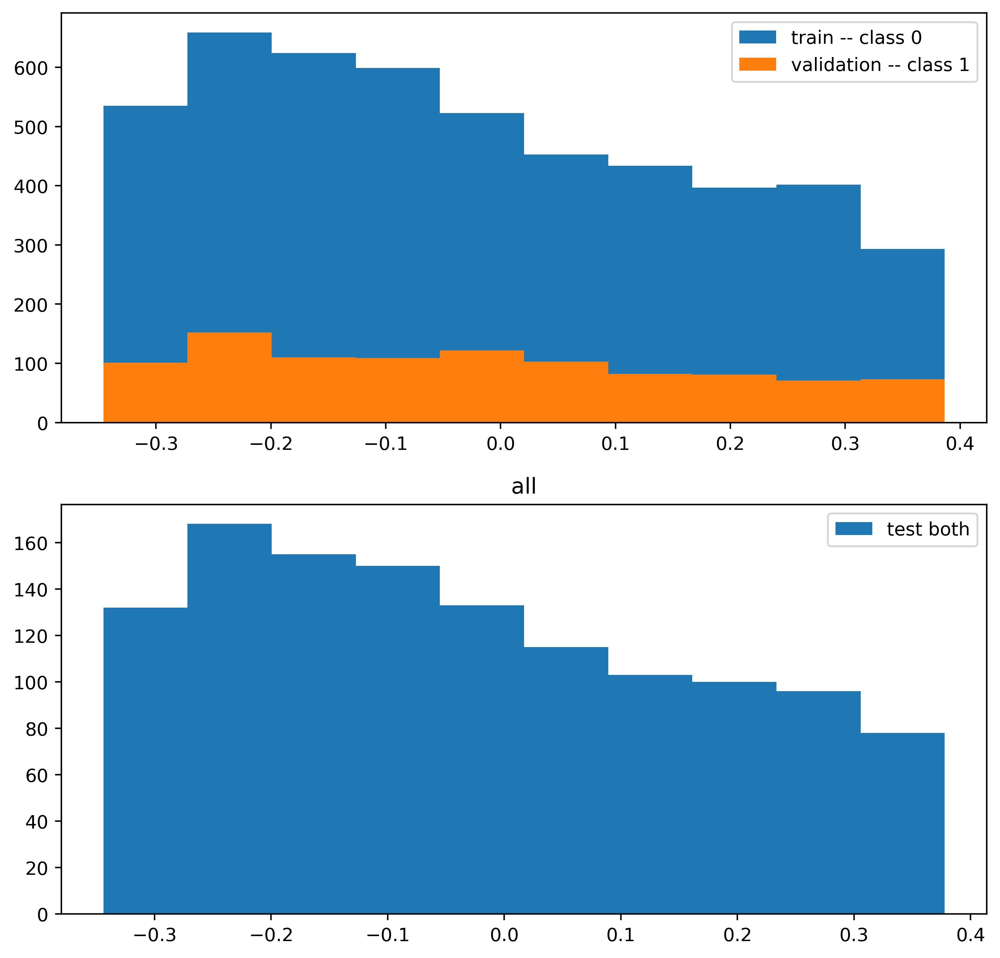

all:  97%|█████████▋| 29001/30000 [7:17:17<21:53,  1.31s/it, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

graph level clf: all binary True test acc 0.2163 f1 0.0000 recall 0.0000 prec 0.0000 [[266   0]
 [964   0]] 



all:  97%|█████████▋| 29101/30000 [7:18:48<13:36,  1.10it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  97%|█████████▋| 29201/30000 [7:20:18<12:01,  1.11it/s, train_loss=-1.76, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  98%|█████████▊| 29301/30000 [7:21:49<10:29,  1.11it/s, train_loss=-1.78, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  98%|█████████▊| 29401/30000 [7:23:19<08:59,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  98%|█████████▊| 29501/30000 [7:24:49<07:29,  1.11it/s, train_loss=-1.75, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  99%|█████████▊| 29601/30000 [7:26:20<05:59,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  99%|█████████▉| 29701/30000 [7:27:50<04:29,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all:  99%|█████████▉| 29801/30000 [7:29:20<02:59,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all: 100%|█████████▉| 29901/30000 [7:30:51<01:29,  1.11it/s, train_loss=-1.74, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]

New Model Temperature: 0.001


all: 100%|██████████| 30000/30000 [7:32:20<00:00,  1.11it/s, train_loss=-1.77, train_acc=0.204, test_acc=0.216, f1 score=0, val_best=1]


In [7]:
''' train and eval model '''
# NOTE: increase the epochs to 500. The same as the settings in IJHPCA paper
workflows = ["all", "1000genome", 
        "nowcast-clustering-8",
        "nowcast-clustering-16",
        "wind-clustering-casa",
        "wind-noclustering-casa", "all"]
''' Build GNN model '''
from torch.utils.tensorboard import SummaryWriter
for wf in  workflows:
    # ROOT = osp.join(osp.expanduser("~"), "tmp", "data", wf)

    if wf == "all":
        dataset = Merge_PSD_Dataset(node_level=False,\
                binary_labels=True, anomaly_level=None).shuffle()
    else:
        dataset = PSD_Dataset("./", wf,\
                    binary_labels=True, node_level=False)

    n_graphs = len(dataset)
    
    train_idx, test_idx = train_test_split(np.arange(n_graphs),\
                        test_size=0.2, random_state=0, shuffle=True)
    temp_dataset = dataset[train_idx]
    train_array = []
    val_array = []
    for data in temp_dataset:
            if data.y == 1:
                train_array.append(data)
            else:
                val_array.append(data)
    test_loader  = DataLoader(dataset[test_idx], batch_size=32)
    train_loader = DataLoader(dataset[train_idx], batch_size=32)
    val_loader   = DataLoader(val_array, batch_size=32)

    NUM_NODE_FEATURES = dataset.num_node_features
    NUM_OUT_FEATURES = dataset.num_classes
    model = GNN(NUM_NODE_FEATURES, 64, NUM_OUT_FEATURES).to(DEVICE)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
    # NOTE: ignore the weighted loss for now
    loss_func = CrossEntropyLoss()


    loss_array =[]
    acc_arr=[]
    f1_arr=[]
    precision_arr=[]
    recall_arr=[]

    ts_start = datetime.now().strftime('%Y%m%d_%H%M%S')
    pbar = tqdm(range(30000), desc=wf)
    best = 0

    for e in pbar:
        train_loss = train(model, train_loader)
        train_acc, y_pred, _, _ = test(model, train_loader)
        val_acc, _, _,_ = test(model, val_loader)
        test_acc, y_pred, y_true, _ = test(model, test_loader)

        if val_acc > best:
            # NOTE: ignore of model dumping for now
            # save tmp model on disk
            create_dir("tmp_models")
            torch.save(model, osp.join(f"tmp_models",
                    f"saved_models_{wf}_{ts_start}"))
            best = val_acc


        # scheduler.step(train_loss) 
        ## Record all info
        loss_array.append(train_loss)
        conf_mat = confusion_matrix(y_true, y_pred)
        prec_val = precision_score(y_true, y_pred)
        f1_val = f1_score(y_true, y_pred)
        recall_val = recall_score(y_true, y_pred)
        pbar.set_postfix({"train_loss": train_loss,\
                        "train_acc": train_acc,\
                        "test_acc": test_acc,\
                        "f1 score": f1_val, "val_best":best})
        

        if e %100 ==0:
            model.temperature = np.maximum(model.temperature * np.exp(-ANNEAL_RATE * e), temp_min)
            print("New Model Temperature: {}".format(model.temperature))
            acc_arr.append(test_acc)
            f1_arr.append(f1_val)
            precision_arr.append(prec_val)
            recall_arr.append(recall_val)


        if e % 1000 == 0:
            ## The resulting information
            _, y_pred,      y_true, outputs   = test(model, train_loader)
            _, y_pred_V,  y_true_V, outputs_V = test(model, val_loader)
            _, y_pred_t,  y_true_t, outputs_t = test(model, test_loader)
            print( len(y_true), len(y_pred), len(outputs) )
            print(np.unique( y_pred, return_counts=True) )
            # y = np.arange(len(y_true))
            fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(9, 9), dpi = 400)
            # axes.scatter(y, outputs, color = 'orange')
            axes = axes.flatten()
            _, bins, _ = axes[0].hist(outputs, label = 'train -- class 0')
            axes[0].hist(outputs_V, bins, label = 'validation -- class 1')
            axes[1].hist(outputs_t, label = 'test both')
            axes[0].legend()
            axes[1].legend()
            
            # y = np.arange(len(y_true_V))
            # axes.scatter(y, outputs_V, color = 'blue')


            plt.title(wf)
            plt.savefig('CL_Figures/'+wf+'prob'+'.png', dpi = 500)
            plt.show()
            
            print("graph level clf:", wf,
                f"binary True",
                f"test acc {test_acc:.4f}",
                f"f1 {f1_val:.4f}",
                f"recall {recall_val:.4f}",
                f"prec {prec_val:.4f}", conf_mat, "\n"
                )
            plt.close()


    np.savetxt('CL_res/'+wf+'upper_training.csv', np.array(loss_array), delimiter = ',')
    np.savetxt('CL_res/'+wf+'upper_training_loss.csv', np.array(loss_array), delimiter = ',')
    np.savetxt('CL_res/'+wf+'upper_acc.csv', np.array(acc_arr), delimiter = ',')
    np.savetxt('CL_res/'+wf+'upper_precision.csv', np.array(precision_arr), delimiter = ',')
    np.savetxt('CL_res/'+wf+'upper_recall.csv', np.array(recall_arr), delimiter = ',')
    
    del model
    del optimizer
    del loss_func